# Introduction



**Cancer**

Cancer is a complex and heterogeneous disease in which some of the body’s cells grow uncontrollably and spread to other parts of the body. It is driven by a variety of factors, such as genetic mutations and genomic instability, altered cell signaling and interactions with the environment, and adaptation to stressors that influence tumor behaviour.

**Hypoxia**

Among the key features of tumors is hypoxia, a condition in which oxygen levels are low. Tumors often develop regions of hypoxia because they outgrow their blood supply. Hypoxia is not just a side effect of tumors: hypoxic environments contribute to aggressiveness and metastasis, cause resistance to therapy and lead to poor prognosis. Studying hypoxia is crucial, as it helps us identify the molecular changes that occur in tumor cells under low oxygen conditions, driving tumor progression and resistance to treatments. This is essential, as it helps us predict which tumors will be resistant to treatment, develop or personalize therapies and find biomarkers to detect hypoxic tumors.

**RNA-sequencing**

Traditional RNA-seq provides average gene expression values across many cells, which can mask important variations. In contrast, single-cell RNA sequencing captures cell-to-cell variation, enabling the identification of rare or distinct subpopulations, such as hypoxic cells. This approach is crucial for understanding tumor heterogeneity, a key factor in therapy failure, and offers more precise insights into the molecular mechanisms driving cancer.

**Data of our project**

The data for this project comes from single-cell RNA sequencing of tumor cells exposed to varying oxygen levels, simulating normoxic (normal oxygen ~ 21% O2) and hypoxic (~1% O2) conditions for N days. These datasets offer a comprehensive view of the gene expression changes associated with hypoxia, allowing for the identification of potential biomarkers.

**Goal of our project**

The aim of the project is to analyze these datasets to better understand the molecular mechanisms underlying hypoxia in tumors and to develop predictive models using machine learning techniques. By doing so, the project seeks to contribute to the identification of biomarkers for targeted cancer therapies and improve clinical outcomes for patients with hypoxic tumors



# MetaData Exploration

In this section, we introduce the basic structure of our dataset and perform initial checks to ensure the sanity of the data. This involves understanding the key columns, verifying the consistency of the metadata, and identifying any potential issues that could affect the integrity of our analysis.

In [ ]:
import sys
import sklearn
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt             #visualisation

Upload metadata

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df_meta_MCF7 = pd.read_csv("/content/drive/MyDrive/AILAB/Project data/SmartSeq/MCF7_SmartS_MetaData.tsv",
                      delimiter='\t',
                      engine='python',
                      index_col=0
            )
df_meta_HCC1806 = pd.read_csv("/content/drive/MyDrive/AILAB/Project data/SmartSeq/HCC1806_SmartS_MetaData.tsv",
                      delimiter='\t',
                      engine='python',
                      index_col=0
            )


In [ ]:
df_meta_MCF7.head()

,Cell Line,Lane,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A10,Hypo,72,S28,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A11,Hypo,72,S29,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A12,Hypo,72,S30,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A1,Norm,72,S1,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A2,Norm,72,S2,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


In [ ]:
df_meta_HCC1806.head()

,Cell Line,PCR Plate,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,HCC1806,1,A10,Normo,24,S123,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,HCC1806,1,A12,Normo,24,S26,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,HCC1806,1,A1,Hypo,24,S97,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,HCC1806,1,A2,Hypo,24,S104,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,HCC1806,1,A3,Hypo,24,S4,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


Column Descriptions

- **'Filename'**: The filename refers to the sequencing of a single cell. It contains all relevant metadata about the sample.

- **'Cell Line'**: This column indicates the type of cell population being sequenced. For this project, we have two types of cells: **MCF7** (luminal breast cancer) and **HCC1806** (basal breast cancer).

- **'Lane' / 'PCR plate'**: This shows in which PCR plate the cell was located during the experiment, helping to track the experimental setup.

- **'Pos'**: This column gives the coordinates of the cell's position within the PCR plate. We might find potential outliers in certain positions, such as **H13** or **H14**, which could require further inspection.

- **'Condition'**: This specifies the environment to which the cells were exposed during the experiment. The conditions are either **Normoxia** (21% O₂), resembling normal oxygen levels found in the air, or **Hypoxia** (1% O₂), representing low oxygen conditions.

- **'Hours'**: This indicates how many hours the cells were exposed to the respective condition (Hypoxia or Normoxia).

- **'Cell Name'**: This column holds the unique identifier for each cell, which is essential for distinguishing individual data points.

- **'PreprocessingTag'**: This tells us what type of preprocessing was applied to the files. Specifically, it confirms that the genes have been aligned correctly, meaning each gene occupies the same position across all cells, and the genes are ordered according to their physical position on the chromosomes.

- **'ProcessingComments'**: The **STAR** tool is used for preprocessing, and **Feature Counts** indicates that the dataset represents the count of genes (rows) in each cell (columns), confirming the dataset’s structure for analysis.


In [ ]:
df_meta_MCF7.nunique()

,0
Cell Line,1
Lane,4
Pos,98
Condition,2
Hours,1
Cell name,383
PreprocessingTag,1
ProcessingComments,1


In [ ]:
df_meta_HCC1806.nunique()

,0
Cell Line,1
PCR Plate,4
Pos,91
Condition,2
Hours,1
Cell name,243
PreprocessingTag,1
ProcessingComments,1


Dataset Validation

Both datasets contain only one type of cell, confirming that the **MCF7** and **HCC1806** datasets have been correctly separated, ensuring that the data is appropriately categorized for each cell type. Additionally, the duration of the experiment is consistent within each dataset, with all cells of the same type being treated for the same amount of time. This consistency is crucial for ensuring a fair comparison between samples. However, it is unclear why the **MCF7** experiment lasted for 3 days, while the **HCC1806** experiment was only conducted for one day. This difference may require further investigation, but it does not immediately raise concerns about data quality.

Both datasets also have unique **preprocessing tags** and **preprocessing comments**, which indicates that the genes are properly aligned, and all values across the datasets can be safely compared. This alignment ensures that the datasets are consistent, further validating their integrity.

Each dataset contains **4 PCR plates**, meaning there should be no more than **384 cells** (4 x 96 cells), which is above the actual number of cells present in both datasets.

Finally, both datasets contain only **2 conditions** (hypoxia and normoxia). All these factors suggest that the datasets are clean, well-structured, and ready for analysis.




GOAL: explore and filter the UNFILTERED datasets:
- MCF7_SmartS_Unfiltered_Data
- HCC1806_SmartS_Unfiltered_Data

note: we don't have unfiltered datasets for DROPseq

TO-DO LIST:
- filtering:
  - check shape of the dataset
  - check datatype
  - remove missing/extremes values
  - remove duplicates rows/columns
  - remove outliers:
    - total counts per cell
    - number of genes per cell
  - feature selection:
    - number of cells per gene
    - total counts per gene
    





# Importing Datasets

Goal: Explore and filter the **UNFILTERED** datasets:
- **MCF7_SmartS_Unfiltered_Data**
- **HCC1806_SmartS_Unfiltered_Data**

**Note**: No unfiltered datasets available for **DROPseq**.



Note: Part of the project has been implemented using **Scanpy**, a state-of-the-art Python library for single-cell RNA sequencing analysis and other computational biology tasks.


In [ ]:
!pip install scanpy
!pip install scikit-misc

In [ ]:
import scanpy as sc
from anndata import AnnData
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# import the datasets as pandas datadrame
MCF7_df = pd.read_csv("/content/drive/MyDrive/AILAB/Project data/SmartSeq/MCF7_SmartS_Unfiltered_Data.txt",
                 delimiter="\ ",
                 engine='python',
                 index_col=0
                 )
HCC1806_df = pd.read_csv("/content/drive/MyDrive/AILAB/Project data/SmartSeq/HCC1806_SmartS_Unfiltered_Data.txt",
                 delimiter="\ ",
                 engine='python',
                 index_col=0
                 )

# transpose the dataframes
MCF7_df = MCF7_df.T
HCC1806_df = HCC1806_df.T

Note: The initial datasets had **genes (features)** in the rows and **cells (datapoints)** in the columns. To ensure compatibility with standard functions, which expect features as columns, the datasets were **transposed** for proper processing.


# Sanity Checks



The first step is to examine the **shape** and **indexes** of both rows and columns. Additionally, it's crucial to assess the **quality** of the datasets by checking for common issues such as:
- Missing values
- Incorrect data types
- Duplicates


In [ ]:
def check_dataframe(df, df_name):
    print(f"--- Checking {df_name} ---")

    # Basic info
    print(df.info())

    # check missing values
    print(f"Missing values in MCF7: {df.isna().sum().sum()}")

    # Duplicate rows considering index
    dup_rows_with_idx = df[df.duplicated()]
    print(f"Number of duplicate rows (with index names) in {df_name}: {len(dup_rows_with_idx)}")

    # Duplicate rows ignoring index
    df_reset = df.reset_index(drop=True)
    dup_rows_ign_idx = df_reset.duplicated()
    print(f"Number of duplicate rows (ignoring index names) in {df_name}: {dup_rows_ign_idx.sum()}")

    # Duplicate column names
    dup_colnames = df.columns[df.columns.duplicated()]
    print(f"Number of duplicate column names in {df_name}: {len(dup_colnames)}")

    # Duplicate columns based on data ignoring names
    dup_cols_data = df.T.duplicated()
    print(f"Number of duplicate columns (ignoring names, based on data) in {df_name}: {dup_cols_data.sum()}\n")

# Run checks on both datasets
check_dataframe(MCF7_df, "MCF7_df")
check_dataframe(HCC1806_df, "HCC1806_df")

--- Checking MCF7_df ---
<class 'pandas.core.frame.DataFrame'>
Index: 383 entries, "output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam" to "output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"
Columns: 22934 entries, "WASH7P" to "MAFIP"
dtypes: int64(22934)
memory usage: 67.0+ MB
None
Missing values in MCF7: 0
Number of duplicate rows (with index names) in MCF7_df: 0
Number of duplicate rows (ignoring index names) in MCF7_df: 0
Number of duplicate column names in MCF7_df: 0
Number of duplicate columns (ignoring names, based on data) in MCF7_df: 29

--- Checking HCC1806_df ---
<class 'pandas.core.frame.DataFrame'>
Index: 243 entries, "output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam" to "output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"
Columns: 23396 entries, "WASH7P" to "MAFIP"
dtypes: int64(23396)
memory usage: 43.4+ MB
None
Missing values in MCF7: 0
Number of duplicate rows (with index names) in HCC1806_df: 0
Number of duplicate rows

Upon inspecting the datasets, we found that **MCF7** contains 383 cells, while **HCC1806** has 243 cells. The cell names are consistent with the metadata, and importantly, the condition (Normoxia/Hypoxia) for each cell is embedded in the name. This makes it easy to extract the labels for further analysis.

In terms of features, **MCF7** has 22,934 genes, and **HCC1806** has 23,396 genes, they seems to be named according to the standard human gene nomenclature. The data types are as expected, with all values being integers. There are no missing values, which is a good sign, and we didn’t find any duplicate cells.

However, we did encounter several genes with different names but identical expression values across all cells. This suggests that these genes might actually represent the same entity, though reported with different names in the dataset. We plan to remove these redundancies but will carefully record the various names they are associated with, as this will help us better correlate our results with findings from other biological studies.

In [ ]:
def print_and_remove_duplicate_columns(df):
    print(f"--- Checking and removing duplicate columns for the current DataFrame ---")

    # Transpose to work with columns as rows
    df_T = df.T.copy()

    # Find duplicated rows in the transposed DataFrame (which are duplicate columns in original df)
    # We use keep=False to mark all occurrences of duplicates based on data
    duplicate_rows_mask = df_T.duplicated(keep=False)
    duplicate_cols_df_T = df_T[duplicate_rows_mask].copy() # This is the transposed view of duplicate columns

    print(f"Total duplicate columns found (including all occurrences): {duplicate_cols_df_T.shape[0]}")

    if duplicate_cols_df_T.empty:
        print("No duplicate columns found based on data.")
        return df # Return the original DataFrame if no duplicates

    # Now, group these duplicate rows based on their values
    # We can use the index of the transposed DataFrame (original column names) for later
    # To group by data, we can drop the index and group by all remaining columns
    # Temporarily reset index for grouping
    duplicate_cols_df_T_reset = duplicate_cols_df_T.reset_index()

    # Group by all columns except the original index column
    data_cols_to_group = [col for col in duplicate_cols_df_T_reset.columns if col != 'index']

    # Group by the data columns
    grouped = duplicate_cols_df_T_reset.groupby(data_cols_to_group)

    # Collect duplicate groups as lists of original column names
    duplicate_groups = [
        group['index'].tolist() # 'index' column contains the original column names
        for _, group in grouped
        if len(group) > 1
    ]

    print(f"Number of duplicate column groups: {len(duplicate_groups)}")
    print("Duplicate column groups by column names:")
    for group in duplicate_groups:
        print(group)

    # Collect the column names to drop (all but the first in each group)
    cols_to_drop = [col for group in duplicate_groups for col in group[1:]]

    # Drop columns safely
    df_cleaned = df.drop(columns=cols_to_drop, errors='ignore')

    print(f"Number of columns before removal: {df.shape[1]}")
    print(f"Number of columns after removal: {df_cleaned.shape[1]}\n")


    return df_cleaned

# Apply the function to clean the dataframes
MCF7_df = print_and_remove_duplicate_columns(MCF7_df)
HCC1806_df = print_and_remove_duplicate_columns(HCC1806_df)


--- Checking and removing duplicate columns for the current DataFrame ---
Total duplicate columns found (including all occurrences): 56
Number of duplicate column groups: 27
Duplicate column groups by column names:
['"HTR5A"', '"RNU6-539P"']
['"GNLY"', '"KCNS2"', '"BCL6B"']
['"LINC02183"', '"ADAMTS5"']
['"S1PR1"', '"MUC6"']
['"PABPC1P2"', '"SLC22A14"']
['"IL12RB2"', '"GALNT17"', '"PON1"']
['"CD84"', '"WDR95P"']
['"CLCN3P1"', '"OTOP3"']
['"CSMD1"', '"SEZ6L"']
['"RPL21P5"', '"RBFOX1"']
['"SHISAL2A"', '"COQ10BP2"']
['"MIR548AA1"', '"MIR548D1"']
['"MT1M"', '"ASPA"']
['"VSTM4"', '"PSG1"']
['"LINC00856"', '"LINC00595"']
['"SNORA36A"', '"MIR664B"']
['"FAR2P3"', '"KLF2P3"']
['"MTCO2P11"', '"CACYBPP1"']
['"RPL22P16"', '"RNA5SP450"']
['"MIR3190"', '"MIR3191"']
['"MIR20A"', '"MIR19B1"']
['"LINC00477"', '"KNOP1P1"']
['"CCL3L3"', '"CCL3L1"']
['"SNRPN"', '"SNURF"']
['"SUGT1P4-STRA6LP"', '"STRA6LP"']
['"PANDAR"', '"LAP3P2"']
['"UGT1A8"', '"UGT1A9"']
Number of columns before removal: 22934
Number of c

# Outliers


Outliers are data points that, for various reasons, fail to accurately represent the phenomenon we are trying to study. These points can significantly distort our analysis, as they introduce noise that can negatively impact the performance of our machine learning models. It’s essential to identify and remove these outliers to ensure that the models are trained on data that truly reflects the underlying patterns, leading to more reliable and robust results.

In computational biology, we are particularly interested in identifying unusual cell states, such as empty droplets, broken cells, dying cells, or those that may have experienced issues during the sequencing process. These anomalies can significantly affect the accuracy of our results. To ensure the quality of our data, we focus on two key parameters during our Quality Control (QC) process:

1. **Total Counts per Cell**: This parameter helps us identify cells that may have abnormally low or high gene expression, which could indicate problems during sequencing or cell degradation.

2. **Number of Genes Detected per Cell**: By examining how many genes are detected in each cell, we can spot cells that may have insufficient data or failed to generate reliable sequencing information.


These checks allow us to filter out problematic cells and maintain the integrity of our dataset for further analysis.


In [ ]:

MCF7_ad= AnnData(MCF7_df)
HCC1806_ad = AnnData(HCC1806_df)

Scanpy offers a series of functions that are specifically tailored for projects like ours, particularly in the realm of single-cell sequencing. By leveraging these functions, we can keep our code cleaner, more organized, and easier to read. Scanpy operates with the **AnnData** structure, which is designed to efficiently handle large-scale biological data, making it ideal for our needs. To make full use of Scanpy's capabilities, we convert our datasets into this format, ensuring seamless integration with the library’s tools and enabling more efficient data analysis moving forward.


QC metrics for MCF7:


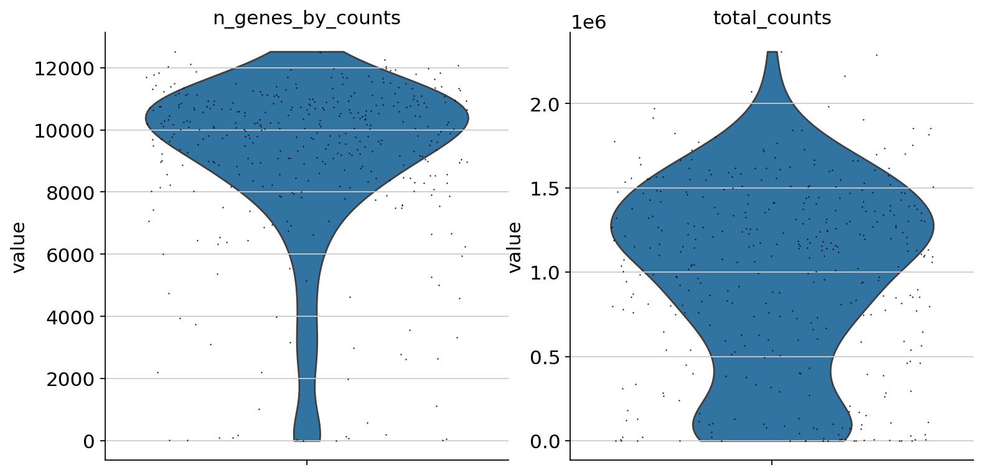

QC metrics for HCC1806:


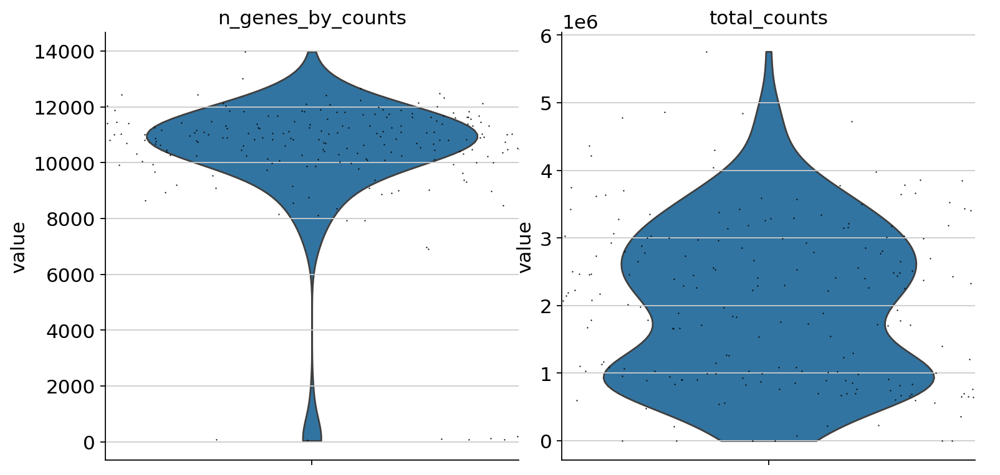

In [ ]:
sc.settings.set_figure_params(dpi=80, facecolor="white")

print("QC metrics for MCF7:")
# Calculate QC metrics for MCF76_ad
sc.pp.calculate_qc_metrics(MCF7_ad, inplace=True, log1p=False)
sc.pl.violin(MCF7_ad, ["n_genes_by_counts", "total_counts"], jitter=0.4, multi_panel=True)


print("QC metrics for HCC1806:")
# Calculate QC metrics for HCC1806_ad
sc.pp.calculate_qc_metrics(HCC1806_ad, inplace=True, log1p=False)
# Visualize QC metrics for HCC1806_ad with violin plots
sc.pl.violin(HCC1806_ad, ["n_genes_by_counts", "total_counts"], jitter=0.6, multi_panel=True)


The violin plots for both **MCF7** and **HCC1806** reveal the presence of cells with very low or extremely high total gene expression (**"total_counts"**). These outliers may indicate issues during sequencing, such as problems with dying or stressed cells. Given that they do not represent the true biological phenomenon we aim to study, we will exclude these cells from our analysis. Specifically, we will retain cells with total counts between 250,000 and 2,000,000 for **MCF7**, and between 250,000 and 5,000,000 for **HCC1806**.

Another parameter we evaluate is **"n_genes_by_counts"**, which represents the number of distinct genes detected in each cell, irrespective of their expression levels. Similar to the total counts, the violin plots suggest that we should remove cells with fewer than 5,000 genes for **MCF7** and fewer than 7,000 genes for **HCC1806**. A low number of genes might indicate issues such as sequencing failures or biological problems with the cells, and these will also be excluded from our study.

It’s worth noting that the violin plots for **n_genes_by_counts** are heavily right-skewed, indicating that there is no need to impose an upper bound on this parameter. From a biological standpoint, there is no reason to exclude cells with a high number of genes detected, as these could represent highly active or complex cells, and their inclusion is important for our analysis.


In [ ]:
# Filtering for MCF7
# remove cells with less than 250000 total counts
sc.pp.filter_cells(MCF7_ad, min_counts=250000)
# remove cells with more than 2000000 total counts
sc.pp.filter_cells(MCF7_ad, max_counts=2000000)
# remove cells with less than 5000 genes
sc.pp.filter_cells(MCF7_ad, min_genes=5000)


# Filtering for MCF7
# remove cells with less than 250000 total counts
sc.pp.filter_cells(HCC1806_ad, min_counts=250000)
# remove cells with more than 5000000 total counts
sc.pp.filter_cells(HCC1806_ad, max_counts=5000000)
# remove cells with less than 7000 genes
sc.pp.filter_cells(HCC1806_ad, min_genes=7000)



QC metrics for MCF7:


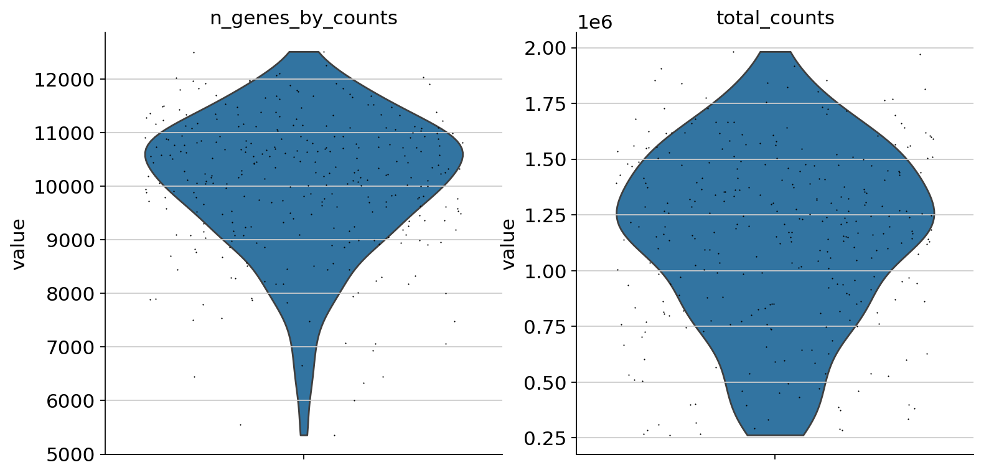

QC metrics for HCC1806:


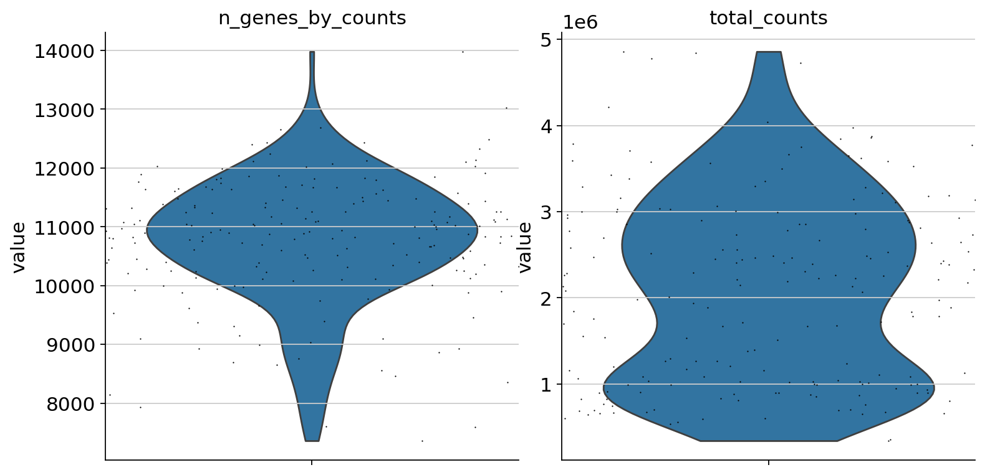

In [ ]:
print("QC metrics for MCF7:")
# Calculate QC metrics for MCF76_ad
sc.pp.calculate_qc_metrics(MCF7_ad, inplace=True, log1p=True)
sc.pl.violin(MCF7_ad, ["n_genes_by_counts", "total_counts"], jitter=0.4, multi_panel=True)


print("QC metrics for HCC1806:")
# Calculate QC metrics for HCC1806_ad
sc.pp.calculate_qc_metrics(HCC1806_ad, inplace=True, log1p=True)
# Visualize QC metrics for HCC1806_ad with violin plots
sc.pl.violin(HCC1806_ad, ["n_genes_by_counts", "total_counts"], jitter=0.6, multi_panel=True)

# First Feature Selection: unpopular genes

Our dataset is inherently **high-dimensional**, with more than 20,000 features in both the **MCF7** and **HCC1806** datasets. A key goal of this part of the project is to reduce the number of features in order to achieve better model performance and improved interpretability. Simplifying the dataset in this way is crucial, not only for optimizing our models but also for enhancing the utility of the results in the scientific community.

One of the first steps in this reduction process is to eliminate **genes that are expressed in very few cells**. These genes are unlikely to provide meaningful insights for our study, as they are often just noise. Moreover, genes that are rarely expressed are not good candidates for distinguishing between **hypoxia** and **normoxia** conditions, as their expression is too sparse to serve as reliable indicators.

As a benchmark, we will retain only the genes that are expressed in at least **6 cells** (roughly 2% of the dataset). This threshold helps ensure that we focus on genes with sufficient expression across the dataset while reducing the dimensionality to improve model efficiency and clarity.


In [ ]:
# Before filtering
print(f"Number of genes before filtering: {MCF7_ad.n_vars}")

# Filter genes expressed in at least 6 cells (i.e., remove genes expressed in fewer than 6 cells)
sc.pp.filter_genes(MCF7_ad, min_cells=6)

# After filtering
print(f"Number of genes after filtering: {MCF7_ad.n_vars}")


Number of genes before filtering: 22905
Number of genes after filtering: 18991


In [ ]:
# Before filtering, print the number of genes
print(f"Number of genes before filtering: {HCC1806_ad.n_vars}")

# Filter genes expressed in less than 6 cells
sc.pp.filter_genes(HCC1806_ad, min_cells=6)

# After filtering, print the number of genes remaining
print(f"Number of genes after filtering (min_cells=6): {HCC1806_ad.n_vars}")


Number of genes before filtering: 23342
Number of genes after filtering (min_cells=6): 19574


note: we don't filter genes by their total sum across cells because this may remove important genes! for example some gene s may be present in all cells in few quantities for some unknown reason and they could still be meaningful for normoxia e hypoxia classification. actually they may be even more important than others! (small changes in low expressed genes are more significant than the same absolute change in more common genes)
in fact this kind of filter is not introduced in scanpy

# Scaling

Now, we can proceed with the first normalization step to address the noise caused by varying total counts across the cells. If we don't scale the cells to the same level, those with higher gene expression (i.e., higher total counts) will disproportionately influence the models, leading to biased results. To ensure a fair comparison and avoid confounding factors, it's crucial to normalize the dataset so that the total counts are standardized across all cells. This will allow our models to focus on the relative gene expression levels, rather than being skewed by differences in total expression, ultimately improving the accuracy and robustness of our analysis.




First, we need to verify that total counts aren't linked with the conditions (hypoxia or normoxia), as this could introduce bias in our analysis. To do this, we will reconstruct the labels for the dataset from the **cell names**, which contain information about the condition each cell was exposed to. Once we have the labels, we can plot the total counts for each cell, grouped by their respective conditions (hypoxia or normoxia). This will help us visually assess whether there is any significant correlation between total counts and the experimental conditions, ensuring that our normalization process is unbiased and that any potential confounders are addressed before proceeding with further analysis.


In [ ]:
# Retrieve labels
def cell_label(adata):
    labels = []
    for cell_name in adata.obs_names:
        if 'Norm' in cell_name:
            labels.append('Norm')
        elif 'Hypo' in cell_name:
            labels.append('Hypo')
        else:
            print(f"Warning: Could not determine label for cell: {cell_name}")
            labels.append('UNKNOWN') # Use 'UNKNOWN' or some other indicator for unidentifiable cells

    # Add the labels to the .obs attribute of the AnnData object
    adata.obs['condition'] = labels

# Apply the function to your AnnData objects
cell_label(MCF7_ad)
cell_label(HCC1806_ad)

# print class distribution from the AnnData objects' .obs
print("MCF7:")
display(MCF7_ad.obs['condition'].value_counts())

print("\nHCC1806:")
display(HCC1806_ad.obs['condition'].value_counts())

MCF7:


,count
condition,
Norm,161
Hypo,155



HCC1806:


,count
condition,
Hypo,117
Norm,112


note: after the previous filtering the class balanced seems to be good (51%\49% for both MCF7 and HCC1806 )

QC metrics for MCF7:


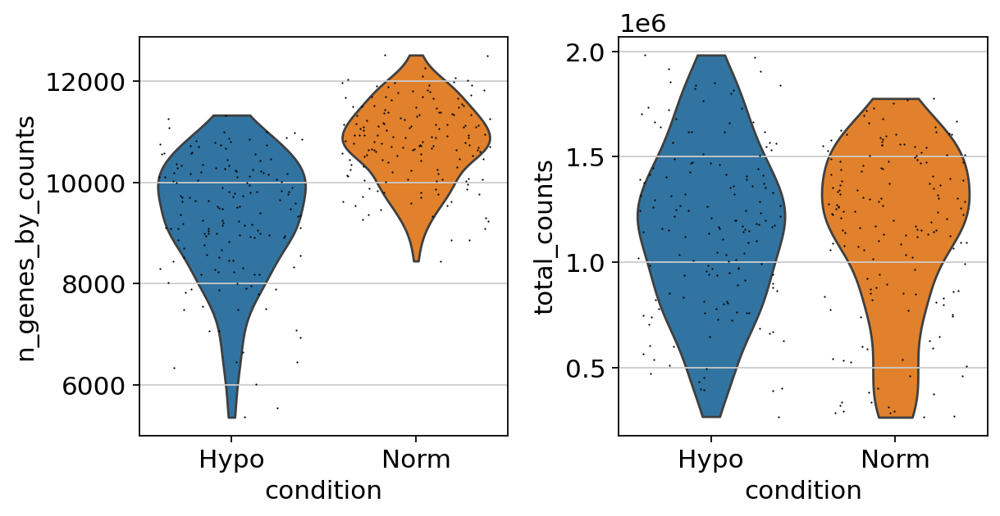

QC metrics for HCC1806:


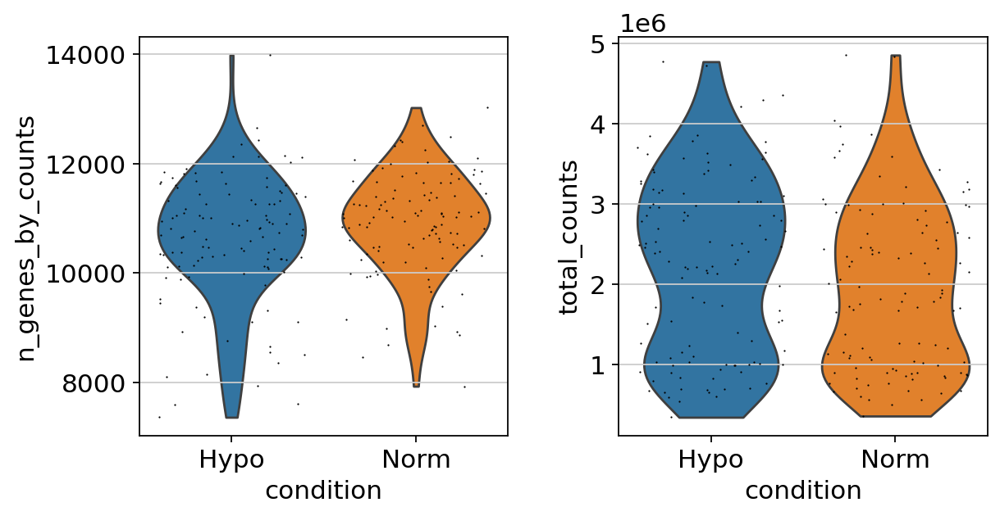

In [ ]:
print("QC metrics for MCF7:")
# plot total_counts between Norm and Hypo cells
sc.pl.violin(MCF7_ad, ["total_counts"], groupby="condition", jitter=0.4, multi_panel=True)

print("QC metrics for HCC1806:")
# plot total_counts between Norm and Hypo cells
sc.pl.violin(HCC1806_ad, ["total_counts"], groupby="condition", jitter=0.4, multi_panel=True)

The plots confirm that there is no significant correlation between total counts and the experimental conditions (hypoxia and normoxia), allowing us to proceed with scaling safely without losing important information about the conditions. To normalize the data, we will scale the cells so that all of them have the same total count. We set this value to be the **mean of the total counts** from the original data (before normalization). This step ensures that the influence of varying total counts is removed, allowing the model to focus on the relative gene expression levels across all cells while preserving the biological relevance of hypoxia and normoxia conditions.


In [ ]:
# calculates total counts mean
total_counts_mean_MCF7 = MCF7_ad.obs['total_counts'].mean()
total_counts_mean_HCC1806 = HCC1806_ad.obs['total_counts'].mean()
print(f"Mean total counts for MCF7: {total_counts_mean_MCF7}")
print(f"Mean total counts for HCC1806: {total_counts_mean_HCC1806}")

# apply scaling with respect to total counts
sc.pp.normalize_total(MCF7_ad, target_sum=total_counts_mean_MCF7)
sc.pp.normalize_total(HCC1806_ad, target_sum=total_counts_mean_HCC1806)

#recalculate metrics
sc.pp.calculate_qc_metrics(MCF7_ad, inplace=True,  log1p=False)
sc.pp.calculate_qc_metrics(HCC1806_ad, inplace=True, log1p=False)

Mean total counts for MCF7: 1157705.2183544303
Mean total counts for HCC1806: 2104782.6681222706


# Second Feature Selection: Highly Variable Genes


we are now ready to reduce the dimensionality of the dataset by selecting the most **informative** features — in this case, the **top 3000 highly variable genes**.

Single-cell RNA-seq data contains **thousands of genes**, but:
* Many of them are **not informative** (e.g., low expression across all cells),
* Some carry only **technical noise**,
* High-dimensional data increases computational cost and may introduce noise into clustering or classification.

By selecting only the most variable genes:
* We retain **biologically relevant variation**,
* Improve **computational efficiency**,
* Increase the **signal-to-noise ratio** in downstream analyses.

`Scanpy` computes for each gene:
* The **mean expression**,
* The **variance**,
* The **normalized dispersion** (variance adjusted for mean)

It then ranks genes based on dispersion and selects the top N.
 > In our case, we select the **top 3000 genes**, number large enough to preserve important features but small enough to allow for efficient computation.

/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)
/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


Highly Variable Genes plot for MCF7_ad:


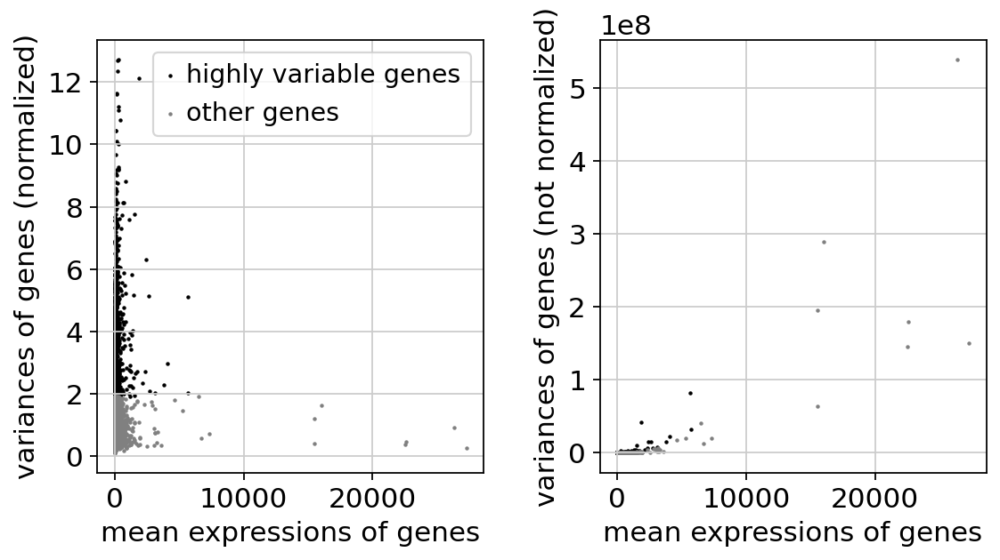


Highly Variable Genes plot for HCC1806_ad:


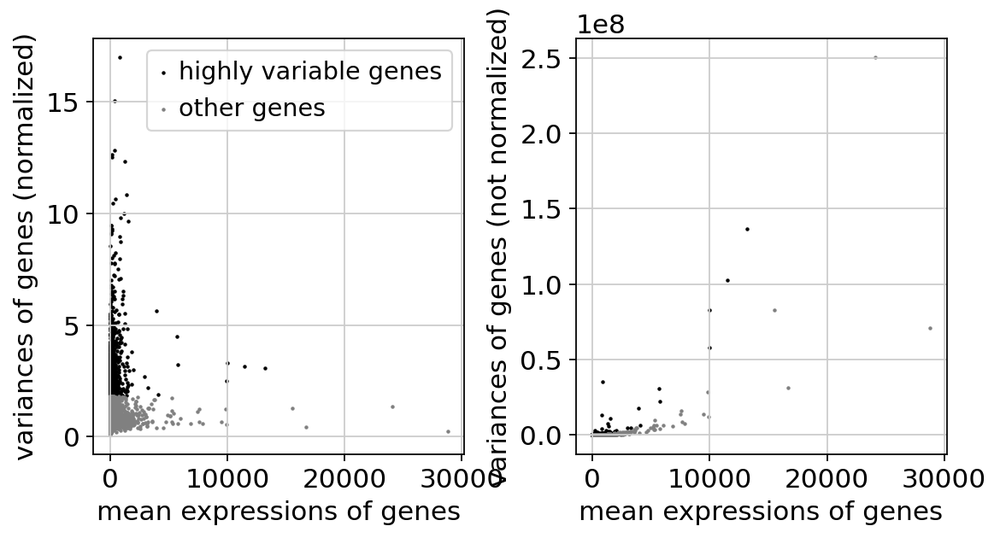

In [ ]:
import scanpy as sc
import matplotlib.pyplot as plt

# Calculate highly variable genes and store results in the AnnData object (.var and .uns)
# Using inplace=True so the plotting function can find the necessary information
sc.pp.highly_variable_genes(MCF7_ad, flavor="seurat_v3", inplace=True, n_top_genes=3000)
sc.pp.highly_variable_genes(HCC1806_ad, flavor="seurat_v3", inplace=True, n_top_genes=3000)


# Now, plot the highly variable genes based on the information stored in the AnnData object
print("Highly Variable Genes plot for MCF7_ad:")
sc.pl.highly_variable_genes(MCF7_ad)


print("\nHighly Variable Genes plot for HCC1806_ad:")
sc.pl.highly_variable_genes(HCC1806_ad)


the standard plot implemented by scanpy is not really clear so we will procede by doing a plot manually that will show clearly what are the criterion used for the feature selection

/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)
/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


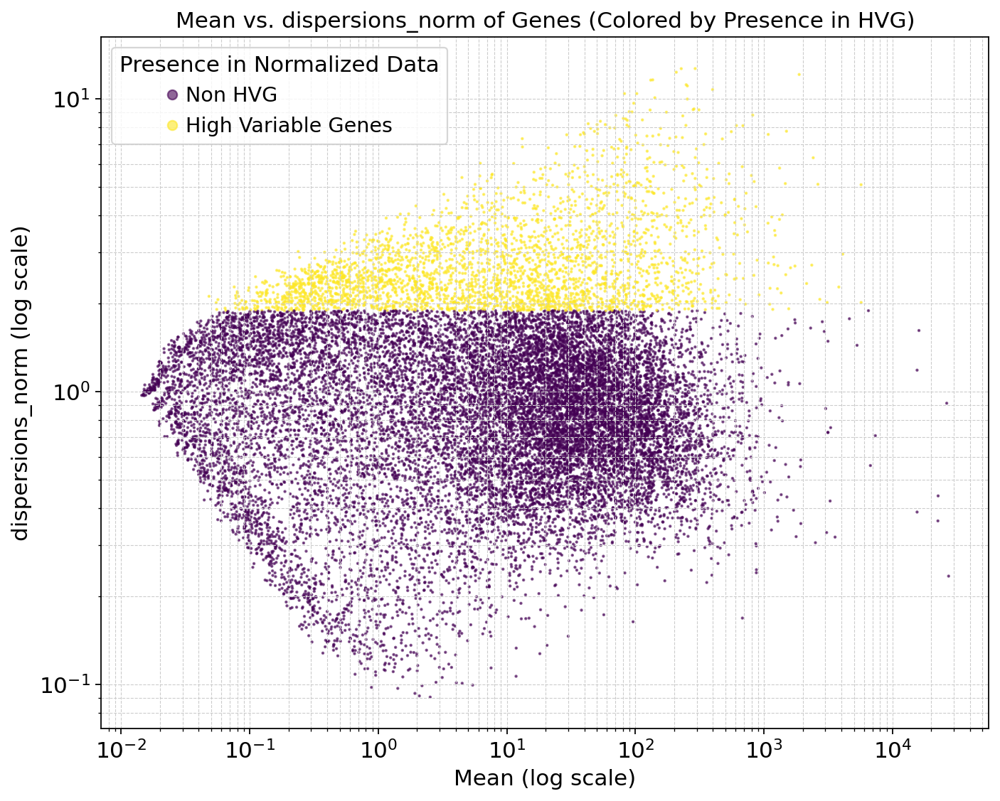

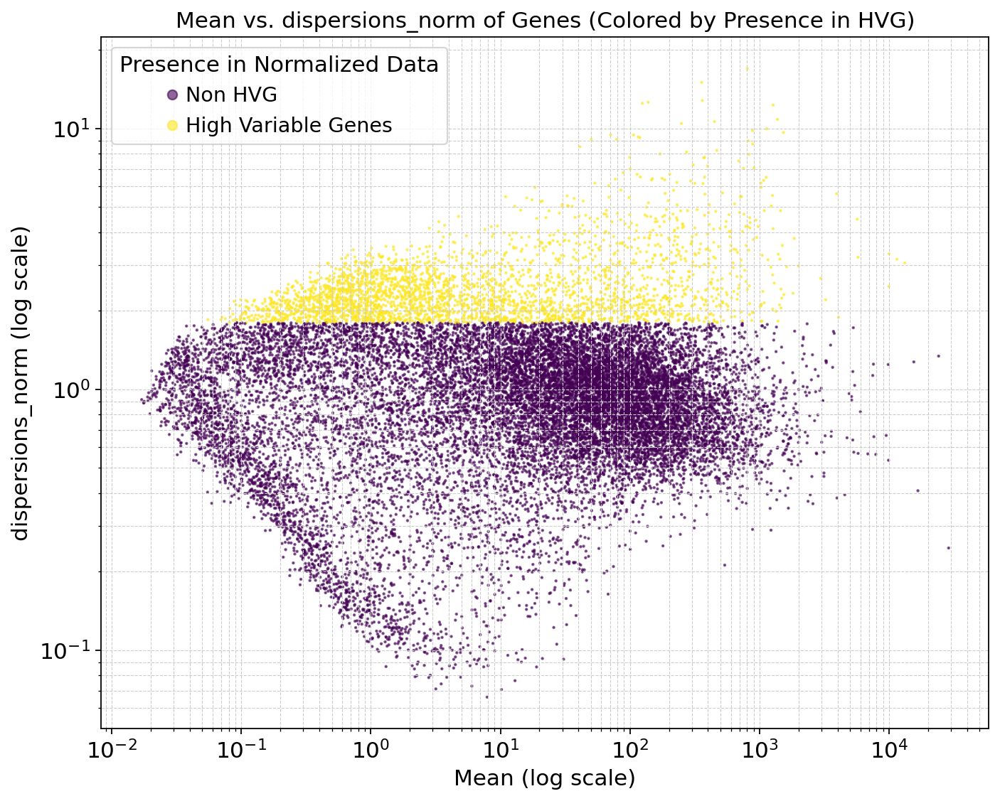

In [ ]:
import scanpy as sc
# Identify highly variable genes for MCF7_ad
# Running with inplace=False to get the results object
hvg_mcf7_results = sc.pp.highly_variable_genes(MCF7_ad, flavor="seurat_v3", inplace=False, n_top_genes=3000)

# Store the results needed for plotting in .uns
# Scanpy's plotting function expects this information to be stored here
MCF7_ad.uns['hvg'] = {
    'means': hvg_mcf7_results['means'].values,
    'dispersions_norm': hvg_mcf7_results['variances_norm'].values, # Note: seurat_v3 uses variances_norm for ranking
    'highly_variable': hvg_mcf7_results.highly_variable,
}


# Identify highly variable genes for HCC1806_ad
hvg_hcc_results = sc.pp.highly_variable_genes(HCC1806_ad, flavor="seurat_v3", inplace=False, n_top_genes=3000)

# Store the results needed for plotting in .uns
HCC1806_ad.uns['hvg'] = {
    'means': hvg_hcc_results['means'].values,
    'dispersions_norm': hvg_hcc_results['variances_norm'].values, # Note: seurat_v3 uses variances_norm for ranking
    'highly_variable': hvg_hcc_results.highly_variable,
}

# plot for MCF7
plt.figure(figsize=(10, 8))
scatter = plt.scatter(MCF7_ad.uns['hvg']['means'], MCF7_ad.uns['hvg']['dispersions_norm'], c=MCF7_ad.uns['hvg']['highly_variable'], cmap='viridis', s=1, alpha=0.6)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Mean (log scale)')
plt.ylabel('dispersions_norm (log scale)')
plt.title('Mean vs. dispersions_norm of Genes (Colored by Presence in HVG)')
legend_labels = ['Non HVG', 'High Variable Genes']
handles, _ = scatter.legend_elements()
plt.legend(handles, legend_labels, title="Presence in Normalized Data")
plt.grid(True, which="both", ls="--", linewidth=0.5)
plt.show()

# plot for HCC1806
plt.figure(figsize=(10, 8))
scatter = plt.scatter(HCC1806_ad.uns['hvg']['means'], HCC1806_ad.uns['hvg']['dispersions_norm'], c=HCC1806_ad.uns['hvg']['highly_variable'], cmap='viridis', s=1, alpha=0.6)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Mean (log scale)')
plt.ylabel('dispersions_norm (log scale)')
plt.title('Mean vs. dispersions_norm of Genes (Colored by Presence in HVG)')
legend_labels = ['Non HVG', 'High Variable Genes']
handles, _ = scatter.legend_elements()
plt.legend(handles, legend_labels, title="Presence in Normalized Data")
plt.grid(True, which="both", ls="--", linewidth=0.5)
plt.show()




we now proceed with the filtering

In [ ]:
# Filter the AnnData objects based on the highly variable genes identified
# Use the highly_variable boolean column from the results DataFrame
MCF7_ad = MCF7_ad[:, hvg_mcf7_results.highly_variable]
HCC1806_ad = HCC1806_ad[:, h

                        vg_hcc_results.highly_variable]

print(MCF7_ad.shape)
print(HCC1806_ad.shape)

(316, 3000)
(229, 3000)


# Data Visualization

In this section, we work on normalized and filtered data in order to:
- Evaluate feature variability
- Reveal intrinsic structures looking at the most variable genes
- Study gene-condition correlations


In [ ]:
import sys
import sklearn
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from mpl_toolkits.mplot3d import Axes3D


%matplotlib inline
sns.set(color_codes=True)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## MCF7 SmartSeq

In [ ]:
MCF7_SmartS = pd.read_csv(
    "/content/drive/MyDrive/AILAB/Project data/SmartSeq/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt",
    delimiter="\ ",
    engine='python',
    index_col=0
)

MCF7_SmartS = MCF7_SmartS.T
MCF7_SmartS.head()


,"""CYP1B1""","""CYP1B1-AS1""","""CYP1A1""","""NDRG1""","""DDIT4""","""PFKFB3""","""HK2""","""AREG""","""MYBL2""","""ADM""",...,"""CD27-AS1""","""DNAI7""","""MAFG""","""LZTR1""","""BCO2""","""GRIK5""","""SLC25A27""","""DENND5A""","""CDK5R1""","""FAM13A-AS1"""
"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""",343,140,0,0,386,75,0,0,476,0,...,63,0,17,59,0,0,0,51,0,0
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",131,59,0,1,289,42,0,856,1586,0,...,0,0,1,25,0,0,0,34,0,0
"""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""",452,203,0,0,0,0,0,0,775,0,...,15,0,23,0,0,0,0,0,0,0
"""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""",27,7,0,0,288,214,15,242,1191,0,...,1,0,3,10,0,0,0,4,0,0
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",5817,2669,0,654,2484,1603,748,436,0,0,...,0,0,63,0,0,0,0,60,0,0


In [ ]:
# Retrieve labels
def get_MCF7_cell_labels(dataframe):
    MCF7_SmartS_labels = []
    for cell in MCF7_SmartS.index:
        if 'Norm' in cell:
            MCF7_SmartS_labels.append(0)
        elif 'Hypo' in cell:
            MCF7_SmartS_labels.append(1)
        else:
            print(f"Warning: Could not determine label for cell: {cell}")
            MCF7_SmartS_labels.append('UNKNOWN')

    return MCF7_SmartS_labels


In [ ]:
# Applying to MCF7 SmartSeq data
MCF7_SmartS_labels = get_MCF7_cell_labels(MCF7_SmartS)


In [ ]:
# Assign the labels to the dataframe
MCF7_SmartS['Condition'] = MCF7_SmartS_labels

MCF7_SmartS.head()

,"""CYP1B1""","""CYP1B1-AS1""","""CYP1A1""","""NDRG1""","""DDIT4""","""PFKFB3""","""HK2""","""AREG""","""MYBL2""","""ADM""",...,"""DNAI7""","""MAFG""","""LZTR1""","""BCO2""","""GRIK5""","""SLC25A27""","""DENND5A""","""CDK5R1""","""FAM13A-AS1""",Condition
"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""",343,140,0,0,386,75,0,0,476,0,...,0,17,59,0,0,0,51,0,0,0
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",131,59,0,1,289,42,0,856,1586,0,...,0,1,25,0,0,0,34,0,0,0
"""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""",452,203,0,0,0,0,0,0,775,0,...,0,23,0,0,0,0,0,0,0,0
"""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""",27,7,0,0,288,214,15,242,1191,0,...,0,3,10,0,0,0,4,0,0,0
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",5817,2669,0,654,2484,1603,748,436,0,0,...,0,63,0,0,0,0,60,0,0,1


In [ ]:
# Display the first few labels for MCF7 and HCC1806
print("MCF7 Labels Head:", MCF7_SmartS_labels[:20])

# Check the distribution of labels
print("MCF7 Hypoxia count:", sum(np.array(MCF7_SmartS_labels) == 1))  # Hypoxia = 1
print("MCF7 Normoxia count:", sum(np.array(MCF7_SmartS_labels) == 0))  # Normoxia = 0


MCF7 Labels Head: [0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0]
MCF7 Hypoxia count: 124
MCF7 Normoxia count: 126


We compute variance per gene to identify those whose expression varies most across the cells. Highly variable genes are more likely to capture meaningful biological differences rather than technical noise. Selecting the top variable genes reduces dimensionality and focuses analysis on informative features.

In [ ]:
# 1. Compute the variance for each gene
gene_variances = MCF7_SmartS.var(axis=0)

# 2. Descending order
gene_variances_sorted = gene_variances.sort_values(ascending=False)

# 3. Print the 10 most variable genes
top10 = gene_variances_sorted.head(10)
print(top10)


"GAPDH"     5.338277e+08
"ACTG1"     2.743522e+08
"ALDOA"     1.982273e+08
"CYP1B1"    6.859712e+07
"FTH1"      5.042005e+07
"BEST1"     4.025752e+07
"CYP1A1"    3.200615e+07
"UBC"       2.206103e+07
"MT-CO1"    2.017052e+07
"PGK1"      2.015048e+07
dtype: float64


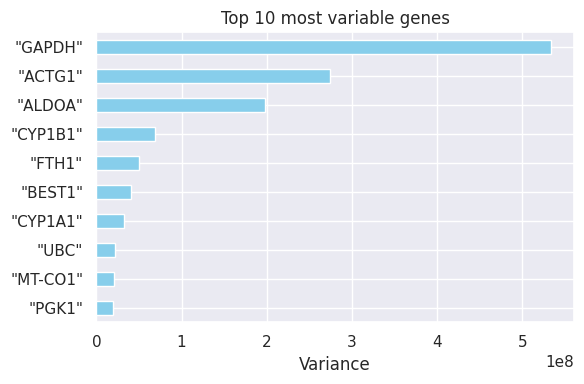

In [ ]:
plt.figure(figsize=(6, 4))
top10.sort_values().plot.barh(color='skyblue')
plt.xlabel('Variance')
plt.title('Top 10 most variable genes')
plt.tight_layout()
plt.show()


We plot data points in 3D based on the three most variable genes to see if those top features alone separate the data into meaningful groups. Since these genes show the largest expression differences across cells, they might drive major distinctions (e.g. different cells conditions). However, it is a limited point of view. It serves mainly as an intuitive, explanatory check.

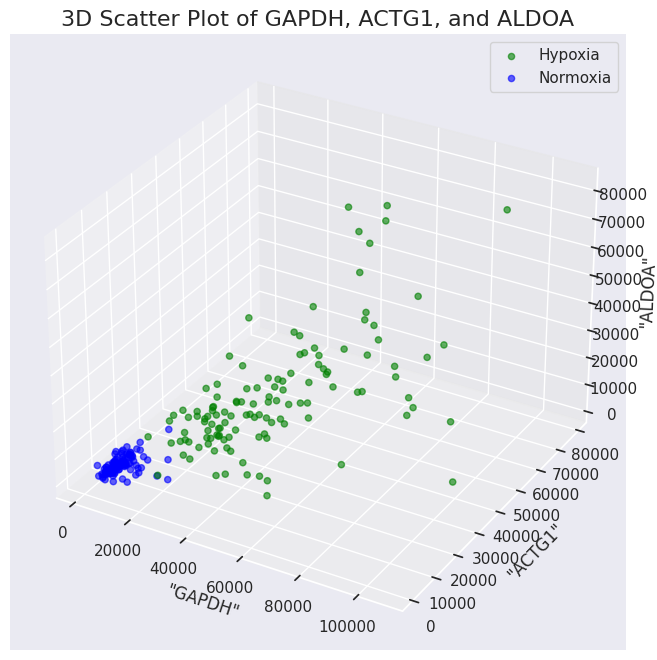

In [ ]:
MCF7_SmartS_labels = np.array(MCF7_SmartS_labels)

# Gene names
gene1 = '"GAPDH"'
gene2 = '"ACTG1"'
gene3 = '"ALDOA"'

# Extract the expression values for each gene
x = MCF7_SmartS[gene1].values
y = MCF7_SmartS[gene2].values
z = MCF7_SmartS[gene3].values

# Define Hypoxia and Normoxia cell indices
hypoxia_indices = MCF7_SmartS_labels == 1
normoxia_indices = MCF7_SmartS_labels == 0


# Create figure for 3D plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the points: Hypoxia in green and Normoxia in blue
ax.scatter(x[hypoxia_indices], y[hypoxia_indices], z[hypoxia_indices], color='green', label="Hypoxia", alpha=0.6)
ax.scatter(x[normoxia_indices], y[normoxia_indices], z[normoxia_indices], color='blue', label="Normoxia", alpha=0.6)

# Set axis labels with the gene names
ax.set_xlabel(gene1)
ax.set_ylabel(gene2)
ax.set_zlabel(gene3)

# Set the title of the plot
plt.title(f"3D Scatter Plot of GAPDH, ACTG1, and ALDOA", fontsize=16)

# Add legend
ax.legend()

# Show the plot
plt.show()


Now we will look for correlations between cells. We will be especially interested in seeing how the correlation coefficients between cells are affected by their condition as hypoxic and normoxic.





In [ ]:
cells_MCF7_SmartS_corr = MCF7_SmartS.T.corr()
cells_MCF7_SmartS_corr


,"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""","""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""","""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""","""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""","""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""","""output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C1_Norm_S103_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C2_Norm_S104_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam"""
"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""",1.000000,0.774601,0.790232,0.859749,0.660565,0.587611,0.612781,0.585614,0.750148,0.768098,...,0.646239,0.669120,0.804434,0.850049,0.561887,0.821150,0.725409,0.468336,0.606190,0.616040
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",0.774601,1.000000,0.855710,0.881571,0.619379,0.631441,0.538967,0.549878,0.838939,0.953488,...,0.593432,0.560002,0.700697,0.806028,0.670168,0.673585,0.623853,0.331928,0.582159,0.572364
"""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""",0.790232,0.855710,1.000000,0.886493,0.511315,0.449840,0.443987,0.425210,0.773678,0.823531,...,0.459636,0.491474,0.762443,0.880564,0.596149,0.714564,0.615690,0.333670,0.469177,0.454840
"""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""",0.859749,0.881571,0.886493,1.000000,0.677903,0.595703,0.646283,0.608961,0.849299,0.872792,...,0.641504,0.662425,0.798479,0.838908,0.626056,0.816505,0.787364,0.400823,0.624994,0.657105
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",0.660565,0.619379,0.511315,0.677903,1.000000,0.853558,0.943894,0.907780,0.684276,0.659452,...,0.932738,0.895277,0.482517,0.568329,0.466537,0.810790,0.824356,0.567567,0.896207,0.946376
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""",0.821150,0.673585,0.714564,0.816505,0.810790,0.637821,0.783582,0.724684,0.721987,0.703129,...,0.788931,0.830742,0.746761,0.795269,0.611849,1.000000,0.864337,0.517414,0.703745,0.771752
"""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam""",0.725409,0.623853,0.615690,0.787364,0.824356,0.622479,0.822475,0.769769,0.698528,0.650932,...,0.820806,0.853566,0.594907,0.647811,0.568661,0.864337,1.000000,0.456578,0.715448,0.822594
"""output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam""",0.468336,0.331928,0.333670,0.400823,0.567567,0.489911,0.585373,0.596093,0.394065,0.349635,...,0.597801,0.659018,0.362409,0.383213,0.389584,0.517414,0.456578,1.000000,0.710331,0.505542
"""output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam""",0.606190,0.582159,0.469177,0.624994,0.896207,0.864602,0.907751,0.922011,0.640972,0.605407,...,0.880819,0.835550,0.443830,0.514385,0.414328,0.703745,0.715448,0.710331,1.000000,0.901336


In [ ]:
# Get the indices for Hypoxia and Normoxia cells
MCF7_SmartS_labels = np.array(MCF7_SmartS_labels)

MCF7_SmartS_cells_hypo = MCF7_SmartS.index[MCF7_SmartS_labels == 1]
MCF7_SmartS_cells_norm = MCF7_SmartS.index[MCF7_SmartS_labels == 0]

# Combine the indices for Hypoxia and Normoxia into a single index
combined_cells = pd.Index(np.concatenate([MCF7_SmartS_cells_hypo, MCF7_SmartS_cells_norm]))

# Subset the correlation matrix using the combined cells' index
MCF7_SmartS_cells_heat = cells_MCF7_SmartS_corr.loc[combined_cells, combined_cells]

# Display the first few rows of the correlation matrix
MCF7_SmartS_cells_heat.head()



,"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""","""output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C8_Hypo_S128_Aligned.sortedByCoord.out.bam""","""output.STAR.2_C9_Hypo_S129_Aligned.sortedByCoord.out.bam""","""output.STAR.2_D10_Hypo_S178_Aligned.sortedByCoord.out.bam""","""output.STAR.2_D11_Hypo_S179_Aligned.sortedByCoord.out.bam""","""output.STAR.2_D12_Hypo_S180_Aligned.sortedByCoord.out.bam""","""output.STAR.2_D7_Hypo_S175_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.4_G2_Norm_S308_Aligned.sortedByCoord.out.bam""","""output.STAR.4_G3_Norm_S309_Aligned.sortedByCoord.out.bam""","""output.STAR.4_G4_Norm_S310_Aligned.sortedByCoord.out.bam""","""output.STAR.4_G5_Norm_S311_Aligned.sortedByCoord.out.bam""","""output.STAR.4_G6_Norm_S312_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam""","""output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam"""
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",1.000000,0.853558,0.943894,0.907780,0.947889,0.928969,0.942440,0.929586,0.904214,0.917780,...,0.521098,0.823651,0.744594,0.556491,0.859481,0.482517,0.568329,0.466537,0.810790,0.824356
"""output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam""",0.853558,1.000000,0.854574,0.857325,0.823215,0.747239,0.811925,0.852001,0.808755,0.838257,...,0.452976,0.630844,0.615656,0.457772,0.702187,0.403549,0.506252,0.385772,0.637821,0.622479
"""output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam""",0.943894,0.854574,1.000000,0.944615,0.956764,0.943315,0.954937,0.963948,0.888316,0.920638,...,0.452152,0.797808,0.738851,0.508409,0.838035,0.398604,0.487881,0.421885,0.783582,0.822475
"""output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam""",0.907780,0.857325,0.944615,1.000000,0.899896,0.894689,0.917131,0.952381,0.828349,0.949431,...,0.428407,0.753076,0.708680,0.469881,0.808420,0.379918,0.467653,0.404469,0.724684,0.769769
"""output.STAR.2_C8_Hypo_S128_Aligned.sortedByCoord.out.bam""",0.947889,0.823215,0.956764,0.899896,1.000000,0.960227,0.979015,0.953262,0.892296,0.899419,...,0.513694,0.871815,0.789851,0.563267,0.889222,0.464877,0.543800,0.483186,0.832685,0.894389


We'll now plot the full correlation matrix. We will order the cells by choosing all hypoxic cells first, then all normoxic cells.



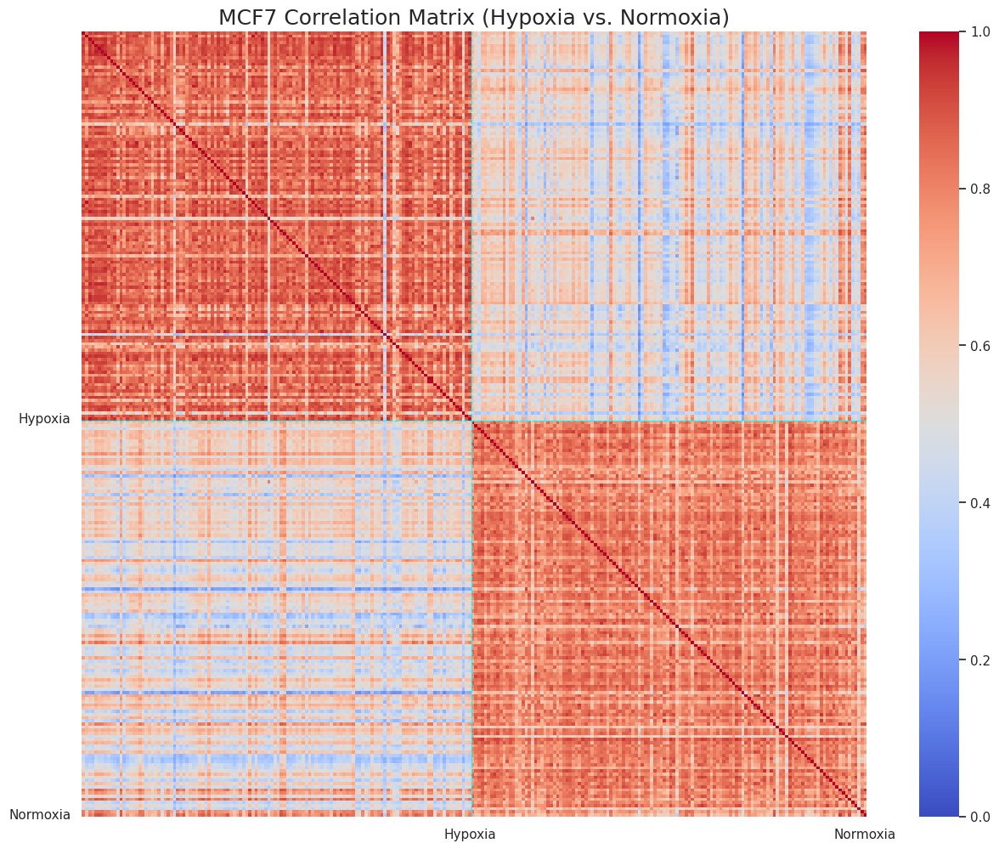

In [ ]:
# Create the heatmap for the correlation matrix
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap
sns.heatmap(MCF7_SmartS_cells_heat, vmax=1, vmin=0, cmap='coolwarm',
            cbar=True, square=True, annot=False, fmt='.2f', ax=ax)

hypoxia_pos = sum(MCF7_SmartS_labels == 1)  # Number of Hypoxia cells
normoxia_pos = sum(MCF7_SmartS_labels == 0)  # Number of Normoxia cells

# Add the cyan dashed lines to visually separate the conditions
plt.plot([0, MCF7_SmartS_cells_heat.shape[0]], [hypoxia_pos, hypoxia_pos], color='cyan', linestyle='dashed', linewidth=1)
plt.plot([hypoxia_pos, hypoxia_pos], [0, MCF7_SmartS_cells_heat.shape[0]], color='cyan', linestyle='dashed', linewidth=1)

# Add labels for Hypoxia and Normoxia
plt.yticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)
plt.xticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)

# Set the title for the plot
plt.title("MCF7 Correlation Matrix (Hypoxia vs. Normoxia)", fontsize=18)

# Show the plot
plt.show()


The heatmap displays the correlation between cells under **Hypoxia** and **Normoxia** conditions.

- **High Intra-group Correlation**: Cells within each group (Hypoxia and Normoxia) show high correlation, indicating similar gene expression profiles within each condition.
- **Lower Inter-group Correlation**: The correlation between Hypoxia and Normoxia cells is generally low, suggesting distinct gene expression patterns between the two conditions.
- **Condition-Specific Effects**: The **cyan dashed lines** separate Hypoxia and Normoxia cells, highlighting the shift in correlation when transitioning between these conditions.

Overall, the heatmap indicates that **Hypoxia** and **Normoxia** conditions influence gene expression differently, with shared patterns within each condition.


Now we move to the correlations between genes. Additionally, we will also compute the correlation coefficients between the state of Hypoxia itself and every gene. Our hope is that the genes with the highest correlation coefficients will help us to classify cells.



In [ ]:
MCF7_SmartS_corr = pd.concat([MCF7_SmartS, pd.DataFrame(MCF7_SmartS_labels)], axis=1)

genes_MCF7_SmartS_corr = MCF7_SmartS_corr.corr()

genes_MCF7_SmartS_corr



,"""CYP1B1""","""CYP1B1-AS1""","""CYP1A1""","""NDRG1""","""DDIT4""","""PFKFB3""","""HK2""","""AREG""","""MYBL2""","""ADM""",...,"""MAFG""","""LZTR1""","""BCO2""","""GRIK5""","""SLC25A27""","""DENND5A""","""CDK5R1""","""FAM13A-AS1""",Condition,0
"""CYP1B1""",1.000000,0.997795,0.593774,0.560694,0.520899,0.532185,0.292667,0.056826,-0.363150,0.314091,...,0.177321,-0.138145,0.028724,0.063363,0.051859,0.265881,-0.132084,0.120918,0.629088,NaN
"""CYP1B1-AS1""",0.997795,1.000000,0.598030,0.559756,0.515502,0.520769,0.286328,0.059063,-0.361333,0.318115,...,0.178250,-0.137046,0.037910,0.060017,0.054125,0.255479,-0.136064,0.116544,0.625117,NaN
"""CYP1A1""",0.593774,0.598030,1.000000,0.261127,0.197147,0.216860,0.087630,-0.108898,-0.172864,0.084399,...,0.083635,-0.138159,-0.026439,-0.023969,-0.002834,0.017755,-0.059489,0.069430,0.286278,NaN
"""NDRG1""",0.560694,0.559756,0.261127,1.000000,0.536380,0.708897,0.547689,0.252159,-0.377441,0.302131,...,0.402432,-0.186502,0.106568,0.015148,0.010418,0.417809,-0.147495,0.259563,0.774321,NaN
"""DDIT4""",0.520899,0.515502,0.197147,0.536380,1.000000,0.630200,0.445286,0.209773,-0.325189,0.409665,...,0.109367,-0.105898,0.009310,0.138362,0.054567,0.289791,-0.108668,0.125959,0.632216,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""DENND5A""",0.265881,0.255479,0.017755,0.417809,0.289791,0.412656,0.243846,0.165175,-0.245569,0.181252,...,0.491679,-0.112467,-0.038432,-0.015338,0.128539,1.000000,-0.098966,0.480915,0.406133,NaN
"""CDK5R1""",-0.132084,-0.136064,-0.059489,-0.147495,-0.108668,-0.159124,-0.117175,-0.068443,0.071951,-0.045959,...,-0.038979,-0.028937,0.028014,-0.039279,-0.044508,-0.098966,1.000000,-0.040079,-0.153850,NaN
"""FAM13A-AS1""",0.120918,0.116544,0.069430,0.259563,0.125959,0.136741,0.121475,-0.061664,-0.148930,0.079236,...,0.694760,-0.114312,-0.010868,-0.033450,0.005388,0.480915,-0.040079,1.000000,0.259552,NaN
Condition,0.629088,0.625117,0.286278,0.774321,0.632216,0.640760,0.461548,0.335145,-0.453473,0.389420,...,0.339643,-0.153698,0.086899,0.113163,0.076604,0.406133,-0.153850,0.259552,1.000000,NaN


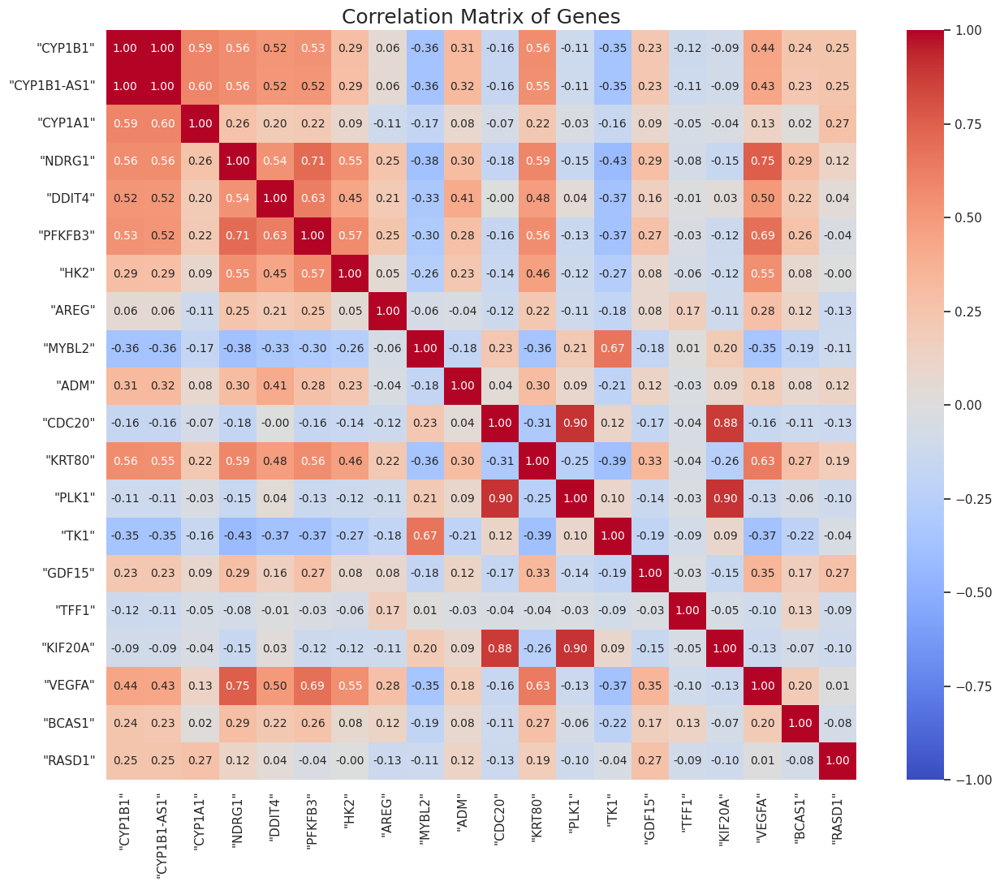

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap of gene correlations (top 20 genes)
sns.heatmap(genes_MCF7_SmartS_corr.iloc[:20, :20], vmax=1, vmin=-1, cmap='coolwarm',
            annot=True, fmt='.2f', annot_kws={'size': 10}, cbar=True, square=True, ax=ax)

plt.title("Correlation Matrix of Genes", fontsize=18)
plt.show()


Clearly, it is hard to find trends in the correlations between randomly sampled genes. Therefore, we will want the correlations of genes among which we expect to have some sort of relationship.  

We'll turn our attention to the correlations between genes and the state of hypoxia. We'll sort the genes based on their correlation with hypoxia, choose the first 20 and plot the heatmap of their correlation matrix.

In [ ]:
MCF7_SmartS_cells_hypo_corr = pd.Series.sort_values((genes_MCF7_SmartS_corr["Condition"]), ascending=False)

important_genes = list(MCF7_SmartS_cells_hypo_corr.index[:20])


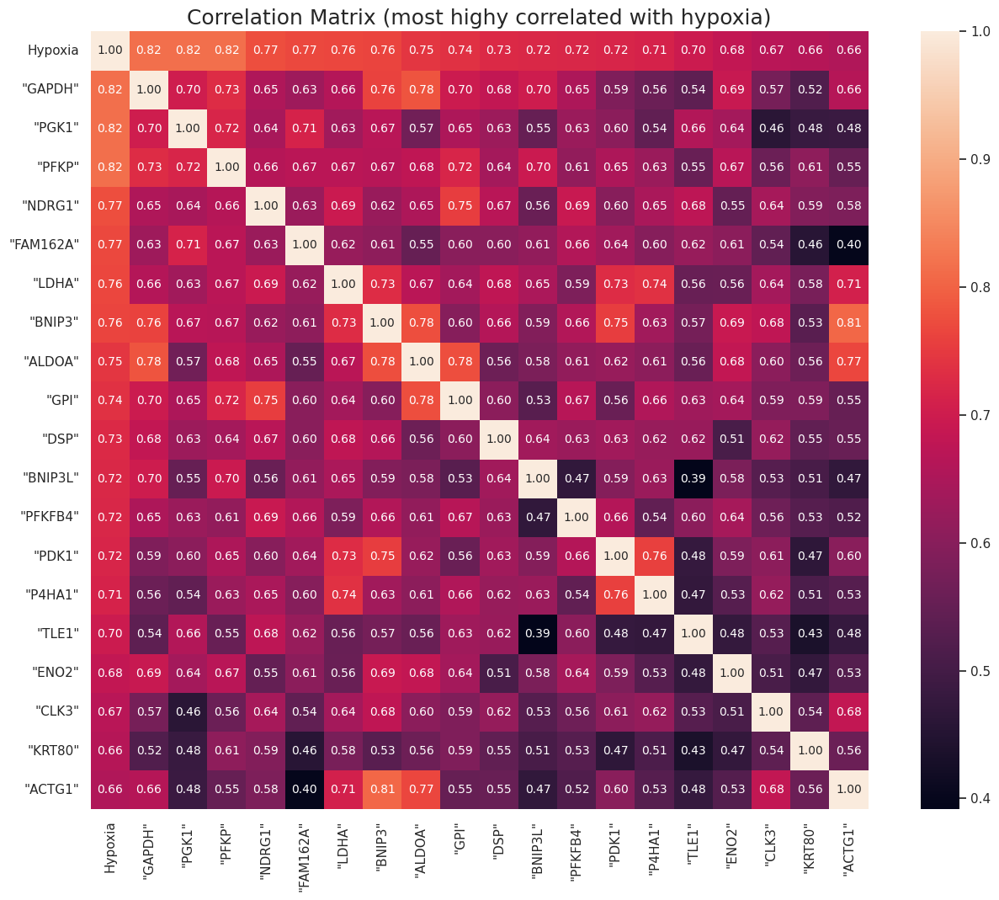

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))
sns.heatmap(genes_MCF7_SmartS_corr.loc[important_genes, important_genes], vmax=1,
            cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10})
plt.yticks([i+0.5 for i in range(20)], ['Hypoxia'] + important_genes[1:])
plt.xticks([i+0.5 for i in range(20)], ['Hypoxia'] + important_genes[1:])
plt.title("Correlation Matrix (most highy correlated with hypoxia)", fontsize=18);


Conclusion from the Correlation Matrix (Hypoxia vs. Genes):

The heatmap reveals the correlation between genes and the **Hypoxia condition**. Key findings include:

1. **Strong Positive Correlation**: Genes like **PGK1**, **DDIT4**, **BNIP3**, and **SLC2A1** show a high positive correlation with Hypoxia, indicating they play a key role in the cellular response to low oxygen.
  
2. **Moderate Correlations**: Genes such as **BNIP3L**, **BHLHE40**, and **PDK1** show moderate correlations, suggesting involvement in Hypoxia response but to a lesser extent.

3. **Negative Correlations**: Some genes, like **IGFBP3** and **PLOD2**, are negatively correlated with Hypoxia, indicating they might be downregulated under low oxygen conditions.

4. **Biological Implications**: The strongly correlated genes are likely involved in key adaptive processes like glycolysis and cell survival during Hypoxia, while negatively correlated genes may be linked to processes that are suppressed in low oxygen.

In Summary, the correlation matrix highlights important genes and pathways that are regulated in response to Hypoxia, offering insights into cellular adaptation to low oxygen.


Now we'll plot a series of boxplots showing the count distribution of the nine genes most highly correlated with hypoxia over normoxic and hypoxic cells.

<ipython-input-18-4189456984>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7_SmartS_labels), y = MCF7_SmartS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-18-4189456984>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7_SmartS_labels), y = MCF7_SmartS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-18-4189456984>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7_SmartS_labels), y = MCF7_SmartS[gene], p

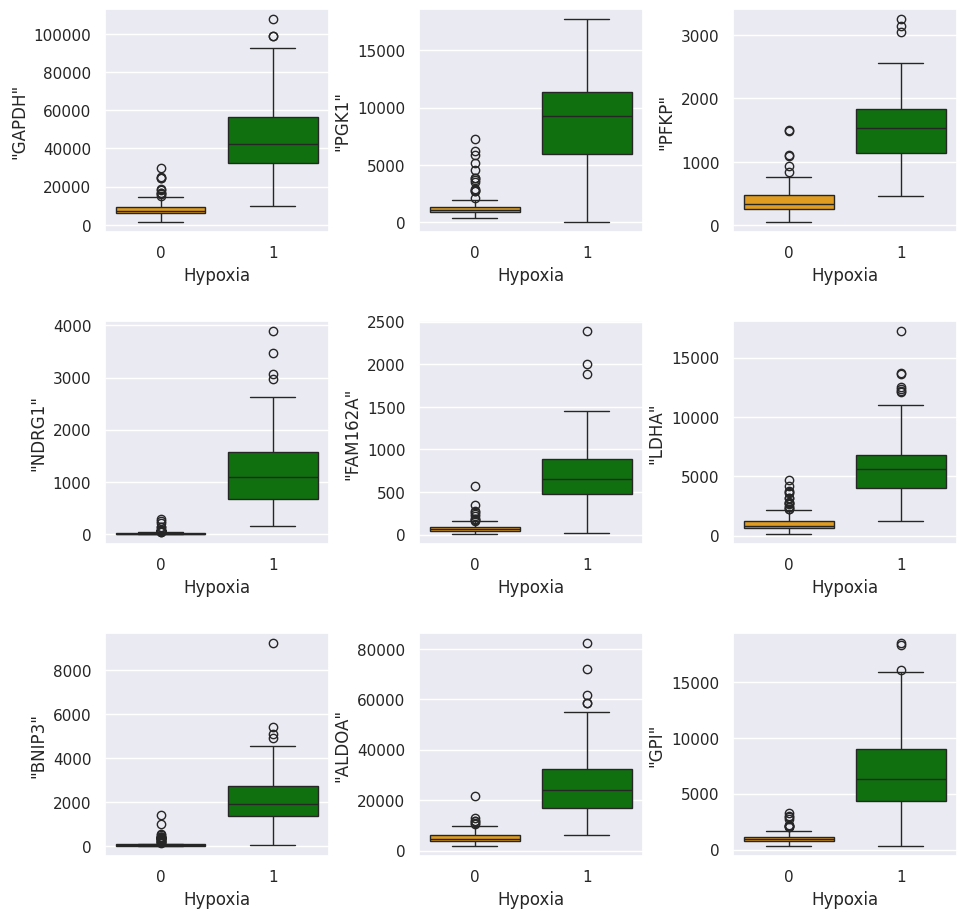

In [ ]:
fig, ax = plt.subplots(3, 3, figsize=(11, 11))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
def find_subplot(i):
  j = i
  r = j//3
  c = j - r*3
  return (r, c)
for i in range(0, 9):
  row, col = find_subplot(i)
  gene = MCF7_SmartS_cells_hypo_corr.index[i+1]

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7_SmartS_labels), y = MCF7_SmartS[gene], palette={'0': 'orange', '1': 'green'})
  ax[row, col].set_xlabel("Hypoxia")

The boxplots and heatmap show that when these genes have **elevated expression**, cells are almost always hypoxic. This suggests they serve as a concise “signature” for hypoxia, allowing us to classify cell state using only a handful of markers rather than a high‐dimensional profile.

Next, by plotting each cell in the space defined by the three most highly correlated genes—colored by Hypoxia vs. Normoxia, we can visually confirm that the two populations occupy distinct regions, reinforcing the power of this small gene set for accurate classification.


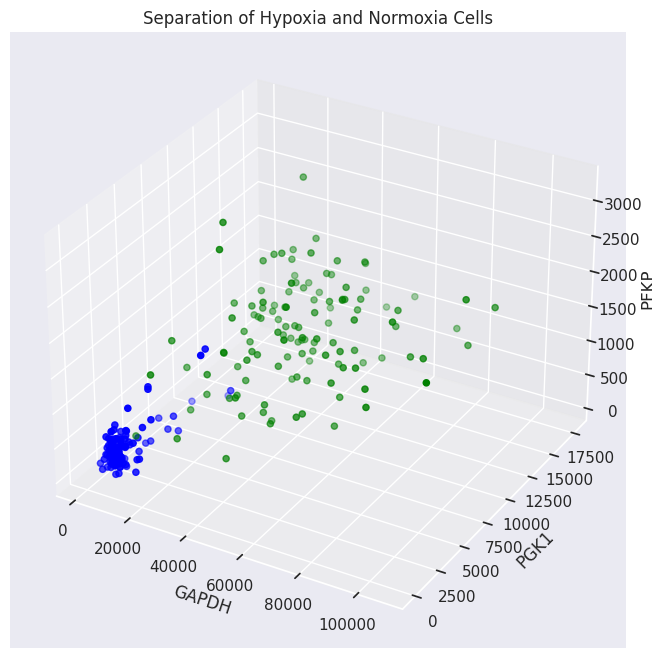

In [ ]:
from mpl_toolkits import mplot3d

MCF7_SmartS_hypo_ind = np.where(MCF7_SmartS_corr.loc[:, "Condition"] == 1)
MCF7_SmartS_norm_ind = np.where(MCF7_SmartS_corr.loc[:, "Condition"] == 0)

MCF7_SmartS_ga_hypo = MCF7_SmartS_corr.iloc[MCF7_SmartS_hypo_ind].loc[:, '"GAPDH"']
MCF7_SmartS_pg_hypo = MCF7_SmartS_corr.iloc[MCF7_SmartS_hypo_ind].loc[:, '"PGK1"']
MCF7_SmartS_pf_hypo = MCF7_SmartS_corr.iloc[MCF7_SmartS_hypo_ind].loc[:, '"PFKP"']

MCF7_SmartS_ga_norm = MCF7_SmartS_corr.iloc[MCF7_SmartS_norm_ind].loc[:, '"GAPDH"']
MCF7_SmartS_pg_norm = MCF7_SmartS_corr.iloc[MCF7_SmartS_norm_ind].loc[:, '"PGK1"']
MCF7_SmartS_pf_norm = MCF7_SmartS_corr.iloc[MCF7_SmartS_norm_ind].loc[:, '"PFKP"']


# Creating figure
fig = plt.figure(figsize = (12, 8))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(MCF7_SmartS_ga_hypo, MCF7_SmartS_pg_hypo, MCF7_SmartS_pf_hypo, color = "green")
ax.scatter3D(MCF7_SmartS_ga_norm, MCF7_SmartS_pg_norm, MCF7_SmartS_pf_norm, color = "blue")
lbl_x = ax.set_xlabel('GAPDH')
lbl_y = ax.set_ylabel('PGK1')
lbl_z = ax.set_zlabel('PFKP')

lbl_x.set_rotation(30)
lbl_y.set_rotation(45)
lbl_z.set_rotation(90)

plt.title("Separation of Hypoxia and Normoxia Cells")

# show plot
plt.show()


## HCC1806 SmartSeq

In [ ]:
HCC1806_SmartS = pd.read_csv(
    "/content/drive/MyDrive/AILAB/Project data/SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt",
    delimiter="\ ",
    engine='python',
    index_col=0
)
HCC1806_SmartS = HCC1806_SmartS.T


In [ ]:
def get_HCC_cell_labels(dataframe):
    HCC_SmartS_labels = []
    for cell in HCC1806_SmartS.index:
        if 'Norm' in cell:
            HCC_SmartS_labels.append(0)
        elif 'Hypo' in cell:
            HCC_SmartS_labels.append(1)
        else:
            print(f"Warning: Could not determine label for cell: {cell}")
            HCC_SmartS_labels.append('UNKNOWN')

    return HCC_SmartS_labels

In [ ]:
# Applying to HCC1806 SmartSeq data
HCC_SmartS_labels = get_HCC_cell_labels(HCC1806_SmartS)


In [ ]:
# Assign the labels to the dataframe
HCC1806_SmartS['Condition'] = HCC_SmartS_labels

HCC1806_SmartS.head()

,"""DDIT4""","""ANGPTL4""","""CALML5""","""KRT14""","""CCNB1""","""IGFBP3""","""AKR1C2""","""KRT6A""","""NDRG1""","""KRT4""",...,"""ZYG11A""","""NRG1""","""RBMS3""","""VCPIP1""","""LINC02693""","""OR8B9P""","""NEAT1""","""ZDHHC23""","""ODAD2""",Condition
"""output.STAR.PCRPlate1G12_Normoxia_S32_Aligned.sortedByCoord.out.bam""",0,48,0,321,298,82,6250,634,0,0,...,10,136,0,0,29,0,29,0,0,0
"""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""",8739,2101,55,96,1824,1938,62,0,522,413,...,0,264,0,134,68,0,213,0,0,1
"""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""",13098,14032,0,0,1616,247,430,907,348,0,...,0,38,0,0,0,0,92,0,0,1
"""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""",2880,356,0,6211,3,3430,79,1953,592,176,...,0,16,0,4,1,0,1,0,0,1
"""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""",7777,5661,4383,0,145,4618,246,85,206,0,...,1,25,0,0,0,0,128,0,0,1


In [ ]:
# Display the first few labels for HCC1806
print("HCC1806 Labels Head:", HCC_SmartS_labels[:20])

# Check the distribution of labels
print("HCC1806 Hypoxia count:", sum(np.array(HCC_SmartS_labels) == 1))  # Hypoxia = 1
print("HCC1806 Normoxia count:", sum(np.array(HCC_SmartS_labels) == 0))  # Normoxia = 0


HCC1806 Labels Head: [0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0]
HCC1806 Hypoxia count: 97
HCC1806 Normoxia count: 85


In [ ]:
# 1. Compute the variance for each gene
HccSS_gene_variances = HCC1806_SmartS.var(axis=0)

# 2. Descending order
HccSS_gene_variances_sorted = HccSS_gene_variances.sort_values(ascending=False)

# 3. Print the 10 most variable genes
top10_HccSs = HccSS_gene_variances_sorted.head(10)
print(top10)

"GAPDH"     5.338277e+08
"ACTG1"     2.743522e+08
"ALDOA"     1.982273e+08
"CYP1B1"    6.859712e+07
"FTH1"      5.042005e+07
"BEST1"     4.025752e+07
"CYP1A1"    3.200615e+07
"UBC"       2.206103e+07
"MT-CO1"    2.017052e+07
"PGK1"      2.015048e+07
dtype: float64


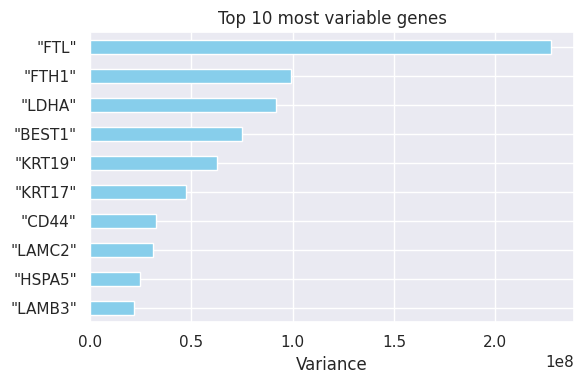

In [ ]:
plt.figure(figsize=(6, 4))
top10_HccSs.sort_values().plot.barh(color='skyblue')
plt.xlabel('Variance')
plt.title('Top 10 most variable genes')
plt.tight_layout()
plt.show()


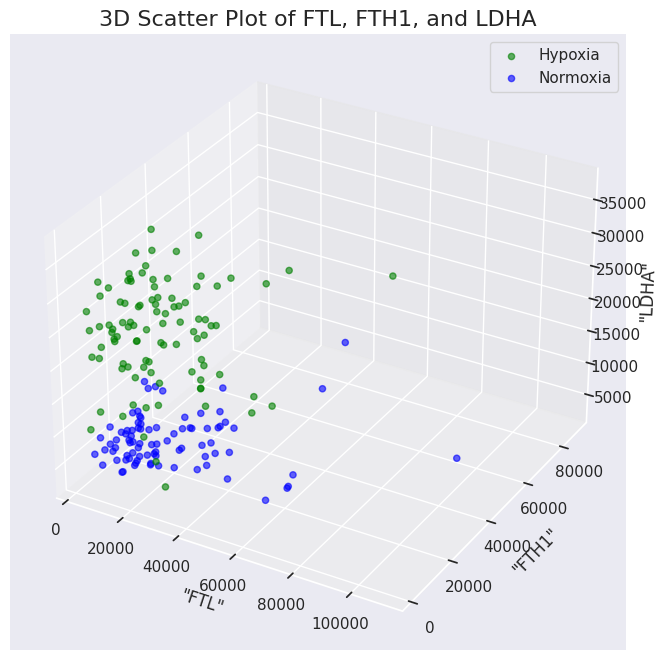

In [ ]:
HCC_SmartS_labels = np.array(HCC_SmartS_labels)

# Gene names
gene1 = '"FTL"'
gene2 = '"FTH1"'
gene3 = '"LDHA"'

# Extract the expression values for each gene
x = HCC1806_SmartS[gene1].values
y = HCC1806_SmartS[gene2].values
z = HCC1806_SmartS[gene3].values

# Define Hypoxia and Normoxia cell indices
hypoxia_indices = HCC_SmartS_labels == 1
normoxia_indices = HCC_SmartS_labels == 0


# Create figure for 3D plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the points: Hypoxia in green and Normoxia in blue
ax.scatter(x[hypoxia_indices], y[hypoxia_indices], z[hypoxia_indices], color='green', label="Hypoxia", alpha=0.6)
ax.scatter(x[normoxia_indices], y[normoxia_indices], z[normoxia_indices], color='blue', label="Normoxia", alpha=0.6)

# Set axis labels with the gene names
ax.set_xlabel(gene1)
ax.set_ylabel(gene2)
ax.set_zlabel(gene3)

plt.title(f"3D Scatter Plot of FTL, FTH1, and LDHA", fontsize=16)

ax.legend()

plt.show()


In [ ]:
HccSs_cell_corr = HCC1806_SmartS.T.corr()
HccSs_cell_corr

,"""output.STAR.PCRPlate1G12_Normoxia_S32_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G7_Normoxia_S118_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G8_Normoxia_S19_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G9_Normoxia_S121_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1H1_Hypoxia_S103_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1H2_Hypoxia_S3_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""output.STAR.PCRPlate1G12_Normoxia_S32_Aligned.sortedByCoord.out.bam""",1.000000,0.639990,0.721442,0.773649,0.796362,0.862591,0.833445,0.905306,0.692164,0.754525,...,0.824104,0.754139,0.858453,0.685003,0.747641,0.764152,0.768848,0.855685,0.823474,0.864462
"""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""",0.639990,1.000000,0.819813,0.783464,0.825071,0.571318,0.482978,0.513109,0.864297,0.696942,...,0.697747,0.889586,0.799047,0.881812,0.847683,0.734721,0.664151,0.766334,0.695525,0.725399
"""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""",0.721442,0.819813,1.000000,0.825158,0.793773,0.598249,0.569042,0.646769,0.797287,0.899721,...,0.649861,0.816296,0.841045,0.767190,0.766086,0.716343,0.698114,0.812395,0.734166,0.748276
"""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""",0.773649,0.783464,0.825158,1.000000,0.743238,0.628448,0.628020,0.675230,0.726845,0.783603,...,0.684990,0.779328,0.838490,0.705220,0.816045,0.719044,0.670163,0.749503,0.735817,0.811179
"""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""",0.796362,0.825071,0.793773,0.743238,1.000000,0.848934,0.683863,0.704931,0.827008,0.685022,...,0.852932,0.936130,0.923726,0.887764,0.741214,0.694261,0.612322,0.839050,0.694847,0.797379
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""",0.764152,0.734721,0.716343,0.719044,0.694261,0.582057,0.512727,0.683835,0.799419,0.720374,...,0.658121,0.762869,0.757545,0.730548,0.891127,1.000000,0.880458,0.824203,0.889202,0.817547
"""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""",0.768848,0.664151,0.698114,0.670163,0.612322,0.509623,0.501842,0.709007,0.719437,0.727289,...,0.578421,0.665587,0.689539,0.622038,0.839907,0.880458,1.000000,0.800866,0.876759,0.745766
"""output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam""",0.855685,0.766334,0.812395,0.749503,0.839050,0.702605,0.638863,0.775598,0.902092,0.824465,...,0.692154,0.869436,0.908898,0.858249,0.802771,0.824203,0.800866,1.000000,0.880247,0.762976
"""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""",0.823474,0.695525,0.734166,0.735817,0.694847,0.587719,0.544980,0.720003,0.797836,0.810868,...,0.642639,0.759468,0.799792,0.718532,0.840223,0.889202,0.876759,0.880247,1.000000,0.741606


In [ ]:
# Get the indices for Hypoxia and Normoxia cells
HCC_SmartS_labels = np.array(HCC_SmartS_labels)

HccSs_cells_hypo = HCC1806_SmartS.index[HCC_SmartS_labels == 1]
HccSs_cells_norm = HCC1806_SmartS.index[HCC_SmartS_labels == 0]

# Combine the indices for Hypoxia and Normoxia into a single index
combined_cells = pd.Index(np.concatenate([HccSs_cells_hypo, HccSs_cells_norm]))

# Now subset the correlation matrix using the combined cells' index
HccSs_cells_heat = HccSs_cell_corr.loc[combined_cells, combined_cells]

# Display the first few rows of the correlation matrix
HccSs_cells_heat.head()

,"""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1H1_Hypoxia_S103_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1H2_Hypoxia_S3_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1H5_Hypoxia_S10_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate1H6_Hypoxia_S16_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate2A1_Hypoxia_S129_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate2A3_Hypoxia_S36_Aligned.sortedByCoord.out.bam""",...,"""output.STAR.PCRPlate4F12_Normoxia_S242_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4F7_Normoxia_S203_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4F9_Normoxia_S235_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G10_Normoxia_S209_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam""","""output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam"""
"""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""",1.000000,0.819813,0.783464,0.825071,0.864297,0.696942,0.899928,0.707743,0.866278,0.834898,...,0.839586,0.762092,0.819821,0.667125,0.697747,0.847683,0.734721,0.664151,0.695525,0.725399
"""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""",0.819813,1.000000,0.825158,0.793773,0.797287,0.899721,0.808385,0.659737,0.865920,0.832787,...,0.721319,0.708807,0.760376,0.637740,0.649861,0.766086,0.716343,0.698114,0.734166,0.748276
"""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""",0.783464,0.825158,1.000000,0.743238,0.726845,0.783603,0.746920,0.711185,0.863177,0.763115,...,0.769823,0.728938,0.807312,0.648991,0.684990,0.816045,0.719044,0.670163,0.735817,0.811179
"""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""",0.825071,0.793773,0.743238,1.000000,0.827008,0.685022,0.858032,0.678868,0.914338,0.853753,...,0.844038,0.686182,0.833440,0.798380,0.852932,0.741214,0.694261,0.612322,0.694847,0.797379
"""output.STAR.PCRPlate1H1_Hypoxia_S103_Aligned.sortedByCoord.out.bam""",0.864297,0.797287,0.726845,0.827008,1.000000,0.734804,0.897298,0.665693,0.870131,0.928307,...,0.802119,0.784457,0.830735,0.697149,0.621616,0.838495,0.799419,0.719437,0.797836,0.711907


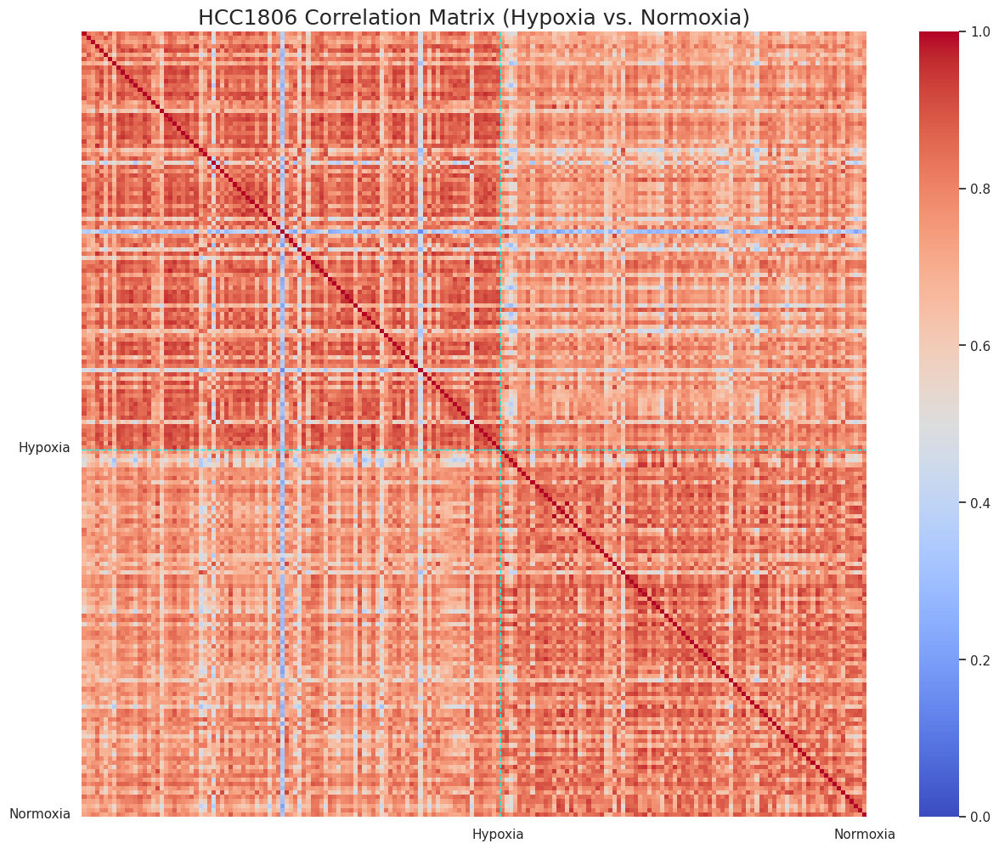

In [ ]:
# Create the heatmap for the correlation matrix
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap
sns.heatmap(HccSs_cells_heat, vmax=1, vmin=0, cmap='coolwarm',
            cbar=True, square=True, annot=False, fmt='.2f', ax=ax)

hypoxia_pos = sum(HCC_SmartS_labels == 1)  # Number of Hypoxia cells
normoxia_pos = sum(HCC_SmartS_labels == 0)  # Number of Normoxia cells

# Add the cyan dashed lines to visually separate the conditions
plt.plot([0, HccSs_cells_heat.shape[0]], [hypoxia_pos, hypoxia_pos], color='cyan', linestyle='dashed', linewidth=1)
plt.plot([hypoxia_pos, hypoxia_pos], [0, HccSs_cells_heat.shape[0]], color='cyan', linestyle='dashed', linewidth=1)

# Add labels for Hypoxia and Normoxia
plt.yticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)
plt.xticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)

plt.title("HCC1806 Correlation Matrix (Hypoxia vs. Normoxia)", fontsize=18)

plt.show()



We can see how there is still a **higher Intra-group Correlation** in cells within each group (Hypoxia and Normoxia), as well as a **lower Inter-group Correlation** in cells between Hypoxia and Normoxia.  
However, HCC1806 Correlation Matrix shows higher correlation rates in the lower Inter-group, while MCF7 Correlation Matrix shows correlation rates closer to 0.




In [ ]:
HccSs_corr = pd.concat([HCC1806_SmartS, pd.DataFrame(HCC_SmartS_labels)], axis=1)

HccSs_genes_corr = HccSs_corr.corr()

HccSs_genes_corr


,"""DDIT4""","""ANGPTL4""","""CALML5""","""KRT14""","""CCNB1""","""IGFBP3""","""AKR1C2""","""KRT6A""","""NDRG1""","""KRT4""",...,"""NRG1""","""RBMS3""","""VCPIP1""","""LINC02693""","""OR8B9P""","""NEAT1""","""ZDHHC23""","""ODAD2""",Condition,0
"""DDIT4""",1.000000,0.606789,0.038166,-0.034177,-0.199739,0.199059,-0.207816,-0.042078,0.555542,-0.031321,...,-0.070134,0.182930,0.252083,-0.055427,-0.056232,0.287080,0.006120,0.021998,0.790957,NaN
"""ANGPTL4""",0.606789,1.000000,0.100467,-0.095332,-0.098266,0.102183,-0.172768,-0.121895,0.362863,-0.117860,...,-0.091833,0.237950,-0.041078,-0.184650,-0.007394,0.145084,-0.047453,-0.011395,0.568406,NaN
"""CALML5""",0.038166,0.100467,1.000000,0.018114,-0.006075,0.248295,0.047394,0.188488,0.088168,0.307373,...,-0.070723,0.305099,-0.039970,-0.155434,0.078580,0.199841,-0.087709,-0.059387,0.096117,NaN
"""KRT14""",-0.034177,-0.095332,0.018114,1.000000,-0.134930,0.031056,0.085462,0.802118,0.073832,0.514523,...,-0.094575,-0.061108,0.010388,0.049739,-0.023553,0.197617,-0.038103,-0.019791,0.019746,NaN
"""CCNB1""",-0.199739,-0.098266,-0.006075,-0.134930,1.000000,-0.212359,-0.060786,-0.144212,-0.274601,-0.148772,...,-0.081076,-0.025887,-0.006306,-0.139876,0.144299,-0.134410,-0.085271,-0.048247,-0.255166,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""NEAT1""",0.287080,0.145084,0.199841,0.197617,-0.134410,0.155080,0.064514,0.268724,0.305791,0.111911,...,0.046772,0.346431,-0.033624,-0.118856,-0.062302,1.000000,-0.063412,-0.041146,0.258905,NaN
"""ZDHHC23""",0.006120,-0.047453,-0.087709,-0.038103,-0.085271,0.149672,-0.077735,-0.085303,0.018960,-0.088507,...,0.009016,-0.035998,-0.034316,0.016981,-0.033727,-0.063412,1.000000,0.071702,-0.080593,NaN
"""ODAD2""",0.021998,-0.011395,-0.059387,-0.019791,-0.048247,0.211067,-0.052509,-0.064608,0.100948,-0.023389,...,0.033971,0.088749,0.001418,-0.046202,-0.036243,-0.041146,0.071702,1.000000,0.006238,NaN
Condition,0.790957,0.568406,0.096117,0.019746,-0.255166,0.298870,-0.193856,0.035183,0.636895,0.111257,...,-0.081311,0.075431,0.142196,-0.111633,-0.082480,0.258905,-0.080593,0.006238,1.000000,NaN


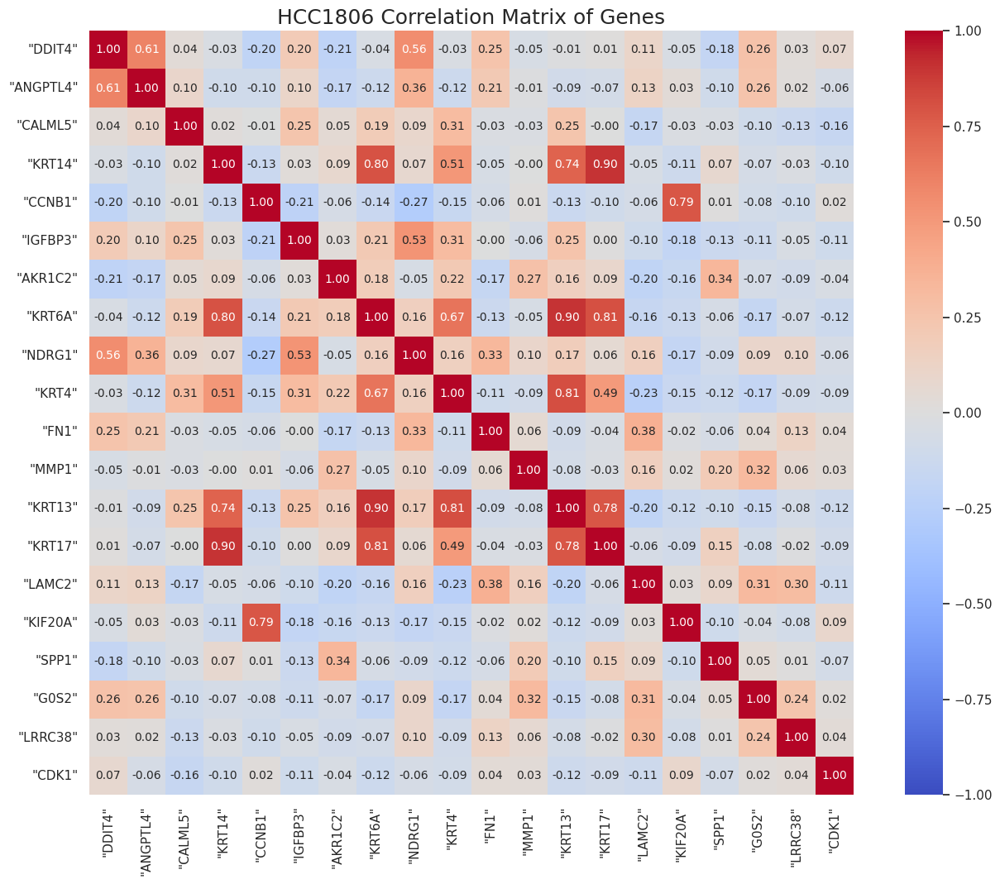

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap of gene correlations (top 20 genes)
sns.heatmap(HccSs_genes_corr.iloc[:20, :20], vmax=1, vmin=-1, cmap='coolwarm',
            annot=True, fmt='.2f', annot_kws={'size': 10}, cbar=True, square=True, ax=ax)

plt.title("HCC1806 Correlation Matrix of Genes", fontsize=18)
plt.show()


In [ ]:
HccSs_cells_hypo_corr = pd.Series.sort_values((HccSs_genes_corr["Condition"]), ascending=False)

HccSs_important_genes = list(HccSs_cells_hypo_corr.index[:20])


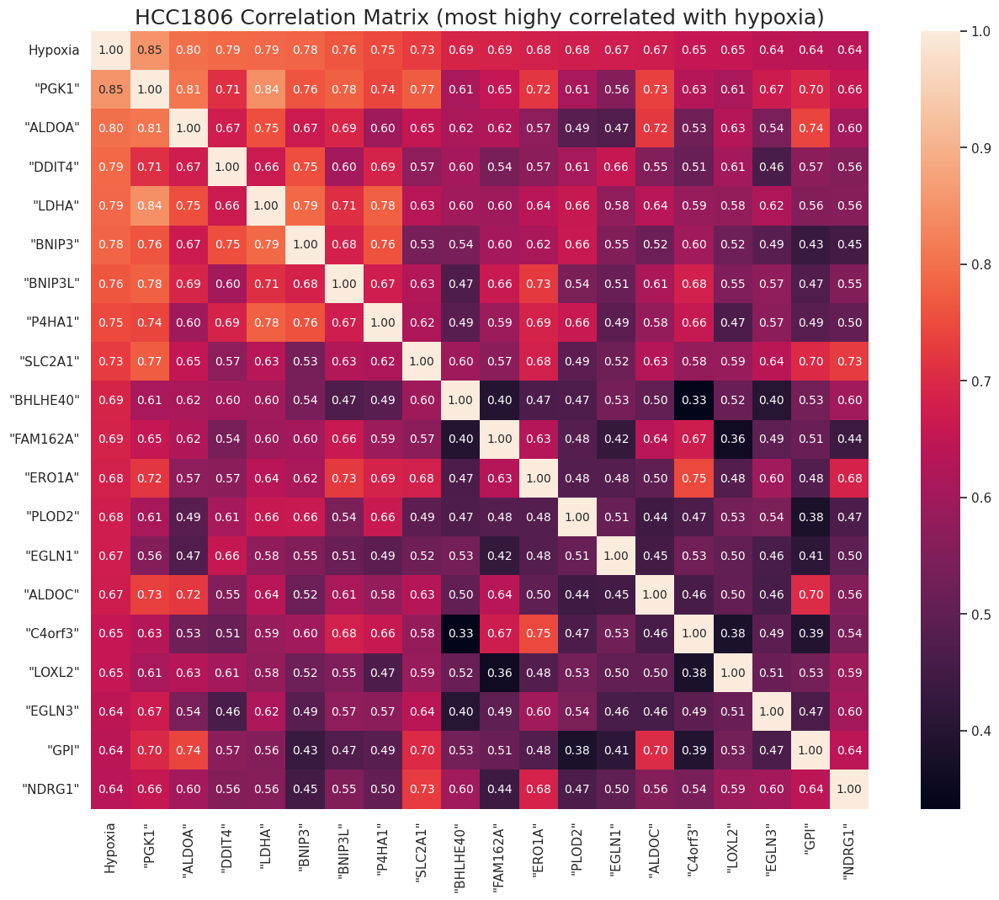

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))
sns.heatmap(HccSs_genes_corr.loc[HccSs_important_genes, HccSs_important_genes], vmax=1,
            cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10})
plt.yticks([i+0.5 for i in range(20)], ['Hypoxia'] + HccSs_important_genes[1:])
plt.xticks([i+0.5 for i in range(20)], ['Hypoxia'] + HccSs_important_genes[1:])
plt.title("HCC1806 Correlation Matrix (most highy correlated with hypoxia)", fontsize=18);


<ipython-input-35-1869370122>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(HCC_SmartS_labels), y = HCC1806_SmartS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-35-1869370122>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(HCC_SmartS_labels), y = HCC1806_SmartS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-35-1869370122>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(HCC_SmartS_labels), y = HCC1806_SmartS[ge

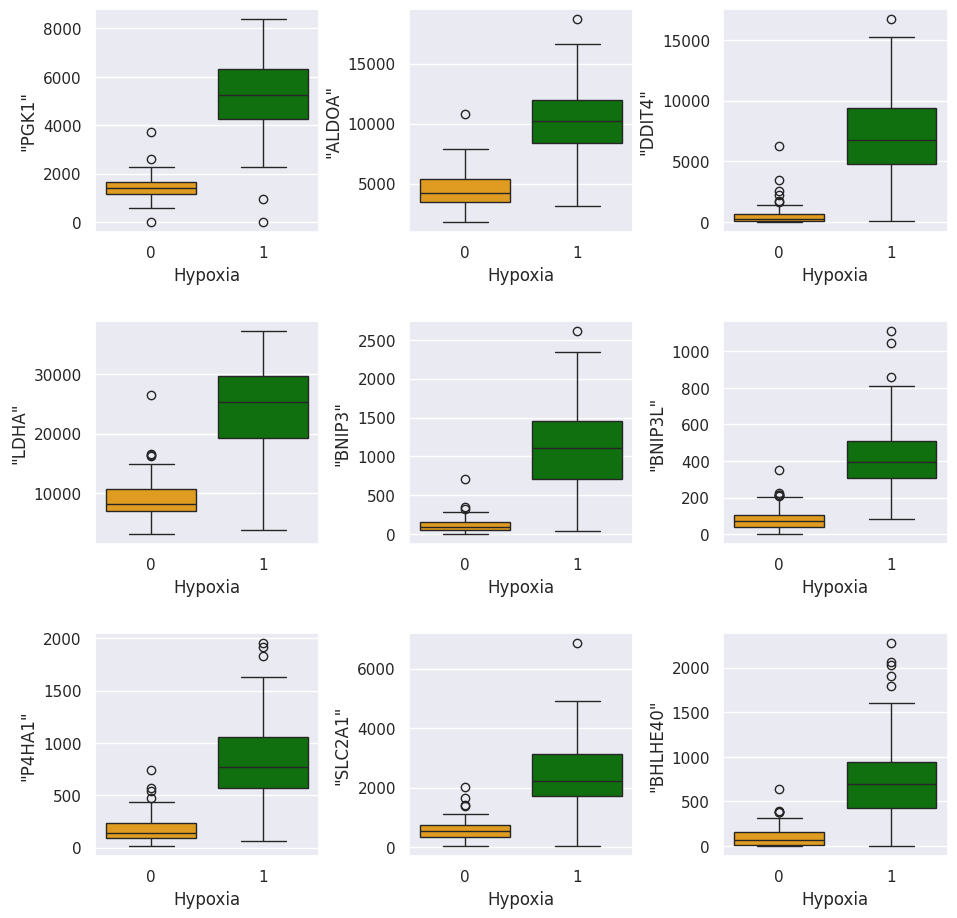

In [ ]:
fig, ax = plt.subplots(3, 3, figsize=(11, 11))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
def find_subplot(i):
  j = i
  r = j//3
  c = j - r*3
  return (r, c)
for i in range(0, 9):
  row, col = find_subplot(i)
  gene = HccSs_cells_hypo_corr.index[i+1]

  sns.boxplot(ax = ax[row, col], x = np.array(HCC_SmartS_labels), y = HCC1806_SmartS[gene], palette={'0': 'orange', '1': 'green'})
  ax[row, col].set_xlabel("Hypoxia")

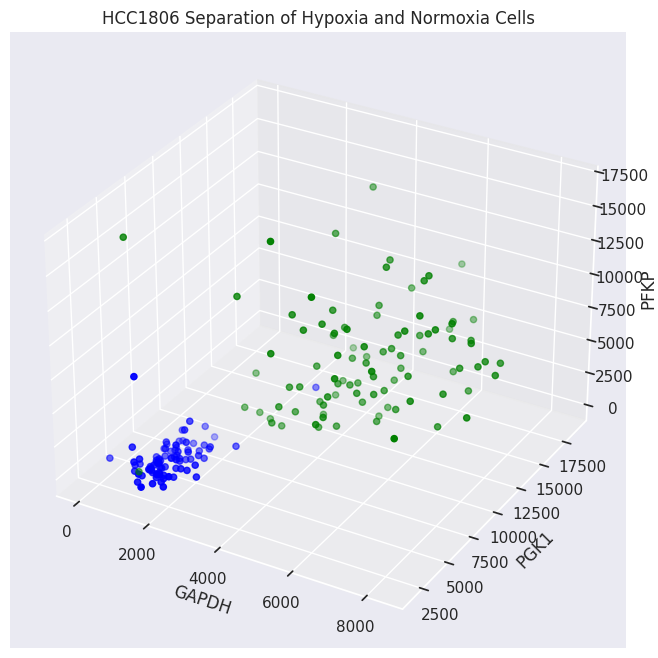

In [ ]:
HccSs_hypo_ind = np.where(HccSs_corr.loc[:, "Condition"] == 1)
HccSs_norm_ind = np.where(HccSs_corr.loc[:, "Condition"] == 0)

HccSs_pg_hypo = HccSs_corr.iloc[HccSs_hypo_ind].loc[:, '"PGK1"']
HccSs_al_hypo = HccSs_corr.iloc[HccSs_hypo_ind].loc[:, '"ALDOA"']
HccSs_dd_hypo = HccSs_corr.iloc[HccSs_hypo_ind].loc[:, '"DDIT4"']

HccSs_pg_norm = HccSs_corr.iloc[HccSs_norm_ind].loc[:, '"PGK1"']
HccSs_al_norm = HccSs_corr.iloc[HccSs_norm_ind].loc[:, '"ALDOA"']
HccSs_dd_norm = HccSs_corr.iloc[HccSs_norm_ind].loc[:, '"DDIT4"']


# Creating figure
fig = plt.figure(figsize = (12, 8))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(HccSs_pg_hypo, HccSs_al_hypo, HccSs_dd_hypo, color = "green")
ax.scatter3D(HccSs_pg_norm, HccSs_al_norm, HccSs_dd_norm, color = "blue")
lbl_x = ax.set_xlabel('GAPDH')
lbl_y = ax.set_ylabel('PGK1')
lbl_z = ax.set_zlabel('PFKP')

lbl_x.set_rotation(30)
lbl_y.set_rotation(45)
lbl_z.set_rotation(90)

plt.title("HCC1806 Separation of Hypoxia and Normoxia Cells")

# show plot
plt.show()

## MCF7 DropSeq

In [ ]:
MCF7_DropS = pd.read_csv(
    "/content/drive/MyDrive/AILAB/Project data/DropSeq/MCF7_Filtered_Normalised_3000_Data_train.txt",
    delimiter="\ ",
    engine='python',
    index_col=0
)
MCF7_DropS = MCF7_DropS.T
MCF7_DropS


,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""","""MT-CO3""",...,"""MROH1""","""SKIDA1""","""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3"""
"""AAAAACCTATCG_Normoxia""",1,0,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACAACCCTA_Normoxia""",3,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACACTCTCA_Normoxia""",3,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCAGGCAC_Normoxia""",6,2,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTAGCTC_Normoxia""",4,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TTTTCGCGTAGA_Hypoxia""",0,0,0,0,3,0,7,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTCGTCCGCT_Hypoxia""",1,0,0,0,4,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTCTCCGGCT_Hypoxia""",0,0,0,1,2,0,4,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""TTTTGTTCAAAG_Hypoxia""",0,0,0,0,6,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
def get_MCF7_cell_labels(dataframe):
    MCF7Ds_labels = []
    for cell in MCF7_DropS.index:
        if 'Norm' in cell:
            MCF7Ds_labels.append(0)
        elif 'Hypo' in cell:
            MCF7Ds_labels.append(1)
        else:
            print(f"Warning: Could not determine label for cell: {cell}")
            MCF7Ds_labels.append('UNKNOWN')
    return MCF7Ds_labels

In [ ]:
# Applying to MCF7 DropSeq data
MCF7Ds_labels = get_MCF7_cell_labels(MCF7_DropS)


In [ ]:
# Assign the labels to the dataframe
MCF7_DropS['Condition'] = MCF7Ds_labels

MCF7_DropS.head()

,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""","""MT-CO3""",...,"""SKIDA1""","""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3""",Condition
"""AAAAACCTATCG_Normoxia""",1,0,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACAACCCTA_Normoxia""",3,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACACTCTCA_Normoxia""",3,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCAGGCAC_Normoxia""",6,2,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTAGCTC_Normoxia""",4,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Display the first few labels for MCF7
print("MCF7 Labels Head:", MCF7Ds_labels[20:])

# Check the distribution of labels
print("MCF7 Hypoxia count:", sum(np.array(MCF7Ds_labels) == 1))  # Hypoxia = 1
print("MCF7 Normoxia count:", sum(np.array(MCF7Ds_labels) == 0))  # Normoxia = 0


MCF7 Labels Head: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [ ]:
# 1. Compute the variance for each gene
MCF7Ds_gene_variances = MCF7_DropS.var(axis=0)

# 2. Descending order
MCF7Ds_gene_variances_sorted = MCF7Ds_gene_variances.sort_values(ascending=False)

# 3. Print the 10 most variable genes
top10_MCF7Ds = MCF7Ds_gene_variances_sorted.head(10)
print(top10)

"GAPDH"     5.338277e+08
"ACTG1"     2.743522e+08
"ALDOA"     1.982273e+08
"CYP1B1"    6.859712e+07
"FTH1"      5.042005e+07
"BEST1"     4.025752e+07
"CYP1A1"    3.200615e+07
"UBC"       2.206103e+07
"MT-CO1"    2.017052e+07
"PGK1"      2.015048e+07
dtype: float64


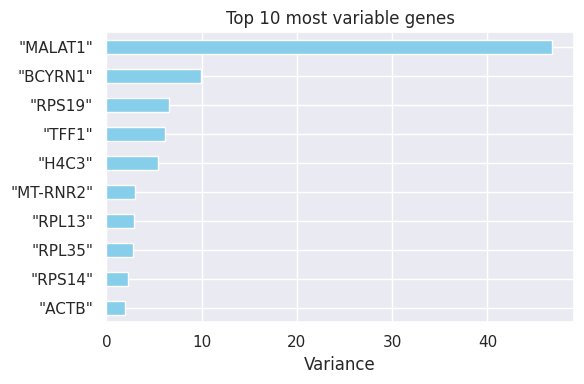

In [ ]:
plt.figure(figsize=(6, 4))
top10_MCF7Ds.sort_values().plot.barh(color='skyblue')
plt.xlabel('Variance')
plt.title('Top 10 most variable genes')
plt.tight_layout()
plt.show()


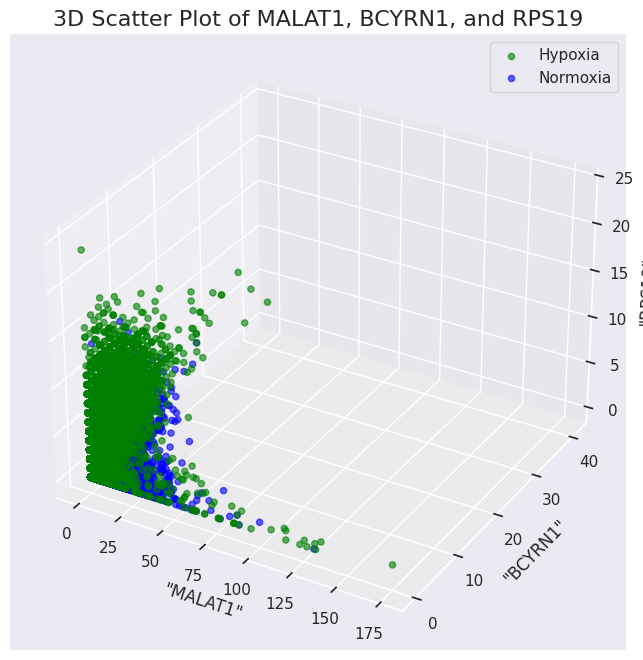

In [ ]:
MCF7Ds_labels = np.array(MCF7Ds_labels)

# Gene names
gene1 = '"MALAT1"'
gene2 = '"BCYRN1"'
gene3 = '"RPS19"'

# Extract the expression values for each gene
x = MCF7_DropS[gene1].values
y = MCF7_DropS[gene2].values
z = MCF7_DropS[gene3].values

# Define Hypoxia and Normoxia cell indices
hypoxia_indices = MCF7Ds_labels == 1
normoxia_indices = MCF7Ds_labels == 0


# Create figure for 3D plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the points: Hypoxia in green and Normoxia in blue
ax.scatter(x[hypoxia_indices], y[hypoxia_indices], z[hypoxia_indices], color='green', label="Hypoxia", alpha=0.6)
ax.scatter(x[normoxia_indices], y[normoxia_indices], z[normoxia_indices], color='blue', label="Normoxia", alpha=0.6)

# Set axis labels with the gene names
ax.set_xlabel(gene1)
ax.set_ylabel(gene2)
ax.set_zlabel(gene3)

plt.title(f"3D Scatter Plot of MALAT1, BCYRN1, and RPS19", fontsize=16)

ax.legend()

plt.show()


In [ ]:
# Select a random sample of 200 cells
MCF7Ds_sampled_cells = MCF7_DropS.sample(n=200, random_state=42)
'''cleaned = MCF7Ds_sampled_cells.dropna()
cleaned
'''
# Calculate the variance of each cell (row)
cell_variances = MCF7Ds_sampled_cells.var(axis=1)

# Identify constant rows (those with zero variance)
constant_rows = cell_variances[cell_variances == 0].index

# Drop constant rows from the DataFrame
MCF7Ds_cleaned1 = MCF7Ds_sampled_cells.drop(index=constant_rows)

# Do the same for genes

gene_variances = MCF7Ds_cleaned1.var(axis=0)
constant_columns = gene_variances[gene_variances == 0].index
MCF7Ds_cleaned = MCF7Ds_cleaned1.drop(columns=constant_columns)



MCF7Ds_cleaned


,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""","""MT-CO3""",...,"""NETO2""","""USP25""","""ALAD""","""GPBP1""","""BCDIN3D""","""SMIM27""","""MROH1""","""RPS19BP1""","""SUDS3""",Condition
"""ACGACCACTCCC_Normoxia""",3,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
"""ACGCTTTTTAAC_Normoxia""",2,0,1,3,2,0,3,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""ACACGTAGTCTC_Hypoxia""",0,1,0,0,4,0,3,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""GTAGCCACTCTC_Normoxia""",2,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AGCCTTCGATAA_Hypoxia""",0,0,0,3,8,0,13,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""GATAACGAGAAT_Hypoxia""",0,0,0,0,3,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
"""TTCTGGCTTCCA_Normoxia""",4,2,0,0,0,0,2,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""CGGCGGGCAAGT_Hypoxia""",9,0,0,0,1,0,2,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""TCTACGCGCCCC_Normoxia""",2,2,0,0,0,0,2,0,0,1,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
def get_MCF7_cell_labels(dataframe):
    MCF7Ds_cleaned_labels = []
    for cell in MCF7Ds_cleaned.index:
        if 'Norm' in cell:
            MCF7Ds_cleaned_labels.append(0)
        elif 'Hypo' in cell:
            MCF7Ds_cleaned_labels.append(1)
        else:
            print(f"Warning: Could not determine label for cell: {cell}")
            MCF7Ds_cleaned_labels.append('UNKNOWN')

    return MCF7Ds_cleaned_labels

In [ ]:
MCF7Ds_cleaned_labels = get_MCF7_cell_labels(MCF7Ds_cleaned)
MCF7Ds_cleaned['Condition'] = MCF7Ds_cleaned_labels
MCF7Ds_cleaned.head()

,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""","""MT-CO3""",...,"""NETO2""","""USP25""","""ALAD""","""GPBP1""","""BCDIN3D""","""SMIM27""","""MROH1""","""RPS19BP1""","""SUDS3""",Condition
"""ACGACCACTCCC_Normoxia""",3,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
"""ACGCTTTTTAAC_Normoxia""",2,0,1,3,2,0,3,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""ACACGTAGTCTC_Hypoxia""",0,1,0,0,4,0,3,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""GTAGCCACTCTC_Normoxia""",2,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AGCCTTCGATAA_Hypoxia""",0,0,0,3,8,0,13,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
MCF7Ds_cell_corr = MCF7Ds_cleaned.T.corr()
MCF7Ds_cell_corr

,"""ACGACCACTCCC_Normoxia""","""ACGCTTTTTAAC_Normoxia""","""ACACGTAGTCTC_Hypoxia""","""GTAGCCACTCTC_Normoxia""","""AGCCTTCGATAA_Hypoxia""","""ATCTCATGCGGT_Hypoxia""","""CGGTCCCCCTAG_Normoxia""","""CAAGTCCACACT_Normoxia""","""CCACTACTGACT_Normoxia""","""GCCCTCCGCGTG_Hypoxia""",...,"""GGGGCAGCACAA_Hypoxia""","""TCACTGCATCTC_Normoxia""","""CCACTCCTCCAC_Normoxia""","""CGTTTGCAGCCC_Normoxia""","""TCCGACGAGCCC_Normoxia""","""GATAACGAGAAT_Hypoxia""","""TTCTGGCTTCCA_Normoxia""","""CGGCGGGCAAGT_Hypoxia""","""TCTACGCGCCCC_Normoxia""","""TACGCCGCCACC_Normoxia"""
"""ACGACCACTCCC_Normoxia""",1.000000,0.288303,0.447820,0.278552,0.122075,0.390906,0.235870,0.292155,0.354032,0.417648,...,0.323658,0.343857,0.304993,0.376659,0.533165,0.140751,0.239866,0.268382,0.376904,0.230686
"""ACGCTTTTTAAC_Normoxia""",0.288303,1.000000,0.516116,0.327264,0.403963,0.465687,0.172599,0.339602,0.318000,0.472860,...,0.299634,0.339806,0.242979,0.248236,0.287276,0.319920,0.264627,0.278616,0.416641,0.148878
"""ACACGTAGTCTC_Hypoxia""",0.447820,0.516116,1.000000,0.357663,0.448535,0.654193,0.072346,0.340313,0.422324,0.648228,...,0.418662,0.388374,0.378211,0.496520,0.460922,0.318615,0.266181,0.219098,0.462808,0.119849
"""GTAGCCACTCTC_Normoxia""",0.278552,0.327264,0.357663,1.000000,0.201944,0.348943,0.171103,0.316458,0.304409,0.322179,...,0.233949,0.382600,0.134597,0.229737,0.243169,0.224149,0.223925,0.290303,0.373367,0.137996
"""AGCCTTCGATAA_Hypoxia""",0.122075,0.403963,0.448535,0.201944,1.000000,0.315852,0.079763,0.333942,0.167237,0.295368,...,0.337748,0.133157,0.185164,0.252242,0.230563,0.336729,0.196891,0.217413,0.193480,0.052022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""GATAACGAGAAT_Hypoxia""",0.140751,0.319920,0.318615,0.224149,0.336729,0.352533,0.029512,0.174914,0.204390,0.369382,...,0.265255,0.152270,0.301315,0.215763,0.245720,1.000000,0.122477,0.123164,0.251899,0.036169
"""TTCTGGCTTCCA_Normoxia""",0.239866,0.264627,0.266181,0.223925,0.196891,0.346816,0.373660,0.227805,0.250861,0.219010,...,0.377974,0.266048,0.095900,0.165174,0.154031,0.122477,1.000000,0.307018,0.241527,0.183150
"""CGGCGGGCAAGT_Hypoxia""",0.268382,0.278616,0.219098,0.290303,0.217413,0.351804,0.555474,0.287620,0.284234,0.299564,...,0.396932,0.346982,0.050160,0.138726,0.179227,0.123164,0.307018,1.000000,0.285363,0.269214
"""TCTACGCGCCCC_Normoxia""",0.376904,0.416641,0.462808,0.373367,0.193480,0.330406,0.212738,0.355063,0.373557,0.484881,...,0.177197,0.414934,0.276499,0.317162,0.423800,0.251899,0.241527,0.285363,1.000000,0.215221


In [ ]:
# Get the indices for Hypoxia and Normoxia cells
MCF7Ds_cleaned_labels = np.array(MCF7Ds_cleaned_labels)

MCF7Ds_cells_hypo = MCF7Ds_cleaned.index[MCF7Ds_cleaned_labels == 1]
MCF7Ds_cells_norm = MCF7Ds_cleaned.index[MCF7Ds_cleaned_labels == 0]

# Combine the indices for Hypoxia and Normoxia into a single index
combined_cells = pd.Index(np.concatenate([MCF7Ds_cells_hypo, MCF7Ds_cells_norm]))

# Subset the correlation matrix using the combined cells' index
MCF7Ds_cells_heat = MCF7Ds_cell_corr.loc[combined_cells, combined_cells]

# Display the first few rows of the correlation matrix
MCF7Ds_cells_heat.head()

,"""ACACGTAGTCTC_Hypoxia""","""AGCCTTCGATAA_Hypoxia""","""ATCTCATGCGGT_Hypoxia""","""GCCCTCCGCGTG_Hypoxia""","""GCGTGGTCTGTA_Hypoxia""","""TCAGATTTAGAA_Hypoxia""","""GCTCCATTGCTC_Hypoxia""","""GTGGAGTGTTTC_Hypoxia""","""CCAGGCAGGGCA_Hypoxia""","""ACTAAGCATTCT_Hypoxia""",...,"""TGAGTCACCAGG_Normoxia""","""TCTGGAAGAAGA_Normoxia""","""TACCCAACTGGC_Normoxia""","""TCACTGCATCTC_Normoxia""","""CCACTCCTCCAC_Normoxia""","""CGTTTGCAGCCC_Normoxia""","""TCCGACGAGCCC_Normoxia""","""TTCTGGCTTCCA_Normoxia""","""TCTACGCGCCCC_Normoxia""","""TACGCCGCCACC_Normoxia"""
"""ACACGTAGTCTC_Hypoxia""",1.000000,0.448535,0.654193,0.648228,0.681836,0.486018,0.465852,0.715958,0.622097,0.261384,...,0.194138,0.243388,0.222190,0.388374,0.378211,0.496520,0.460922,0.266181,0.462808,0.119849
"""AGCCTTCGATAA_Hypoxia""",0.448535,1.000000,0.315852,0.295368,0.371737,0.396760,0.449392,0.432539,0.419321,0.628869,...,0.216967,0.444060,0.080722,0.133157,0.185164,0.252242,0.230563,0.196891,0.193480,0.052022
"""ATCTCATGCGGT_Hypoxia""",0.654193,0.315852,1.000000,0.598361,0.614472,0.505508,0.355305,0.686274,0.496158,0.159225,...,0.341605,0.211765,0.208524,0.369801,0.283626,0.380595,0.382636,0.346816,0.330406,0.138804
"""GCCCTCCGCGTG_Hypoxia""",0.648228,0.295368,0.598361,1.000000,0.669246,0.388497,0.449511,0.664202,0.621910,0.139141,...,0.241415,0.167099,0.267868,0.330192,0.418037,0.462821,0.460725,0.219010,0.484881,0.217615
"""GCGTGGTCTGTA_Hypoxia""",0.681836,0.371737,0.614472,0.669246,1.000000,0.382333,0.393139,0.698194,0.659226,0.200331,...,0.121353,0.091288,0.210362,0.343664,0.302299,0.434042,0.456669,0.229103,0.358461,0.084925


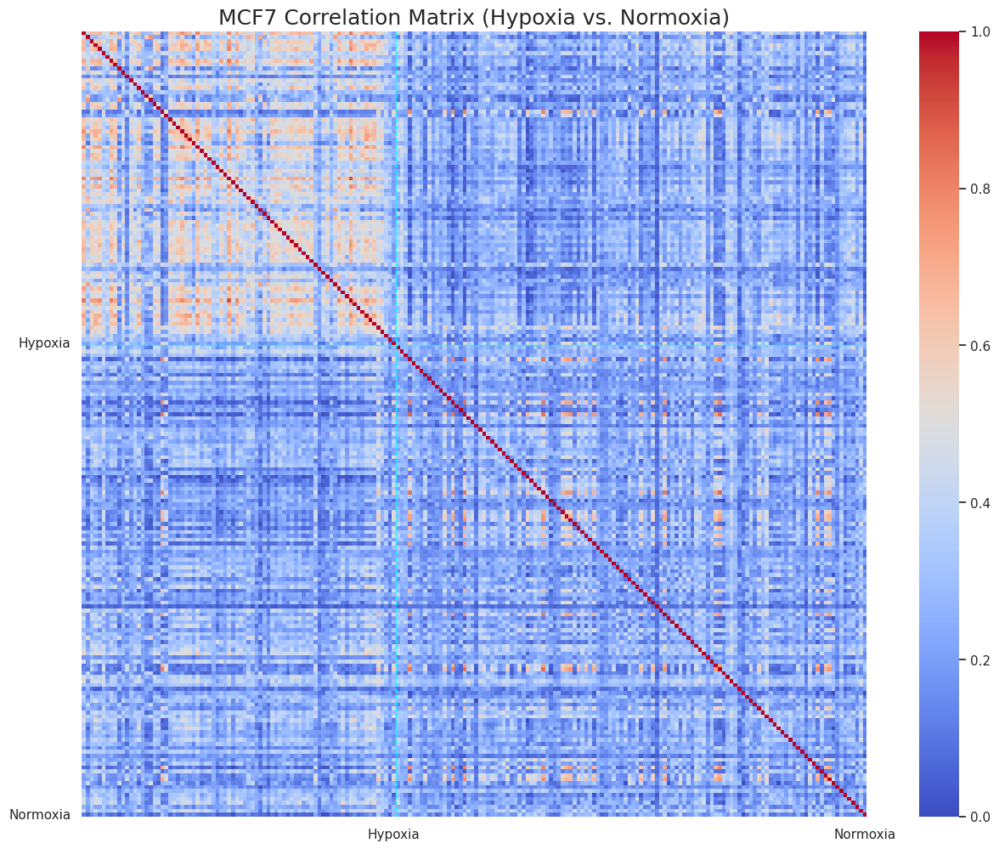

In [ ]:
# Create the heatmap for the correlation matrix
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap
sns.heatmap(MCF7Ds_cells_heat, vmax=1, vmin=0, cmap='coolwarm',
            cbar=True, square=True, annot=False, fmt='.2f', ax=ax)

hypoxia_pos = sum(MCF7Ds_cleaned_labels == 1)  # Number of Hypoxia cells
normoxia_pos = sum(MCF7Ds_cleaned_labels == 0)  # Number of Normoxia cells

# Add the cyan dashed lines to visually separate the conditions
plt.plot([0, MCF7Ds_cells_heat.shape[0]], [hypoxia_pos, hypoxia_pos], color='cyan', linestyle='dashed', linewidth=1)
plt.plot([hypoxia_pos, hypoxia_pos], [0, MCF7Ds_cells_heat.shape[0]], color='cyan', linestyle='dashed', linewidth=1)

# Add labels for Hypoxia and Normoxia
plt.yticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)
plt.xticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)

plt.title("MCF7 Correlation Matrix (Hypoxia vs. Normoxia)", fontsize=18)

plt.show()


As we can see, there are worse results with respect to SmartSeq, we can see some **High Intra-group Correlation**, mostly in cells within the group of Hypoxia, but the rest of the correlation rates are close to 0.

In [ ]:
MCF7Ds_corr = pd.concat([MCF7_DropS, pd.DataFrame(MCF7Ds_labels)], axis=1)

MCF7Ds_genes_corr = MCF7Ds_corr.corr()

MCF7Ds_genes_corr





,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""","""MT-CO3""",...,"""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3""",Condition,0
"""MALAT1""",1.000000,0.134523,0.464537,0.072762,-0.156912,0.106984,-0.081924,-0.000791,0.007810,-0.006176,...,0.003724,0.025416,0.008023,-0.002445,-0.008401,-0.002151,0.007738,0.006546,-0.155296,NaN
"""MT-RNR2""",0.134523,1.000000,0.038402,0.141256,-0.199422,0.363495,-0.029275,-0.012137,-0.006557,0.063498,...,0.017531,0.041045,0.024843,0.009961,0.001140,0.003906,0.008579,0.012510,-0.366593,NaN
"""NEAT1""",0.464537,0.038402,1.000000,0.010512,-0.032846,0.040440,-0.044047,0.006084,0.005791,-0.005627,...,-0.000623,0.005765,0.000314,-0.006108,-0.007375,-0.000103,0.007335,-0.005133,0.029503,NaN
"""H1-5""",0.072762,0.141256,0.010512,1.000000,-0.066252,0.124216,0.243198,-0.007882,-0.005540,-0.035953,...,-0.001743,0.022665,-0.002597,0.019097,0.008318,0.000742,0.001517,0.009088,-0.058652,NaN
"""TFF1""",-0.156912,-0.199422,-0.032846,-0.066252,1.000000,-0.171824,0.141443,0.037763,0.031059,-0.095845,...,-0.011067,-0.027959,-0.001590,-0.007991,0.000953,0.002585,-0.003220,-0.029303,0.503544,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""AUNIP""",-0.002151,0.003906,-0.000103,0.000742,0.002585,0.006827,-0.002603,-0.002820,-0.005183,0.005654,...,0.010507,-0.005536,-0.001339,-0.001297,-0.007660,1.000000,0.010713,0.006467,-0.009572,NaN
"""TNK2""",0.007738,0.008579,0.007335,0.001517,-0.003220,0.001479,-0.008759,-0.003784,-0.003878,0.004023,...,0.029288,-0.001949,-0.001797,-0.001741,0.000464,0.010713,1.000000,-0.000877,-0.002408,NaN
"""SUDS3""",0.006546,0.012510,-0.005133,0.009088,-0.029303,0.014897,0.011793,0.000281,0.001077,0.003273,...,-0.001055,0.006838,-0.003720,-0.002896,0.006365,0.006467,-0.000877,1.000000,-0.038423,NaN
Condition,-0.155296,-0.366593,0.029503,-0.058652,0.503544,-0.313027,0.190490,0.042638,0.026123,-0.205201,...,-0.010136,-0.039400,0.003853,-0.007899,-0.003207,-0.009572,-0.002408,-0.038423,1.000000,NaN


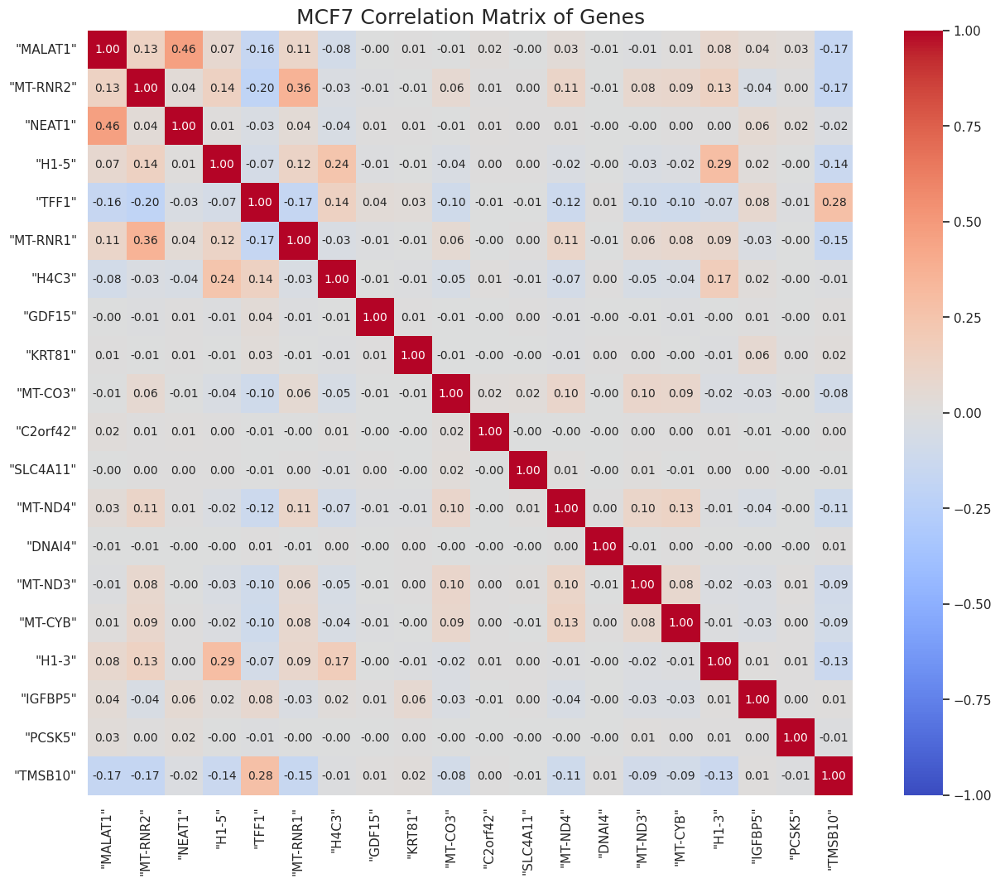

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap of gene correlations (top 20 genes)
sns.heatmap(MCF7Ds_genes_corr.iloc[:20, :20], vmax=1, vmin=-1, cmap='coolwarm',
            annot=True, fmt='.2f', annot_kws={'size': 10}, cbar=True, square=True, ax=ax)

plt.title("MCF7 Correlation Matrix of Genes", fontsize=18)
plt.show()


In [ ]:
MCF7Ds_cells_hypo_corr = pd.Series.sort_values((MCF7Ds_genes_corr["Condition"]), ascending=False)

MCF7Ds_important_genes = list(MCF7Ds_cells_hypo_corr.index[:20])


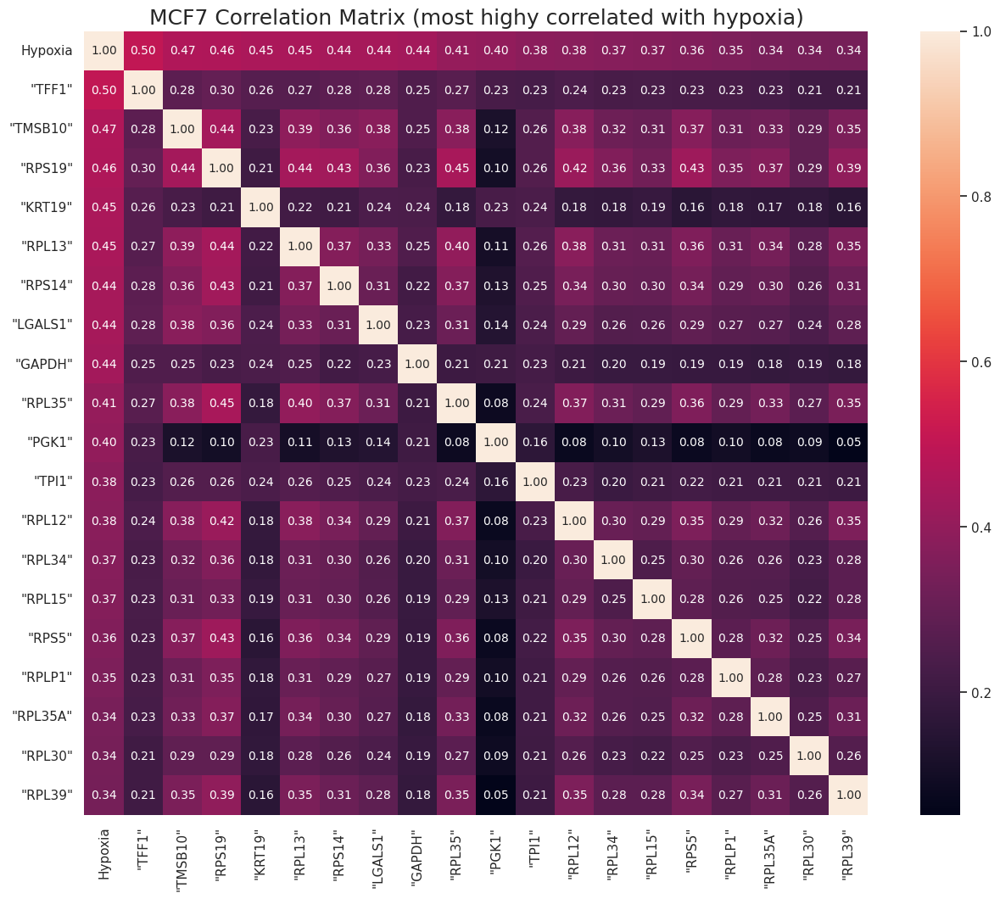

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))
sns.heatmap(MCF7Ds_genes_corr.loc[MCF7Ds_important_genes, MCF7Ds_important_genes], vmax=1,
            cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10})
plt.yticks([i+0.5 for i in range(20)], ['Hypoxia'] + MCF7Ds_important_genes[1:])
plt.xticks([i+0.5 for i in range(20)], ['Hypoxia'] + MCF7Ds_important_genes[1:])
plt.title("MCF7 Correlation Matrix (most highy correlated with hypoxia)", fontsize=18);


<ipython-input-55-2042498141>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7Ds_labels), y = MCF7_DropS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-55-2042498141>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7Ds_labels), y = MCF7_DropS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-55-2042498141>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7Ds_labels), y = MCF7_DropS[gene], palette={'0': 'oran

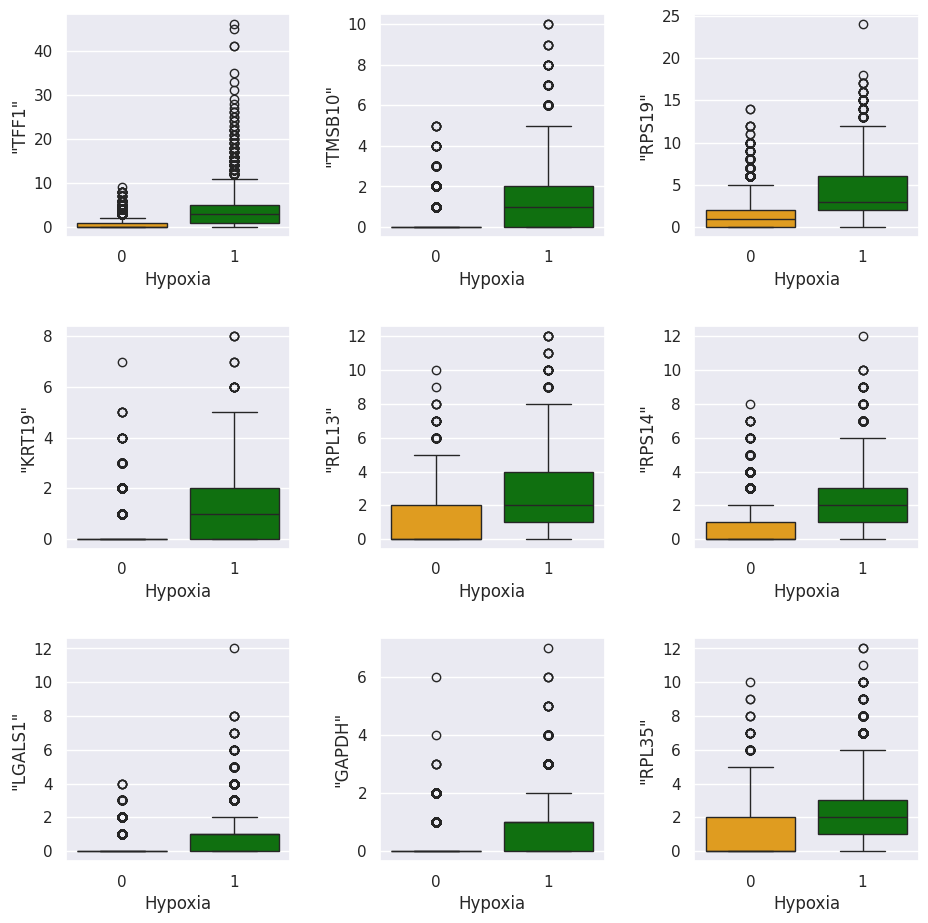

In [ ]:
fig, ax = plt.subplots(3, 3, figsize=(11, 11))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
def find_subplot(i):
  j = i
  r = j//3
  c = j - r*3
  return (r, c)
for i in range(0, 9):
  row, col = find_subplot(i)
  gene = MCF7Ds_cells_hypo_corr.index[i+1]

  sns.boxplot(ax = ax[row, col], x = np.array(MCF7Ds_labels), y = MCF7_DropS[gene], palette={'0': 'orange', '1': 'green'})
  ax[row, col].set_xlabel("Hypoxia")

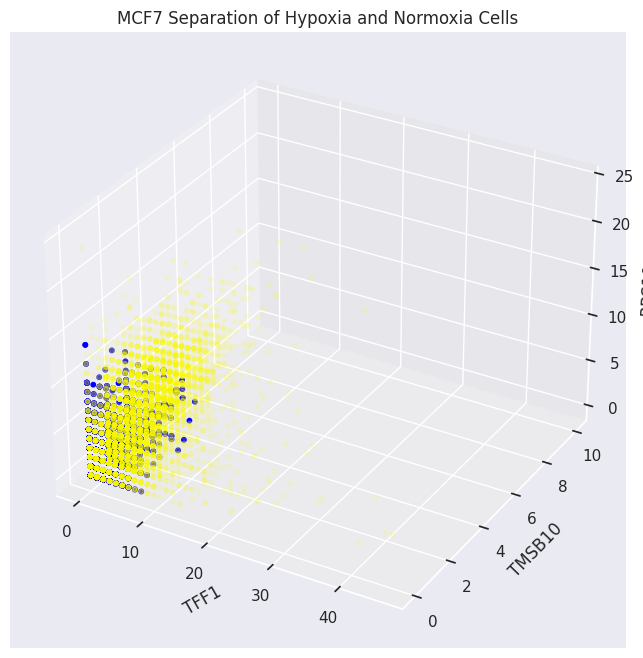

In [ ]:
MCF7Ds_hypo_ind = np.where(MCF7Ds_corr.loc[:, "Condition"] == 1)
MCF7Ds_norm_ind = np.where(MCF7Ds_corr.loc[:, "Condition"] == 0)

MCF7Ds_tf_hypo = MCF7Ds_corr.iloc[MCF7Ds_hypo_ind].loc[:, '"TFF1"']
MCF7Ds_tm_hypo = MCF7Ds_corr.iloc[MCF7Ds_hypo_ind].loc[:, '"TMSB10"']
MCF7Ds_rp_hypo = MCF7Ds_corr.iloc[MCF7Ds_hypo_ind].loc[:, '"RPS19"']

MCF7Ds_tf_norm = MCF7Ds_corr.iloc[MCF7Ds_norm_ind].loc[:, '"TFF1"']
MCF7Ds_tm_norm = MCF7Ds_corr.iloc[MCF7Ds_norm_ind].loc[:, '"TMSB10"']
MCF7Ds_rp_norm = MCF7Ds_corr.iloc[MCF7Ds_norm_ind].loc[:, '"RPS19"']


# Creating figure
fig = plt.figure(figsize = (12, 8))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(MCF7Ds_tf_hypo, MCF7Ds_tm_hypo, MCF7Ds_rp_hypo, color = "yellow", s=10, alpha = 0.1)
ax.scatter3D(MCF7Ds_tf_norm, MCF7Ds_tm_norm, MCF7Ds_rp_norm, color = "blue", s=10, alpha = 1)
lbl_x = ax.set_xlabel('TFF1')
lbl_y = ax.set_ylabel('TMSB10')
lbl_z = ax.set_zlabel('RPS19')

lbl_x.set_rotation(30)
lbl_y.set_rotation(45)
lbl_z.set_rotation(90)

plt.title("MCF7 Separation of Hypoxia and Normoxia Cells")

plt.show()

## HCC1806 DropSeq

In [ ]:
HCC1806_DropS = pd.read_csv(
    "/content/drive/MyDrive/AILAB/Project data/DropSeq/HCC1806_Filtered_Normalised_3000_Data_train.txt",
    delimiter="\ ",
    engine='python',
    index_col=0
)
HCC1806_DropS = HCC1806_DropS.T
HCC1806_DropS


,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""","""RNF123""",...,"""BATF3""","""CDKN3""","""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682"""
"""AAAAAACCCGGC_Normoxia""",2,3,0,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCGGATGC_Normoxia""",2,3,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACGAGCTAG_Normoxia""",5,2,0,0,1,0,1,3,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTTCCCCG_Normoxia""",1,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCCTACCC_Normoxia""",0,12,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""TTTTTACCAATC_Hypoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTCCGTGCA_Hypoxia""",0,4,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTGCCTGGG_Hypoxia""",0,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""TTTTTGTAACAG_Hypoxia""",3,3,1,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
def get_HCC_cell_labels(dataframe):
    HccDs_labels = []
    for cell in HCC1806_DropS.index:
        if 'Norm' in cell:
            HccDs_labels.append(0)
        elif 'Hypo' in cell:
            HccDs_labels.append(1)
        else:
            print(f"Warning: Could not determine label for cell: {cell}")
            HccDs_labels.append('UNKNOWN')

    return HccDs_labels

In [ ]:
# Applying to HCC1806 DropSeq data
HccDs_labels = get_HCC_cell_labels(HCC1806_DropS)


In [ ]:
# Assign the labels to the dataframe
HCC1806_DropS['Condition'] = HccDs_labels

HCC1806_DropS.head()

,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""","""RNF123""",...,"""CDKN3""","""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682""",Condition
"""AAAAAACCCGGC_Normoxia""",2,3,0,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCGGATGC_Normoxia""",2,3,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACGAGCTAG_Normoxia""",5,2,0,0,1,0,1,3,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTTCCCCG_Normoxia""",1,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCCTACCC_Normoxia""",0,12,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Display the first few labels for HCC
print("HCC Labels Head:", HccDs_labels[20:])

# Check the distribution of labels
print("HCC Hypoxia count:", sum(np.array(HccDs_labels) == 1))  # Hypoxia = 1
print("HCC Normoxia count:", sum(np.array(HccDs_labels) == 0))  # Normoxia = 0


HCC Labels Head: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [ ]:
# 1. Compute the variance for each gene
HccDs_gene_variances = HCC1806_DropS.var(axis=0)

# 2. Descending order
HccDs_gene_variances_sorted = HccDs_gene_variances.sort_values(ascending=False)

# 3. Print the 10 most variable genes
top10_HccDs = HccDs_gene_variances_sorted.head(10)
print(top10)

"GAPDH"     5.338277e+08
"ACTG1"     2.743522e+08
"ALDOA"     1.982273e+08
"CYP1B1"    6.859712e+07
"FTH1"      5.042005e+07
"BEST1"     4.025752e+07
"CYP1A1"    3.200615e+07
"UBC"       2.206103e+07
"MT-CO1"    2.017052e+07
"PGK1"      2.015048e+07
dtype: float64


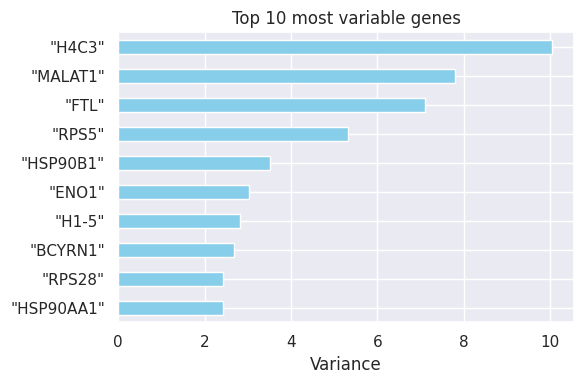

In [ ]:
plt.figure(figsize=(6, 4))
top10_HccDs.sort_values().plot.barh(color='skyblue')
plt.xlabel('Variance')
plt.title('Top 10 most variable genes')
plt.tight_layout()
plt.show()


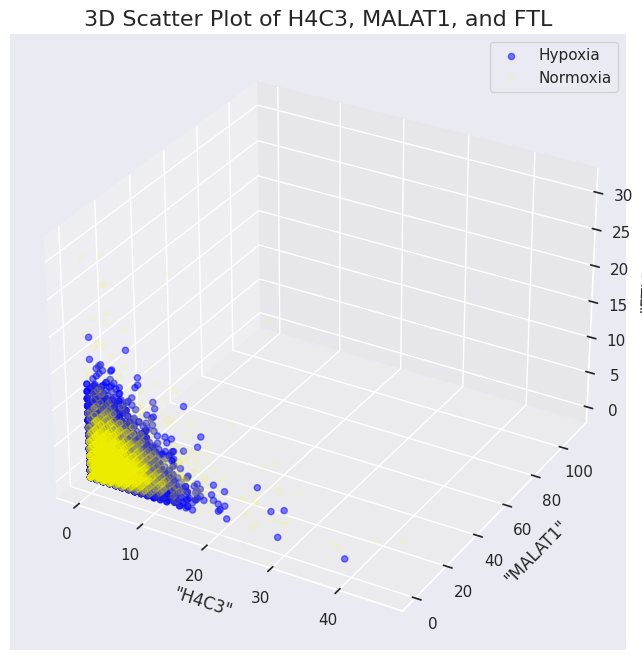

In [ ]:
HccDs_labels = np.array(HccDs_labels)

# Gene names
gene1 = '"H4C3"'
gene2 = '"MALAT1"'
gene3 = '"FTL"'

# Extract the expression values for each gene
x = HCC1806_DropS[gene1].values
y = HCC1806_DropS[gene2].values
z = HCC1806_DropS[gene3].values

# Define Hypoxia and Normoxia cell indices
hypoxia_indices = HccDs_labels == 1
normoxia_indices = HccDs_labels == 0


# Create figure for 3D plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the points: Hypoxia in green and Normoxia in blue
ax.scatter(x[hypoxia_indices], y[hypoxia_indices], z[hypoxia_indices], color='blue', label="Hypoxia", alpha=0.5)
ax.scatter(x[normoxia_indices], y[normoxia_indices], z[normoxia_indices], color='yellow', label="Normoxia", alpha=0.05)

# Set axis labels with the gene names
ax.set_xlabel(gene1)
ax.set_ylabel(gene2)
ax.set_zlabel(gene3)

plt.title(f"3D Scatter Plot of H4C3, MALAT1, and FTL", fontsize=16)

ax.legend()

plt.show()


In [ ]:
# Select a random sample of 500 cells
HccDs_sampled_cells = HCC1806_DropS.sample(n=500, random_state=42)
'''cleaned = MCF7Ds_sampled_cells.dropna()
cleaned
'''
# Calculate the variance of each cell (row)
cell_variances = HccDs_sampled_cells.var(axis=1)

# Identify constant rows (those with zero variance)
constant_rows = cell_variances[cell_variances == 0].index

# Drop constant rows from the DataFrame
HccDs_cleaned1 = HccDs_sampled_cells.drop(index=constant_rows)

# Do the same for genes

gene_variances = HccDs_cleaned1.var(axis=0)
constant_columns = gene_variances[gene_variances == 0].index
HccDs_cleaned = HccDs_cleaned1.drop(columns=constant_columns)



HccDs_cleaned


,"""H1-5""","""MALAT1""","""MT-RNR2""","""BCYRN1""","""IGFBP3""","""H1-3""","""CTIF""","""RNF123""","""CCDC97""","""TRPT1""",...,"""KEAP1""","""RAD9A""","""ZFAS1""","""CDKN3""","""DLD""","""PMPCA""","""SCCPDH""","""NTAN1""","""DUSP23""",Condition
"""CCGCTCGGGTCA_Hypoxia""",0,0,0,2,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""CCCCGCATTTGA_Hypoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""CGATCAATTCCT_Hypoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""GATACGGGAAGG_Hypoxia""",1,0,2,2,1,3,1,0,0,0,...,0,0,0,0,0,0,0,1,0,1
"""GCAGGAGCAGCC_Hypoxia""",0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""CGTTACACTTAT_Normoxia""",0,1,2,3,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
"""CACGTGCCCCGG_Hypoxia""",0,0,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""CGTTGCGGGGGA_Hypoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""TCGTGCGTCTTA_Hypoxia""",0,0,0,0,0,2,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
def get_HCC_cell_labels(dataframe):
    HccDs_cleaned_labels = []
    for cell in HccDs_cleaned.index:
        if 'Norm' in cell:
            HccDs_cleaned_labels.append(0)
        elif 'Hypo' in cell:
            HccDs_cleaned_labels.append(1)
        else:
            print(f"Warning: Could not determine label for cell: {cell}")
            HccDs_cleaned_labels.append('UNKNOWN')

    return HccDs_cleaned_labels

In [ ]:
HccDs_cleaned_labels = get_HCC_cell_labels(HccDs_cleaned)
HccDs_cleaned['Condition'] = HccDs_cleaned_labels
HccDs_cleaned.head()

,"""H1-5""","""MALAT1""","""MT-RNR2""","""BCYRN1""","""IGFBP3""","""H1-3""","""CTIF""","""RNF123""","""CCDC97""","""TRPT1""",...,"""KEAP1""","""RAD9A""","""ZFAS1""","""CDKN3""","""DLD""","""PMPCA""","""SCCPDH""","""NTAN1""","""DUSP23""",Condition
"""CCGCTCGGGTCA_Hypoxia""",0,0,0,2,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""CCCCGCATTTGA_Hypoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""CGATCAATTCCT_Hypoxia""",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
"""GATACGGGAAGG_Hypoxia""",1,0,2,2,1,3,1,0,0,0,...,0,0,0,0,0,0,0,1,0,1
"""GCAGGAGCAGCC_Hypoxia""",0,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
HccDs_cell_corr = HccDs_cleaned.T.corr()
HccDs_cell_corr

,"""CCGCTCGGGTCA_Hypoxia""","""CCCCGCATTTGA_Hypoxia""","""CGATCAATTCCT_Hypoxia""","""GATACGGGAAGG_Hypoxia""","""GCAGGAGCAGCC_Hypoxia""","""TTGCTGCCTCTG_Hypoxia""","""GGTGCTAGGGTA_Hypoxia""","""CGATTCACCCCT_Normoxia""","""CGACGGATCTTG_Hypoxia""","""CGGGCCTGAGAT_Hypoxia""",...,"""CCGGACTAGGAT_Normoxia""","""AGATACCAAACA_Normoxia""","""GGGCTCTCGCCT_Hypoxia""","""GGCCAATACCGT_Hypoxia""","""AAGAGTGGAAGC_Hypoxia""","""CGTTACACTTAT_Normoxia""","""CACGTGCCCCGG_Hypoxia""","""CGTTGCGGGGGA_Hypoxia""","""TCGTGCGTCTTA_Hypoxia""","""CGCGCTCTATAT_Normoxia"""
"""CCGCTCGGGTCA_Hypoxia""",1.000000,0.301319,0.289796,0.302300,0.245531,0.342447,0.367020,0.126453,0.258539,0.310217,...,0.339698,0.399859,0.317400,0.328586,0.292625,0.556521,0.330136,0.280892,0.209162,0.222085
"""CCCCGCATTTGA_Hypoxia""",0.301319,1.000000,0.153606,0.249976,0.170172,0.282789,0.310427,0.188003,0.219000,0.253680,...,0.188292,0.338371,0.123016,0.344135,0.225673,0.273444,0.286564,0.188929,0.297881,0.214430
"""CGATCAATTCCT_Hypoxia""",0.289796,0.153606,1.000000,0.291695,0.213023,0.295325,0.460492,0.120087,0.174186,0.163233,...,0.310445,0.300355,0.246791,0.292172,0.232713,0.385072,0.308811,0.443260,0.279077,0.285277
"""GATACGGGAAGG_Hypoxia""",0.302300,0.249976,0.291695,1.000000,0.269485,0.412564,0.501453,0.240812,0.304982,0.278571,...,0.291542,0.437970,0.239607,0.587821,0.434068,0.442960,0.363110,0.341717,0.458919,0.470396
"""GCAGGAGCAGCC_Hypoxia""",0.245531,0.170172,0.213023,0.269485,1.000000,0.322212,0.353453,0.239515,0.236288,0.289338,...,0.301767,0.363301,0.149171,0.366261,0.368947,0.263531,0.271519,0.188280,0.314440,0.336755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""CGTTACACTTAT_Normoxia""",0.556521,0.273444,0.385072,0.442960,0.263531,0.418311,0.537839,0.253033,0.447470,0.263267,...,0.416611,0.523500,0.277806,0.441743,0.355375,1.000000,0.476070,0.386013,0.394721,0.480639
"""CACGTGCCCCGG_Hypoxia""",0.330136,0.286564,0.308811,0.363110,0.271519,0.336417,0.472535,0.282396,0.295766,0.319868,...,0.317990,0.357078,0.269848,0.375523,0.335916,0.476070,1.000000,0.341495,0.363548,0.467286
"""CGTTGCGGGGGA_Hypoxia""",0.280892,0.188929,0.443260,0.341717,0.188280,0.325944,0.318697,0.323989,0.273613,0.194509,...,0.354088,0.293114,0.235826,0.299546,0.171534,0.386013,0.341495,1.000000,0.258318,0.343656
"""TCGTGCGTCTTA_Hypoxia""",0.209162,0.297881,0.279077,0.458919,0.314440,0.556031,0.450413,0.200512,0.384082,0.273969,...,0.235695,0.391985,0.167733,0.543751,0.358913,0.394721,0.363548,0.258318,1.000000,0.487996


In [ ]:
# Get the indices for Hypoxia and Normoxia cells
HccDs_cleaned_labels = np.array(HccDs_cleaned_labels)

HccDs_cells_hypo = HccDs_cleaned.index[HccDs_cleaned_labels == 1]
HccDs_cells_norm = HccDs_cleaned.index[HccDs_cleaned_labels == 0]

# Combine the indices for Hypoxia and Normoxia into a single index
combined_cells = pd.Index(np.concatenate([HccDs_cells_hypo, HccDs_cells_norm]))

# Now subset the correlation matrix using the combined cells' index
HccDs_cells_heat = HccDs_cell_corr.loc[combined_cells, combined_cells]

HccDs_cells_heat.head()

,"""CCGCTCGGGTCA_Hypoxia""","""CCCCGCATTTGA_Hypoxia""","""CGATCAATTCCT_Hypoxia""","""GATACGGGAAGG_Hypoxia""","""GCAGGAGCAGCC_Hypoxia""","""TTGCTGCCTCTG_Hypoxia""","""GGTGCTAGGGTA_Hypoxia""","""CGACGGATCTTG_Hypoxia""","""CGGGCCTGAGAT_Hypoxia""","""TAGGCCTCTCGA_Hypoxia""",...,"""GTTCTGTGGCGG_Normoxia""","""TAGCCGCCAAGC_Normoxia""","""CACCCCACCCGT_Normoxia""","""CGCCGGCGCCAA_Normoxia""","""GGAATCCATAGA_Normoxia""","""AGCAGCAACACG_Normoxia""","""CCGGACTAGGAT_Normoxia""","""AGATACCAAACA_Normoxia""","""CGTTACACTTAT_Normoxia""","""CGCGCTCTATAT_Normoxia"""
"""CCGCTCGGGTCA_Hypoxia""",1.000000,0.301319,0.289796,0.302300,0.245531,0.342447,0.367020,0.258539,0.310217,0.209526,...,0.140010,0.232449,0.316800,0.384128,0.334081,0.417687,0.339698,0.399859,0.556521,0.222085
"""CCCCGCATTTGA_Hypoxia""",0.301319,1.000000,0.153606,0.249976,0.170172,0.282789,0.310427,0.219000,0.253680,0.243774,...,0.223855,0.278354,0.156940,0.168824,0.354631,0.235567,0.188292,0.338371,0.273444,0.214430
"""CGATCAATTCCT_Hypoxia""",0.289796,0.153606,1.000000,0.291695,0.213023,0.295325,0.460492,0.174186,0.163233,0.182203,...,0.115271,0.195623,0.138243,0.243123,0.248968,0.394069,0.310445,0.300355,0.385072,0.285277
"""GATACGGGAAGG_Hypoxia""",0.302300,0.249976,0.291695,1.000000,0.269485,0.412564,0.501453,0.304982,0.278571,0.430070,...,0.411964,0.441245,0.291156,0.217779,0.502586,0.453866,0.291542,0.437970,0.442960,0.470396
"""GCAGGAGCAGCC_Hypoxia""",0.245531,0.170172,0.213023,0.269485,1.000000,0.322212,0.353453,0.236288,0.289338,0.165646,...,0.282211,0.450451,0.230475,0.232909,0.330167,0.294241,0.301767,0.363301,0.263531,0.336755


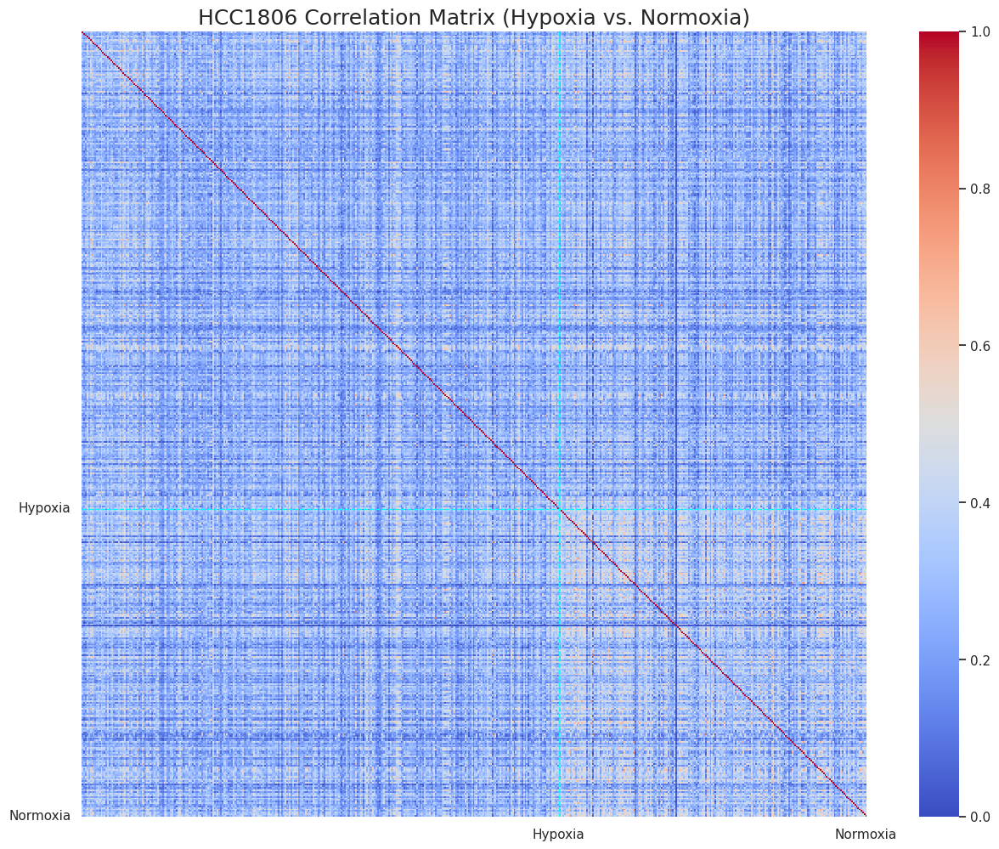

In [ ]:
# Create the heatmap for the correlation matrix
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap
sns.heatmap(HccDs_cells_heat, vmax=1, vmin=0, cmap='coolwarm',
            cbar=True, square=True, annot=False, fmt='.2f', ax=ax)

hypoxia_pos = sum(HccDs_cleaned_labels == 1)  # Number of Hypoxia cells
normoxia_pos = sum(HccDs_cleaned_labels == 0)  # Number of Normoxia cells

# Add the cyan dashed lines to visually separate the conditions
plt.plot([0, HccDs_cells_heat.shape[0]], [hypoxia_pos, hypoxia_pos], color='cyan', linestyle='dashed', linewidth=1)
plt.plot([hypoxia_pos, hypoxia_pos], [0, HccDs_cells_heat.shape[0]], color='cyan', linestyle='dashed', linewidth=1)

# Add labels for Hypoxia and Normoxia
plt.yticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)
plt.xticks([hypoxia_pos - 0.5, normoxia_pos + hypoxia_pos - 0.5], ["Hypoxia", "Normoxia"], rotation=0)

plt.title("HCC1806 Correlation Matrix (Hypoxia vs. Normoxia)", fontsize=18)

plt.show()


As we can see, there are worse results with respect to SmartSeq, we can see some **High Intra-group Correlation**, mostly in cells within the group of Normoxia, but the rest of the correlation rates are close to 0.

In [ ]:
HccDs_corr = pd.concat([HCC1806_DropS, pd.DataFrame(HccDs_labels)], axis=1)

HccDs_genes_corr = HccDs_corr.corr()

HccDs_genes_corr





,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""","""RNF123""",...,"""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682""",Condition,0
"""H1-5""",1.000000,0.087133,-0.017357,-0.002120,-0.096744,0.004191,0.118818,0.336731,-0.002051,0.000912,...,0.024498,0.003208,-0.009007,0.008235,0.000721,0.009859,-0.012634,0.000056,-0.036813,NaN
"""MALAT1""",0.087133,1.000000,-0.046229,0.016949,-0.116367,0.009924,0.102267,0.074423,-0.000084,0.021321,...,0.024283,0.010392,0.000047,-0.001216,-0.002274,0.016328,-0.006517,-0.001277,-0.114990,NaN
"""MT-RNR2""",-0.017357,-0.046229,1.000000,-0.001334,0.129449,-0.007056,0.019157,-0.001826,0.022420,-0.002965,...,-0.005609,-0.003893,0.006614,-0.010232,-0.001957,-0.004921,0.009350,0.001816,-0.046721,NaN
"""ARVCF""",-0.002120,0.016949,-0.001334,1.000000,-0.007670,-0.000784,0.001508,-0.008722,-0.000612,-0.000612,...,-0.003833,0.009413,-0.001549,-0.002306,-0.001951,-0.001261,0.005851,-0.000526,0.016130,NaN
"""BCYRN1""",-0.096744,-0.116367,0.129449,-0.007670,1.000000,0.000927,-0.127291,-0.092953,-0.000523,-0.009658,...,-0.019130,0.001374,-0.001324,-0.015065,-0.004428,-0.007495,0.018677,-0.003816,-0.286631,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"""CLIP2""",0.009859,0.016328,-0.004921,-0.001261,-0.007495,-0.001326,0.005416,0.003461,-0.001034,-0.001034,...,0.015700,0.004566,-0.002619,-0.003898,-0.003299,1.000000,-0.005589,-0.000889,-0.022911,NaN
"""DUSP23""",-0.012634,-0.006517,0.009350,0.005851,0.018677,0.013157,-0.009840,-0.015976,-0.002712,-0.002712,...,0.008231,-0.003508,-0.000943,-0.010223,0.000933,-0.005589,1.000000,-0.002332,-0.002759,NaN
"""ZNF682""",0.000056,-0.001277,0.001816,-0.000526,-0.003816,-0.000553,-0.004855,-0.010075,-0.000431,-0.000431,...,-0.002704,-0.001693,-0.001093,-0.001626,-0.001376,-0.000889,-0.002332,1.000000,0.009895,NaN
Condition,-0.036813,-0.114990,-0.046721,0.016130,-0.286631,-0.022268,0.256976,0.033070,0.002776,-0.002318,...,-0.026069,-0.024245,-0.009466,0.001134,0.006803,-0.022911,-0.002759,0.009895,1.000000,NaN


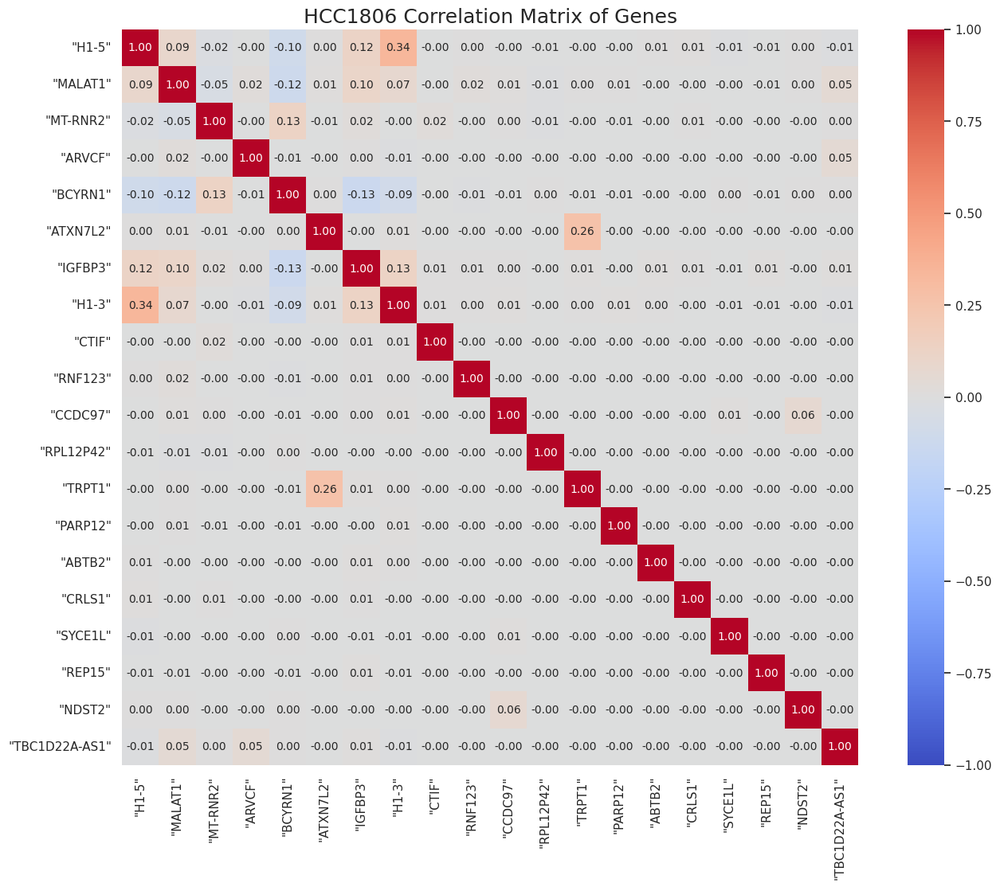

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))

# Plot the heatmap of gene correlations (top 20 genes)
sns.heatmap(HccDs_genes_corr.iloc[:20, :20], vmax=1, vmin=-1, cmap='coolwarm',
            annot=True, fmt='.2f', annot_kws={'size': 10}, cbar=True, square=True, ax=ax)

cplt.title("HCC1806 Correlation Matrix of Genes", fontsize=18)
plt.show()


In [ ]:
HccDs_cells_hypo_corr = pd.Series.sort_values((HccDs_genes_corr["Condition"]), ascending=False)

HccDs_important_genes = list(HccDs_cells_hypo_corr.index[:20])


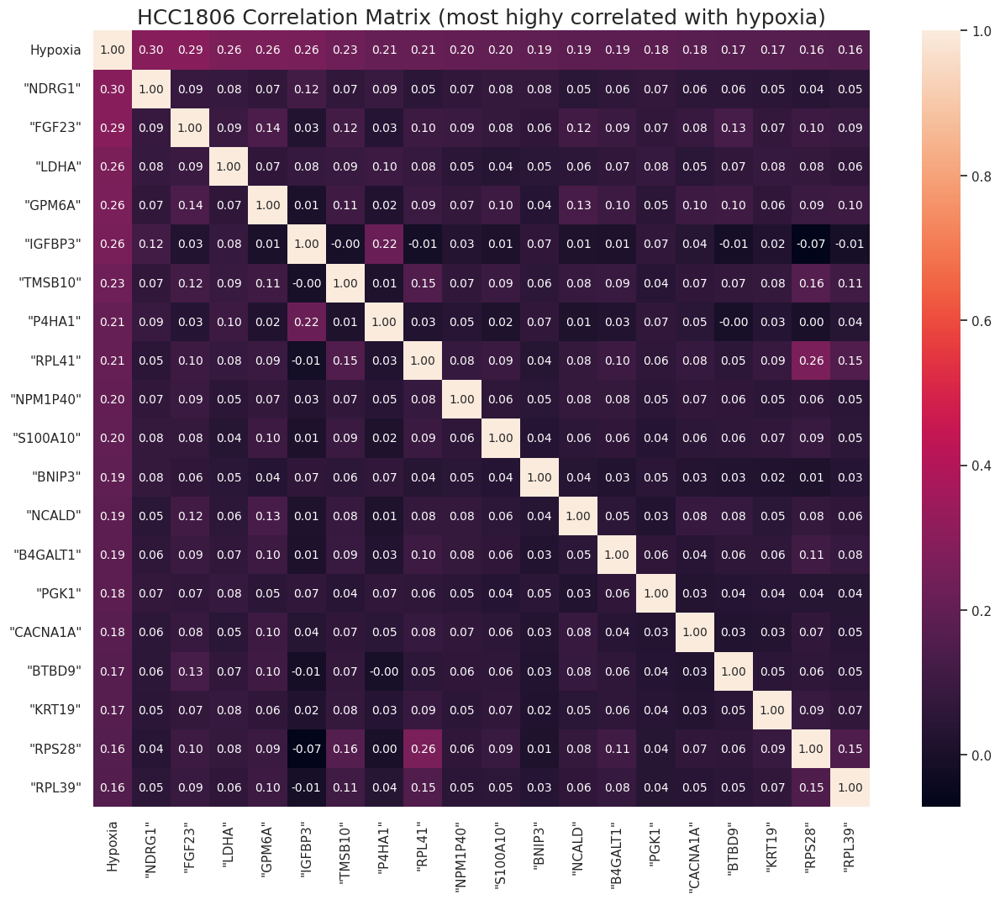

In [ ]:
f, ax = plt.subplots(figsize=(16, 12))
sns.heatmap(HccDs_genes_corr.loc[HccDs_important_genes, HccDs_important_genes], vmax=1,
            cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10})
plt.yticks([i+0.5 for i in range(20)], ['Hypoxia'] + HccDs_important_genes[1:])
plt.xticks([i+0.5 for i in range(20)], ['Hypoxia'] + HccDs_important_genes[1:])
plt.title("HCC1806 Correlation Matrix (most highy correlated with hypoxia)", fontsize=18);


<ipython-input-75-4232655873>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(HccDs_labels), y = HCC1806_DropS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-75-4232655873>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(HccDs_labels), y = HCC1806_DropS[gene], palette={'0': 'orange', '1': 'green'})
<ipython-input-75-4232655873>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(ax = ax[row, col], x = np.array(HccDs_labels), y = HCC1806_DropS[gene], palette={'0':

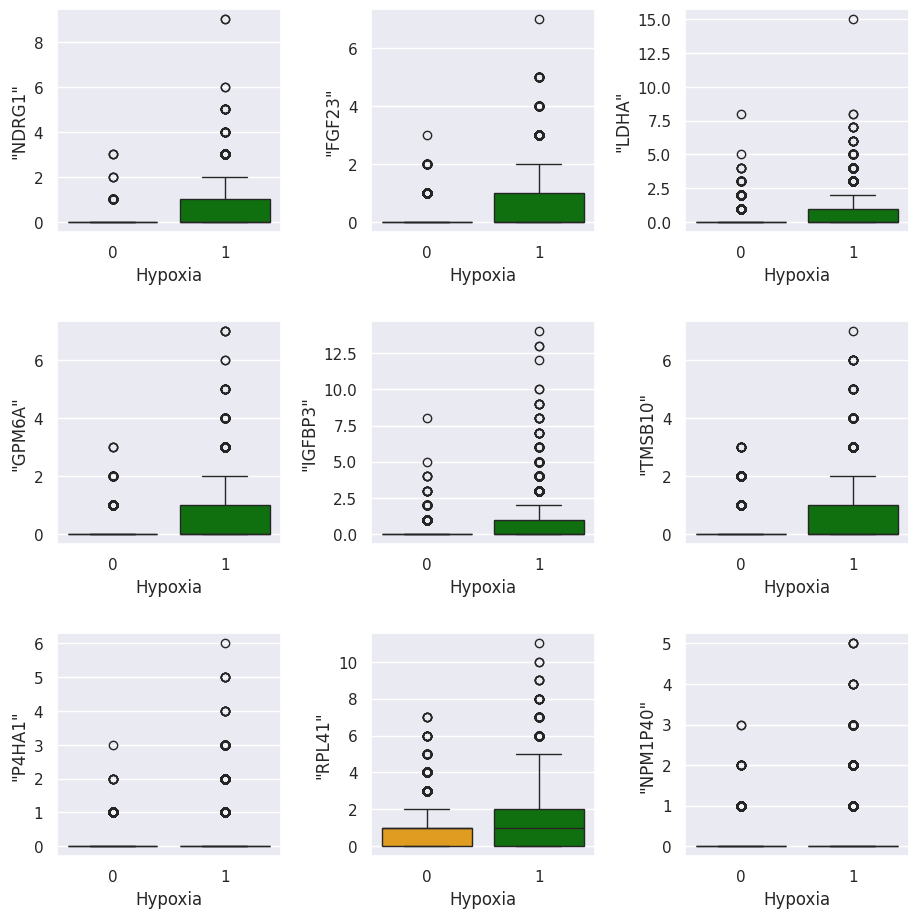

In [ ]:
fig, ax = plt.subplots(3, 3, figsize=(11, 11))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
def find_subplot(i):
  j = i
  r = j//3
  c = j - r*3
  return (r, c)
for i in range(0, 9):
  row, col = find_subplot(i)
  gene = HccDs_cells_hypo_corr.index[i+1]

  sns.boxplot(ax = ax[row, col], x = np.array(HccDs_labels), y = HCC1806_DropS[gene], palette={'0': 'orange', '1': 'green'})
  ax[row, col].set_xlabel("Hypoxia")

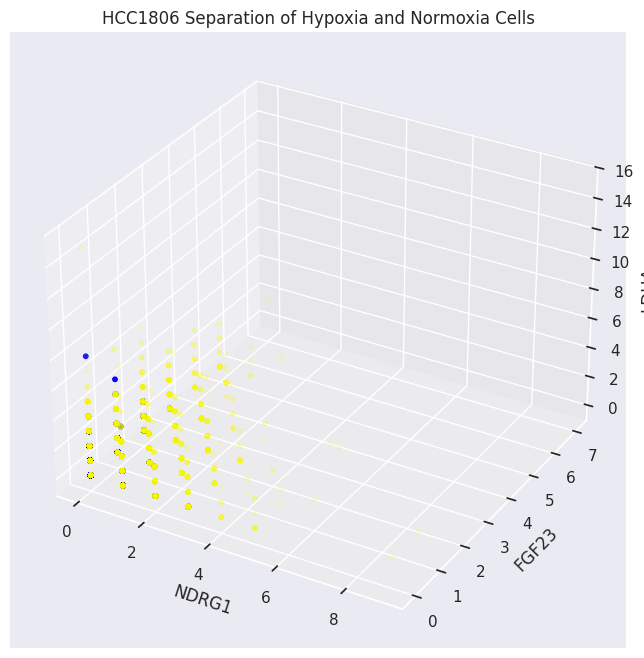

In [ ]:
HccDs_hypo_ind = np.where(HccDs_corr.loc[:, "Condition"] == 1)
HccDs_norm_ind = np.where(HccDs_corr.loc[:, "Condition"] == 0)

HccDs_nd_hypo = HccDs_corr.iloc[HccDs_hypo_ind].loc[:, '"NDRG1"']
HccDs_fg_hypo = HccDs_corr.iloc[HccDs_hypo_ind].loc[:, '"FGF23"']
HccDs_ld_hypo = HccDs_corr.iloc[HccDs_hypo_ind].loc[:, '"LDHA"']

HccDs_nd_norm = HccDs_corr.iloc[HccDs_norm_ind].loc[:, '"NDRG1"']
HccDs_fg_norm = HccDs_corr.iloc[HccDs_norm_ind].loc[:, '"FGF23"']
HccDs_ld_norm = HccDs_corr.iloc[HccDs_norm_ind].loc[:, '"LDHA"']


# Creating figure
fig = plt.figure(figsize = (12, 8))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(HccDs_nd_hypo, HccDs_fg_hypo, HccDs_ld_hypo, color = "yellow", s=10, alpha = 0.1)
ax.scatter3D(HccDs_nd_norm, HccDs_fg_norm, HccDs_ld_norm, color = "blue", s=10, alpha = 1)
lbl_x = ax.set_xlabel('NDRG1')
lbl_y = ax.set_ylabel('FGF23')
lbl_z = ax.set_zlabel('LDHA')

lbl_x.set_rotation(30)
lbl_y.set_rotation(45)
lbl_z.set_rotation(90)

plt.title("HCC1806 Separation of Hypoxia and Normoxia Cells")

# show plot
plt.show()

# Unsupervised analysis

In this section, we apply unsupervised learning techniques to analyze single-cell gene expression data from normoxic and hypoxic conditions. The primary motivation for using unsupervised learning lies in the exploratory and data-driven nature of the biological questions at hand.
The goal is not merely to label cells by condition, but to discover intrinsic structure in the data: Are there distinct transcriptional programs activated under hypoxia? Are there subpopulations of cells with divergent responses?

•	Lack of predefined labels: While hypoxia and normoxia are known global conditions, individual cells may exhibit a spectrum of gene expression responses. Clustering helps reveal hidden substructures.

•	Hypothesis generation: Unsupervised methods allow us to identify emerging patterns in gene expression without bias.

___

We import the necessary packages.

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt

___

Some utility functions.

In [ ]:
# Sanity check
def sanity_check(df):

    # Shape
    print(f"Shape: {df.shape[0]} cells x {df.shape[1]} genes")

    # Check for missing values
    total_nans = df.isna().sum().sum()
    print(f"Missing values: {total_nans}")

    # Check for negative values
    has_negatives = (df < 0).any().any()
    print(f"Negative values present: {has_negatives}")

    # Zero-only genes
    zero_genes = (df == 0).all(axis=0).sum()
    print(f"Genes with all zero expression: {zero_genes}")

# Retrieve cell name
def get_cell_names(dataframe):
    names = []
    for cell in dataframe.index:
        count = 0
        name = ''
        for char in cell:
            if count == 1:
                name += char
            elif count == 2:
                names.append(name.replace('_', ''))
                break
            if char == '_':
                count += 1
            else:
                continue
    return names

# Retrieve gene name
def get_gene_names(dataframe):
    names = []
    for gene in dataframe.columns:
        names.append(gene)
    return names

# Retrieve labels
def get_cell_labels(dataframe):
    labels = []
    for cell in dataframe.index:
        if 'Norm' in cell:
            labels.append('Norm')
        else:
            labels.append('Hypo')
    return labels

___

Open data as Pandas dataframes.

In [ ]:
# SmartSeq data loading
train_MCF_or = pd.read_csv("/Users/federicoscaffidimuta/Desktop/Uni/Second Year/Second semester/AI Lab/Project data/SmartSeq/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt",
                 delimiter="\ ",
                 engine='python',
                 index_col=0
                 )

train_HCC_or = pd.read_csv("/Users/federicoscaffidimuta/Desktop/Uni/Second Year/Second semester/AI Lab/Project data/SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt",
                 delimiter="\ ",
                 engine='python',
                 index_col=0
                 )

<>:3: SyntaxWarning: invalid escape sequence '\ '
<>:9: SyntaxWarning: invalid escape sequence '\ '
<>:3: SyntaxWarning: invalid escape sequence '\ '
<>:9: SyntaxWarning: invalid escape sequence '\ '
/var/folders/y_/7gd_6b7d7h9b8772krl0vj4m0000gn/T/ipykernel_3043/1170465915.py:3: SyntaxWarning: invalid escape sequence '\ '
  delimiter="\ ",
/var/folders/y_/7gd_6b7d7h9b8772krl0vj4m0000gn/T/ipykernel_3043/1170465915.py:9: SyntaxWarning: invalid escape sequence '\ '
  delimiter="\ ",


In [ ]:
# DropSeq data loading
train_MCFdr_or = pd.read_csv("/Users/federicoscaffidimuta/Desktop/Uni/Second Year/Second semester/AI Lab/Project data/DropSeq/MCF7_Filtered_Normalised_3000_Data_train.txt",
                 delimiter="\ ",
                 engine='python',
                 index_col=0
                 )

train_HCCdr_or = pd.read_csv("/Users/federicoscaffidimuta/Desktop/Uni/Second Year/Second semester/AI Lab/Project data/DropSeq/HCC1806_Filtered_Normalised_3000_Data_train.txt",
                 delimiter="\ ",
                 engine='python',
                 index_col=0
                 )

<>:3: SyntaxWarning: invalid escape sequence '\ '
<>:9: SyntaxWarning: invalid escape sequence '\ '
<>:3: SyntaxWarning: invalid escape sequence '\ '
<>:9: SyntaxWarning: invalid escape sequence '\ '
/var/folders/y_/7gd_6b7d7h9b8772krl0vj4m0000gn/T/ipykernel_3043/4259948405.py:3: SyntaxWarning: invalid escape sequence '\ '
  delimiter="\ ",
/var/folders/y_/7gd_6b7d7h9b8772krl0vj4m0000gn/T/ipykernel_3043/4259948405.py:9: SyntaxWarning: invalid escape sequence '\ '
  delimiter="\ ",


___

We transpose the dataframe in order to confrom to the structure that PCA, KMeans, UMAP, and most ML algorithms expect.

In [ ]:
# Transpose dataframe
train_MCF = train_MCF_or.T
train_HCC = train_HCC_or.T
train_MCFdr = train_MCFdr_or.T
train_HCCdr = train_HCCdr_or.T

___

Get a preview of the data

In [ ]:
# Dataframe preview
train_MCF.head()

,"""CYP1B1""","""CYP1B1-AS1""","""CYP1A1""","""NDRG1""","""DDIT4""","""PFKFB3""","""HK2""","""AREG""","""MYBL2""","""ADM""",...,"""CD27-AS1""","""DNAI7""","""MAFG""","""LZTR1""","""BCO2""","""GRIK5""","""SLC25A27""","""DENND5A""","""CDK5R1""","""FAM13A-AS1"""
"""output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam""",343,140,0,0,386,75,0,0,476,0,...,63,0,17,59,0,0,0,51,0,0
"""output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam""",131,59,0,1,289,42,0,856,1586,0,...,0,0,1,25,0,0,0,34,0,0
"""output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam""",452,203,0,0,0,0,0,0,775,0,...,15,0,23,0,0,0,0,0,0,0
"""output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam""",27,7,0,0,288,214,15,242,1191,0,...,1,0,3,10,0,0,0,4,0,0
"""output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam""",5817,2669,0,654,2484,1603,748,436,0,0,...,0,0,63,0,0,0,0,60,0,0


In [ ]:
# Dataframe preview
train_HCC.head()

,"""DDIT4""","""ANGPTL4""","""CALML5""","""KRT14""","""CCNB1""","""IGFBP3""","""AKR1C2""","""KRT6A""","""NDRG1""","""KRT4""",...,"""MST1R""","""ZYG11A""","""NRG1""","""RBMS3""","""VCPIP1""","""LINC02693""","""OR8B9P""","""NEAT1""","""ZDHHC23""","""ODAD2"""
"""output.STAR.PCRPlate1G12_Normoxia_S32_Aligned.sortedByCoord.out.bam""",0,48,0,321,298,82,6250,634,0,0,...,78,10,136,0,0,29,0,29,0,0
"""output.STAR.PCRPlate1G1_Hypoxia_S102_Aligned.sortedByCoord.out.bam""",8739,2101,55,96,1824,1938,62,0,522,413,...,279,0,264,0,134,68,0,213,0,0
"""output.STAR.PCRPlate1G2_Hypoxia_S2_Aligned.sortedByCoord.out.bam""",13098,14032,0,0,1616,247,430,907,348,0,...,311,0,38,0,0,0,0,92,0,0
"""output.STAR.PCRPlate1G3_Hypoxia_S7_Aligned.sortedByCoord.out.bam""",2880,356,0,6211,3,3430,79,1953,592,176,...,125,0,16,0,4,1,0,1,0,0
"""output.STAR.PCRPlate1G4_Hypoxia_S107_Aligned.sortedByCoord.out.bam""",7777,5661,4383,0,145,4618,246,85,206,0,...,268,1,25,0,0,0,0,128,0,0


In [ ]:
# Dataframe preview
train_MCFdr.head()

,"""MALAT1""","""MT-RNR2""","""NEAT1""","""H1-5""","""TFF1""","""MT-RNR1""","""H4C3""","""GDF15""","""KRT81""","""MT-CO3""",...,"""MROH1""","""SKIDA1""","""MICALL1""","""RARG""","""MYO1F""","""BRWD1-AS2""","""RPS19BP1""","""AUNIP""","""TNK2""","""SUDS3"""
"""AAAAACCTATCG_Normoxia""",1,0,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACAACCCTA_Normoxia""",3,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACACTCTCA_Normoxia""",3,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCAGGCAC_Normoxia""",6,2,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCTAGCTC_Normoxia""",4,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Dataframe preview
train_HCCdr.head()

,"""H1-5""","""MALAT1""","""MT-RNR2""","""ARVCF""","""BCYRN1""","""ATXN7L2""","""IGFBP3""","""H1-3""","""CTIF""","""RNF123""",...,"""BATF3""","""CDKN3""","""DLD""","""PMPCA""","""ZNF165""","""SCCPDH""","""NTAN1""","""CLIP2""","""DUSP23""","""ZNF682"""
"""AAAAAACCCGGC_Normoxia""",2,3,0,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACCGGATGC_Normoxia""",2,3,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACGAGCTAG_Normoxia""",5,2,0,0,1,0,1,3,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAACTTCCCCG_Normoxia""",1,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"""AAAAGCCTACCC_Normoxia""",0,12,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


___

We perform a sanity check to see if there is any missing/NaN value in a dataframe

In [ ]:
sanity_check(train_MCF)
print("\n")
sanity_check(train_HCC)
print("\n")
sanity_check(train_MCFdr)
print("\n")
sanity_check(train_HCCdr)

Shape: 250 cells x 3000 genes
Missing values: 0
Negative values present: False
Genes with all zero expression: 0


Shape: 182 cells x 3000 genes
Missing values: 0
Negative values present: False
Genes with all zero expression: 0


Shape: 21626 cells x 3000 genes
Missing values: 0
Negative values present: False
Genes with all zero expression: 0


Shape: 14682 cells x 3000 genes
Missing values: 0
Negative values present: False
Genes with all zero expression: 0


___

We apply a log2 transformation (i.e., log2(counts + 1)) to stabilize variance and reduce skewness.
Raw expression/count data are highly skewed with a wide dynamic range; log2 compresses large values,
makes distributions more symmetric, and mitigates the influence of extreme outliers.
This helps downstream methods (e.g., PCA, clustering) that often assume roughly homoscedastic or normal-like data. This will be used in ScanPy gene_ranking.

In [ ]:
train_MCF_log = train_MCF.apply(lambda x: np.log2(1+x))
train_HCC_log = train_HCC.apply(lambda x: np.log2(1+x))
train_MCFdr_log = train_MCFdr.apply(lambda x: np.log2(1+x))
train_HCCdr_log = train_HCCdr.apply(lambda x: np.log2(1+x))

___

We do not apply scaling to our data, since blindly scaling every feature to unit variance could remove genuine biological differences
in variance; instead, we will focus PCA on genes whose variability reflects meaningful signal, having controlled for technical effects earlier.

___

# Dimensionality reduction

We perform PCA to reduce dimensionality by projecting the data onto orthogonal components that capture the most variance.
This denoises the data (removing low-variance noise), speeds up downstream computations (clustering, neighborhood graph),
and facilitates visualization (e.g., plotting cells in PC space or on UMAP). It focuses analysis on the main sources of variation.

In short, PCA works by computing orthogonal axes (principal components) that capture the most variance in the data:
- We center the data and calculate its covariance.
- The eigenvectors of this covariance define directions of maximal variance.
- Projecting the data onto the top components yields a lower-dimensional representation that preserves the main variance structure.

In [ ]:
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error as mse

We examine explained variance to select the number of PCs because it tells us how much of the original data’s variability is captured by the top components. We want enough PCs to cover most meaningful variation while avoiding noise-dominated components.

In [ ]:
def plot_pca_explained_variance(X, step=10, threshold=0.95):

    # Fit PCA on all components
    pca = PCA(n_components = min(X.shape[0], X.shape[1]), random_state=0)
    pca.fit(X)
    explained = pca.explained_variance_ratio_
    cum_explained = np.cumsum(explained)

    # Prepare component indices
    comps = np.arange(1, len(explained) + 1)

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(comps, cum_explained, marker='s', label='Cumulative')
    plt.axhline(y=threshold, color='gray', linestyle='--', linewidth=1,
                label=f'{int(threshold*100)}% threshold')

    # X-ticks at the given step
    #plt.xticks(comps[::step], comps[::step], rotation=45)

    plt.xlabel('Principal Component')
    plt.ylabel('Explained Variance Ratio')
    plt.title('PCA Explained Variance (Scree Plot)')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()

___

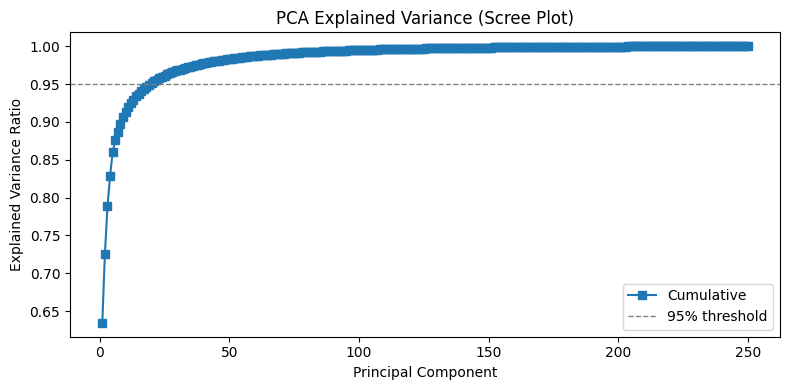

In [ ]:
plot_pca_explained_variance(train_MCF)

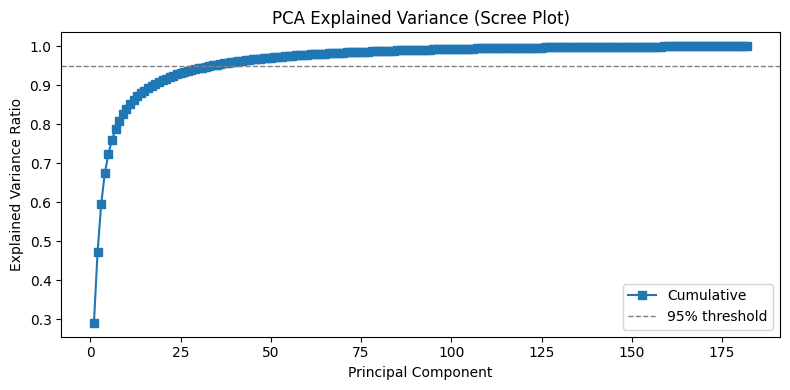

In [ ]:
plot_pca_explained_variance(train_HCC)

For a smaller dataset like SmartSeq, choosing enough PCs to explain ~95% of variance ensures we retain most of the meaningful signal
while still reducing dimensionality. With fewer cells, the risk of overfitting noise by including too many components is lower,
and keeping 95% of variance balances capturing real structure (e.g., subtle cell-type differences) against discarding
minor noise dimensions.

___

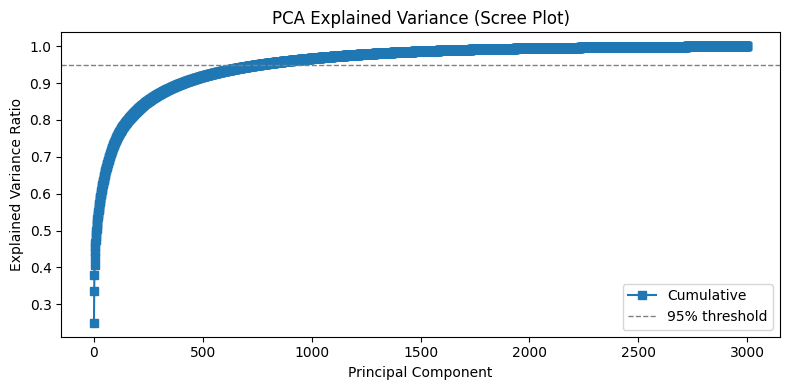

In [ ]:
plot_pca_explained_variance(train_MCFdr)

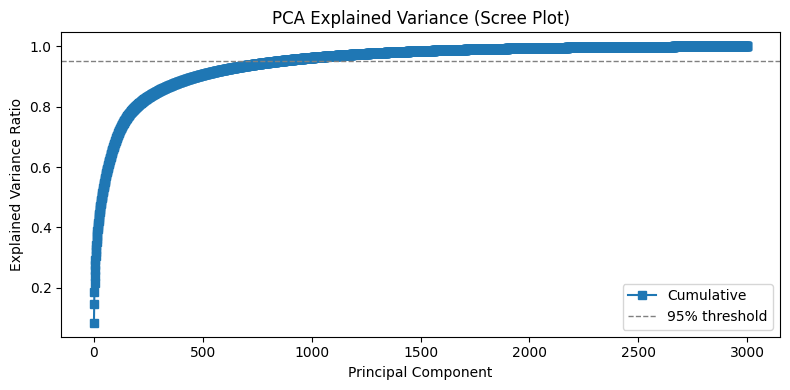

In [ ]:
plot_pca_explained_variance(train_HCCdr)

For the larger DropSeq dataset, requiring 95% explained variance may demand too many PCs, including noise dimensions and increasing computation.
Using an 80% cutoff balances retaining core biological signal while keeping dimensionality manageable,
avoiding overfitting minor variations and reducing runtime/memory burden in downstream analyses.

___

In [ ]:
pca_MCF = PCA(n_components=0.95, svd_solver='covariance_eigh')
train_MCF_red = pca_MCF.fit_transform(train_MCF)
print(train_MCF_red.shape)

(250, 20)


In [ ]:
pca_HCC = PCA(n_components=0.95, svd_solver='covariance_eigh')
train_HCC_red = pca_HCC.fit_transform(train_HCC)
print(train_HCC_red.shape)

(182, 34)


___

In [ ]:
pca_MCFdr = PCA(n_components=0.80, svd_solver='covariance_eigh')
train_MCFdr_red = pca_MCFdr.fit_transform(train_MCFdr)
print(train_MCFdr_red.shape)

(21626, 158)


In [ ]:
pca_HCCdr = PCA(n_components=0.80, svd_solver='covariance_eigh')
train_HCCdr_red = pca_HCCdr.fit_transform(train_HCCdr)
print(train_HCCdr_red.shape)

(14682, 195)


___

To get an approximate idea for the shape of the data, we plot the data in 3dD using the first three PCs as features.

In [ ]:
# Get label of one cell
def cell_tag(filename):

    if 'Norm' in filename:
        return 'Norm'
    elif 'Hypo' in filename:
        return 'Hypo'

# Classify norm/hypo reduced data into arrays
def labeling(train_df, pca_df):

    train_norm = []
    train_hypo = []

    for i in range(pca_df.shape[0]):
        if cell_tag(train_df.index[i])=='Norm':
            train_norm.append(pca_df[i])
        else:
            train_hypo.append(pca_df[i])

    train_label = [np.array(train_norm), np.array(train_hypo)]
    return train_label

# 3d plot
def plotter_3d(train_df, pca_3d_data, title):

    # Labels arrays for 3d plot
    label_plt3d = labeling(train_df, pca_3d_data)
    norm_plt3d = label_plt3d[0]
    hypo_plt3d = label_plt3d[1]
    np.save('train_norm_plt3d.npy', norm_plt3d)
    np.save('train_hypo_plt3d.npy', hypo_plt3d)

    # Scatterplot of hypo/norm (only 3 dimensions)
    fig, ax = plt.subplots(figsize = (8, 8))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(norm_plt3d[:, 0], norm_plt3d[:, 1], norm_plt3d[:, 2], marker='o', color = 'blue')
    ax.scatter(hypo_plt3d[:, 0], hypo_plt3d[:, 1], hypo_plt3d[:, 2], marker='o', color = 'red')
    ax.set_xlabel('PC 1')
    ax.set_ylabel('PC 2')
    ax.set_zlabel('PC 3')
    ax.set_title(title)
    plt.show()

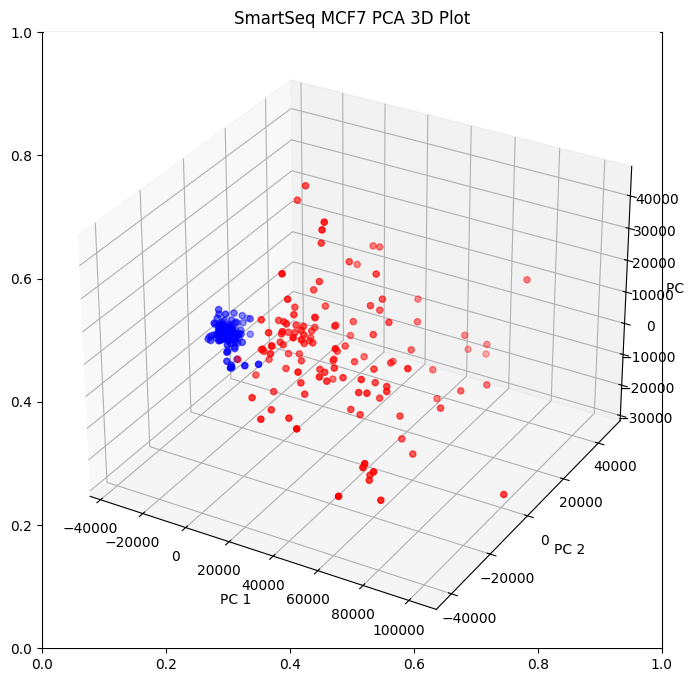

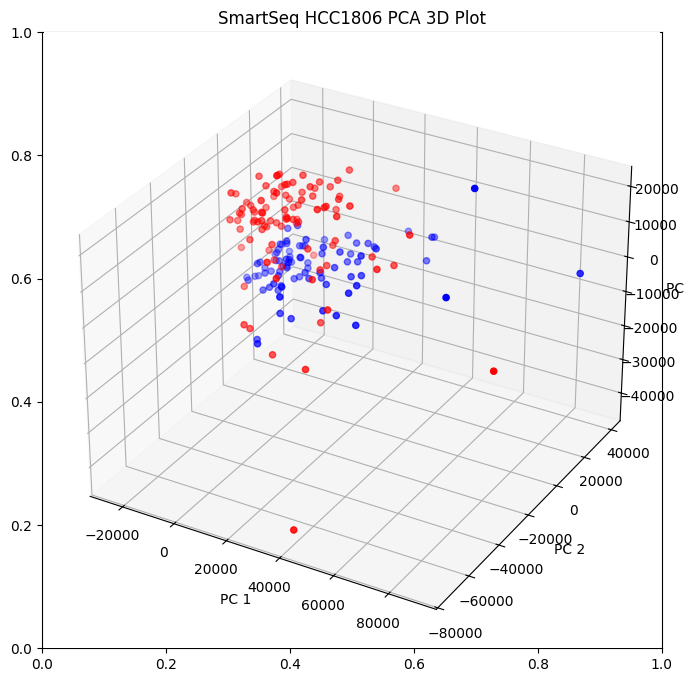

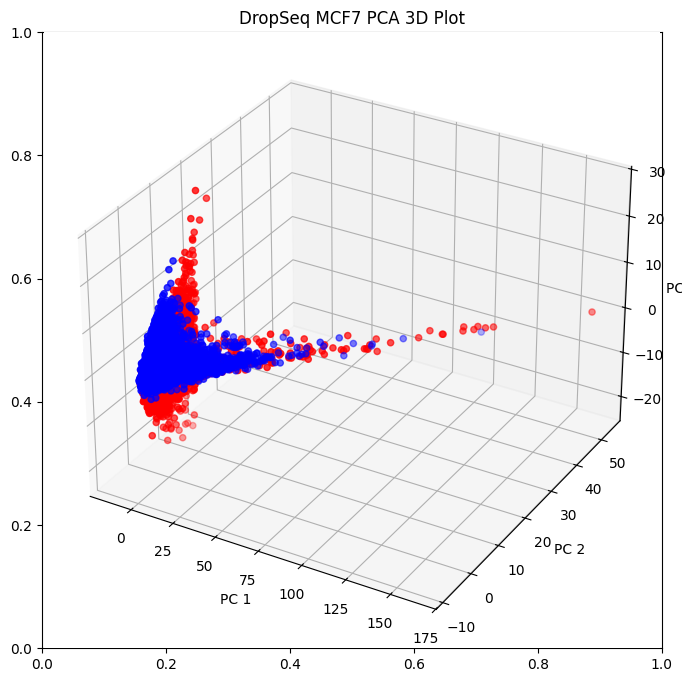

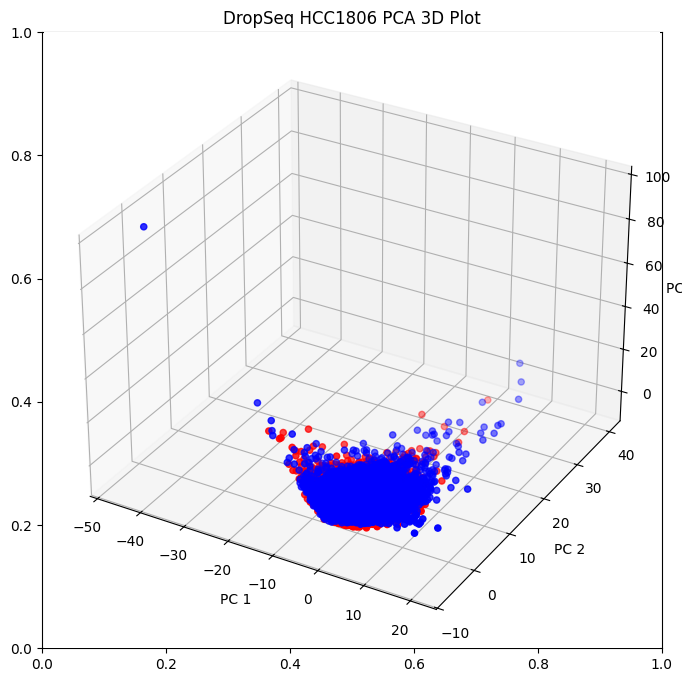

In [ ]:
plotter_3d(train_MCF, train_MCF_red, 'SmartSeq MCF7 PCA 3D Plot')
plotter_3d(train_HCC, train_HCC_red, 'SmartSeq HCC1806 PCA 3D Plot')
plotter_3d(train_MCFdr, train_MCFdr_red, 'DropSeq MCF7 PCA 3D Plot')
plotter_3d(train_HCCdr, train_HCCdr_red, 'DropSeq HCC1806 PCA 3D Plot')

It seems that only the SmartSeq data is linearly separable, but we need to investigate.

___

We use UMAP to project high-dimensional data into 2D in a way that preserves local neighborhood structure.
This visualization helps assess whether clusters form coherent “islands” and reveal relationships or trajectories
that may not be apparent in linear embeddings like PCA.

In [ ]:
from umap import UMAP

In [ ]:
reducer = UMAP(
    n_components=2,         # target dimension (e.g., 2 for visualization)
    random_state=42         # for reproducibility
)

In [ ]:
umap_MCF = reducer.fit_transform(train_MCF_red)
umap_HCC = reducer.fit_transform(train_HCC_red)
umap_MCFdr = reducer.fit_transform(train_MCFdr_red)
umap_HCCdr = reducer.fit_transform(train_HCCdr_red)

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


___

# K-means clustering

**K-means clustering** is one of the most widely used clustering algorithms due to its versatility, efficiency, and intuitive approach. The goal of the algorithm is to partition the dataset into **K clusters** by identifying **K centroids**. These centroids represent the "center" of each cluster, and the algorithm assigns each data point to the nearest centroid based on a distance metric (typically Euclidean distance).

The process works by iteratively refining the cluster assignments:
1. Initially, K centroids are chosen (either randomly or using a heuristic method).
2. Each data point is assigned to the nearest centroid.
3. The centroids are then updated to be the mean of all data points assigned to them.
4. Steps 2 and 3 are repeated until the cluster assignments no longer change, or a set number of iterations is reached.

K-means is particularly useful for its simplicity and speed, making it ideal for large datasets. However, it is required to specify the number of cluster a priori, this represent an important limitations that force us to introduce a study about silhouette scores and silhouette plots.





The **Silhouette Score** is a metric used to evaluate the quality of clusters. It measures how well each data point fits within its assigned cluster compared to other clusters. Specifically, the score calculates the difference between the average distance from a point to all other points in its own cluster and the average distance from the point to all points in the nearest neighboring cluster.

The **Silhouette Score** ranges from **-1 to 1**:
- A score close to **1** indicates that the point is well-clustered and far from the neighboring clusters.
- A score close to **0** suggests that the point is on the boundary between two clusters.
- A negative score indicates that the point may have been misclassified into the wrong cluster.

Although the Silhouette Score is typically calculated as the average of all data points, this can sometimes be misleading, especially if there are points with lower scores that may distort the overall measure. To address this, it is essential to also plot the **Silhouette Scores** of individual points using a **Silhouette Plot**. This plot provides a clearer visualization of how each point fits within its cluster, revealing potential outliers or misclassified points that might not be apparent from the average score alone. By doing this, we gain a more comprehensive understanding of the clustering quality.


___

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib as mpl
from matplotlib.ticker import FixedLocator, FixedFormatter

In [ ]:
k_range = [i for i in range(2,10)]

In [ ]:
def kmeans_silhouette_analysis(train_red, k_range):
    fit_per_k = []
    sil_scores = []
    for k in k_range:
        k_means = KMeans(n_clusters=k, n_init=100, random_state=42)
        train_fit = k_means.fit(train_red)
        fit_per_k.append(train_fit)
        sil = silhouette_score(train_red, train_fit.labels_)
        sil_scores.append(sil)

    plt.figure(figsize=(21, 15))

    for k in range(2, 10):
        plt.subplot(3, 4, k - 1)

        y_pred = fit_per_k[k - 2].labels_
        silhouette_coefficients = silhouette_samples(train_red, y_pred)

        padding = len(train_red) // 30
        pos = padding
        ticks = []
        for i in range(k):
            coeffs = silhouette_coefficients[y_pred == i]
            coeffs.sort()

            color = mpl.cm.Spectral(i / k)
            plt.fill_betweenx(np.arange(pos, pos + len(coeffs)), 0, coeffs,
                            facecolor=color, edgecolor=color, alpha=0.7)
            ticks.append(pos + len(coeffs) // 2)
            pos += len(coeffs) + padding

        plt.gca().yaxis.set_major_locator(FixedLocator(ticks))
        plt.gca().yaxis.set_major_formatter(FixedFormatter(range(k)))
        if k in (2, 6, 10):
            plt.ylabel("Cluster")

        if k in (10, 11, 12, 13):
            plt.xlabel("Silhouette Coefficient")

        plt.axvline(x=sil_scores[k - 2], color="red", linestyle="--")
        plt.title("$k={}$".format(k), fontsize=16)

    plt.show()

___

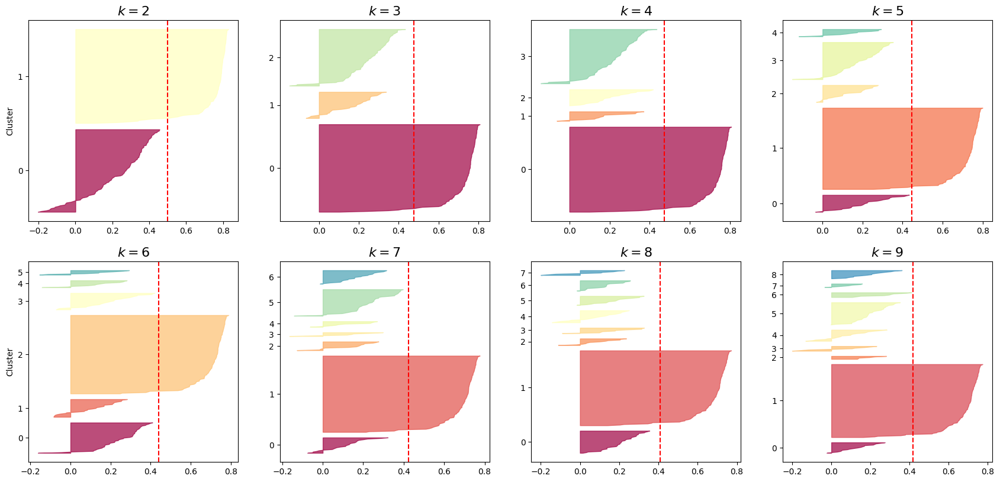

In [ ]:
kmeans_silhouette_analysis(train_MCF_red, k_range)

Overall, the mean silhouette score is about 0.5. There is a big cluster that is consistent across all trials, while the rest of the dataset is divided more as we increase k. The clustering with clusters number k = 2, 3, 4 get the highest average silhouette score. However, all of them fail to cross the red line with all clusters, indicating an imperfect cluster. Since subdividing the dataset in more clusters does not improve the clustering, it is preferred as few clusters as possibile (so k=2). If we need further subdivisions, we will consider also k=3.

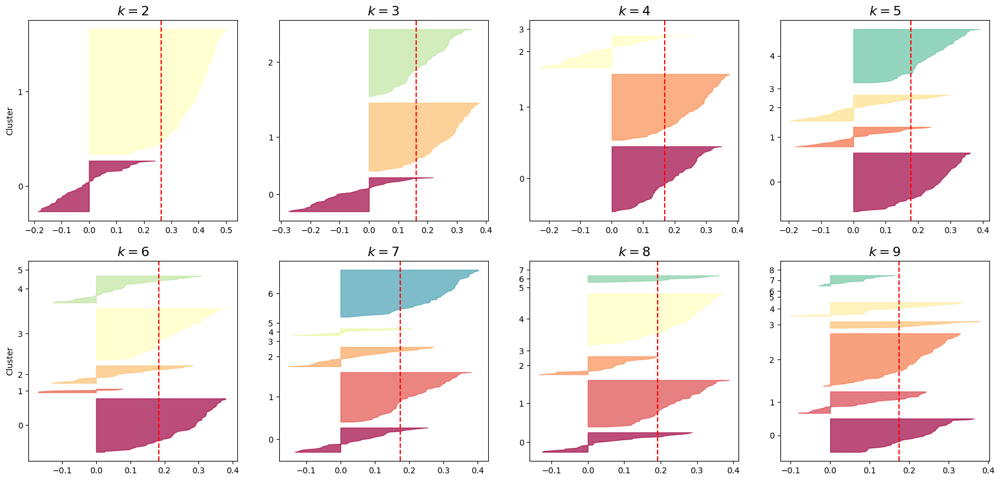

In [ ]:
kmeans_silhouette_analysis(train_HCC_red, k_range)

Above all, we notice that starting from k=4, there is an outlier(s) that is considered as a single cluster. This time the silhouette scores decrease noticibly after k=2, indicating that again 2 clusters seems the best option. We will keep also k=3 just as a sanity check for the plots.

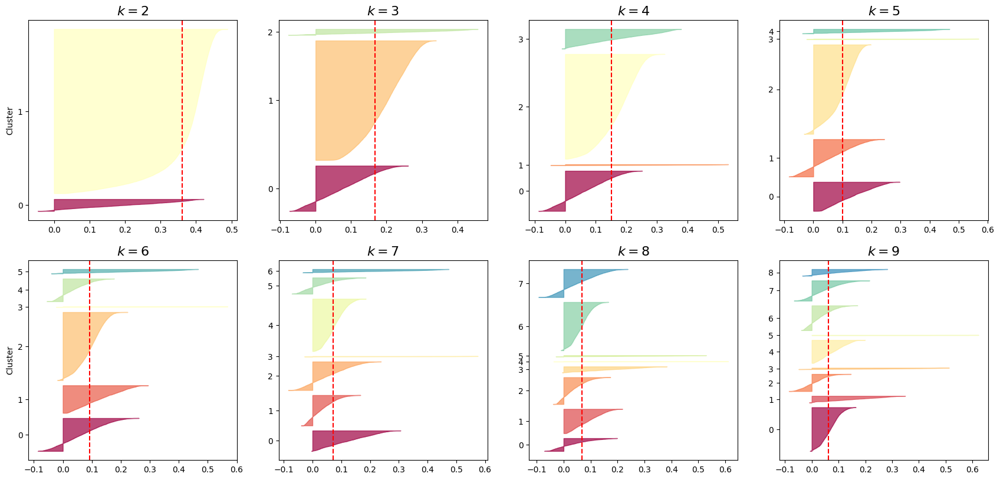

In [ ]:
kmeans_silhouette_analysis(train_MCFdr_red, k_range)

Overall, DropSeq has worse results than SmartSeq data. The only promising clustering is the one with k=2, with a score near 0.4 and both clusters score crossing the red line. Starting from k=3, the silhouette score drops under 0.2.

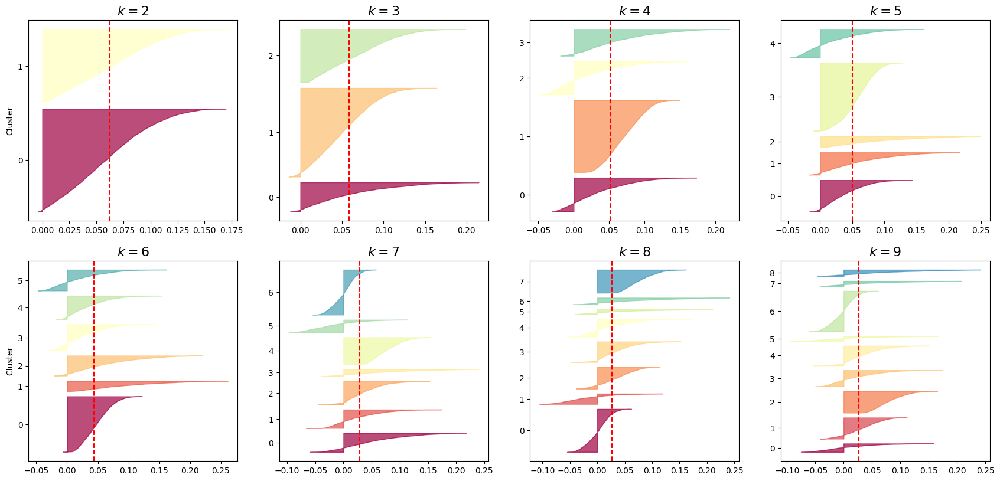

In [ ]:
kmeans_silhouette_analysis(train_HCCdr_red, k_range)

The silhouette scores in clustering DropSeq HCC1806 is way lower than the one of SmartSeq HCC1806, indicating that DropSeq has a more compact structure. We consider k=2 and k=3 as promising.

___

Now, we plot the clustering results for each dataset in the UMAP space, using the chosen numbers of clusters.

In [ ]:
import math
import colorsys
from matplotlib.colors import ListedColormap
from umap import UMAP

In [ ]:
def kmeans_plot(
    train_red,
    ks,
    figsize=None,
    ncols=None,
    cmap_base='tab10'
):
    # Normalize ks to list
    if isinstance(ks, int):
        ks_list = [ks]
    else:
        ks_list = list(ks)
    n_plots = len(ks_list)
    if n_plots == 0:
        raise ValueError("Provide at least one k value in `ks`.")

    # Determine layout for multiple plots
    if n_plots > 1:
        if ncols is None:
            ncols = int(math.ceil(math.sqrt(n_plots)))
        nrows = int(math.ceil(n_plots / ncols))
        if figsize is None:
            figsize = (4 * ncols, 4 * nrows)
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
        # Flatten axes for indexing; if single row/col, ensure it's a flat list
        if isinstance(axes, np.ndarray):
            axes_flat = axes.flatten()
        else:
            axes_flat = [axes]
    else:
        # Single plot: create a single axes via plt.subplots for consistency
        fig, ax = plt.subplots(figsize=figsize or (6, 5))
        axes_flat = [ax]

    # Determine consistent axis limits across subplots
    train_red = np.asarray(train_red)
    x_min, x_max = np.min(train_red[:, 0]), np.max(train_red[:, 0])
    y_min, y_max = np.min(train_red[:, 1]), np.max(train_red[:, 1])

    # Get base colors if possible
    cmap_obj = plt.get_cmap(cmap_base)
    base_colors = cmap_obj.colors if hasattr(cmap_obj, 'colors') else None

    for idx, k in enumerate(ks_list):
        ax = axes_flat[idx]
        # Fit KMeans
        km = KMeans(n_clusters=k, n_init=100, random_state=42)
        labels = km.fit_predict(train_red)

        # Prepare colormap for k clusters
        if base_colors is not None and len(base_colors) >= k:
            cmap = ListedColormap(base_colors[:k])
        else:
            # Generate k distinct colors via HSV
            hsv_colors = [(i / k, 0.7, 0.9) for i in range(k)]
            rgb_colors = [colorsys.hsv_to_rgb(h, s, v) for h, s, v in hsv_colors]
            cmap = ListedColormap(rgb_colors)

        # Plot
        scatter = ax.scatter(
            train_red[:, 0], train_red[:, 1],
            c=labels, cmap=cmap,
            s=10, edgecolor="k", linewidth=0.3
        )
        ax.set_title(f"K-means (k={k}) clusters – UMAP projection")
        ax.set_xlabel("PC1"); ax.set_ylabel("PC2")
        #ax.set_xlim(x_min*0.9, x_max*1.1); ax.set_ylim(y_min*0.9, y_max*1.1)
        ax.set_xticks([]); ax.set_yticks([])
        ax.grid(False)

    # Turn off unused subplots if any
    if n_plots > 1:
        total_slots = len(axes_flat)
        for j in range(n_plots, total_slots):
            axes_flat[j].axis('off')
        plt.tight_layout()
        plt.show()
        return fig, axes
    else:
        plt.tight_layout()
        plt.show()
        return None

We will save the optimal number of clusters in a dataframe.

___

We start from SmartSeq MCF7. The most promising values are k = 2, 3.

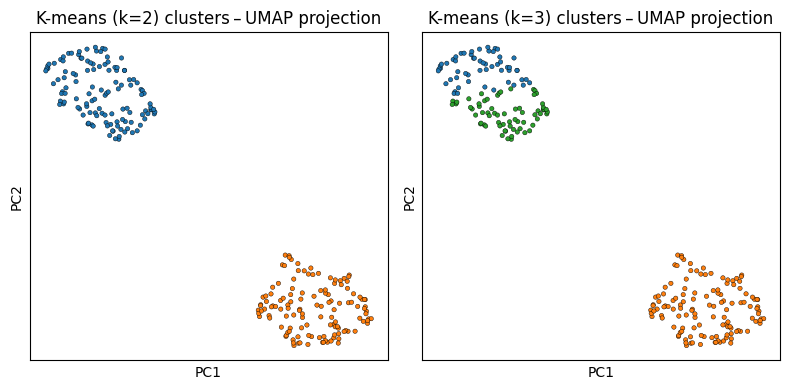

In [ ]:
kmeans_plot(umap_MCF, [2, 3]);

We see how k=2 capture the underlying structure better than k = 3.

___

We see how SmartSeq HCC1806 data behaves. The most promising values are k = 2, 3.

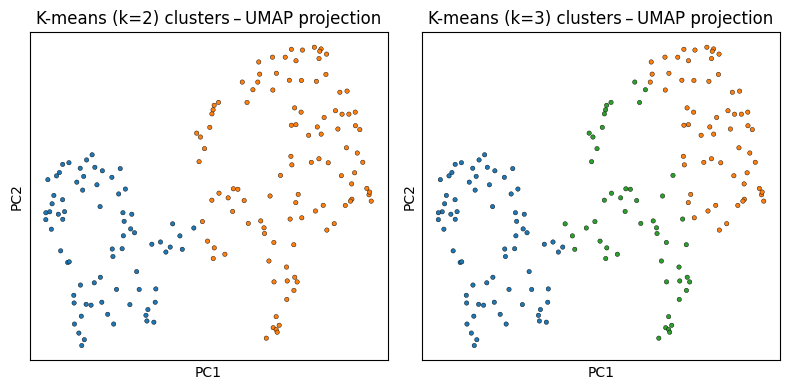

In [ ]:
kmeans_plot(umap_HCC, [2, 3]);

We choose k = 2: it is evident that with k = 3 the clustering is not insightful about the underlying structure.

___

We now see how DropSeq MCF7 data behaves. The most promising values are k = 2, 3.

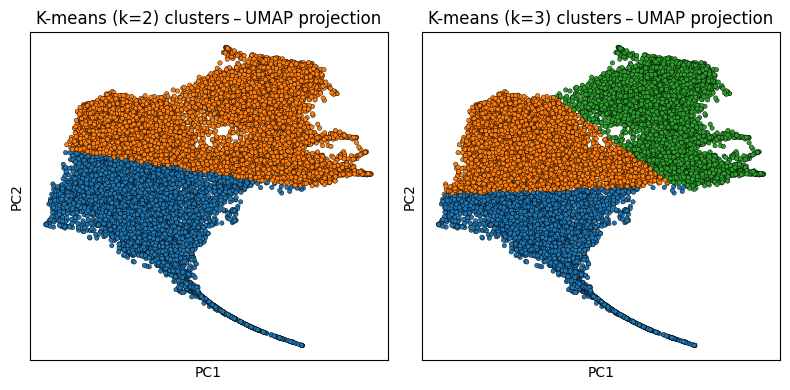

In [ ]:
kmeans_plot(umap_MCFdr, [2, 3]);

We can choose k = 2.

___

We now see how DropSeq HCC1806 data behaves. The most promising values are k = 2, 3.

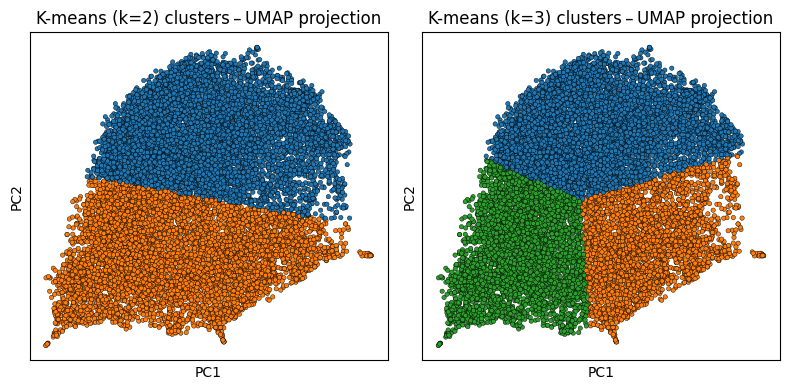

In [ ]:
kmeans_plot(umap_HCCdr, [2, 3]);

We again choose k = 2.

___

We save the optimal values in a dataframe.

In [ ]:
k_dict = {
    'MCF': {
        'k': 2,
    },
    'HCC': {
        'k': 2,
    },
    'MCFdr': {
        'k': 2,
    },
    'HCCdr': {
        'k': 2,
    }
}
kmeans_k_df = pd.DataFrame(k_dict).T
print(kmeans_k_df)

       k
MCF    2
HCC    2
MCFdr  2
HCCdr  2


Compute optimal kmeans for each dataset

In [ ]:
# SmartSeq MCF7
train_MCF_kmeans = KMeans(n_clusters=kmeans_k_df.loc['MCF', 'k'], n_init=100, random_state=42)
train_MCF_kmeans_labels = train_MCF_kmeans.fit_predict(train_MCF_red)

# SmartSeq HCC1806
train_HCC_kmeans = KMeans(n_clusters=kmeans_k_df.loc['HCC', 'k'], n_init=100, random_state=42)
train_HCC_kmeans_labels = train_HCC_kmeans.fit_predict(train_HCC_red)

# DropSeq MCF7
train_MCFdr_kmeans = KMeans(n_clusters=kmeans_k_df.loc['MCFdr', 'k'], n_init=100, random_state=42)
train_MCFdr_kmeans_labels = train_MCFdr_kmeans.fit_predict(train_MCFdr_red)

# DropSeq HCC1806
train_HCCdr_kmeans = KMeans(n_clusters=kmeans_k_df.loc['HCCdr', 'k'], n_init=100, random_state=42)
train_HCCdr_kmeans_labels = train_HCCdr_kmeans.fit_predict(train_HCCdr_red)

___

Now, we use ScanPy function rank_genes in order to find the most representative genes for each cluster, for each dataset.

In [ ]:
import scanpy as sc
import anndata as ad

First, we must convert our dataframe to annotated data (AnnData), in order to make them compatible with ScanPy functions.

In [ ]:
# Convert dataframes to AnnData objects
def df_to_anndata(df, pca, kmeans):
    adata = ad.AnnData(X=df.values)
    #adata.obs_names = get_cell_names(df)
    adata.var_names = get_gene_names(df)
    adata.obs['label'] = get_cell_labels(df)
    adata.obsm['X_pca'] = pca
    adata.obs['kmeans'] = pd.Categorical(values=[f"KM{i}" for i in kmeans])
    return adata

In [ ]:
train_MCF_ad = df_to_anndata(train_MCF_log, train_MCF_red, train_MCF_kmeans_labels)
train_HCC_ad = df_to_anndata(train_HCC_log, train_HCC_red, train_HCC_kmeans_labels)
train_MCFdr_ad = df_to_anndata(train_MCFdr_log, train_MCFdr_red, train_MCFdr_kmeans_labels)
train_HCCdr_ad = df_to_anndata(train_HCCdr_log, train_HCCdr_red, train_HCCdr_kmeans_labels)

___

To get insights on the gene expressions underlying each clutering, we do the following:

1. **Cluster with optimal parameters**  
   - We already found the optimal number of clusters for each clustering.

2. **Rank genes per cluster (Scanpy’s rank_genes_groups)**  
   - Once clusters are defined, we identify marker genes that distinguish each cluster from the rest using a statistical test (i.e., Wilcoxon).  
   - This highlights genes with significant and specific expression patterns, providing candidates for interpreting cluster identity.

3. **Compute dendrogram of clusters or genes**  
   - If the number of cluster is greater or equal than 3, dendrogram shows hierarchical relationships:  
     - **Clusters dendrogram**: how clusters relate in expression or PCA space, revealing which are most similar.  
     - **Gene dendrogram**: how marker genes co-vary across clusters or cells, grouping co-expressed modules.  
   - This helps interpret lineage or modular structure, and can guide merging similar clusters or grouping genes into modules.

4. **Plot heatmap of marker expression**  
   - Heatmap (i.e., rows = marker genes, columns = clusters or cells ordered by cluster) visualizes average and per-cell expression patterns.  
   - It confirms that ranked genes truly distinguish clusters, shows relative expression levels, and reveals sub-patterns (e.g., subsets of clusters sharing gene modules).

5. **Plot dotplot of markers**  
   - Dotplot summarizes two key aspects per cluster: fraction of cells expressing each marker and average expression level.  
   - This compact view complements the heatmap by quantifying detection frequency and strength, aiding in prioritizing markers and verifying specificity.

6. **Compute percentage of hypoxia/normoxia cells per cluster**  
   - Finally, we relate clusters to experimental conditions (hypoxia vs normoxia) by computing, for each cluster, the proportion of cells from each condition.  
   - This links expression-defined subpopulations to the biological behaviour of the cell.

Together, these steps move from defining robust clusters to characterizing them by marker genes, visualizing patterns and relationships, and connecting clusters to experimental variables. Each step validates and deepens understanding of the cell groups and their biology.

___

We first work on SmartSeq MCF7.

In [ ]:
sc.tl.rank_genes_groups(train_MCF_ad, groupby='kmeans', method='wilcoxon', n_genes=20)
sc.tl.dendrogram(train_MCF_ad, groupby='kmeans')

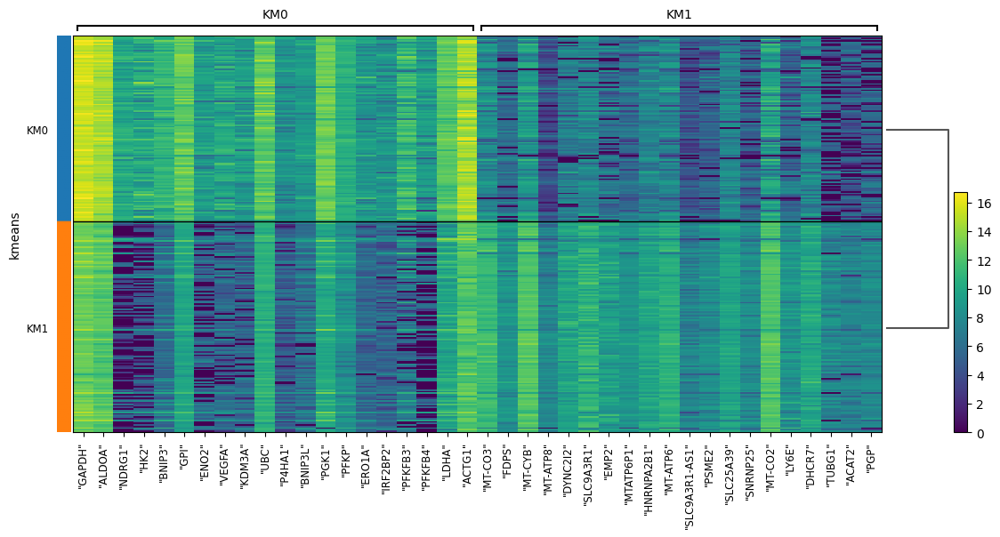

In [ ]:
sc.pl.rank_genes_groups_heatmap(
    train_MCF_ad,
    groupby='kmeans',
    n_genes=20,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)

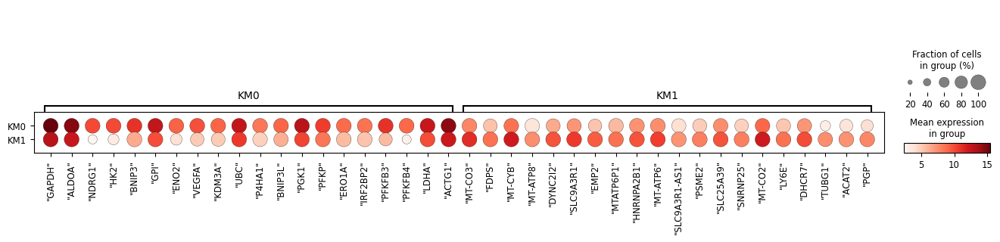

In [ ]:
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_MCF_ad, n_genes=20, groupby="kmeans")

In [ ]:
pd.crosstab(train_MCF_ad.obs["kmeans"], train_MCF_ad.obs["label"], normalize='index')

label,Hypo,Norm
kmeans,,
KM0,1.000000,0.000000
KM1,0.052632,0.947368


___

We now continue with SmartSeq HCC1806.

In [ ]:
sc.tl.rank_genes_groups(train_HCC_ad, groupby='kmeans', method='wilcoxon', n_genes=20)
sc.tl.dendrogram(train_HCC_ad, groupby='kmeans')

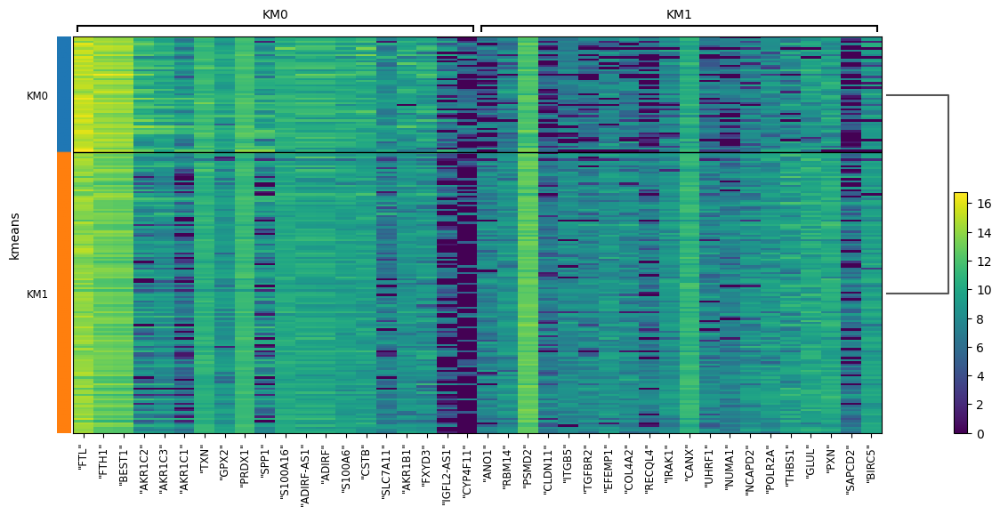

In [ ]:
sc.pl.rank_genes_groups_heatmap(
    train_HCC_ad,
    groupby='kmeans',
    n_genes=20,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)

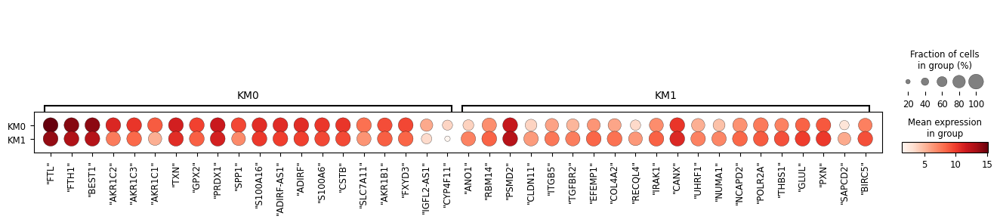

In [ ]:
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_HCC_ad, n_genes=20, groupby="kmeans")

In [ ]:
pd.crosstab(train_HCC_ad.obs["kmeans"], train_HCC_ad.obs["label"], normalize='index')

label,Hypo,Norm
kmeans,,
KM0,0.528302,0.471698
KM1,0.534884,0.465116


___

Then, we do the same analysis for DropSeq MCF7.

In [ ]:
sc.tl.rank_genes_groups(train_MCFdr_ad, groupby='kmeans', method='wilcoxon', n_genes=20)
sc.tl.dendrogram(train_MCFdr_ad, groupby='kmeans')

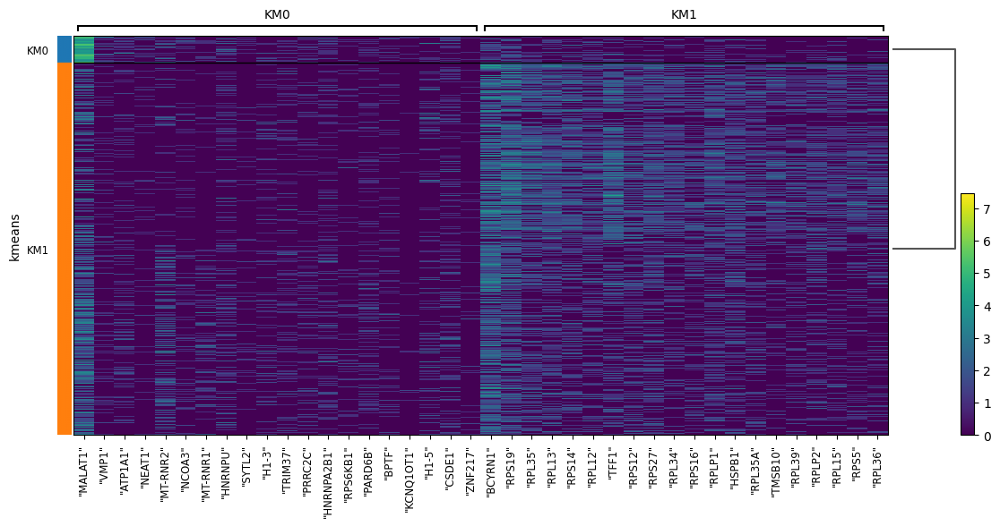

In [ ]:
sc.pl.rank_genes_groups_heatmap(
    train_MCFdr_ad,
    groupby='kmeans',
    n_genes=20,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)

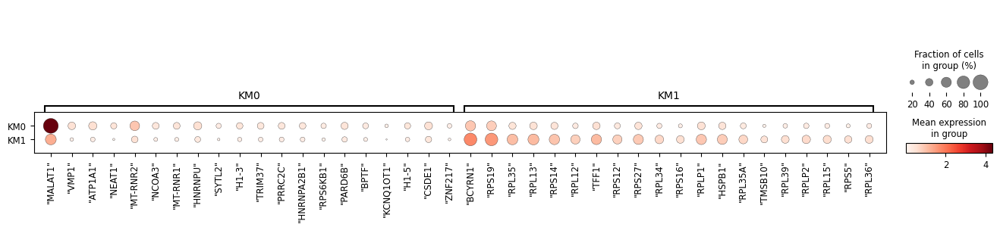

In [ ]:
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_MCFdr_ad, n_genes=20, groupby="kmeans")

In [ ]:
pd.crosstab(train_MCFdr_ad.obs["kmeans"], train_MCFdr_ad.obs["label"], normalize='index')

label,Hypo,Norm
kmeans,,
KM0,0.189003,0.810997
KM1,0.428635,0.571365


___

Finally, we see how DropSeq HCC1806 behaves.

In [ ]:
sc.tl.rank_genes_groups(train_HCCdr_ad, groupby='kmeans', method='wilcoxon', n_genes=20)
sc.tl.dendrogram(train_HCCdr_ad, groupby='kmeans')

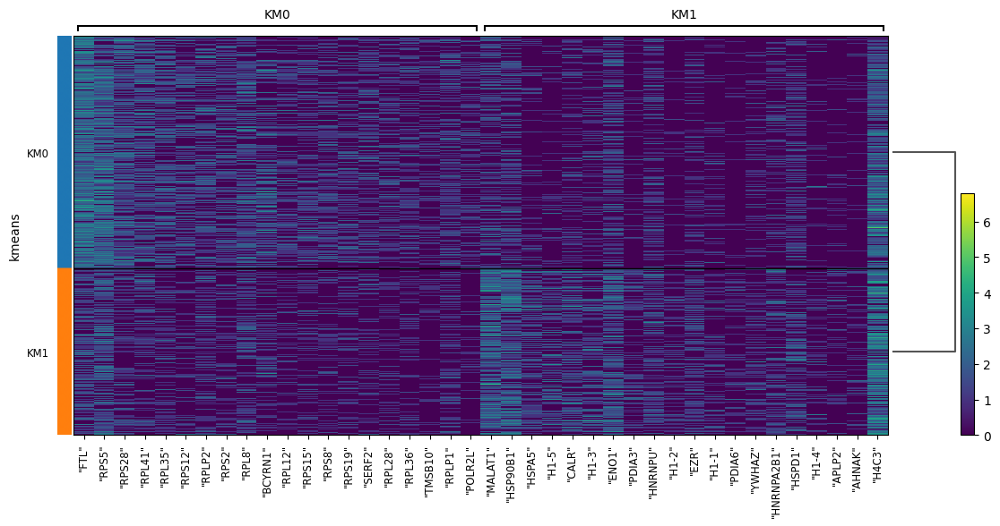

In [ ]:
sc.pl.rank_genes_groups_heatmap(
    train_HCCdr_ad,
    groupby='kmeans',
    n_genes=20,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)

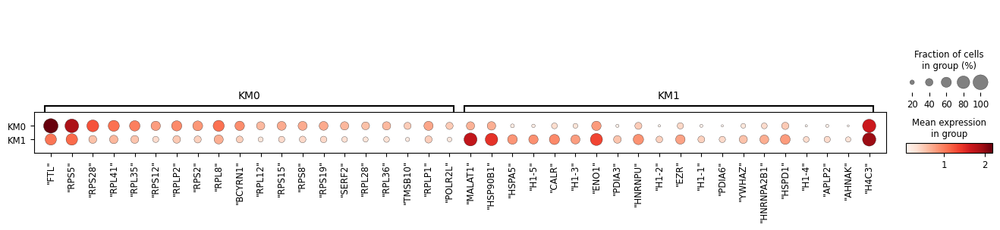

In [ ]:
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_HCCdr_ad, n_genes=20, groupby="kmeans")

In [ ]:
pd.crosstab(train_HCCdr_ad.obs["kmeans"], train_HCCdr_ad.obs["label"], normalize='index')

label,Hypo,Norm
kmeans,,
KM0,0.666472,0.333528
KM1,0.522150,0.477850


___


- KMeans consistently identifies two clusters as the most natural subdivision in these datasets.
- For the MCF7 SmartSeq data, these two clusters align with the Hypoxia vs. Normoxia conditions.
- However, in the DropSeq datasets, this binary split does not correspond to the experimental conditions, likely due to the higher density structure.
- While further investigation of the biological relevance of differential gene expression within clusters would be informative, it falls outside the scope of this project.
- From a machine learning perspective, KMeans underperforms on the DropSeq data because its global, centroid-based partitioning struggles with the dataset’s density and noise characteristics.
- Therefore, it is necessary to explore alternative clustering methods better suited for sparse or complex single-cell data.

___

# Graph clustering

After obtaining broad clusters via KMeans, we apply Leiden graph clustering to capture finer, local community structure.
KMeans partitions globally based on distance to centroids, but may miss subpopulations shaped by local manifolds.
Running Leiden after KMeans allows discovery of subclusters that respect local connectivity in the kNN graph,
revealing biologically meaningful subtypes or states that KMeans alone might overlook.


The Leiden algorithm detects communities in a graph by iteratively improving cluster assignments to maximize a quality function:
1. Build a kNN graph of cells (nodes connected to their nearest neighbors).
2. Initialize clusters (often each node in its own community).
3. **Local moving phase**: For each node, consider moving it to a neighboring community if it increases the quality (i.e., modularity objective), repeating until no improvement.
4. **Refinement phase**: Split clusters to ensure they are well-connected internally; this avoids disconnected or loosely connected communities.
5. **Aggregation phase**: Collapse each community into a single “super-node,” rebuild the graph at this coarser level (edges weighted by summed connections), and repeat local moving and refinement on the aggregated graph.
6. Continue until no further improvement. The resolution parameter controls the granularity: higher resolution favors smaller communities.

By refining clusters before aggregation, Leiden ensures more robust and well-connected communities compared to Louvain.

___

Import necessary libraries

In [ ]:
import scanpy as sc
import igraph as ig
import leidenalg
import seaborn as sns

___

We choose the best resolution by balancing multiple criteria rather than relying on one metric:
- Scan a grid of resolution values (and n_neighbors) and compute the metrics modularity, and silhouette.
- Normalize and choose optimal combinations of parameters so we do not let one metric dominate.
- Visualize resulting clusters on UMAP to confirm they form coherent islands.
- Perform marker-gene analysis: each cluster should have clear, distinct markers; discard splits that lack biological signal.
- Avoid overfragmentation (tiny clusters without markers) and underclustering (mixing known distinct types).
- Incorporate domain knowledge: prefer the parameter set whose clusters align with expected biology or reveal plausible new subpopulations.

In [ ]:
# Define the paramter grid
res_range = [0.1, 0.2, 0.5, 1.0, 2.0, 5.0]
k_neighbors = [5, 10, 15, 30, 50]

In [ ]:
def leiden_score_analysis(
    adata,
    res_range,
    k_neighbors,
    alpha=0.5,
    random_state=42,
    plot_heatmap=True
):
    records = []
    # Loop over k_neighbors and resolution
    for k in k_neighbors:
        sc.pp.neighbors(adata, n_neighbors=k, random_state=random_state)
        # Build igraph from Scanpy connectivities
        conn = adata.obsp['connectivities'].tocoo()
        # edges: use (row, col) pairs
        edges = list(zip(conn.row.tolist(), conn.col.tolist()))
        g = ig.Graph(edges=edges, directed=False)
        g.es['weight'] = conn.data.tolist()

        for res in res_range:
            label_key = f'leiden_k{k}_r{res}'
            sc.tl.leiden(adata, resolution=res, key_added=label_key, random_state=random_state)
            labels = adata.obs[label_key].astype('category').cat.codes.values
            n_clusters = len(np.unique(labels))
            # Silhouette: only if at least 2 clusters
            if n_clusters >= 2:
                try:
                    sil = silhouette_score(adata.obsm['X_pca'], labels)
                except Exception:
                    sil = np.nan
            else:
                sil = np.nan
            # Modularity: only if at least 2 clusters
            if n_clusters >= 2:
                try:
                    mod = g.modularity(labels, weights=g.es['weight'])
                except Exception:
                    mod = np.nan
            else:
                mod = np.nan

            records.append({
                'n_neighbors': k,
                'resolution': res,
                'n_clusters': n_clusters,
                'silhouette': sil,
                'modularity': mod
            })

    # Build DataFrame from records
    results_df = pd.DataFrame(records)

    # Normalize silhouette and modularity to [0,1] via min–max scaling
    def minmax(series):
        v = series.astype(float)
        v_min, v_max = np.nanmin(v), np.nanmax(v)
        if np.isnan(v_min) or np.isnan(v_max) or v_max == v_min:
            return pd.Series(np.zeros_like(v), index=series.index)
        return pd.Series((v - v_min) / (v_max - v_min), index=series.index)

    results_df['sil_norm'] = minmax(results_df['silhouette'])
    results_df['mod_norm'] = minmax(results_df['modularity'])

    # Compute composite score
    results_df['composite_score'] = alpha * results_df['mod_norm'] + (1 - alpha) * results_df['sil_norm']

    # Optional heatmap plotting
    if plot_heatmap:
        # Pivot composite_score: index = n_neighbors, columns = resolution
        pivot = results_df.pivot(index='n_neighbors', columns='resolution', values='composite_score')
        plt.figure(figsize=(6, 4))
        sns.heatmap(pivot, annot=True, fmt=".2f", cmap="viridis")
        plt.title(f"Leiden Composite Score Heatmap (alpha={alpha})")
        plt.xlabel("resolution")
        plt.ylabel("n_neighbors")
        plt.show()

    print(results_df)

___

Below is a step-by-step rationale for the following work on the datasets:

1. **Parameter tuning via heatmap of scores**  
   - Before committing to a particular `n_neighbors` and `resolution`, we evaluate a grid of combinations.  
   - For each pair, compute the metrics silhouette (on PCA) and modularity (on the kNN graph).
   - Compute a weighted average of the two scores, giving more importance to modularity (local description).
   - Assemble these into a DataFrame and plot a heatmap showing composite score values across the grid.  
   - This helps identify regions where clusters are locally coherent and not overly coarse or fragmented.  
   - **Purpose**: choose parameters that balance local structure and interpretability.

2. **Compute neighbors graph (sc.pp.neighbors)**  
   - After selecting parameters, build the kNN graph on the PCA embedding:  
     ```python
     sc.pp.neighbors(adata, n_neighbors=chosen_k, n_pcs=chosen_pcs)
     ```  
   - This graph underlies Leiden clustering and UMAP.  
   - **Purpose**: capture local relationships between cells in reduced space.

3. **Compute UMAP (sc.tl.umap)**  
   - Run UMAP on the neighbor graph to get 2D coordinates for visualization:  
     ```python
     sc.tl.umap(adata)
     ```  
   - **Purpose**: visualize cells in a layout that preserves local connectivity, aiding interpretation of clusters.

4. **Run Leiden clustering (sc.tl.leiden)**  
   - Apply Leiden with the chosen resolution on the same graph:  
     ```python
     sc.tl.leiden(adata, resolution=chosen_resolution, key_added='leiden')
     ```  
   - This yields a flat partition of cells into clusters, reflecting local community structure.  
   - **Purpose**: identify putative cell subpopulations based on graph connectivity.

5. **Visualize clusters on UMAP**  
   - Plot `adata.obs['leiden']` on UMAP:  
     ```python
     sc.pl.umap(adata, color='leiden', title='Leiden clusters')
     ```  
   - Check that clusters form coherent islands or neighborhoods; if they appear intermixed, reconsider parameters.  
   - **Purpose**: qualitatively validate clustering against local structure.

6. **Marker gene identification (sc.tl.rank_genes_groups with Wilcoxon)**  
   - For each cluster, run differential expression vs others using Wilcoxon rank-sum:  
     ```python
     sc.tl.rank_genes_groups(adata, groupby='leiden', method='wilcoxon')
     ```  
   - This finds genes that distinguish each cluster.  
   - **Purpose**: characterize biological identity or state of clusters.

7. **Plot heatmap or dotplot of marker genes**  
   - For the top marker genes per cluster, visualize expression patterns:  
     ```python
     sc.pl.heatmap(adata, var_names=top_markers, groupby='leiden', use_raw=False, standard_scale='var')
     sc.pl.dotplot(adata, var_names=top_markers, groupby='leiden')
     ```  
   - Heatmap shows per-cell expression; dotplot shows fraction of expressing cells and average expression.  
   - **Purpose**: confirm that markers are specific and interpret cluster identities.

8. **Compute percentage of cells per cluster under each condition**  
   - If `adata.obs['condition']` indicates “normoxia” vs “hypoxia”, compute for each cluster the fraction of cells in each condition.   
   - **Purpose**: assess how experimental conditions distribute across clusters, e.g., whether certain clusters are enriched in hypoxia.

#### Summary of Rationale

- **Heatmap of scores** (silhouette/modularity) guides selection of graph-building (`n_neighbors`) and clustering (`resolution`) parameters before full analysis.  
- **Neighbors + UMAP** establish a local-structure-preserving representation for both clustering and visualization.  
- **Leiden** finds communities on the kNN graph, capturing local cell neighborhoods.  
- **Marker analysis** (Wilcoxon, heatmap, dotplot) validates and interprets clusters in terms of gene expression.  
- **Condition percentages** reveal associations between clusters and experimental groups (normoxia/hypoxia), informing biological conclusions.

Each step builds on the previous: tuning ensures robust clusters, UMAP visualizes them, Leiden defines them, marker plots explain them, and condition statistics link clusters to experimental context.```

___

We study SmartSeq MCF7 optimal clustering.

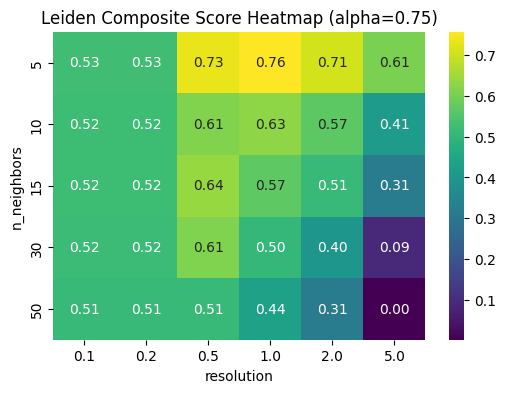

    n_neighbors  resolution  n_clusters  silhouette  modularity  sil_norm  \
0             5         0.1           2    0.495503    0.494386  1.000000   
1             5         0.2           2    0.495503    0.494386  1.000000   
2             5         0.5           5    0.124887    0.707852  0.159740   
3             5         1.0          12    0.068699    0.736493  0.032350   
4             5         2.0          19    0.055469    0.714412  0.002355   
5             5         5.0          32    0.055588    0.662801  0.002625   
6            10         0.1           2    0.495503    0.492192  1.000000   
7            10         0.2           2    0.495503    0.492192  1.000000   
8            10         0.5           4    0.174796    0.632162  0.272893   
9            10         1.0           8    0.078499    0.668752  0.054570   
10           10         2.0          15    0.073676    0.637061  0.043634   
11           10         5.0          27    0.081121    0.557791  0.060514   

In [ ]:
leiden_scores_MCF = leiden_score_analysis(train_MCF_ad, res_range, k_neighbors, alpha=0.75)

In [ ]:
# Compute UMAP reduced data
sc.tl.umap(train_MCF_ad, random_state=42)

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/scanpy/tools/_tsne.py:133: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


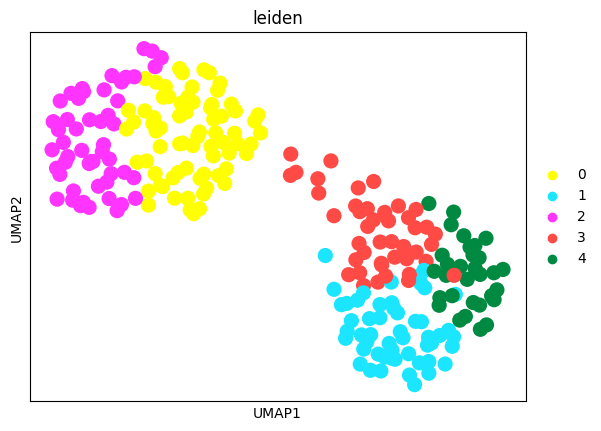

In [ ]:
# Plot Leiden clustering results on UMAP
sc.pp.neighbors(train_MCF_ad, n_neighbors=5, random_state=42)
sc.tl.leiden(train_MCF_ad, resolution=0.5, flavor="leidenalg", n_iterations=-1, random_state=42)
sc.pl.umap(train_MCF_ad, color=["leiden"])

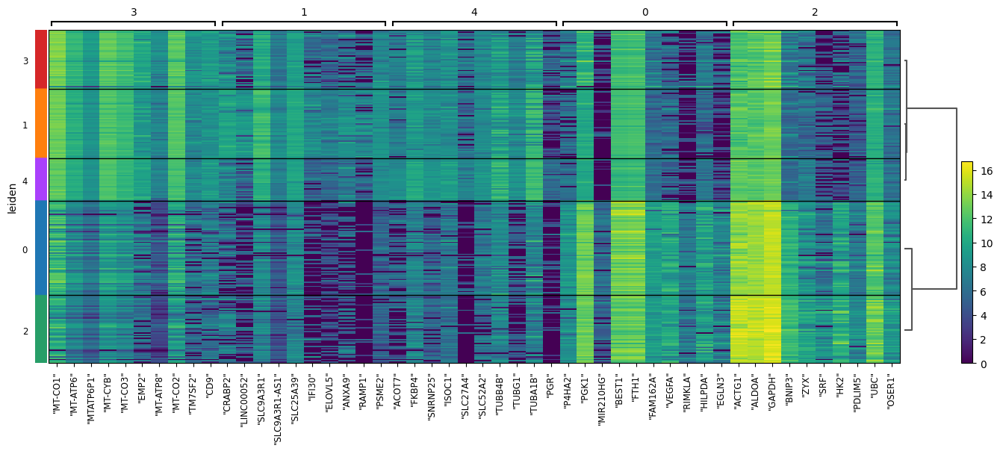

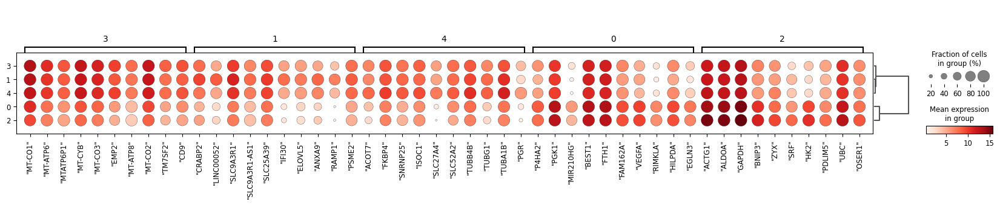

In [ ]:
# Plot heatmap and dotplot for Leiden clusters
sc.tl.rank_genes_groups(train_MCF_ad, groupby='leiden', method='wilcoxon', n_genes=10)
sc.tl.dendrogram(train_MCF_ad, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(
    train_MCF_ad,
    groupby='leiden',
    n_genes=10,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_MCF_ad, n_genes=10, groupby="leiden")

In [ ]:
pd.crosstab(train_MCF_ad.obs["leiden"], train_MCF_ad.obs["label"], normalize='index')

label,Hypo,Norm
leiden,,
0,1.000000,0.000000
1,0.000000,1.000000
2,1.000000,0.000000
3,0.045455,0.954545
4,0.000000,1.000000


the plot, the heatmat and the purity scores all show the same evidence: the clustering correctly devided the dataset in hypoxia and normoxia and the find other subclusters.

___

We study SmartSeq HCC1806 optimal clustering.

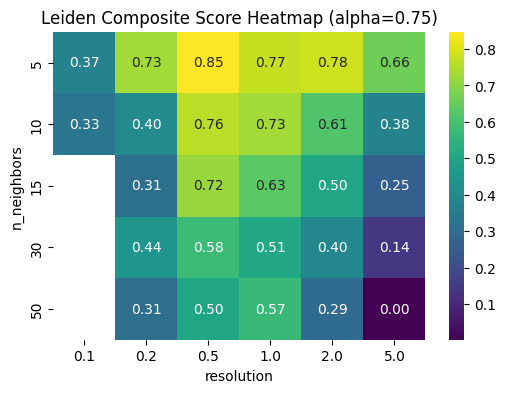

    n_neighbors  resolution  n_clusters  silhouette  modularity  sil_norm  \
0             5         0.1           2    0.106628    0.447069  0.554893   
1             5         0.2           3    0.139339    0.606109  0.824203   
2             5         0.5           7    0.101299    0.713823  0.511027   
3             5         1.0          12    0.050644    0.730585  0.093984   
4             5         2.0          16    0.062922    0.721429  0.195070   
5             5         5.0          25    0.058725    0.659261  0.160515   
6            10         0.1           2    0.103663    0.429291  0.530490   
7            10         0.2           2    0.124795    0.442671  0.704469   
8            10         0.5           4    0.159104    0.600304  0.986933   
9            10         1.0           7    0.102856    0.648076  0.523846   
10           10         2.0          12    0.067118    0.624147  0.229609   
11           10         5.0          26    0.044552    0.520733  0.043825   

In [ ]:
leiden_scores_HCC = leiden_score_analysis(train_HCC_ad, res_range, k_neighbors, alpha=0.75)

In [ ]:
# Compute UMAP reduced data
sc.tl.umap(train_HCC_ad, random_state=42)

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/scanpy/tools/_tsne.py:133: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


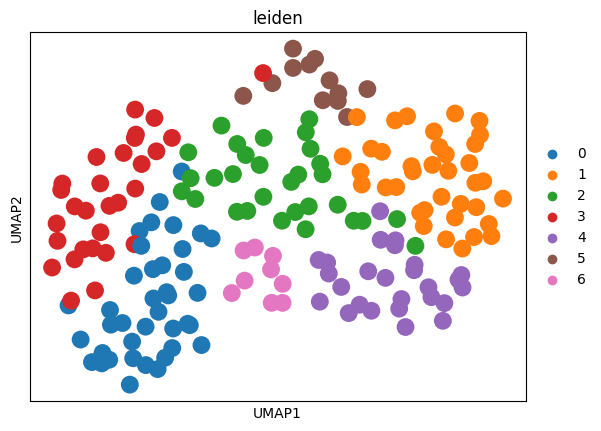

In [ ]:
# Plot Leiden clustering results on UMAP
sc.pp.neighbors(train_HCC_ad, n_neighbors=5, random_state=42)
sc.tl.leiden(train_HCC_ad, resolution=0.5, flavor="leidenalg", n_iterations=-1, random_state=42)
sc.pl.umap(train_HCC_ad, color=["leiden"])

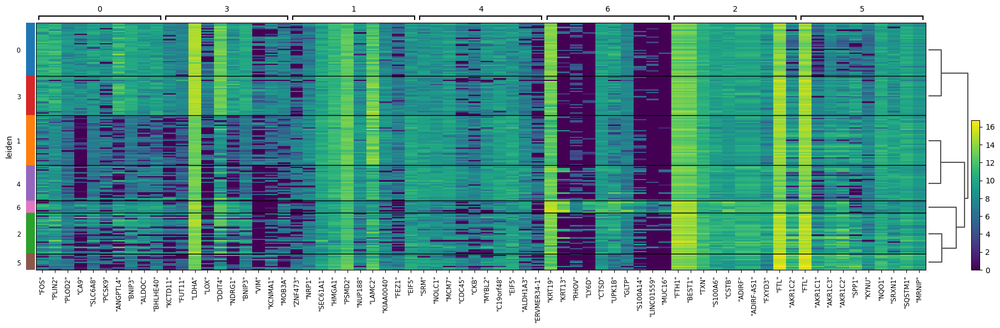

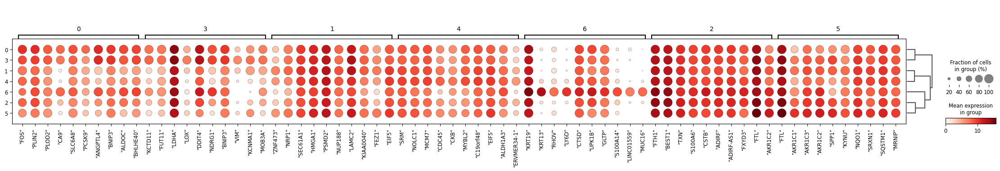

In [ ]:
# Plot heatmap and dotplot for Leiden clusters
sc.tl.rank_genes_groups(train_HCC_ad, groupby='leiden', method='wilcoxon', n_genes=10)
sc.tl.dendrogram(train_HCC_ad, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(
    train_HCC_ad,
    groupby='leiden',
    n_genes=10,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_HCC_ad, n_genes=10, groupby="leiden")

In [ ]:
pd.crosstab(train_HCC_ad.obs["leiden"], train_HCC_ad.obs["label"], normalize='index')

label,Hypo,Norm
leiden,,
0,1.000000,0.000000
1,0.027027,0.972973
2,0.500000,0.500000
3,1.000000,0.000000
4,0.153846,0.846154
5,0.000000,1.000000
6,1.000000,0.000000


as expected HCC1806 shows weaker evidences of separation respect to MCF7, by careffully observing all the results we get we can notice a strong pairwaise similarity between clusters 0-3 and 1-4. while clusters 2, 5 and 6 are a bit more confused.

___

We study DropSeq MCF7 optimal clustering

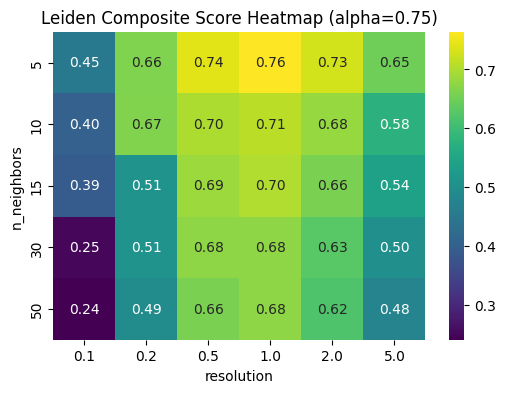

    n_neighbors  resolution  n_clusters  silhouette  modularity  sil_norm  \
0             5         0.1           4    0.165299    0.385188  0.319118   
1             5         0.2           5    0.086772    0.609112  0.172504   
2             5         0.5           9    0.055338    0.693984  0.113817   
3             5         1.0          16    0.024530    0.728476  0.056296   
4             5         2.0          34    0.009920    0.702999  0.029018   
5             5         5.0         118   -0.005623    0.636458  0.000000   
6            10         0.1           3    0.164882    0.337820  0.318340   
7            10         0.2           5    0.084437    0.612781  0.168146   
8            10         0.5           5    0.069539    0.650992  0.140330   
9            10         1.0          12    0.037834    0.673729  0.081136   
10           10         2.0          22    0.018584    0.656357  0.045194   
11           10         5.0          82    0.002237    0.565681  0.014675   

In [ ]:
leiden_scores_MCFdr = leiden_score_analysis(train_MCFdr_ad, res_range, k_neighbors, alpha=0.75)

In [ ]:
# Compute UMAP reduced data
sc.tl.umap(train_MCFdr_ad, random_state=42)

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/scanpy/tools/_tsne.py:133: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


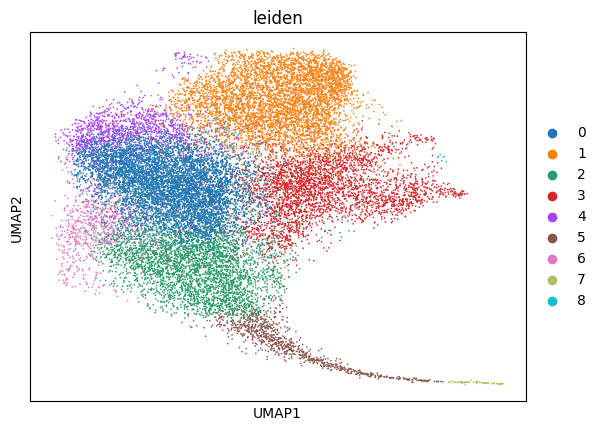

In [ ]:
# Plot Leiden clustering results on UMAP
sc.pp.neighbors(train_MCFdr_ad, n_neighbors=5, random_state=42)
sc.tl.leiden(train_MCFdr_ad, resolution=0.5, flavor="leidenalg", n_iterations=-1, random_state=42)
sc.pl.umap(train_MCFdr_ad, color=["leiden"])

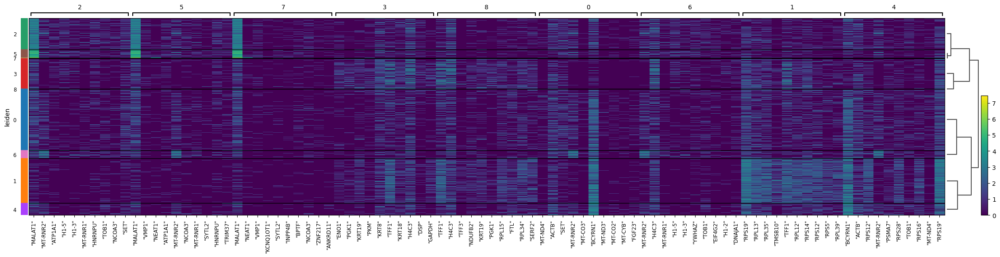

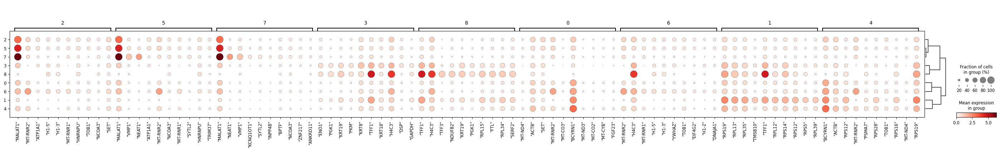

In [ ]:
# Plot heatmap and dotplot for Leiden clusters
sc.tl.rank_genes_groups(train_MCFdr_ad, groupby='leiden', method='wilcoxon', n_genes=10)
sc.tl.dendrogram(train_MCFdr_ad, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(
    train_MCFdr_ad,
    groupby='leiden',
    n_genes=10,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_MCFdr_ad, n_genes=10, groupby="leiden")

In [ ]:
pd.crosstab(train_MCFdr_ad.obs["leiden"], train_MCFdr_ad.obs["label"], normalize='index')

label,Hypo,Norm
leiden,,
0,0.057958,0.942042
1,0.976796,0.023204
2,0.096243,0.903757
3,0.894642,0.105358
4,0.128225,0.871775
5,0.186275,0.813725
6,0.026077,0.973923
7,0.689655,0.310345
8,1.000000,0.000000


___

As expected the general expression of the genes is lower in dropseq. again comparing Purity with hierarchy. Notice how clusters 7 and 8 are small group of outliers. MALAT1 is the principal gene marker for clusters 2 and 5 while BCYRN1 and RP519 are the principal markers for the rest of the clusters. again the clusters have decent levels of purity.

We study DropSeq HCC1806 optimal clustering

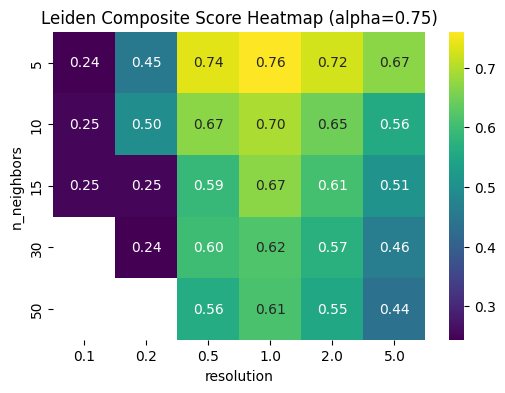

    n_neighbors  resolution  n_clusters  silhouette  modularity  sil_norm  \
0             5         0.1           4    0.450749    0.004954  0.967547   
1             5         0.2           5    0.059939    0.367846  0.151109   
2             5         0.5           9    0.028958    0.633254  0.086386   
3             5         1.0          17    0.007653    0.664309  0.041877   
4             5         2.0          45   -0.004711    0.638617  0.016047   
5             5         5.0         120   -0.012393    0.593965  0.000000   
6            10         0.1           3    0.466166    0.003720  0.999754   
7            10         0.2           4    0.059867    0.408289  0.150958   
8            10         0.5           6    0.029085    0.575882  0.086651   
9            10         1.0          13    0.020205    0.601184  0.068101   
10           10         2.0          29    0.003691    0.566307  0.033601   
11           10         5.0          99   -0.008196    0.492930  0.008767   

In [ ]:
leiden_scores_HCCdr = leiden_score_analysis(train_HCCdr_ad, res_range, k_neighbors, alpha=0.75)

In [ ]:
# Compute UMAP reduced data
sc.tl.umap(train_HCCdr_ad, random_state=42)

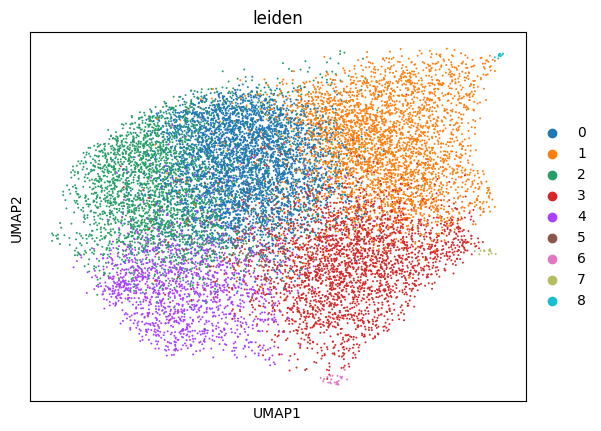

In [ ]:
# Plot Leiden clustering results on UMAP
sc.pp.neighbors(train_HCCdr_ad, n_neighbors=5, random_state=42)
sc.tl.leiden(train_HCCdr_ad, resolution=0.5, flavor="leidenalg", n_iterations=-1, random_state=42)
sc.pl.umap(train_HCCdr_ad, color=["leiden"])

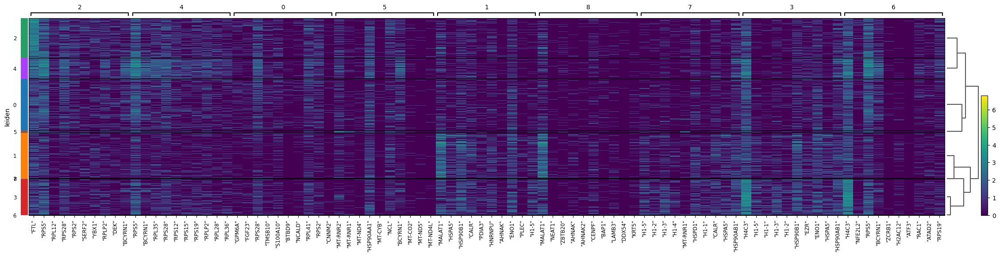

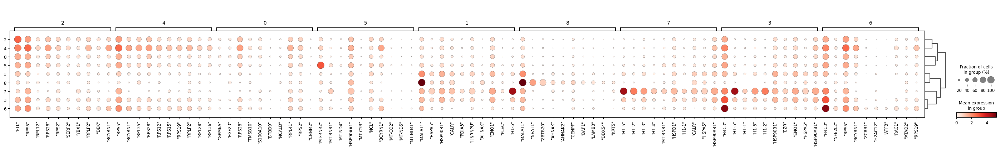

In [ ]:
# Plot heatmap and dotplot for Leiden clusters
sc.tl.rank_genes_groups(train_HCCdr_ad, groupby='leiden', method='wilcoxon', n_genes=10)
sc.tl.dendrogram(train_HCCdr_ad, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(
    train_HCCdr_ad,
    groupby='leiden',
    n_genes=10,
    use_raw=False,    # or True if you want raw expression
    show_gene_labels=True,
    swap_axes=False
)
# Dot plot
sc.pl.rank_genes_groups_dotplot(train_HCCdr_ad, n_genes=10, groupby="leiden")

In [ ]:
pd.crosstab(train_HCCdr_ad.obs["leiden"], train_HCCdr_ad.obs["label"], normalize='index')

label,Hypo,Norm
leiden,,
0,0.791025,0.208975
1,0.516328,0.483672
2,0.602976,0.397024
3,0.575622,0.424378
4,0.435227,0.564773
5,0.452128,0.547872
6,0.200000,0.800000
7,0.384615,0.615385
8,0.333333,0.666667


HCC1806 for DropSeq result again to be the hardest dataset to cluster. the purity levels are very noisy. Between the most relevant genes we can find MALAT1, H4C3 and RPS5.

___

In conclusion, we found that:

- **Superior subcluster detection**  
  Leiden uncovers finer groups as we wanted, and differential gene analysis suggests these subclusters seems to be biologically more meaningful than those from KMeans.

- **Improved alignment with experimental conditions**  
  Leiden clusters show higher purity for Hypoxia vs. Normoxia, indicating better capture of condition-driven structure.

- **Enhanced marker contrast**  
  Heatmaps from Leiden exhibit more pronounced expression differences, suggesting clearer gene relevance in defining clusters.

- **Consideration of cluster count**  
  More clusters can naturally appear purer since smaller groups are more homogeneous. However, the consistent performance gains with Leiden exceed what would be expected from cluster size alone, indicating that its finer subdivisions capture genuine biological structure rather than just benefiting from smaller cluster sizes.

- **Need for biological validation**  
  Differentially expressed genes from Leiden clusters warrant follow-up with domain expertise to confirm their biological significance.

- **Recommendation**  
  Given its consistent advantages, Leiden is the preferred clustering method for this study.

# **SUPERVISED LEARNING**

# Supervised Learning: Predicting Cell Conditions

In this section, we will build a classifier to predict whether a cell is in **hypoxic** or **normoxic** conditions based on gene expression data.

The goal of this analysis is to train a model that can distinguish between these two states based on gene expression patterns. We will compare the performance of three different supervised learning models:

- **Random Forest**
- **Logistic Regression**
- **Linear Support Vector Machine (SVM)**

By comparing the models(both their accuracy and their confidence levels), we will identify the one that best predicts whether a cell is in hypoxia or normoxia, and decine a final classifier for each dataset to make prediction on an anonim test set.

## Prelude: Methods Employed (Workflow for Each Dataset and Model)




### **1. Splitting the Dataset**

To build a reliable classifier, the first step is to split the dataset into training and testing sets. We will use **Stratified K-Fold Cross-Validation** for this purpose, ensuring that the split maintains the same proportion of **hypoxic** and **normoxic** samples in both the training and test datasets (80% training, 20% testing).

#### ***Why Use Stratified K-Fold?***

Stratified K-Fold ensures that each fold used for training and testing contains a similar distribution of the target variable (in this case, the hypoxic and normoxic conditions). This helps us achieve a more balanced representation of the data, avoiding issues where one class may dominate the model’s learning process, especially when dealing with imbalanced datasets.

By ensuring that both the training and testing datasets have the same class distribution, we can better assess the model’s performance. It also allows us to avoid potential bias or overfitting that may occur if one class is underrepresented in the data.

This approach helps us understand the model results more accurately, as we can be confident that the model is trained on and evaluated with data that reflects the real distribution of **hypoxia** and **normoxia** states. Furthermore, it
provides insights into how well the model generalizes to new, unseen data.



### **2. Models Employed**

For this classification task, we will use three different models. Below is a brief explanation of how each model works:

#### **Random Forest**
Random Forest is an ensemble method that constructs multiple decision trees during training. Each tree is built by randomly selecting a subset of features and data points. Once all the trees are trained, the model makes predictions by taking a majority vote (for classification). This approach helps improve the model's accuracy by reducing overfitting (BIAS) and increasing variance.

#### **Logistic Regression**
Logistic Regression is a linear model used for binary classification. It works by applying a logistic function to a linear combination of input features. The logistic function outputs a probability between 0 and 1, which is then used to assign the input to one of the two classes. The model learns the weights for each feature during training, which are used to make predictions.

#### **Support Vector Machine (SVM)**
Support Vector Machine (SVM) works by finding the optimal hyperplane that separates the data into two classes. The model aims to maximize the margin, or the distance, between the nearest points of each class (called support vectors) and the hyperplane. With a **linear kernel**, SVM tries to find a straight line (or hyperplane in higher dimensions) that best divides the data. If the data is not linearly separable, SVM can be adapted with different kernels, but for simplicity we will try at first a linear kernel and, if the performance is disappointing, we will consider other options.


### **3. Dimensionality Reduction with PCA and GridSearches**

To optimize the performance of our classifiers, we will use **Principal Component Analysis (PCA)** for **dimensionality reduction**. PCA helps reduce the number of features by transforming the original features into a smaller set of uncorrelated components, which capture the maximum variance in the data.

#### **Why PCA?**
High-dimensional data can lead to longer training times and potential overfitting. By reducing the number of features, we make the classifiers faster, less prone to overfitting, and more efficient, especially when conducting grid searches for hyperparameter tuning. Additionally, **with equal performance**, we prefer a model with fewer components to maintain a simpler dataset. A reduced number of components improves the **signal-to-noise ratio**, making the model more efficient and less prone to overfitting. Fewer components also lead to better computational efficiency without losing crucial information.


#### **How PCA Helps Optimize Classifier Performance**

In the grid search, we will implement a **Pipeline** approach to streamline the process. This ensures that each step (PCA, Standard Scaling, and model fitting) is applied in the correct sequence without data leakage. The pipeline helps automate the transformation and ensures that the cross-validation procedure evaluates the model consistently across different parameter combinations.

#### **Deciding the Number of Components to Grid Search For**

The number of PCA components to grid search depends on both the **dataset** and the **model**. For computational efficiency and to avoid excessively long run times, we choose a limited range of components to test. Additionally, due to the nature of PCA, we cannot have more components than samples, so the number of components will be capped at the lesser of the total number of features or the number of training samples. This ensures that the grid search remains manageable while still exploring an appropriate range of components.


The pipeline will consist of the following steps:

1. **PCA** for dimensionality reduction
2. **Standard Scaling** to standardize the features
3. **Model application** (Random Forest, Logistic Regression, or SVM)

##### Impact of Each Step:

- **Random Forest**: Random Forest models can handle correlated features, but high collinearity might still cause some instability. PCA reduces collinearity by transforming the features into orthogonal components, improving the model's ability to generalize and preventing overfitting. This is especially useful when there are many features, as it allows the model to focus on the most important independent features.

- **Logistic Regression**: Logistic Regression assumes a linear relationship between features and the target variable. Collinearity between features can lead to instability in the model's estimated coefficients. PCA helps by removing collinearity, ensuring that the model learns from independent components. This allows the decision boundary to be more stable and easier to interpret. Standard Scaling ensures that all features contribute equally, preventing any one feature from dominating due to its scale.

- **SVM (with Linear Kernel)**: SVM works well with linearly separable data. Collinearity can complicate the search for the optimal separating hyperplane, making the model less efficient. PCA removes correlated features, making the SVM’s search for the hyperplane faster and more accurate. Standard Scaling is crucial because SVM is sensitive to the scale of the features, and scaling ensures that each feature contributes equally to the margin calculation.

#### **GridSearch and Pipeline Workflow**

During **GridSearchCV**, we will include the following steps in the pipeline:
- **PCA** will reduce the number of features, focusing on the components that capture the most variance.
- **Standard Scaling** will standardize the features so they have zero mean and unit variance, ensuring that no feature dominates due to its scale.
- **Model selection** will follow, where we will test various configurations of the classifier's hyperparameters.

This pipeline ensures that the data transformations (like PCA and scaling) are applied in the correct order and that the model is trained and evaluated consistently during the grid search process. It also prevents any data leakage, where future information would incorrectly influence the model’s training, ensuring a more robust evaluation.





### **4. Model Evaluation**

In this section, we evaluate how well the model performs on the chosen parameters and assess its generalization ability. The goal is to understand how the model will perform on unseen data (artificial test set) and how stable its performance is across different training subsets.

#### **Learning Curve of Accuracy**

In addition to cross-validation, we also plot a **learning curve** to visualize how the model's accuracy improves as the training set grows. In this plot, we incrementally train the model with different sizes of the training set:
- Starting from a small subset of data points
- Gradually increasing the number of points used for training until the entire dataset is used

The learning curve helps us understand:
- **Convergence**: If the model's accuracy continues to improve as more data points are added, this suggests that the model benefits from more data.
- **Overfitting/Underfitting**: If the accuracy stabilizes early, we may have reached the optimal model complexity. If the accuracy keeps increasing, the model may still be learning from the data, and more training data could further improve its performance.

#### **Generalization and Perfomance on Artificial Test Set**

The performance on the **artificial test set** gives us an estimate of how well the model will perform in real-world scenarios, where the data may differ slightly from the training set. Generalization is crucial because a model that performs well on the training data but poorly on the test data is likely overfitting.

By combining the results from cross-validation, learning curves, and the artificial test set, we can get a comprehensive view of the model's ability to generalize and its expected performance in a production environment.


### **5. Confidence Analysis**

#### **Why Do We Care About Confidence?**

Confidence refers to the probability assigned by the model to its predictions, indicating how certain it is about the classification. Understanding the confidence of predictions is important because:
- **Uncertainty in predictions**: Low confidence (e.g., near 0.5) suggests the model is uncertain about its classification, which may require additional attention or handling.
- **Model reliability**: High confidence indicates that the model has learned strong patterns in the data and is likely making more reliable predictions.

#### **What Does Confidence Tell Us About the Model's Performance?**

We calculate the probabilities assigned to the data points on the **artificial test set** to evaluate how confidently the model predicts the classes:
- **High Confidence**: If the model assigns a high probability (close to 1 or 0) to a class, it indicates strong certainty in the prediction.
- **Low Confidence**: Probabilities close to 0.5 suggest uncertainty, often near the decision boundary or when features are ambiguous.

In summary, confidence analysis provides insight into the model’s certainty and can highlight areas where the model may need improvement.


### 6. **Gene Retrieval and Literature Comparison**

To validate our model’s predictions, we perform **gene retrieval** to identify the most important features (genes) that contribute to the classification of **hypoxic** vs **normoxic** conditions. We then compare these genes with existing literature to ensure that the model’s results align with known biological knowledge.

####   **Techniques Employed Based on the Model**

- **For SVM and Logistic Regression**:
  These models are linear in nature, so we can directly examine the **coefficients** (for Logistic Regression) or the **weights** assigned to features (for SVM). The most influential genes can be retrieved based on their weight or coefficient values. Higher absolute values indicate greater importance in predicting the target class (hypoxic vs normoxic).
  

- **For Random Forest**:
  Random Forest is a non-linear model, and identifying important features is done using **feature importance scores**. These scores indicate which genes contribute most to the model’s decision-making process. Genes with higher importance scores are considered more relevant to the classification task.
  
  After identifying these genes, we compare them with existing literature on gene expression under hypoxic and normoxic conditions.

By comparing the retrieved genes with the literature, we validate the biological relevance of the model’s findings and assess how well the model captures known biological patterns.


In [ ]:
print('start')

start


In [ ]:
# imports

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# **Implementation on HCC and MCF7 Datasets (SMARTseq Technology)**

Now, we will implement the techniques described earlier on the first two datasets: **HCC** and **MCF7**, both generated using **SMARTseq technology**.

# **SMARTSEQ**

### Open data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# open the data
hcc = pd.read_csv('/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt',
        delimiter=' ',
         engine='python'
          )

mcf7 = pd.read_csv("/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/SmartSeq/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt",
                 delimiter=" ",
                 engine='python',
                )

hcc = hcc.T
mcf7 = mcf7.T

### Create dataset

In [ ]:
# HCC

def cell_tag(filename):
    counter = 1
    for char in filename:
        if char =='_':
             break
        counter += 1
    return filename[counter:(counter+4)]

hcc_labels = []
for name in hcc.index:
    if cell_tag(name) == 'Hypo':
        hcc_labels.append(1)
    else:
        hcc_labels.append(0)

hcc_labels = np.array(hcc_labels)

# split the dataset in 80% train and 20% test (using stratification on the labels array)
from sklearn.model_selection import train_test_split

X_train_hcc, X_test_hcc, y_train_hcc, y_test_hcc = train_test_split(
    hcc,
    hcc_labels,
    test_size=0.20,
    shuffle=True,
    stratify=hcc_labels,
    random_state=42
)



In [ ]:
#print shapes
print(f"Train HCC shape: {X_train_hcc.shape}")
print(f"Test HCC shape: {X_test_hcc.shape}")

Train HCC shape: (145, 3000)
Test HCC shape: (37, 3000)


In [ ]:
# sanity check of labels proportions

print(f"Train Hypoxia proportion: {np.sum(y_train_hcc==1)/len(y_train_hcc)}")
print(f"Test Hypoxia proportion: {np.sum(y_test_hcc == 1)/len(y_test_hcc)}")

Train Hypoxia proportion: 0.5310344827586206
Test Hypoxia proportion: 0.5405405405405406


In [ ]:
# MCF7

def cell_tag(filename):
    name = ''
    count = 0
    for char in filename:
        if char =='_':
            count+= 1
        if count ==3:
            break
        elif count ==2:
            name+=char
    return name[1:5]

mcf7_labels = []
for name in mcf7.index:
    if cell_tag(name) == 'Hypo':
        mcf7_labels.append(1)
    else:
        mcf7_labels.append(0)

mcf7_labels = np.array(mcf7_labels)

# split the dataset in 80% train and 20% test (using stratification on the labels array)
from sklearn.model_selection import train_test_split

X_train_mcf7, X_test_mcf7, y_train_mcf7, y_test_mcf7 = train_test_split(
    mcf7,
    mcf7_labels,
    test_size=0.20,
    shuffle=True,
    stratify=mcf7_labels,
    random_state=42
)


In [ ]:
#print shapes
print(f"Train MCF7 shape: {X_train_mcf7.shape}")
print(f"Test MCF7 shape: {X_test_mcf7.shape}")

Train MCF7 shape: (200, 3000)
Test MCF7 shape: (50, 3000)


In [ ]:
# sanity check of labels proportions

print(f"Train Hypoxia proportion: {np.sum(y_train_mcf7==1)/len(y_train_mcf7)}")
print(f"Test Hypoxia proportion: {np.sum(y_test_mcf7 == 1)/len(y_test_mcf7)}")

Train Hypoxia proportion: 0.495
Test Hypoxia proportion: 0.5


### **Dataset Division**

#### **Dataset Split**

The datasets are divided as follows(80% for training and 20% for testing):

- **HCC Dataset**:
  - **Train**: 145 samples, 3000 features.
  - **Test**: 37 samples, 3000 features.
  - **Train Hypoxia**: 53.1%, **Test Hypoxia**: 54.1%.

- **MCF7 Dataset**:
  - **Train**: 200 samples, 3000 features.
  - **Test**: 50 samples, 3000 features.
  - **Train Hypoxia**: 49.5%, **Test Hypoxia**: 50%.

Both datasets are balanced in terms of the **Hypoxia** class distribution.

#### **Grid Search and Model Training**

We will use **GridSearchCV** on the **training sets** of both datasets to find the best hyperparameters for each model (first Random Forest, then Logistic Regression, and finally SVM). Cross-validation will be used during the grid search to ensure optimal parameter selection.

#### **Prediction on the Frozen Test Set**

After training, we will evaluate the model on the **frozen test set** (samples not seen during training) to assess generalization. The model’s **accuracy** and **confidence** on this test set will provide insights into its performance on new, unseen data.


## RANDOM FOREST

### **HCC**


### Grid Search for Hyperparameter Tuning

- **PCA Components**: We aim to reduce the dimensionality of the dataset while retaining as much variance as possible. To maintain computational efficiency, we search for the optimal number of PCA components, keeping the number as low as possible. The range of components is tested from 1 up to 2/3 of the number of training samples. Since the **cross-validation (CV)** process involves splitting the data into multiple folds, the maximum number of components we can use is constrained by the number of training samples, ensuring that the number of components never exceeds the available samples.


**Random Forest Parameters**:
  - **`min_samples_leaf`**: This parameter controls the minimum number of samples required at a leaf node. We test values [1, 2, 4] to see how the model performs with different leaf sizes. Although there are other parameters like **`max_depth`** and **`min_samples_split`** that also impact tree complexity, we chose to focus on **`min_samples_leaf`** for simplicity and efficiency. Adding too many parameters would make the grid search too heavy and run times unnecessarily long, so we decided to keep it manageable by tuning just this one. This allows us to explore tree complexity without overwhelming the model with too many parameters to tune.

  - **`bootstrap`**: This parameter determines whether bootstrap samples are used when building trees. We test both options: `True` (bootstrap sampling) and `False` (no bootstrap sampling).
  
  - **`max_features`**: We test the strategies for selecting the maximum number of features to consider when splitting a node, with options: `sqrt` (square root of the number of features) and `log2` (logarithm base 2 of the number of features).

The **GridSearchCV** performs a cross-validation of the model with all combinations of these parameters, selecting the best-performing ones based on **accuracy**.


In [ ]:
# grid search

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

n_features = X_train_hcc.shape[1]

approx_fold_samples = int(np.floor(X_train_hcc.shape[0] * 2/3))
max_pc = min(n_features, approx_fold_samples)

pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(random_state=42))
])

param_grid = {
    'pca__n_components': np.arange(3, max_pc+1, step=2),
    'rnd__min_samples_leaf': [1, 2, 4],
    'rnd__bootstrap' : [True, False],
    'rnd__max_features': ["sqrt", "log2"]
}

grid = GridSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_hcc, y_train_hcc)

Fitting 3 folds for each of 564 candidates, totalling 1692 fits
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; tot

[CV] END pca__n_components=3, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=5, rnd__bootstrap=T

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                       ('scaler', StandardScaler()),
                                       ('rnd',
                                        RandomForestClassifier(random_state=42))]),
             param_grid={'pca__n_components': array([ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31, 33, 35,
       37, 39, 41, 43, 45, 47, 49, 51, 53, 55, 57, 59, 61, 63, 65, 67, 69,
       71, 73, 75, 77, 79, 81, 83, 85, 87, 89, 91, 93, 95]),
                         'rnd__bootstrap': [True, False],
                         'rnd__max_features': ['sqrt', 'log2'],
                         'rnd__min_samples_leaf': [1, 2, 4]},
             scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.9793083900226757)

In [ ]:
rdf_hcc = grid.best_estimator_

The grid search results show that the best model includes the following:

- **PCA**: The optimal number of components selected by the model is **31**.
- **Random Forest Classifier**:
1.  The **`max_features`** parameter is set to **`log2`**, meaning at each node split, the model considers only the logarithm of the number of features
2. The **`min_samples_leaf`** parameter, set to the default value of **1**, allows leaf nodes to have very few samples. This leads to **deeper, more complex trees** because the model can create many splits, capturing intricate patterns in the data. While this improves the model's ability to fit detailed patterns, it also **increases the risk of overfitting**, as the model may memorize specific training data rather than generalize effectively to unseen data.


The achieved **best score of 0.9793** indicates that the model is performing well on the training data, but now, we need to assess its ability to generalize.

**Next Step: Evaluating Performance with Different Numbers of Estimators (Trees)**

We will now experiment with different numbers of estimators (trees) in the Random Forest to see how performance evolves with increasing tree depth. By testing various tree counts, we can determine the optimal number of trees for achieving the best generalization and preventing overfitting.


In [ ]:
# plot the performance as we vary n_estimators

from sklearn.model_selection import cross_val_score

n_estimators = [200, 400, 600, 800]

mean_scores = []

for n in n_estimators:

    rf = Pipeline([
    ('pca', PCA(n_components=31)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(n_estimators= n, max_features='log2', random_state=42))

    ])

    scores = cross_val_score(rf, X_train_hcc, y_train_hcc, cv=3, scoring='accuracy', n_jobs=-1)

    mean_scores.append(scores.mean())


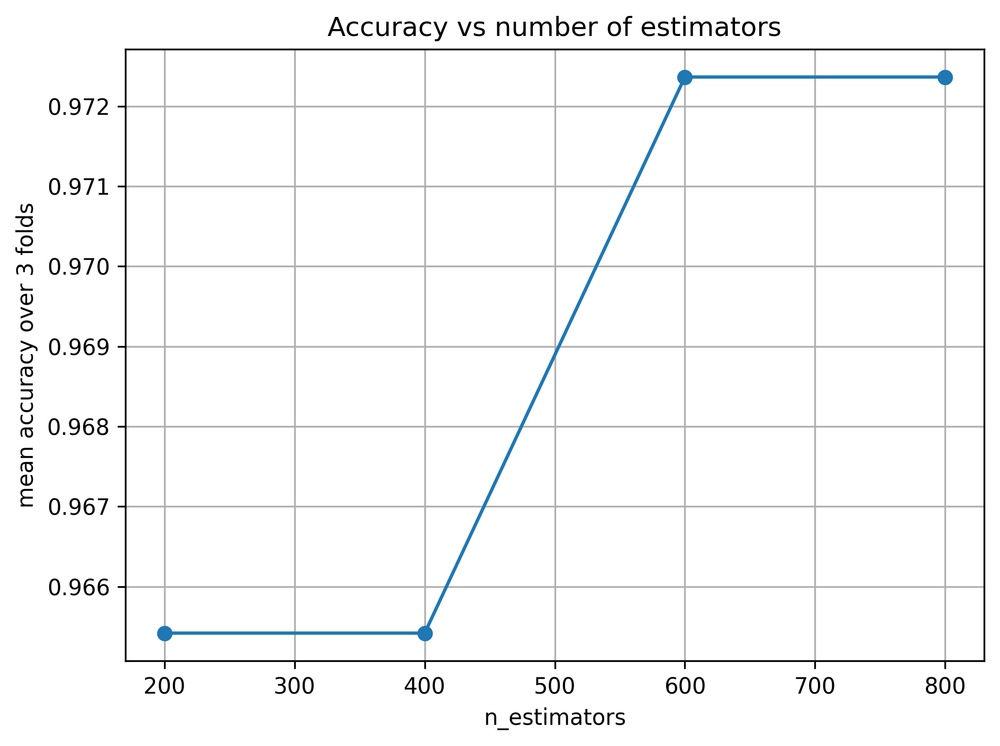

In [ ]:
fig, ax = plt.subplots()
ax.plot(n_estimators, mean_scores, marker = 'o')

ax.set_title('Accuracy vs number of estimators')
ax.set_xlabel('n_estimators')
ax.set_ylabel('mean accuracy over 3 folds')

fig.set_dpi(300)
ax.grid()

fig.tight_layout()

**Evaluation of Model with Different Number of Estimators**

The grid search results show that as the **n_estimators** (number of trees) increases, the model's accuracy improves. Specifically, between **200** and **600 estimators**, there is a **0.5% improvement** in accuracy, indicating a **slight improvement**.

- **Choosing 600 estimators** provides a good balance between reducing **bias** and maintaining **computational efficiency**. Beyond 600 estimators, the accuracy plateaus and remains the same, meaning that increasing the number of trees further does not yield significant gains in performance.
- **Avoiding overcomplexity**: Using more than 600 trees would add unnecessary **computational complexity** without providing a substantial performance boost.

Thus, **600 estimators** is the optimal choice, offering a slight improvement over 200 trees while keeping the model efficient and avoiding excessive complexity.



In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# FINAL CLASSIFIER!!
rdf_hcc = Pipeline([
    ('pca', PCA(n_components=31, random_state=42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(max_features='log2', n_estimators=600))
])

#### Model Selection

In the first part we save the mean accuracy of the model evaluated on three folds (strat k fold).

In the second part, we plot the **learning curve**, which shows the model’s accuracy as we gradually increase the **training set size**. Starting with a small subset, the model's performance improves as more data points are included in the training process. This curve helps us understand how well the model learns with additional data and whether it continues to improve or starts to stabilize. It also provides insight into the model’s **bias** and **variance**—for example, a sharp rise followed by stabilization indicates that the model benefits significantly from more data but eventually reaches a point of diminishing returns.

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
rdf_hcc_mean_score = cross_val_score(rdf_hcc, X_train_hcc, y_train_hcc, cv=skf).mean()

In [ ]:
rdf_hcc_mean_score

np.float64(0.9584750566893424)

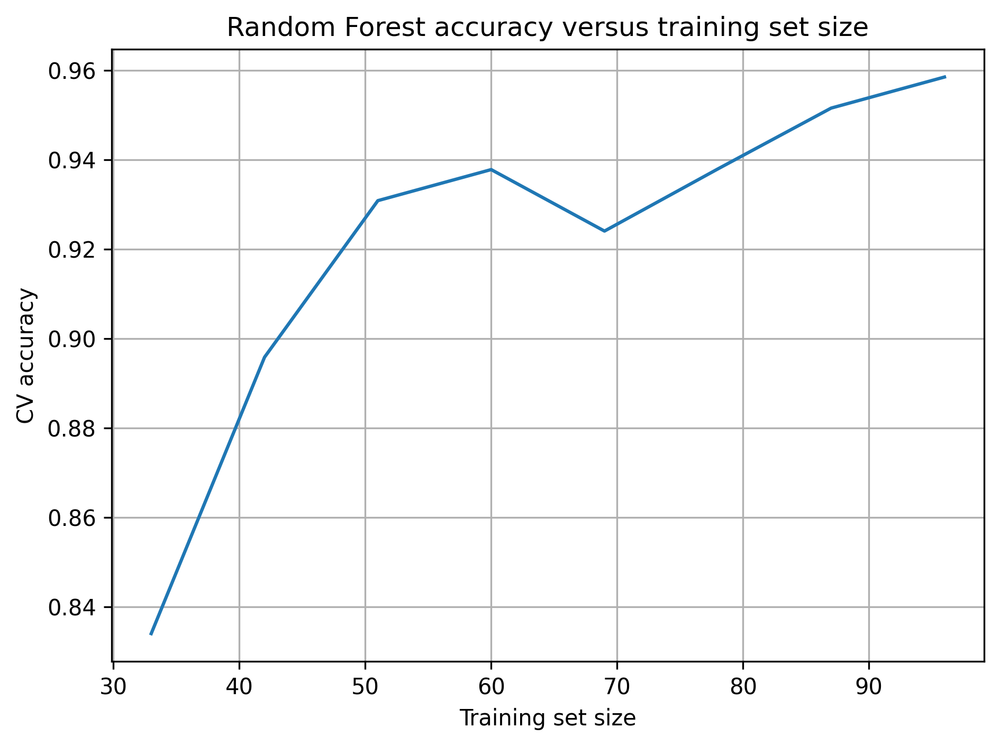

In [ ]:
# learning curve

#note: we start to 0.35 size because of n components equal to 31
from sklearn.model_selection import learning_curve

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.35, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    rdf_hcc, X_train_hcc, y_train_hcc,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Random Forest accuracy versus training set size")
ax.grid()

fig.tight_layout()

**Learning Curve: Accuracy vs Training Set Size**
- **With smaller training sets**, the model's performance (CV accuracy) starts relatively low.
- As the **training size increases**, the accuracy improves significantly, indicating that the model benefits from more data and is able to generalize better.

This suggests that the **Random Forest model** requires a sufficient amount of data to perform well and that adding more training examples helps it to learn more robust patterns. The model’s performance improves steadily as the training set size grows, with the curve stabilizing as it approaches a larger training set.
These insights highlight the model’s need for sufficient data to achieve optimal performance, and also show that the model generalizes well with increasing training data size, which helps avoid overfitting and reduces bias.

#### Test predictions

In [ ]:
rdf_hcc.fit(X_train_hcc, y_train_hcc)

Pipeline(steps=[('pca', PCA(n_components=31, random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(max_features='log2',
                                        n_estimators=600))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_hcc = rdf_hcc.predict(X_test_hcc)

print(f"Accuracy score for the 20% test set: {accuracy_score(y_test_hcc, y_pred_hcc)}")

Accuracy score for the 20% test set: 1.0


In [ ]:
# save the score
rdf_hcc_test_score = accuracy_score(y_test_hcc, y_pred_hcc)

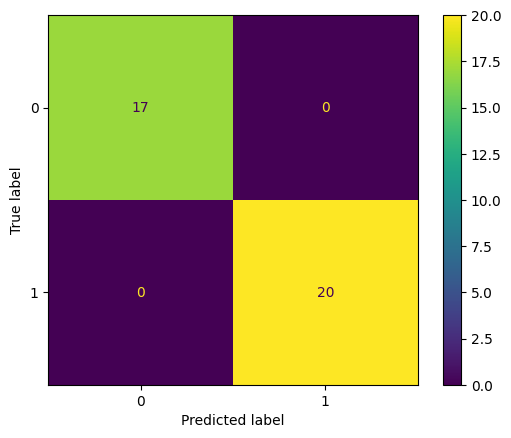

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_hcc, y_pred_hcc)
plt.show()

**Test Set Accuracy and Confusion Matrix**

After training the model, we evaluate its performance on the **20% test set**.

- **Accuracy Score**: The model achieved an **accuracy of 100%** on the test set, indicating strong predictive performance.

The model performs well with minimal errors.


#### Confidence analysis

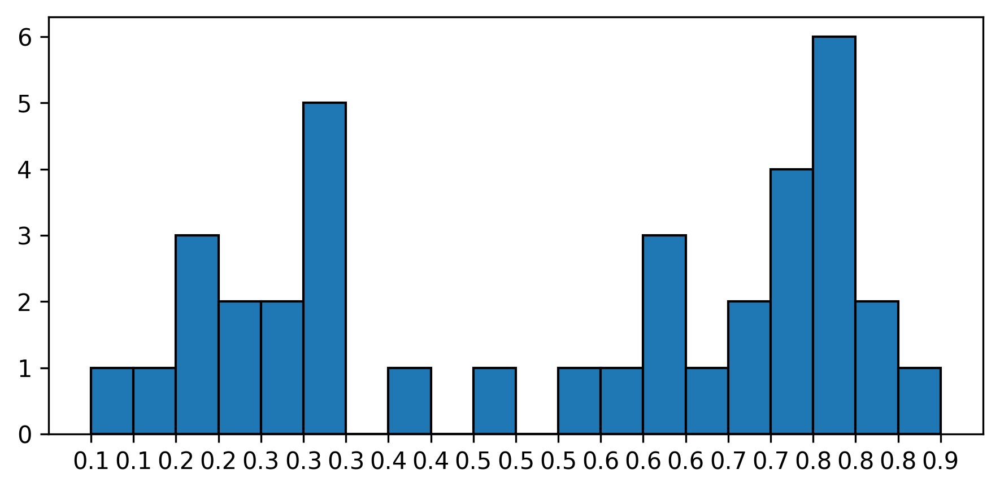

In [ ]:
# generate the array of raw probabilities
probs = rdf_hcc.predict_proba(X_test_hcc)[:, 1]

# histogram
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 1                        # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Test Set Probabilities and Model Confidence**

These probabilities represent the model's confidence in classifying each sample as belonging to the **hypoxic** class.

- **Decent but not very good performance**: We observe that the probabilities are spread across the range, with some values close to **0.5**, indicating uncertainty. Ideally, we want the model to assign higher probabilities (closer to 0 or 1) for more confident predictions. The spread suggests the model is not always certain about its predictions.


#### Gene retrieval

**Gene Retrieval and Feature Importance**

In this step, we focus on **feature importance**, which tells us which genes (or features) the model deems most relevant for making predictions. For **Random Forest**, this is calculated based on the **impurity decrease** in each tree when a feature is used to split the data. Higher importance scores indicate that the feature plays a significant role in the model's decision-making process.

However, **feature importance alone** does not tell us whether a feature is specifically associated with **hypoxia** or **normoxia** conditions. It simply ranks the features by their overall contribution to the prediction. As a result, we cannot directly distinguish between **hypoxia markers** or **normoxia markers** based solely on feature importance scores.

To gain more clarity, we **cross-check** the identified important features with existing **literature** on **hypoxia** and **normoxia** markers. This allows us to verify if the features identified by the model align with known biological markers and pathways related to these conditions. By doing this, we ensure that the model's findings are biologically meaningful and validate its predictions.


In [ ]:
# fit on the whole dataset
rdf_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=np.int64(31), random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(max_features='log2', random_state=42))])

In [ ]:
# feature importances series

importances = rdf_hcc['rnd'].feature_importances_
pcs = [f'PC_{i}' for i in range(1, 32)]
forest_importances = pd.Series(importances, index=pcs)

# loading vector technique

pca = rdf_hcc.named_steps['pca']
abs_pca_components = np.abs(pca.components_)

gene_weights = abs_pca_components.T.dot(importances)

genes = hcc.columns

gene_importances_hcc = pd.Series(gene_weights, index=genes)

gene_importances_sorted_hcc = gene_importances_hcc.sort_values(ascending=False)

In [ ]:
# take a look at the retrieved genes

gene_importances_sorted_hcc[:10]

LDHA       0.277822
FTL        0.171131
DDIT4      0.153536
CD44       0.145620
KRT19      0.145272
KRT17      0.142850
ALDOA      0.129950
LAMC2      0.128543
LAMB3      0.121003
KRT13      0.111217
KRT6A      0.109311
HSPA5      0.106960
FTH1       0.098965
BEST1      0.085851
MT-RNR2    0.085832
KRT18      0.084830
IGFBP3     0.084373
HSP90B1    0.083071
CD59       0.079854
TMSB10     0.077656
ANGPTL4    0.076138
SDHA       0.076122
PSMD2      0.073920
PGK1       0.073156
AKR1C2     0.070844
B2M        0.068702
ACTG1      0.067810
SCD        0.067570
KRT8       0.064887
HSPA8      0.064198
dtype: float64

**Gene Retrieval and Literature Comparison**

The following genes were identified as important by the model, and it is confirmed in the literature that they are **hypoxia markers**:

- **LDHA**
- **FTL**
- **DDIT4**
- **CD44**
- **KRT19**

These genes are well-established markers associated with **hypoxic conditions**.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/592192668.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,41)])


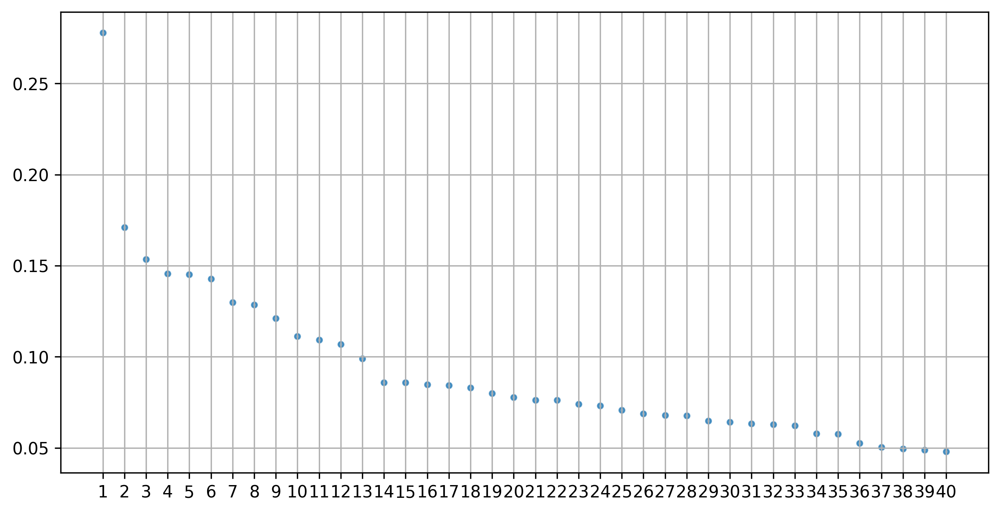

In [ ]:
# scatter plot

fig, ax = plt.subplots(figsize = (10, 5))

fig.set_dpi(300)
ax.scatter(gene_importances_sorted_hcc[:40].index, gene_importances_sorted_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,41)])
ax.grid()


### **MCF7**

#### Fine Tuning

In [ ]:
# grid search

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

n_features = X_train_mcf7.shape[1]

approx_fold_samples = int(np.floor(X_train_mcf7.shape[0] * 2/3))
max_pc = min(n_features, approx_fold_samples)

pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(random_state=42))
])

param_grid = {
    'pca__n_components': np.arange(3, max_pc+1, step=2),
    'rnd__min_samples_leaf': [1, 2, 4],
    'rnd__bootstrap' : [True, False],
    'rnd__max_features': ["sqrt", "log2"]
}

grid = GridSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_mcf7, y_train_mcf7)

Fitting 3 folds for each of 792 candidates, totalling 2376 fits
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s


[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=True, rnd__max_features=log2, rnd__min_samples_leaf=1; total time=   0.1s
[CV] END pca__n_components=3, rnd__bootstrap=Tru

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                       ('scaler', StandardScaler()),
                                       ('rnd',
                                        RandomForestClassifier(random_state=42))]),
             param_grid={'pca__n_components': array([  3,   5,   7,   9,  11,  13,  15,  17,  19,  21,  23,  25,  27,
        29,  31,  33,  35,  37,  39,  41,  43,  45,  47,  49,  51,  53,
        55,  57,  59,  61,  63,  65,  67,  69,  71,  73,  75,  77,  79,
        81,  83,  85,  87,  89,  91,  93,  95,  97,  99, 101, 103, 105,
       107, 109, 111, 113, 115, 117, 119, 121, 123, 125, 127, 129, 131,
       133]),
                         'rnd__bootstrap': [True, False],
                         'rnd__max_features': ['sqrt', 'log2'],
                         'rnd__min_samples_leaf': [1, 2, 4]},
             scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(1.0)

**Grid Search Results**

The first grid search resulted in the following optimal pipeline:

- **PCA**: The best number of components selected was **27**, balancing dimensionality reduction and variance retention.
- **Random Forest**: The model uses the **RandomForestClassifier** with the **default settings**, which includes deeper, more complex trees, as evidenced by the **`min_samples_leaf=1`** setting. Similar to the best model found in HCC

The **best score** achieved was **1.0**, indicating perfect accuracy on the training set.


In [ ]:
rdf_mcf7 = grid.best_estimator_

In [ ]:
# plot the performance as we vary n_estimators

from sklearn.model_selection import cross_val_score

n_estimators = [200, 400, 600, 800]

mean_scores = []

for n in n_estimators:

    rf = Pipeline([
    ('pca', PCA(n_components=27, random_state=42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(n_estimators= n, random_state=42))

    ])

    scores = cross_val_score(rf, X_train_mcf7, y_train_mcf7, cv=3, scoring='accuracy', n_jobs=-1)

    mean_scores.append(scores.mean())


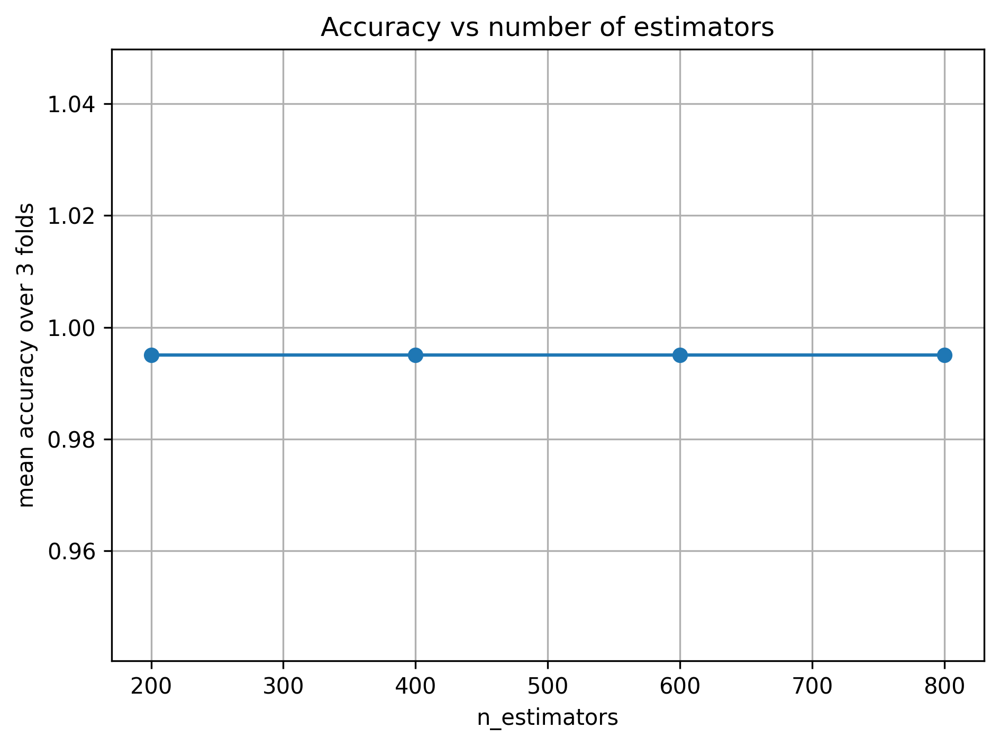

In [ ]:
fig, ax = plt.subplots()
ax.plot(n_estimators, mean_scores, marker = 'o')

ax.set_title('Accuracy vs number of estimators')
ax.set_xlabel('n_estimators')
ax.set_ylabel('mean accuracy over 3 folds')

fig.set_dpi(300)
ax.grid()

fig.tight_layout()

**Evaluation of Model with Different Numbers of Estimators**

The plot shows the **mean accuracy** of the **Random Forest** model across different numbers of **estimators (trees)**: **200**, **400**, **600**, and **800**.

- The accuracy remains constant at really near **1.0** across all four values of **n_estimators**, indicating that the model performs equally well regardless of the number of trees.
- Based on this, we chose **400 estimators** to avoid unnecessary complexity, as increasing the number of trees beyond 200 does not significantly improve performance. This selection helps strike a balance between computational efficiency and model performance.


In [ ]:
#FINAL CLASSIFIER
rdf_mcf7 = Pipeline([
   ('pca', PCA(n_components=27, random_state=42)),
   ('scaler', StandardScaler()),
   ('rnd', RandomForestClassifier(n_estimators= 400, random_state=42))
])


#### Model Selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
rdf_mcf7_mean_score = cross_val_score(rdf_mcf7, X_train_mcf7, y_train_mcf7, cv=skf).mean()

In [ ]:
rdf_mcf7_mean_score

np.float64(0.9800241218151666)

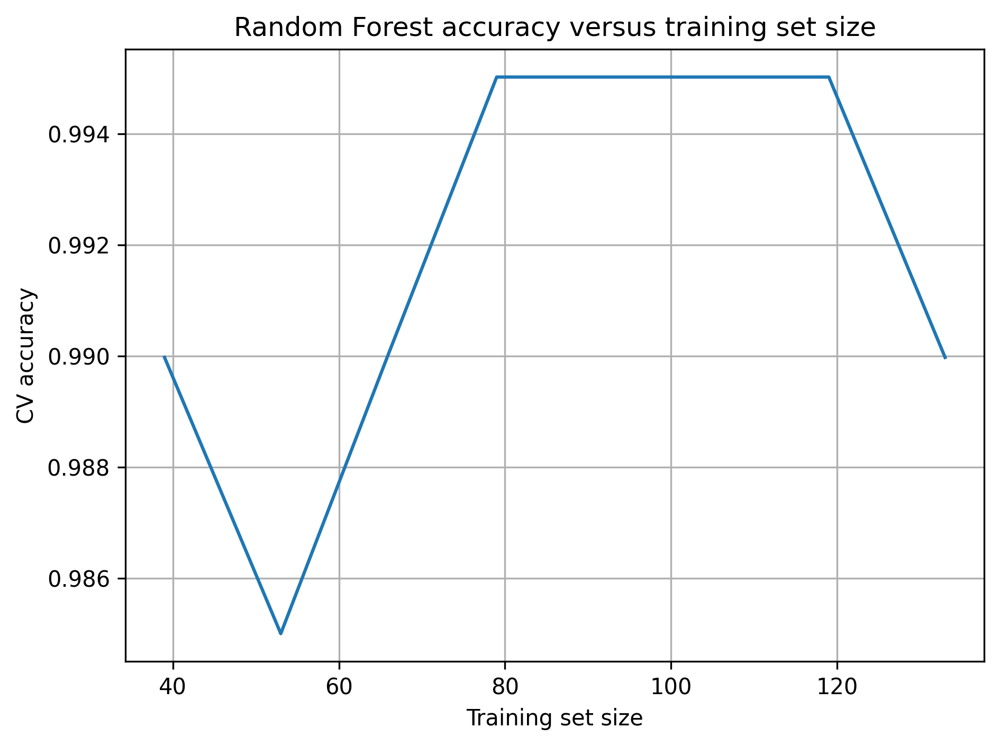

In [ ]:
#learning curve
from sklearn.model_selection import learning_curve
fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.3, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    rdf_mcf7, X_train_mcf7, y_train_mcf7,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Random Forest accuracy versus training set size")
ax.grid()

fig.tight_layout()

Learning Curve: Accuracy vs Training Set Size

The learning curve shows that **Random Forest** accuracy improves as the **training set size** increases. Initially, accuracy is lower, but as more data is added, performance increases and eventually stabilizes. This indicates that the model benefits from more data, but improvements plateau after a certain point.


#### Test predictions

In [ ]:
rdf_mcf7.fit(X_train_mcf7, y_train_mcf7)

Pipeline(steps=[('pca', PCA(n_components=27, random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(n_estimators=400, random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_mcf7 = rdf_mcf7.predict(X_test_mcf7)

rdf_mcf7_test_score = accuracy_score(y_test_mcf7, y_pred_mcf7)

print(f"Accuracy score for the 20% test set: {rdf_mcf7_test_score}")

Accuracy score for the 20% test set: 1.0


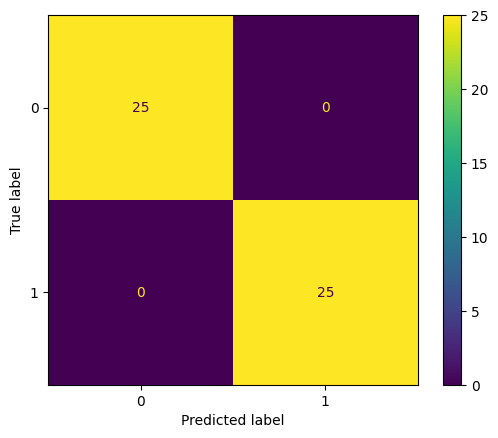

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_mcf7, y_pred_mcf7)
plt.show()

#### Confidence Analysis

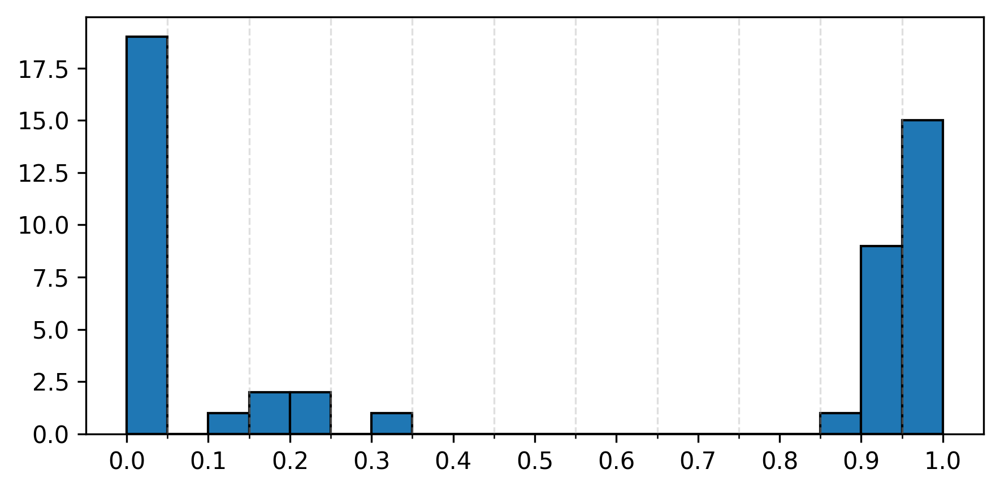

In [ ]:
probs = rdf_mcf7.predict_proba(X_test_mcf7)[:, 1]

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Test Set Probabilities**

The histogram shows the predicted probabilities for the test set. Most predictions are either close to **0** or **1**, indicating strong confidence. The model is very confident in its predictions here, suggesting a strong performance.


### Comparison of the Two Datasets

The model shows stronger confidence and better accuracy overall in its predictions on the **MCF7 dataset**, as indicated by the histogram where probabilities are clustered around **0** and **1**, reflecting clear classification decisions. This is a **better result** compared to the performance on the **HCC dataset**, where the probabilities were more spread out, suggesting that the model was less confident in distinguishing between class

This difference in performance could be due to:
- **Data quality**: The **MCF7 dataset** may have clearer or more distinct patterns between the classes, making it easier for the model to classify the samples correctly.
- **Feature relevance**: The features in the **MCF7 dataset** might be more informative or better aligned with the target variable, improving the model’s ability to predict confidently.

In conclusion, the **MCF7 dataset** is likely more straightforward for the model to classify, resulting in higher confidence and a stronger performance compared to the **HCC dataset**.


#### Gene retrieval

In [ ]:
# fit on the whole dataset
rdf_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=np.int64(27), random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd', RandomForestClassifier(random_state=42))])

In [ ]:
# feature importances series

importances = rdf_mcf7['rnd'].feature_importances_
pcs = [f'PC_{i}' for i in range(1, 28)]
forest_importances = pd.Series(importances, index=pcs)

#loading vector technique


pca = rdf_mcf7.named_steps['pca']
abs_pca_components = np.abs(pca.components_)

gene_weights = abs_pca_components.T.dot(importances)

genes = mcf7.columns

gene_importances_mcf7 = pd.Series(gene_weights, index=genes)

gene_importances_sorted_mcf7 = gene_importances_mcf7.sort_values(ascending=False)

In [ ]:
gene_importances_sorted_mcf7[:30]

GAPDH         0.387387
ACTG1         0.307901
ALDOA         0.257207
CYP1B1        0.200339
CYP1A1        0.163259
UBC           0.142611
PGK1          0.131751
FTH1          0.127547
GPI           0.123549
BEST1         0.114557
DDIT4         0.104571
MT-CO1        0.086657
CYP1B1-AS1    0.083742
LDHA          0.078138
FTL           0.066164
TFF1          0.061285
CTSD          0.059537
PFKFB3        0.058220
MT-CYB        0.057710
SLC2A1        0.057047
MT-CO2        0.051434
TMSB10        0.045723
HSPB1         0.044141
SLC3A2        0.043940
SULF2         0.043637
HK2           0.043453
IGFBP3        0.043335
MT-ND4        0.040186
BHLHE40       0.036369
SQSTM1        0.034323
dtype: float64

**Gene Retrieval and Literature Comparison**

The following genes were identified as important by the model in the **MCF7 dataset**, and it is confirmed in the literature that they are **hypoxia markers**:

- **GAPDH**
- **ACTG1**
- **ALDOA**
- **CYP1B1**
- **PGK1**

These genes are well-established markers associated with **hypoxic conditions**.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/2675301480.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,41)])


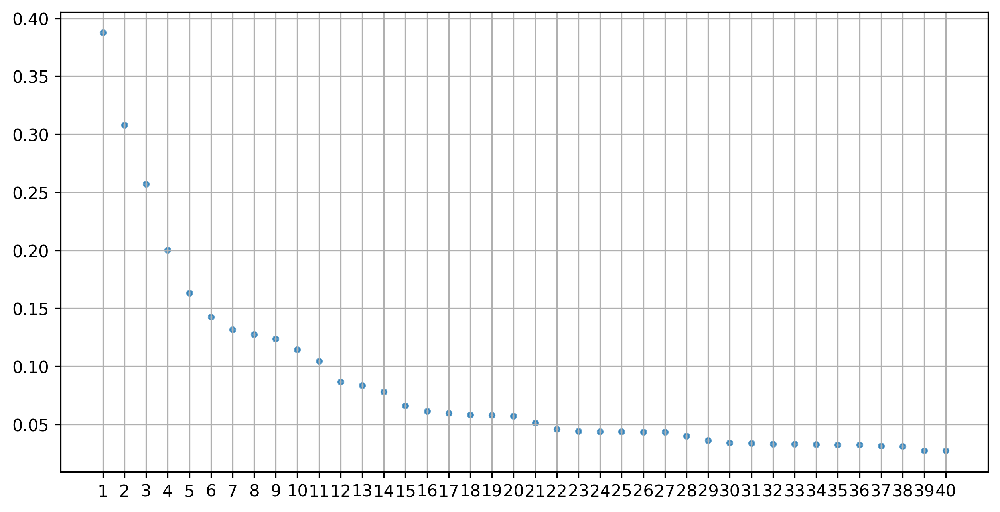

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

fig.set_dpi(300)

ax.scatter(gene_importances_sorted_mcf7[:40].index, gene_importances_sorted_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,41)])
ax.grid()

## LOGISTIC REGRESSION

### **HCC**

#### Fine Tuning

**Logistic Regression Grid Search**

For **Logistic Regression**, we perform a grid search with the following pipeline:

- **PCA**: We search for the optimal number of components from **2 to 50** with a **step of 2**. This range is chosen for computational simplicity and to avoid overfitting, while still capturing enough variance in the data.
- **C Parameter**: The **C** parameter in **Logistic Regression** controls the strength of regularization. It is inversely related to regularization:
  - A **low value of C** (e.g., 10^-4) implies **strong regularization**, which increases bias but reduces variance. The model becomes simpler, potentially underfitting by not capturing enough complexity from the data.
  - A **high value of C** (e.g., 10^4) implies **weak regularization**, which allows the model to fit the training data more closely. However, this can lead to **overfitting**, where the model captures noise or specific patterns in the training set that do not generalize well to new data.

  We test a range of values for **C** to find the best trade-off between **bias** and **variance** to improve model performance.

- **Logistic Regression Solver**: We explore different solvers (like **'lbfgs'**, **'newton-cg'**, and **'sag'**) to see which works best for this dataset.
- **Penalty**: The **penalty** parameter controls regularization:
  - **L1 (Lasso)**: Encourages sparsity, setting some coefficients to zero.
  - **L2 (Ridge)**: Reduces the impact of less important features without eliminating them.
  - **None**: No regularization, which may lead to overfitting.

  We test **L1**, **L2**, and **None** to find the best regularization method.

The grid search will optimize these parameters to find the best-performing **Logistic Regression model**.

As before, first HCC dataset then MCF7.

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


pca_params = np.arange(5, 50, step=2)

pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, solver='liblinear'))
])

param_grid = [
    {
    'scaler': [StandardScaler()],
    'pca__n_components': pca_params,
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l2', None],
    'log_reg__solver': ['lbfgs','newton-cg','sag']},

    {'scaler': [StandardScaler()],
    'pca__n_components': pca_params,
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l1', 'l2'],
    'log_reg__solver': ['liblinear', 'saga']},

    {'scaler': [StandardScaler()],
    'pca__n_components': pca_params,
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['elasticnet'],
    'log_reg__solver': ['saga'],
    'log_reg__l1_ratio': [0.1, 0.5, 0.9]}
]

grid = GridSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_hcc, y_train_hcc)

In [ ]:
grid.best_score_

np.float64(0.986111111111111)

In [ ]:
log_hcc = grid.best_estimator_

**Logistic Regression Grid Search Results**

The optimal pipeline for **Logistic Regression** includes the following parameters:

- **PCA**: The best number of components selected is **39**, striking a balance between dimensionality reduction and retaining variance.
- **Logistic Regression**: The optimal **C parameter** is **0.00599**, indicating **weak regularization**, allowing the model to fit more closely to the training data while still preventing extreme overfitting.

The **best score** achieved is **0.9861**, showing strong performance on the training set, suggesting that the selected parameters provide a good fit while maintaining a balance between bias and variance.


In [ ]:
#final classifier

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


log_hcc = Pipeline([
    ('pca', PCA(random_state=42, n_components=39)),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, C = 0.005994842503189409))
])

#### Model Selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
log_hcc_mean_score = cross_val_score(log_hcc, X_train_hcc, y_train_hcc, cv=skf).mean()

In [ ]:
log_hcc_mean_score

np.float64(0.9583333333333334)

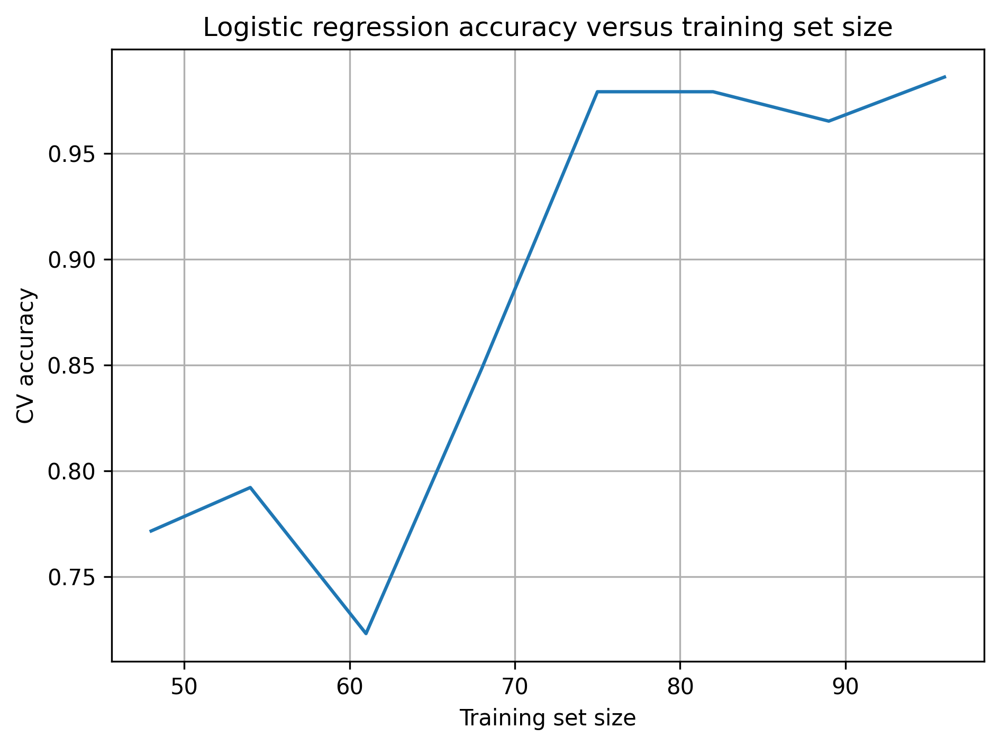

In [ ]:
#learning curve vs training set size
from sklearn.model_selection import learning_curve

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.5, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    log_hcc, X_train_hcc, y_train_hcc,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Logistic regression accuracy versus training set size")
ax.grid()

fig.tight_layout()

**Logistic Regression Learning Curve**

The learning curve for **Logistic Regression** shows:

- **Lower accuracy with small training sets** (around 0.75–0.80 at ~50 samples), indicating the model underfits when data is scarce.
- **Sharp improvement** as the training set grows to ~70 samples, reaching ~0.98 CV accuracy.
- Plateaus from 75 samples.

**Comparison with Random Forest**

- **Random Forest** achieved high CV accuracy even with smaller training sizes, showing greater robustness to limited data.
- **Logistic Regression** needs more samples to reach similar performance, reflecting its reliance on linear separability and sensitivity to sample size.

In summary, Logistic Regression’s performance is more data‐dependent and struggles with very small training sets, whereas Random Forest maintains strong accuracy with less data.


#### Test Predictions

In [ ]:
# fit on all training dataset
log_hcc.fit(X_train_hcc, y_train_hcc)

Pipeline(steps=[('pca', PCA(n_components=39, random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=0.005994842503189409, random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score


y_pred_hcc = log_hcc.predict(X_test_hcc)

log_hcc_test_score = accuracy_score(y_test_hcc, y_pred_hcc)

print(f"Accuracy score for the 20% test set: {log_hcc_test_score}")

Accuracy score for the 20% test set: 1.0


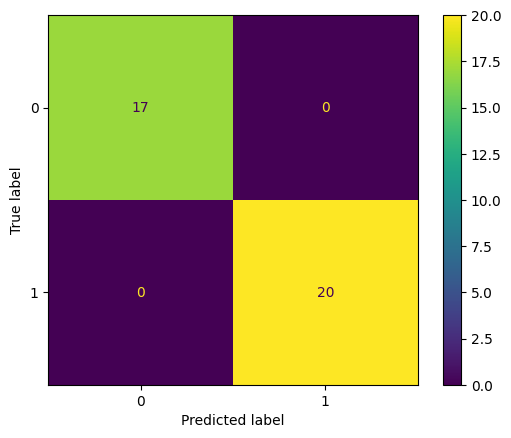

In [ ]:
#confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_hcc, y_pred_hcc)
plt.show()


#### Confidence analysis

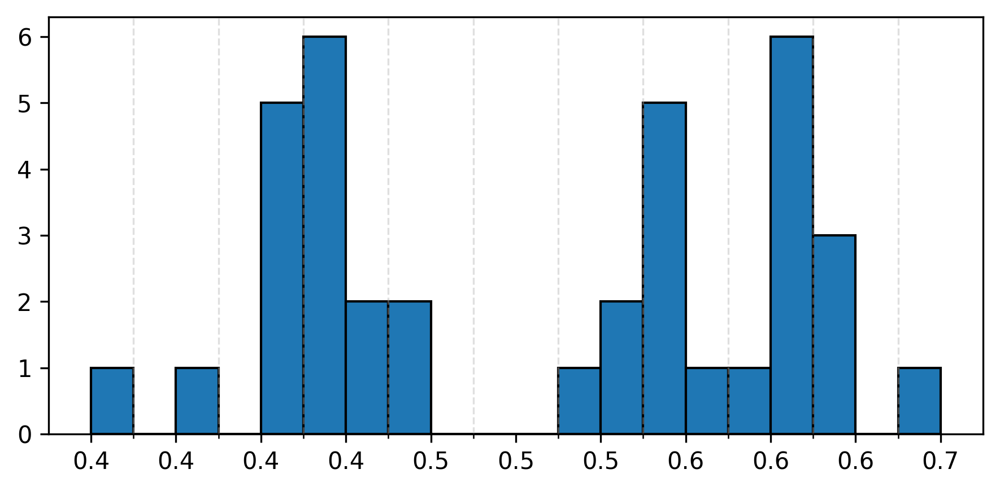

In [ ]:
probs = log_hcc.predict_proba(X_test_hcc)[:, 1]

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Logistic Regression Confidence on HCC Test Set**

Even though the logistic regression model achieved **100% accuracy** on the HCC test set, the predicted probabilities tell a different story:

- **Perfect accuracy** simply means every sample was correctly classified (above or below 0.5).
- However, most probabilities cluster around **0.4–0.6**, indicating **weak confidence** despite correct labels.
- In practice, a model that predicts correctly but with low confidence can be risky, especially if deployed on new data where the decision boundary may shift.
- This suggests that, while the model “guessed” right here, it isn’t strongly convinced—and may fail under slight data variations.

In short, **perfect accuracy** doesn’t guarantee a **robust** or **confident** model.



#### Gene retrieval

In [ ]:
# fit on all data
log_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=np.int64(39), random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(0.005994842503189409),
                                    random_state=42))])

**Gene Importance from this model**

To determine each gene’s contribution to the final decision, we:

1. **Extract the PCA‐space coefficients**  
   Retrieve the learned weights (ω) from the logistic regression model in PCA space.

2. **Undo feature scaling**  
   Divide each PCA‐space coefficient by the corresponding StandardScaler scale factor to get the unscaled PCA coefficients.

3. **Back‐project through PCA**  
   Multiply the unscaled PCA coefficients by the PCA component matrix (genes × components). This projects the weights from component space back into the original gene space.

4. **Rank genes by absolute weight**  
   The resulting vector gives each gene’s importance—sort descending to identify the top positive (hypoxia‐driving) and negative (normoxia‐driving) genes.


In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = log_hcc.named_steps['log_reg'].coef_[0]

# undo the scaler
scaler = log_hcc.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = log_hcc.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = hcc.columns

# RANK GENES

# create series with (gene_name : weights)
w_hcc = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_hcc = w_hcc.sort_values(ascending=False)

# Most negatively driving genes
top_neg_hcc = w_hcc.sort_values()

In [ ]:
top_pos_hcc[:20]

ALDOA      0.000029
DDIT4      0.000020
PGK1       0.000014
GPRC5A     0.000012
LDHA       0.000012
EZR        0.000011
SLC3A2     0.000010
MIF        0.000009
MIF-AS1    0.000009
ANGPTL4    0.000008
SLC2A1     0.000007
MT-ND4     0.000007
PSAP       0.000006
TK1        0.000006
GPI        0.000006
SDHA       0.000006
MT-RNR2    0.000006
KRT17      0.000005
KRT13      0.000005
CEACAM5    0.000005
dtype: float64

**Logistic Regression Gene Retrieval and Literature Comparison**

Top genes driving the Logistic Regression boundary (after back‐projection):

- **ALDOA**  
- **DDIT4**  
- **PGK1**  
- **GPRC5A**  
- **LDHA**  

All five are established **hypoxia markers**. Moreover, **ALDOA**, **DDIT4**, **PGK1** and **LDHA** also appeared in our Random Forest analysis, confirming their consistent importance across models.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_22989/4069642769.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


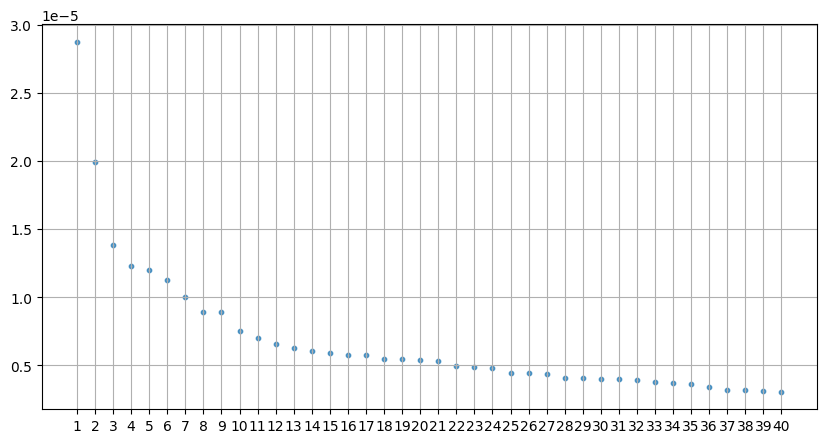

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))
scatter(top_pos_hcc[:40].index, top_pos_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

In [ ]:
top_neg_hcc[:20]

MMP1      -0.000016
KRT6A     -0.000012
UBC       -0.000012
ACTG1     -0.000012
KRT18     -0.000012
SQSTM1    -0.000011
TXN       -0.000010
S100A2    -0.000010
PSMD2     -0.000009
TUBB      -0.000009
GPX3      -0.000009
LDHB      -0.000008
TFRC      -0.000008
TUBA1B    -0.000008
HMGA1     -0.000008
PLAU      -0.000008
S100A16   -0.000008
CTSB      -0.000007
MT-CYB    -0.000006
MALAT1    -0.000006
dtype: float64

**Literature Confirmation of Normoxia Markers**

- **ACTG1**: Commonly used as a **housekeeping** gene with stable expression under **normoxic** conditions.  
- **KRT18**: Expression decreases significantly under **hypoxia**, indicating its role as a **normoxia** marker.

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_22989/1901345960.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


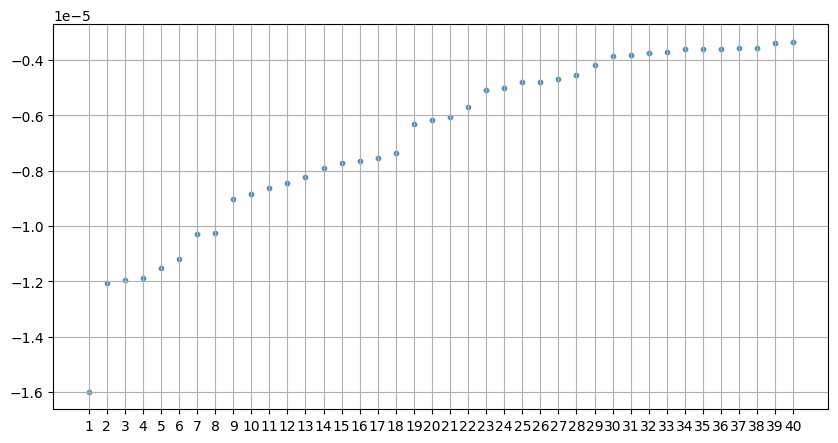

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_hcc[:40].index, top_neg_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

### **MCF7**

#### Fine tuning

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

pca_params = np.arange(5, 50, step=2)

pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, solver='liblinear'))
])

param_grid = [
    {
    'scaler': [StandardScaler()],
    'pca__n_components': pca_params,
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l2', None],
    'log_reg__solver': ['lbfgs','newton-cg','sag']},

    {'scaler': [StandardScaler()],
    'pca__n_components': pca_params,
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l1', 'l2'],
    'log_reg__solver': ['liblinear', 'saga']},

    {'scaler': [StandardScaler()],
    'pca__n_components': pca_params,
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['elasticnet'],
    'log_reg__solver': ['saga'],
    'log_reg__l1_ratio': [0.1, 0.5, 0.9]}
]

grid = GridSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_mcf7, y_train_mcf7)

In [ ]:
grid.best_score_

np.float64(1.0)

In [ ]:
log_mcf7 = grid.best_estimator_

In [ ]:
log_mcf7

Pipeline(steps=[('pca', PCA(n_components=np.int64(5), random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(21.54434690031882),
                                    penalty='l1', random_state=42,
                                    solver='liblinear'))])

**Logistic Regression Results on MCF7**

- **Best Pipeline**  
  - **PCA**: 5 components  
  - **StandardScaler**  
  - **LogisticRegression**: C = 21.54, **penalty** = 'l1', solver = 'liblinear'  

- **Best CV Score**: **1.0** (perfect separability in cross-validation)

- **Interpretation**  
  - Only **5 PCA components** are needed to capture the key variance, indicating a very low-dimensional signal.  
  - **L1 regularization** enforces sparsity, selecting the few most informative genes.  
  - A relatively **high C** value allows the model to fit subtle differences without over-regularizing.

In [ ]:
#FINAL CLASSIFIER
log_mcf7 = Pipeline([

    ('pca', PCA(random_state=42, n_components=5)),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, C=np.float64(21.54434690031882), penalty='l1',  solver='liblinear'))
])

#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
log_mcf7_mean_score = cross_val_score(log_mcf7, X_train_mcf7, y_train_mcf7, cv=skf).mean()

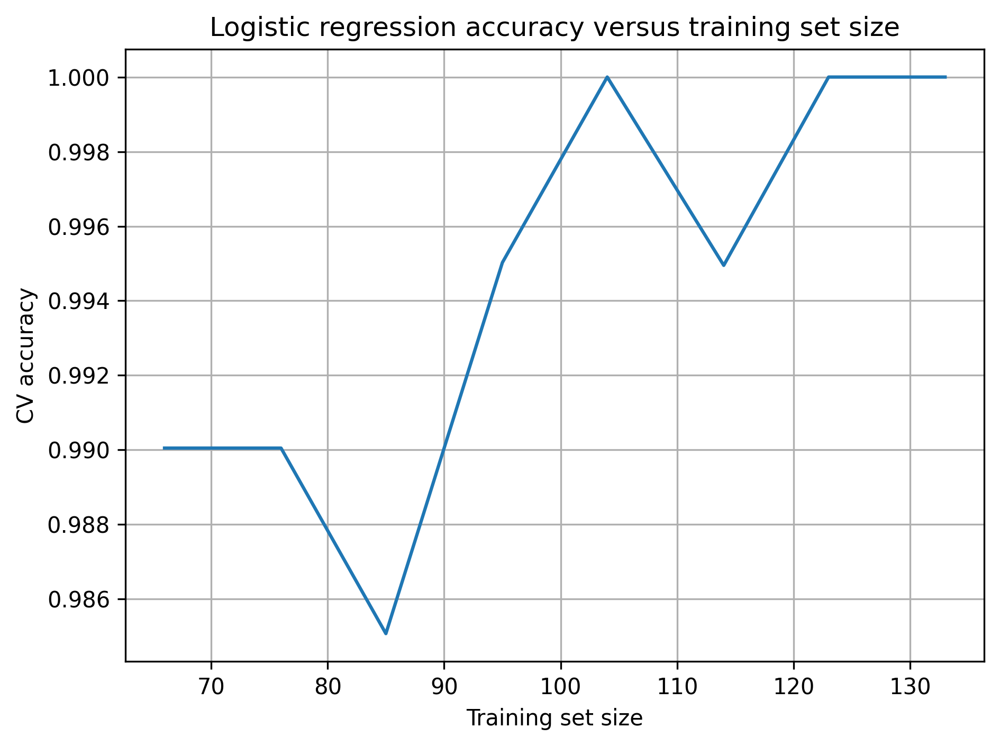

In [ ]:
#learning curve vs training size
from sklearn.model_selection import learning_curve

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.5, 1.0, 8) # try from 0.5

train_sizes, train_scores, cv_scores = learning_curve(
    log_mcf7, X_train_mcf7, y_train_mcf7,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Logistic regression accuracy versus training set size")
ax.grid()

fig.tight_layout()

#### Test predictions

In [ ]:
# fit on the whole training set
log_mcf7.fit(X_train_mcf7, y_train_mcf7)


Pipeline(steps=[('pca', PCA(n_components=5, random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(21.54434690031882),
                                    penalty='l1', random_state=42,
                                    solver='liblinear'))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_mcf7 = log_mcf7.predict(X_test_mcf7)

log_mcf7_test_score = accuracy_score(y_test_mcf7, y_pred_mcf7)

print(f"Accuracy score for the 20% test set: {log_mcf7_test_score}")

Accuracy score for the 20% test set: 0.98


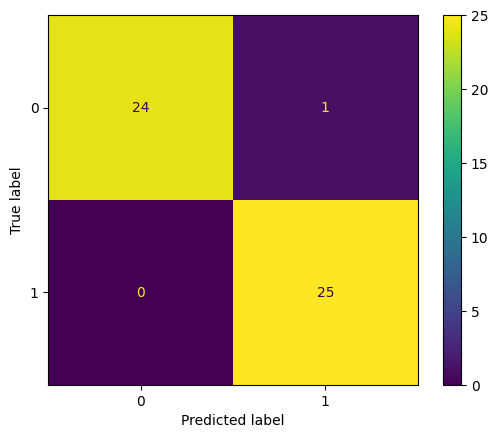

In [ ]:
#confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_mcf7, y_pred_mcf7)
plt.show()

#### Confidence analysis

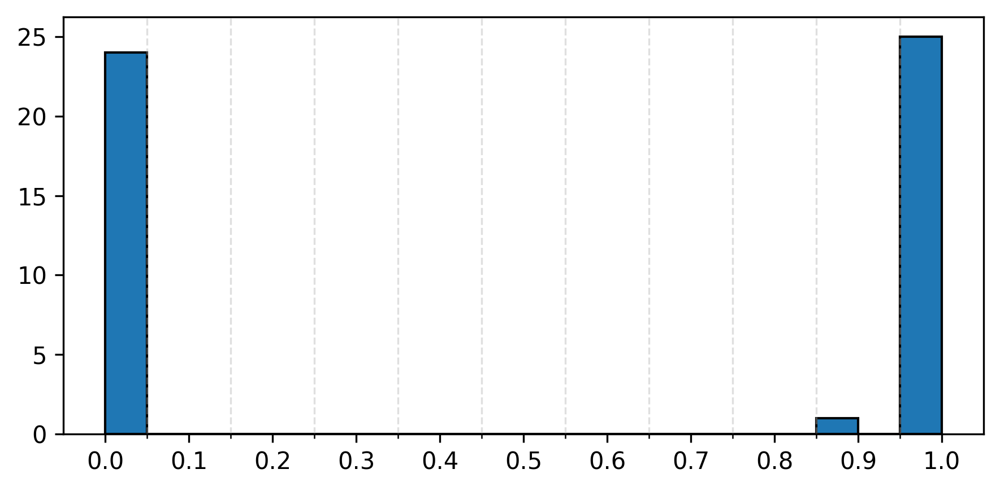

In [ ]:
probs = log_mcf7.predict_proba(X_test_mcf7)[:, 1]

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Test Set Confidence for MCF7 Logistic Regression**

- **Accuracy**: 98% on the test set, with only **one misclassification**.  
- **Probability Histogram**: Almost all predicted probabilities are at **0** or **1**, with a single sample around **0.9**. This demonstrates **very high confidence** in nearly every prediction, highlighting the model’s strong separation of hypoxia vs. normoxia on the MCF7 dataset.

**MCF7 vs. HCC**

- On MCF7, **both Random Forest and Logistic Regression** achieved perfect accuracy and high-confidence predictions.  
- In contrast, the HCC dataset produced more ambiguous probabilities and required more components/trees to reach similar scores.  

**Conclusion:** The MCF7 dataset is inherently easier to classify—its hypoxia vs. normoxia gene expression patterns are more distinct, yielding better and more confident model performance.


#### Gene retrieval

In [ ]:
# fit on all data
log_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=np.int64(5), random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(21.54434690031882),
                                    penalty='l1', random_state=42,
                                    solver='liblinear'))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = log_mcf7.named_steps['log_reg'].coef_[0]

# undo the scaler
scaler = log_mcf7.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = log_mcf7.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = mcf7.columns

# RANK GENES

# create series with (gene_name : weights)
w_mcf7 = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_mcf7 = w_mcf7.sort_values(ascending=False)

# Most negatively driving genes
top_neg_mcf7 = w_mcf7.sort_values()

**Hypoxia Markers (MCF7)**

The following genes were top‐weighted by Logistic Regression on MCF7 and are **confirmed hypoxia markers**:

- **CYP1B1**  
- **CYP1A1**  
- **GAPDH**  
- **DDIT4**  
- **PGK1**  
- **FTH1**  
- **GPRC5A**  

> **Overlap Across Classifiers:**  
> - **DDIT4**, **PGK1**, and **GPRC5A** also appeared as top markers in our HCC Random Forest and Logistic Regression models, reinforcing their consistent role in hypoxic response.    


In [ ]:
top_pos_mcf7[:20]

CYP1B1        0.000586
GAPDH         0.000400
CYP1A1        0.000306
CYP1B1-AS1    0.000245
ACTG1         0.000228
FTH1          0.000201
BEST1         0.000179
DDIT4         0.000111
PGK1          0.000110
UBC           0.000101
SLC3A2        0.000087
LDHA          0.000072
NCOA3         0.000067
SLC7A5        0.000065
SQSTM1        0.000055
PFKFB3        0.000054
KRT80         0.000045
AARS1         0.000044
BHLHE40       0.000042
TRIB3         0.000040
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_22989/3290662101.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


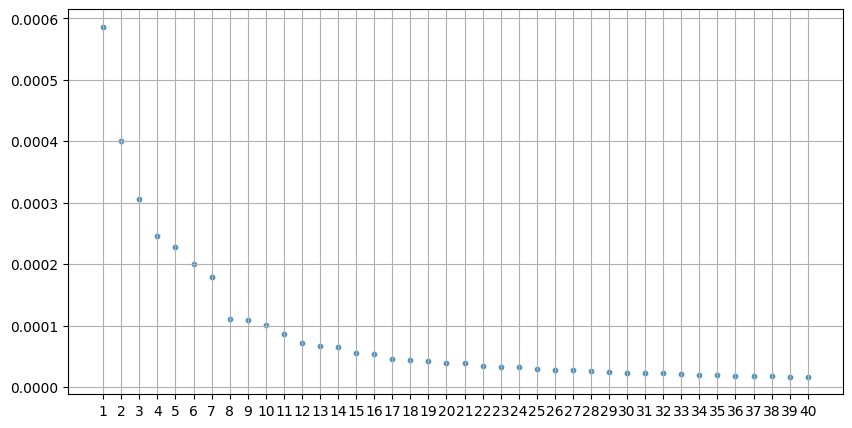

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_pos_mcf7[:40].index, top_pos_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

In [ ]:
top_neg_mcf7[:20]

MT-CO1     -0.000173
ALDOA      -0.000137
MT-CYB     -0.000101
MT-CO2     -0.000097
MT-ND4     -0.000068
MT-CO3     -0.000053
MT-RNR2    -0.000047
SULF2      -0.000043
TUBA1B     -0.000034
MT-ATP6    -0.000032
SLC9A3R1   -0.000031
MT-ND5     -0.000031
CTSD       -0.000030
GFRA1      -0.000029
COX6C      -0.000027
SLC39A6    -0.000024
TFF1       -0.000021
HSPB1      -0.000021
XBP1       -0.000020
IDH2       -0.000019
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_22989/3677777904.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


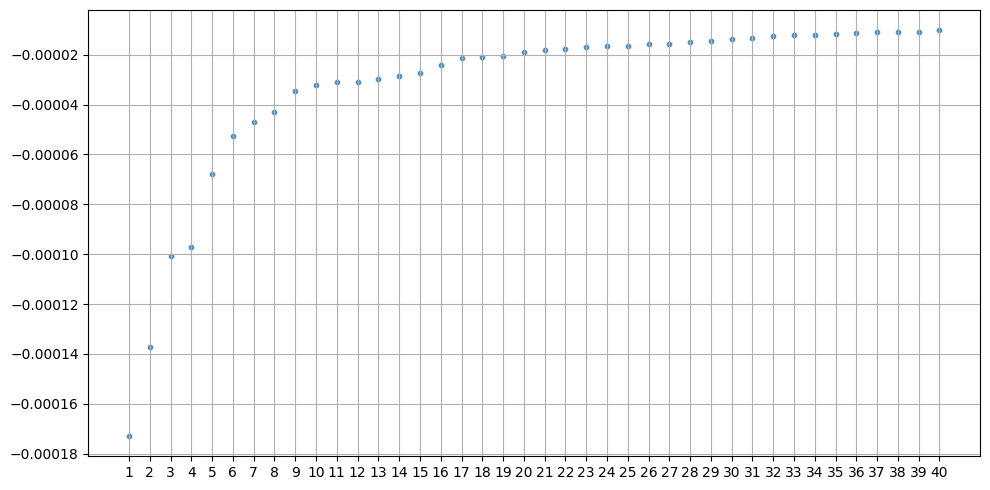

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_mcf7[:40].index, top_neg_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()
fig.tight_layout()

## SUPPORT VECTOR MACHINE

### **HCC**


**Support Vector Machine Grid Search**

We tune our **Linear SVM** using the same PCA + scaling pipeline as before, by performing a **GridSearchCV** over:

- **PCA components** (`pca__n_components`)  
  - Range: from **3** up to `max_pc` (two-thirds of the training samples), in steps of **2**, same as in Random forest.
  - Ensures we test only valid component counts and keep the search efficient  

- **SVM regularization** (`svc__C`)  
  - Values: **[0.1, 1, 10, 100, 1000]**  
  - **C** controls the margin vs. errors trade-off:  
    - **Low C** → wider margin, more tolerance for misclassifications (higher bias, lower variance)  
    - **High C** → narrower margin, fewer training errors (lower bias, higher variance)  

We use **3-fold cross-validation** and **accuracy** as our scoring metric to find the optimal combination of PCA components and **C**. This preserves a linear decision boundary for later feature-importance extraction.  


#### Fine tuning

In [ ]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


n_features = X_train_hcc.shape[1]

approx_fold_samples = int(np.floor(X_train_hcc.shape[0] * 2/3))
max_pc = min(n_features, approx_fold_samples)


pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('svc', SVC(kernel='linear', random_state=42))
])

param_grid = {
    'pca__n_components': np.arange(3, max_pc+1, step=2),
    'svc__C':     [0.1, 1, 10, 100, 1000]
}

grid = GridSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_hcc, y_train_hcc)

Fitting 3 folds for each of 235 candidates, totalling 705 fits
[CV] END ....................pca__n_components=3, svc__C=0.1; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=0.1; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=0.1; total time=   0.0s
[CV] END ......................pca__n_components=3, svc__C=1; total time=   0.0s
[CV] END ......................pca__n_components=3, svc__C=1; total time=   0.0s
[CV] END ......................pca__n_components=3, svc__C=1; total time=   0.0s
[CV] END .....................pca__n_components=3, svc__C=10; total time=   0.0s
[CV] END .....................pca__n_components=3, svc__C=10; total time=   0.0s
[CV] END .....................pca__n_components=3, svc__C=10; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=100; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=100; total time=   0.0s
[CV] END ....................pca__n_components

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                       ('scaler', StandardScaler()),
                                       ('svc',
                                        SVC(kernel='linear',
                                            random_state=42))]),
             param_grid={'pca__n_components': array([ 3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31, 33, 35,
       37, 39, 41, 43, 45, 47, 49, 51, 53, 55, 57, 59, 61, 63, 65, 67, 69,
       71, 73, 75, 77, 79, 81, 83, 85, 87, 89, 91, 93, 95]),
                         'svc__C': [0.1, 1, 10, 100, 1000]},
             scoring='accuracy', verbose=2)

In [ ]:
# an idea of the mean ccuracy
grid.best_score_

np.float64(0.9791666666666666)

In [ ]:
# save the best model
svc_hcc = grid.best_estimator_


**SVM Grid Search Results**

The best pipeline found by **GridSearchCV** on the HCC data is:

- **PCA**: **63 components**  
- **StandardScaler**  
- **SVC**: **C = 0.1**, **kernel = 'linear'**

**Interpretation:**
- A **high PCA component count (63)** indicates that the variance relevant for separating hypoxia vs. normoxia is spread across many dimensions.
- A **low C value (0.1)** enforces stronger regularization (wider margin, more tolerance for misclassified training points), which helps prevent overfitting given the high dimensionality.
- This combination achieved the best cross-validation accuracy, balancing the need to capture sufficient signal (via many components) and avoid overfitting (via stronger regularization).


In [ ]:
from sklearn.svm import SVC

#to avoid grid search
svc_hcc = Pipeline([

    ('pca', PCA(random_state=42, n_components = 63)),
    ('scaler', StandardScaler()),
    ('svc', SVC(kernel='linear', C=0.1, random_state=42))
    ])

#### Model selection


In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
svc_hcc_mean_score = cross_val_score(svc_hcc, X_train_hcc, y_train_hcc, cv=skf).mean()

In [ ]:
svc_hcc_mean_score

np.float64(0.9791666666666666)

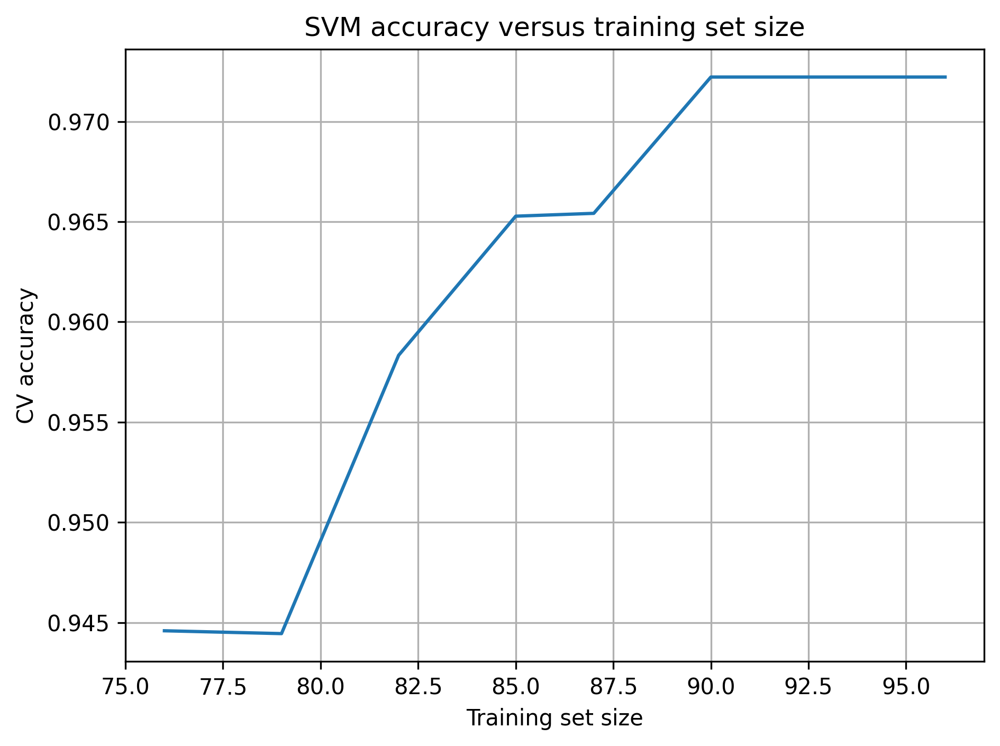

In [ ]:
# SINGLE LEARNING CURVE

from sklearn.model_selection import learning_curve
from sklearn.model_selection import cross_val_score

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.8, 1.0, 8) # keep from 0.5 so that it doesnt fail

train_sizes, train_scores, cv_scores = learning_curve(
    svc_hcc, X_train_hcc, y_train_hcc,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("SVM accuracy versus training set size")
ax.grid()

fig.tight_layout()

**SVM Learning Curve Caveat**

Because our optimal **PCA** uses **63 components**, we cannot compute meaningful SVM scores with fewer than ~63 training samples—the model requires at least as many samples as dimensions. As a result, our learning curve only starts at ~75 samples, preventing us from assessing performance in the very low-data regime.

---

**Learning Curve Analysis**

- **Strong overall performance:**  
  CV accuracy improves from ~94.4 % at 80 % of the data up to ~97.2 % at 90–100 %.

- **Diminishing returns:**  
  The steepest gains occur between 80 % → 90 % of data; beyond that, the curve flattens, indicating you’ve nearly saturated the model’s capacity.

- **Low variance:**  
  A smooth, monotonic rise across folds suggests consistent performance and minimal volatility.

- **Residual bias:**  
  Accuracy plateaus below 100 %, implying a bit of underfitting that extra data alone won’t fix.



Test predictions

In [ ]:
svc_hcc.fit(X_train_hcc, y_train_hcc)

Pipeline(steps=[('pca', PCA(n_components=63, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc', SVC(C=0.1, kernel='linear', random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_hcc = svc_hcc.predict(X_test_hcc)


svc_hcc_test_score = accuracy_score(y_test_hcc, y_pred_hcc)


print(f"Accuracy score for the 20% test set: {svc_hcc_test_score}")

Accuracy score for the 20% test set: 1.0


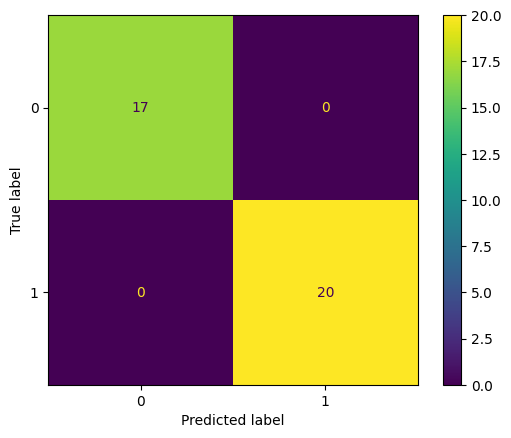

In [ ]:
#confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_hcc, y_pred_hcc)
plt.show()



#### Confidence analysis

**Calculating Probabilities with SVM**

Since the **SVC (Support Vector Classifier)** does not have a built-in `predict_proba()` method but it returns the distance from the margin for a point, we use **CalibratedClassifierCV** to calculate probabilities.

1. **CalibratedClassifierCV**:  
   **CalibratedClassifierCV** is a wrapper that applies a post-processing calibration to the decision function (the raw output of SVC) so that we can get more reliable probabilities.

2. **Sigmoid Method**:  
   The **sigmoid method** works by applying a **logistic regression** model to the decision function (the output scores from SVC). Specifically, it transforms the raw decision values into probabilities using the **sigmoid function**, which maps real-valued outputs to a range between **0 and 1**. The formula for the sigmoid function is:

   $$P(y = 1 | x) = \frac{1}{1 + e^{-f(x)}}$$

   Where:
   - $f(x)$ is the decision value (the raw output from the SVC model; that for the svc is the distance from the margin).
   - \( P(y = 1 | x) \) is the calibrated probability of the sample belonging to class 1 (e.g., hypoxia).

   The sigmoid method is effective because it adjusts the raw outputs of the model, which may be biased or poorly calibrated, to better reflect the true likelihood of a sample belonging to a certain class.
   
By using this method, we can obtain calibrated probabilities that give us a more reliable estimate of the model’s confidence in its predictions.


In [ ]:
# NOTE: da capire bene come funziona (Menzionare cambio di metodo)
# calibrated probs

from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

base = svc_hcc

calib = CalibratedClassifierCV(
    estimator=base,
    method="sigmoid",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(X_train_hcc, y_train_hcc)

proba = calib.predict_proba(X_test_hcc)[:, 1]   # P(y=1 | x)


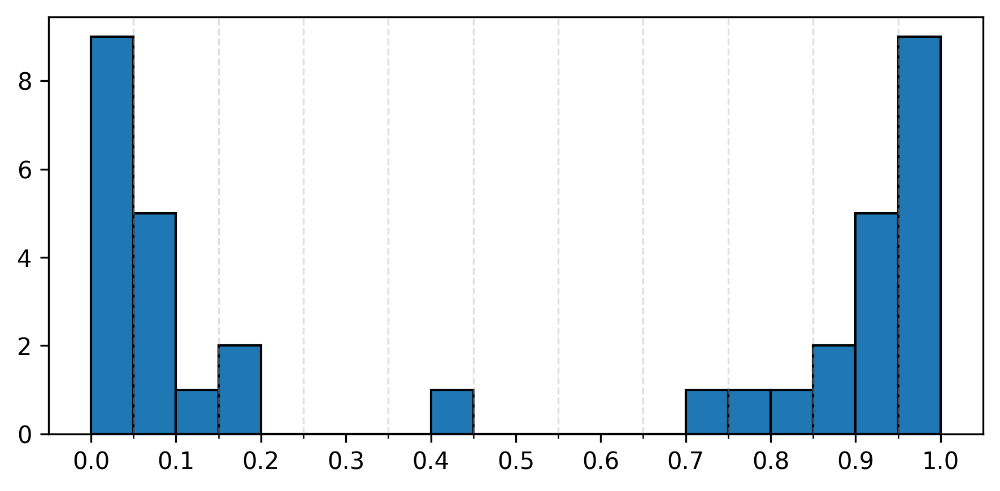

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Test Set Prediction (SVM)**

The histogram of predicted probabilities for the **SVM model** shows strong confidence, with most predictions clustered at **0** and **1**, indicating clear classifications. A small number of samples are near **0.4–0.5**, suggesting some uncertainty.

**Comparison with Random Forest and Logistic Regression**

- **SVM**: Achieved **high confidence** in predictions, with a majority of predictions being near **0** or **1**, resulting in clear classifications.
- **Random Forest**: Also showed strong performance with high confidence, but some predictions had less certainty compared to SVM, with probabilities more spread out.
- **Logistic Regression**: Had **lower confidence** in its predictions, as probabilities were more evenly distributed across the range, especially around **0.5**, reflecting uncertainty.

Overall, **SVM** demonstrates more decisive predictions compared to both **Random Forest** and **Logistic Regression**, suggesting better model confidence for **hypoxia vs normoxia** classification in this dataset.


#### Gene retrieval

In [ ]:
# train the model on all of the data
svc_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=np.int64(63), random_state=42)),
                ('scaler', StandardScaler()),
                ('svc', SVC(C=0.1, kernel='linear', random_state=42))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = svc_hcc.named_steps['svc'].coef_[0]

# undo the scaler
scaler = svc_hcc.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = svc_hcc.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = hcc.columns

# RANK GENES

# create series with (gene_name : weights)
w_hcc = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_hcc = w_hcc.sort_values(ascending=False)

# Most negatively driving genes
top_neg_hcc = w_hcc.sort_values()

In [ ]:
top_pos_hcc[:20]

ALDOA      0.000095
SLC2A1     0.000062
PGK1       0.000053
MT-ND4     0.000053
CD59       0.000048
SPP1       0.000042
P4HB       0.000042
CEACAM5    0.000041
LDHA       0.000040
SLC3A2     0.000039
PFKFB3     0.000039
MIF        0.000039
MIF-AS1    0.000038
HSP90B1    0.000038
ANGPTL4    0.000036
DDIT4      0.000035
BRD2       0.000034
POLR2A     0.000031
F3         0.000031
H1-0       0.000029
dtype: float64

**SVM Hypoxia Markers (MCF7)**

The top genes driving the **SVM decision boundary** are:

- **ALDOA**
- **SLC2A1**
- **PGK1**
- **MT-ND4**
- **CD59**
- **SPP1**
- **P4HB**
- **CEACAM5**
- **LDHA**

  
Literature Confirmation and overlapping with other classifiers:
- **ALDOA**, **PGK1**, and **LDHA** are well-established **hypoxia markers** in the literature, and also appeared in **Random Forest** and **Logistic Regression** models, confirming their role as consistent **hypoxia markers** across different classifiers.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/1561672942.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


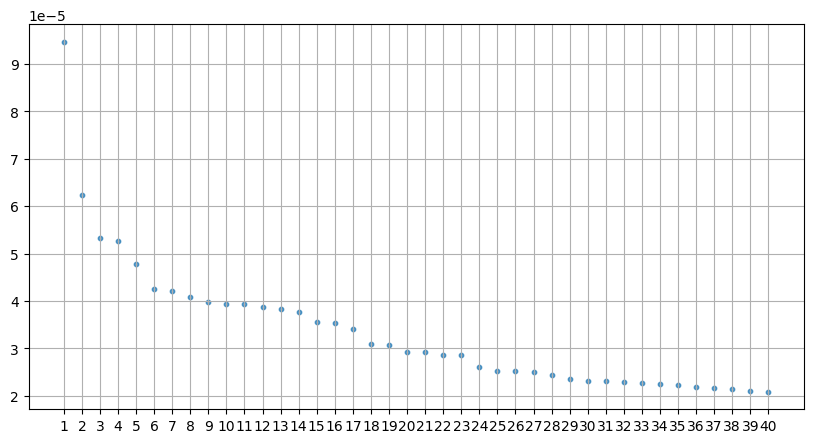

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_pos_hcc[:40].index, top_pos_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()


In [ ]:
top_neg_hcc[:20]

LDHB      -0.000065
PLAU      -0.000062
PSMD2     -0.000061
MMP1      -0.000061
B2M       -0.000060
KRT6A     -0.000058
CALM2     -0.000056
MT-CYB    -0.000052
LMNA      -0.000047
TXN       -0.000043
S100A16   -0.000040
ITGA6     -0.000039
CPA4      -0.000038
TUBA1B    -0.000038
SQSTM1    -0.000036
DUSP1     -0.000035
KRT18     -0.000034
FOS       -0.000033
ACTG1     -0.000032
TUBB      -0.000032
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/1901345960.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


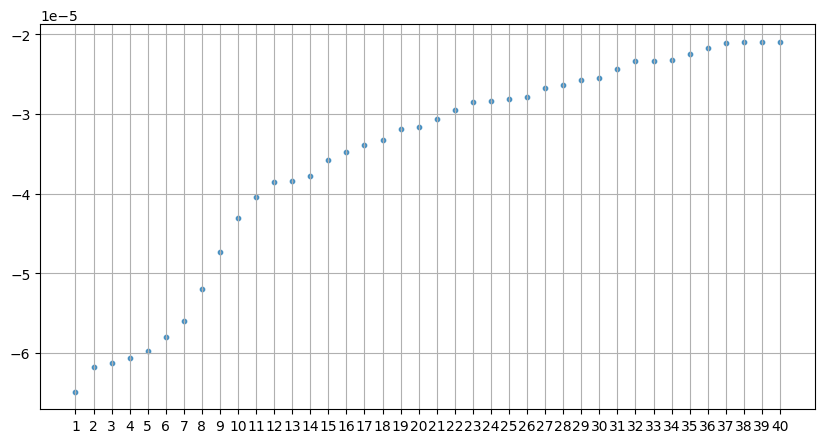

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_hcc[:40].index, top_neg_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

### MCF7

#### Fine tuning

In [ ]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


n_features = X_train_mcf7.shape[1]

approx_fold_samples = int(np.floor(X_train_mcf7.shape[0] * 2/3))
max_pc = min(n_features, approx_fold_samples)


pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('svc', SVC(kernel='linear', random_state=42))
])

param_grid = {
    'pca__n_components': np.arange(3, max_pc+1, step=2),
    'svc__C':     [0.1, 1, 10, 100, 1000]
}

grid = GridSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_mcf7, y_train_mcf7)

Fitting 3 folds for each of 330 candidates, totalling 990 fits
[CV] END ....................pca__n_components=3, svc__C=0.1; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=0.1; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=0.1; total time=   0.0s
[CV] END ......................pca__n_components=3, svc__C=1; total time=   0.0s
[CV] END ......................pca__n_components=3, svc__C=1; total time=   0.0s
[CV] END ......................pca__n_components=3, svc__C=1; total time=   0.0s
[CV] END .....................pca__n_components=3, svc__C=10; total time=   0.0s
[CV] END .....................pca__n_components=3, svc__C=10; total time=   0.0s
[CV] END .....................pca__n_components=3, svc__C=10; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=100; total time=   0.0s
[CV] END ....................pca__n_components=3, svc__C=100; total time=   0.0s
[CV] END ....................pca__n_components

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                       ('scaler', StandardScaler()),
                                       ('svc',
                                        SVC(kernel='linear',
                                            random_state=42))]),
             param_grid={'pca__n_components': array([  3,   5,   7,   9,  11,  13,  15,  17,  19,  21,  23,  25,  27,
        29,  31,  33,  35,  37,  39,  41,  43,  45,  47,  49,  51,  53,
        55,  57,  59,  61,  63,  65,  67,  69,  71,  73,  75,  77,  79,
        81,  83,  85,  87,  89,  91,  93,  95,  97,  99, 101, 103, 105,
       107, 109, 111, 113, 115, 117, 119, 121, 123, 125, 127, 129, 131,
       133]),
                         'svc__C': [0.1, 1, 10, 100, 1000]},
             scoring='accuracy', verbose=2)

In [ ]:
# an idea of the mean ccuracy
grid.best_score_

np.float64(1.0)

In [ ]:
# save the best model
svc_mcf7 = grid.best_estimator_


**SVM Results on MCF7**

The best pipeline found by **GridSearchCV** for the **SVM model** on the **MCF7 dataset** includes:

- **PCA**: **27 components**  
- **StandardScaler** for feature scaling  
- **SVC (Linear Kernel)**: **C = 0.1**, which enforces moderate regularization to avoid overfitting

**Best CV Score**: **1.0** (perfect accuracy on the training set)

**Interpretation:**
- The model achieved **perfect accuracy** on the training set with only **27 PCA components**, indicating that the **MCF7 dataset** has a clearer separation between classes, making it easier for the model to classify the data.
- The **C = 0.1** parameter suggests that the model fits the data with moderate regularization, balancing complexity and generalization.
- As seen in previous tests, the **MCF7 dataset** is easier to classify compared to **HCC**, likely due to more distinct patterns between hypoxia and normoxia, which the model can clearly separate with fewer components and regularization.


In [ ]:
#to avoid grid search
svc_mcf7 = Pipeline([
    ('pca', PCA(random_state=42, n_components = 27)),
    ('scaler', StandardScaler()),
    ('svc', SVC(kernel='linear', C= 0.1 ,random_state=42))
])


#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
svc_mcf7_mean_score = cross_val_score(svc_mcf7, X_train_mcf7, y_train_mcf7, cv=skf).mean()

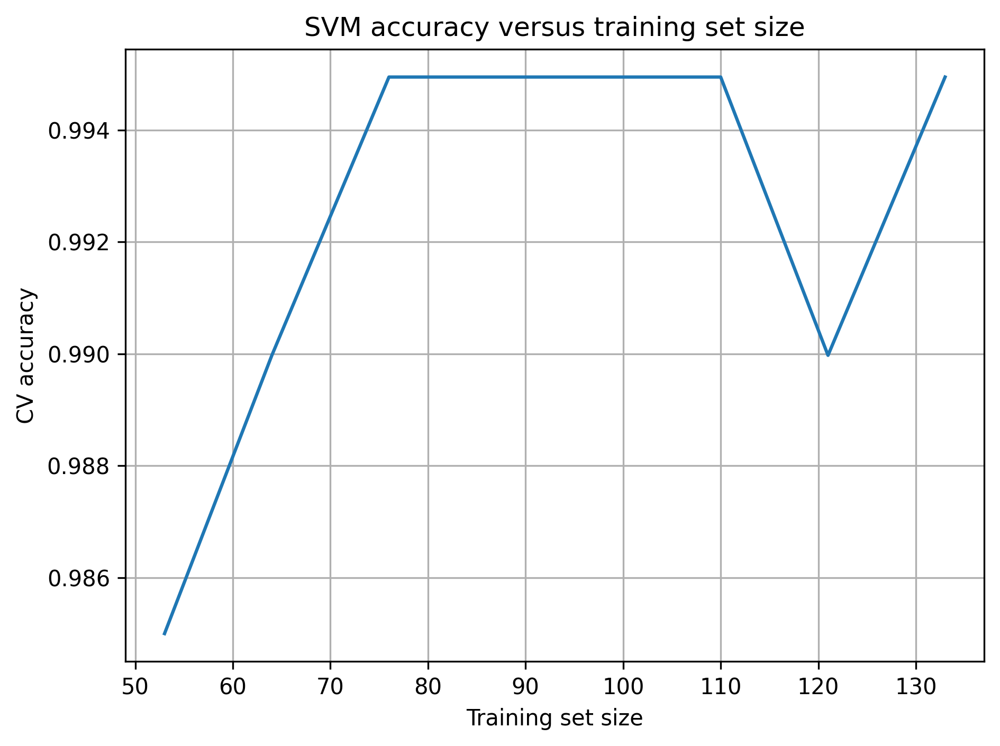

In [ ]:
# SINGLE LEARNING CURVE

from sklearn.model_selection import learning_curve
from sklearn.model_selection import cross_val_score

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.4, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    svc_mcf7, X_train_mcf7, y_train_mcf7,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("SVM accuracy versus training set size")
ax.grid()

fig.tight_layout()

**SVM Learning Curve on MCF7**

The learning curve shows that the **SVM model** performs well even with a small training set, reaching **high CV accuracy** (~0.994) after a few samples. The model quickly achieves strong performance and stabilizes.


#### Test predictions

In [ ]:
# fit on the whole training set

svc_mcf7.fit(X_train_mcf7, y_train_mcf7)

Pipeline(steps=[('pca', PCA(n_components=27, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc', SVC(C=0.1, kernel='linear', random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_mcf7 = svc_mcf7.predict(X_test_mcf7)


svc_mcf7_test_score = accuracy_score(y_test_mcf7, y_pred_mcf7)


print(f"Accuracy score for the 20% test set: {svc_mcf7_test_score}")

Accuracy score for the 20% test set: 1.0


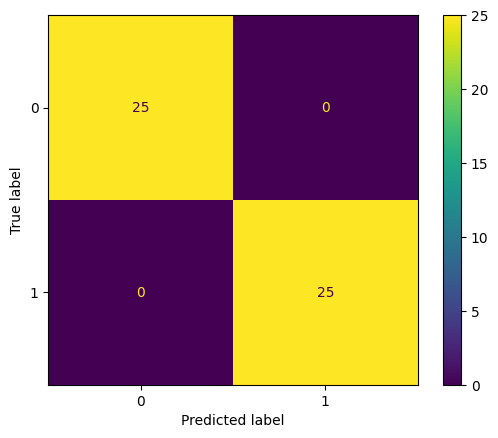

In [ ]:
#confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_mcf7, y_pred_mcf7)
plt.show()


#### Confidence analysis

In [ ]:
# calibrated probs

from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

pca = PCA(n_components=27)
X_test_mcf7_pca = pca.fit_transform(X_test_mcf7)

base = svc_mcf7

calib = CalibratedClassifierCV(
    estimator=base,
    method="sigmoid",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(X_train_mcf7, y_train_mcf7)

proba = calib.predict_proba(X_test_mcf7)[:, 1]   # P(y=1 | x)

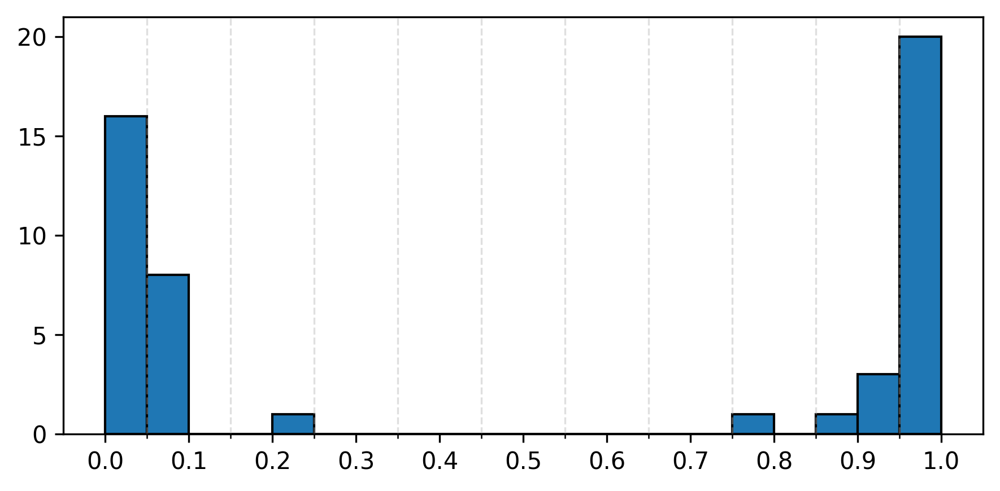

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Test Set Prediction for SVM**

The histogram of predicted probabilities for the **SVM model** shows high **confidence** in the predictions, with most probabilities either near **0** or **1**, indicating clear classifications:

- A **large peak at 1.0** signifies that the model is confident in labeling many samples correctly as **hypoxia**.
- A smaller peak around **0.0** indicates confidence in predicting **normoxia**.
- **Few samples** fall in between, indicating uncertainty.

Given the **1.0 accuracy** on the test set, the model is making near-perfect predictions with high confidence across the board. The clear separability between the classes further supports this conclusion, demonstrating that the model is effectively distinguishing hypoxia from normoxia in this dataset.


#### Gene retrieval



In [ ]:
# train the model on the whole dataset
svc_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=np.int64(27), random_state=42)),
                ('scaler', StandardScaler()),
                ('svc', SVC(C=0.1, kernel='linear', random_state=42))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = svc_mcf7.named_steps['svc'].coef_[0]

# undo the scaler
scaler = svc_mcf7.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = svc_mcf7.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = mcf7.columns

# RANK GENES

# create series with (gene_name : weights)
w_mcf7 = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_mcf7 = w_mcf7.sort_values(ascending=False)

# Most negatively driving genes
top_neg_mcf7 = w_mcf7.sort_values()

In [ ]:
top_pos_mcf7[:30]

PGK1       0.000072
TMSB10     0.000043
MT-ND4     0.000040
FLNA       0.000038
SLC7A5     0.000037
MALAT1     0.000035
DDIT4      0.000027
LDHA       0.000024
MLPH       0.000021
NEAT1      0.000018
MT-RNR2    0.000018
VEGFA      0.000017
AREG       0.000017
NCOA3      0.000016
SLC3A2     0.000016
DSP        0.000015
SLC2A1     0.000015
TRIB3      0.000014
NDRG1      0.000014
AARS1      0.000014
MYH9       0.000013
CDKN1A     0.000013
HK2        0.000013
SLC1A5     0.000013
CYP1B1     0.000012
TIMP3      0.000012
KRT80      0.000012
DNAJB1     0.000012
BAMBI      0.000011
XPOT       0.000010
dtype: float64

Positive Genes for MCF7 (SVM)

The top positively weighted genes (most influential for **hypoxia** prediction) in the **SVM model** are:

- **PGK1**  
- **TMSB10**  
- **MT-ND4**  
- **FLNA**  
- **SLC7A5**  
- **MALAT1**  
- **DDIT4**  
- **LDHA**

Overlap with Other Classifiers:
- **PGK1**, **DDIT4**, and **LDHA** also appeared in previous classifiers (Random Forest and Logistic Regression), confirming their consistent role in **hypoxia**.

  These genes help in distinguishing **hypoxia** from **normoxia**, and their importance is validated across different models and literature.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/2573315226.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


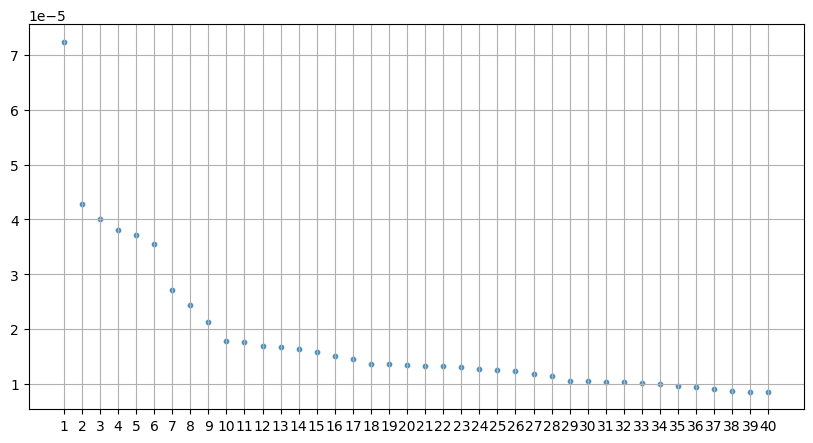

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_pos_mcf7[:40].index, top_pos_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()


In [ ]:
top_neg_mcf7[:30]

MT-CYB      -0.000044
MT-CO1      -0.000042
XBP1        -0.000031
MT-CO2      -0.000029
SLC39A6     -0.000025
SQSTM1      -0.000025
MT-CO3      -0.000022
TMSB4X      -0.000020
HSPB1       -0.000020
GATA3       -0.000018
COX6C       -0.000017
DDX5        -0.000016
GFRA1       -0.000015
CLDN4       -0.000014
MT-ATP6     -0.000013
SULF2       -0.000013
SLC9A3R1    -0.000012
DSCAM-AS1   -0.000010
EMP2        -0.000010
NFKBIA      -0.000009
MRNIP       -0.000009
DHCR7       -0.000009
TACSTD2     -0.000009
NR4A1       -0.000008
UGDH        -0.000008
STARD10     -0.000008
NME1-NME2   -0.000008
FBP1        -0.000007
UBC         -0.000007
UBB         -0.000007
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/443704784.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


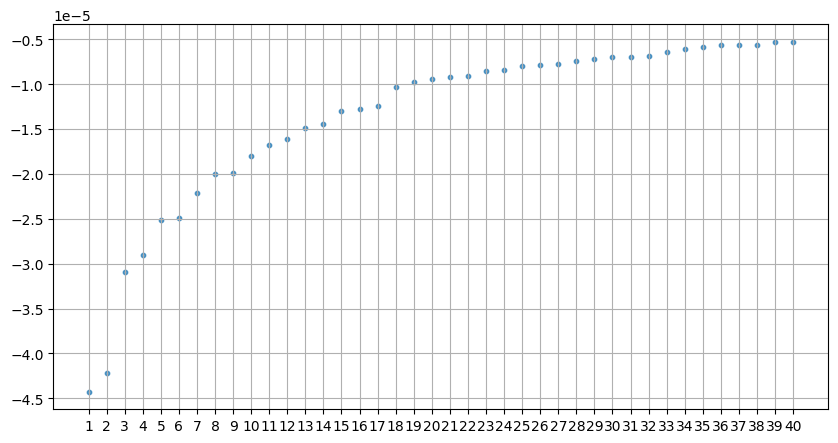

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_mcf7[:40].index, top_neg_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()


### Comparative summary

In [ ]:
summary_hcc = {
    "Random Forest": {"Mean Accuracy with CV 3" : rdf_hcc_mean_score,
                        "Score on frozen test set" : rdf_hcc_test_score,
                        "Confidence analysis": "Model shows moderate uncertainty, with predicted probabilities spread around 0.5 rather than clustering near 0 or 1, indicating only decent confidence."},
    "Logistic Regression": {"Mean Accuracy with CV 3" : log_hcc_mean_score,
                            "Score on frozen test set" : log_hcc_test_score,
                            "Confidence analysis" : "Despite correct labels, predicted probabilities mostly lie between 0.4 and 0.6, reflecting weak model confidence."},
    "Support Vector Machine": {"Mean Accuracy with CV 3" : svc_hcc_mean_score,
                               "Score on frozen test set" : svc_hcc_test_score,
                               "Confidence analysis" : "Model exhibits strong confidence with most probabilities at 0 or 1, though a few around 0.4–0.5 indicate minor uncertainty."}
}

table_hcc = pd.DataFrame(summary_hcc).T

from IPython.display import display

# tell the notebook browser to wrap long text in that column
styled = (
    table_hcc.style
    .set_caption("HCC Model Comparison")
    .set_properties(
        subset=['Confidence analysis'],
        **{
            'white-space': 'pre-wrap',
            'word-wrap':   'break-word',
            'max-width':   '300px',
            'text-align':  'left',
        }
    )
)

display(styled)


,Mean Accuracy with CV 3,Score on frozen test set,Confidence analysis
Random Forest,0.958475,1.000000,"Model shows moderate uncertainty, with predicted probabilities spread around 0.5 rather than clustering near 0 or 1, indicating only decent confidence."
Logistic Regression,0.958333,1.000000,"Despite correct labels, predicted probabilities mostly lie between 0.4 and 0.6, reflecting weak model confidence."
Support Vector Machine,0.979167,1.000000,"Model exhibits strong confidence with most probabilities at 0 or 1, though a few around 0.4–0.5 indicate minor uncertainty."


**Model Selection for HCC (SmartSeq)**

| Model                  | CV Accuracy | Test Accuracy | Confidence Profile                              |
|------------------------|------------:|--------------:|-------------------------------------------------|
| Random Forest          | 0.9585      | 1.0000        | Moderate confidence (probabilities spread around 0.5) |
| Logistic Regression    | 0.9583      | 1.0000        | Weak confidence (probabilities cluster 0.4–0.6)      |
| Support Vector Machine | 0.9792      | 1.0000        | Strong confidence (most probabilities at 0 or 1)    |

**Analysis**

- **Generalization (CV vs. Test):**  
  All three models achieve perfect test‐set accuracy, but the SVM outperforms both RF and LR in cross‐validated accuracy (0.979 vs. ~0.958), indicating better expected generalization on unseen data.

- **Prediction Confidence:**  
  - **LR** shows many borderline calls (0.4–0.6), making it the least reliable when quantified uncertainty matters.  
  - **RF** is better but still yields a fair number of mid‐range probabilities, suggesting occasional hesitation.  
  - **SVM** exhibits near-binary outputs (almost all probabilities at 0 or 1), meaning it’s by far the most decisive and confident classifier.

- **Bias–Variance Trade-off:**  
  The SVM’s higher CV score and sharply peaked probability distribution imply it strikes a good balance: it’s confident without over‐fitting (perfect test score) and handles the feature space reliably thanks to the PCA preprocessing.

---

**Conclusion:**  
**Support Vector Machine** is the clear choice for HCC on SmartSeq, offering the best cross‐validation performance and the most decisive, high‐confidence predictions.  


In [ ]:
summary_mcf7 = {
    "Random Forest": {"Mean Accuracy with CV 3" : rdf_mcf7_mean_score,
                        "Score on frozen test set" : rdf_mcf7_test_score,
                        "Confidence analysis": "Predictions cluster near 0 and 1, showing the model’s high confidence and strong performance."},
    "Logistic Regression": {"Mean Accuracy with CV 3" : log_mcf7_mean_score,
                            "Score on frozen test set" : log_mcf7_test_score,
                            "Confidence analysis" : "Predictions are almost all at 0 or 1 (with one at 0.9), indicating very high confidence and clear separation of hypoxia vs. normoxia on the MCF7 dataset."},
    "Support Vector Machine": {"Mean Accuracy with CV 3" : svc_mcf7_mean_score,
                               "Score on frozen test set" : svc_mcf7_test_score,
                               "Confidence analysis" : "High confidence: probabilities cluster at 1 (hypoxia) and 0 (normoxia) with few intermediates, indicating clear separability and minor uncertainty."}
}

table_mcf7 = pd.DataFrame(summary_mcf7).T

from IPython.display import display

# tell the notebook browser to wrap long text in that column
styled = (
    table_mcf7.style
    .set_caption("MCF7 Model Comparison")
    .set_properties(
        subset=['Confidence analysis'],
        **{
            'white-space': 'pre-wrap',
            'word-wrap':   'break-word',
            'max-width':   '300px',
            'text-align':  'left',
        }
    )
)

display(styled)


,Mean Accuracy with CV 3,Score on frozen test set,Confidence analysis
Random Forest,0.980024,1.000000,"Predictions cluster near 0 and 1, showing the model’s high confidence and strong performance."
Logistic Regression,0.970074,0.980000,"Predictions are almost all at 0 or 1 (with one at 0.9), indicating very high confidence and clear separation of hypoxia vs. normoxia on the MCF7 dataset."
Support Vector Machine,0.994949,1.000000,"High confidence: probabilities cluster at 1 (hypoxia) and 0 (normoxia) with few intermediates, indicating clear separability and minor uncertainty."


**Model Selection for MCF7 (SMARTSEQ)**

| Model                  | CV Accuracy | Test Accuracy | Confidence Profile                                                                              |
|------------------------|------------:|--------------:|-------------------------------------------------------------------------------------------------|
| Random Forest          | 0.9800      | 1.0000        | High confidence: predictions cluster at 0 and 1, showing strong separation and few intermediates.  |
| Logistic Regression    | 0.9701      | 0.9800        | Very high confidence: almost all probabilities at 0 or 1 (one at ~0.9), clear class separation. |
| Support Vector Machine | 0.9949      | 1.0000        | Very strong confidence: tight peaks at 0 and 1 with minimal mid-range values, minor uncertainty. |

**Analysis**

- **Generalization:** SVM leads in cross-validation (0.9949), indicating the best expected performance on unseen MCF7 data.  
- **Test-set performance:** Both RF and SVM reach perfect test accuracy, but LR falls slightly behind at 0.98.  
- **Prediction confidence:**  
  - **LR** is decisive but slightly less reliable (occasional <1.0 hypoxia calls and one misclassified sample).  
  - **RF** is confident overall but shows a small tail of moderate probabilities.  
  - **SVM** delivers the most binary-like outputs, with almost no ambiguity and the highest CV score.  

---

**Conclusion:**  
The **Support Vector Machine** is the top choice for MCF7 on DROPSEQ—offering the best cross-validation accuracy and the most confident, unambiguous predictions.  


### Final predictions on real test set

#### HCC

In [ ]:
# load the test set
hcc_test = pd.read_csv('/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_test_anonim.txt',
        delimiter=' ',
         engine='python'
          )

hcc_test = hcc_test.T

In [ ]:
# train the chosen model on the whole train set
svc_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=63, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc', SVC(C=0.1, kernel='linear', random_state=42))])

In [ ]:
# generate prediction array
hcc_smartseq_predictions = svc_hcc.predict(hcc_test)

In [ ]:
print(f"Test proportion: {np.sum(hcc_smartseq_predictions==1)/len(hcc_smartseq_predictions)}")

Test proportion: 0.4


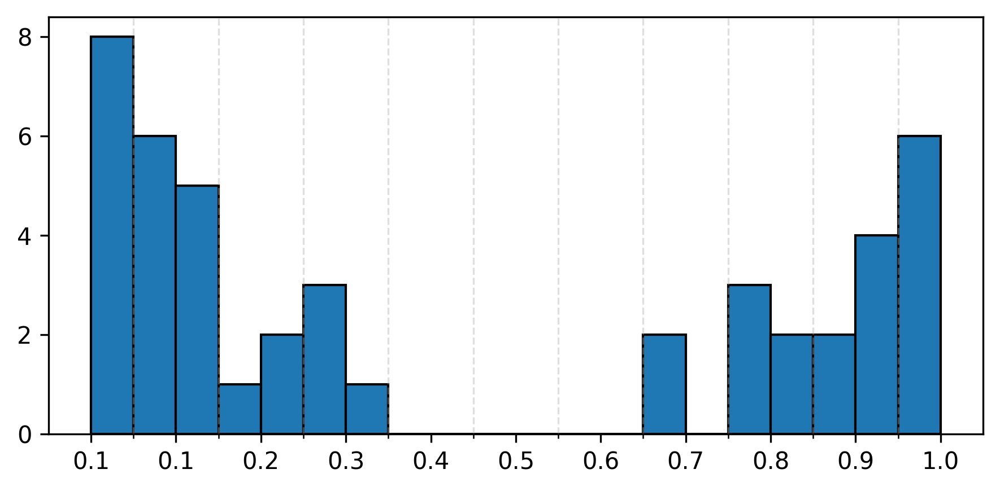

In [ ]:
# classification confidence
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

base = svc_hcc

calib = CalibratedClassifierCV(
    estimator=base,
    method="sigmoid",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(hcc, hcc_labels)

proba = calib.predict_proba(hcc_test)[:, 1]   # P(y=1 | x)

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Model Confidence Distribution**

- **Strong normoxia confidence:** A pronounced peak at ~0.1 (≈8 samples) shows many predictions firmly favor the negative class.  
- **High‐confidence hypoxia calls:** A secondary spike at 1.0 (≈6 samples) indicates several very confident positive predictions.  
- **Few ambiguous probabilities:** Sparse counts in the 0.2–0.3 and 0.7–0.9 bins reflect that genuinely uncertain calls are rare.  

In [ ]:
np.savetxt('hcc_smart_predictions.txt',                 # output filename
           hcc_smartseq_predictions,                           # the array to save
           delimiter='\t',              # use tab as separator
           fmt='%d'
          )

#### MCF7

In [ ]:
# load test set
mcf7_test = pd.read_csv('/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/SmartSeq/MCF7_SmartS_Filtered_Normalised_3000_Data_test_anonim.txt',
        delimiter=' ',
         engine='python'
          )

mcf7_test = mcf7_test.T

In [ ]:
# train the chosen model on the whole train set
svc_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=27, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc', SVC(C=0.1, kernel='linear', random_state=42))])

In [ ]:
# generate prediction array
mcf7_smartseq_predictions = svc_mcf7.predict(mcf7_test)

In [ ]:
print(f"Test proportion: {np.sum(mcf7_smartseq_predictions==1)/len(mcf7_smartseq_predictions)}")

Test proportion: 0.49206349206349204


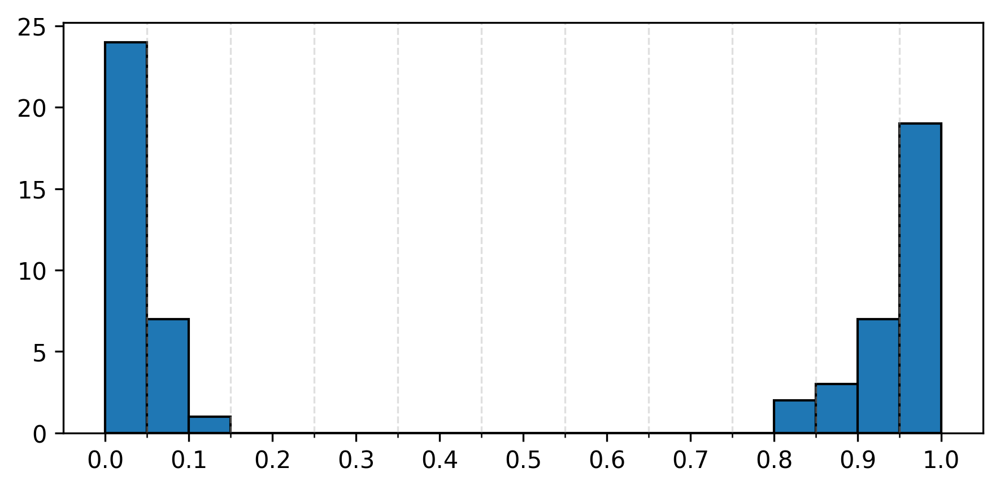

In [ ]:
# classification confidence
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

base = svc_mcf7

calib = CalibratedClassifierCV(
    estimator=base,
    method="sigmoid",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(mcf7, mcf7_labels)

proba = calib.predict_proba(mcf7_test)[:, 1]

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Model Confidence Distribution**

The histogram of predicted probabilities highlights how decisively the model classifies each sample:

- **Dominant extreme peaks:** A large spike at 0.0 (≈24 samples) and another at 1.0 (≈19 samples) show the model often makes near-certain calls for both classes.  
- **Asymmetric class confidence:** The normoxia peak at 0.0 slightly exceeds the hypoxia peak at 1.0, indicating marginally stronger confidence when predicting the negative class.  
- **Minimal ambiguity:** Very few predictions fall between ~0.1–0.2 or ~0.8–0.9, confirming that uncertain probabilities are rare.  









In [ ]:
np.savetxt('mcf7_smart_predictions.txt',                 # output filename
           mcf7_smartseq_predictions,                           # the array to save
           delimiter='\t',              # use tab as separator
           fmt='%d'
          )

# **DROPSEQ**

### Open data

In [ ]:
#open data
'''hcc = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/Project data/DropSeq/HCC1806_Filtered_Normalised_3000_Data_train.txt',
            delimiter=' ',
            engine='python'
            )'''
hcc = pd.read_csv('/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/DropSeq/HCC1806_Filtered_Normalised_3000_Data_train.txt',
            delimiter=' ',
            engine='python')

'''mcf7 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/Project data/DropSeq/MCF7_Filtered_Normalised_3000_Data_train.txt",
                 delimiter=" ",
                 engine='python',
                 index_col=0
                 )'''

mcf7 = pd.read_csv("/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/DropSeq/MCF7_Filtered_Normalised_3000_Data_train.txt",
                 delimiter=" ",
                 engine='python',
                 index_col=0)

hcc = hcc.T
mcf7 = mcf7.T

### Create dataset

In [ ]:
# HCC
def cell_tag(filename):
    counter = 1
    for char in filename:
        if char =='_':
             break
        counter += 1
    return filename[counter:(counter+4)]

hcc_labels = []
for name in hcc.index:
    if cell_tag(name) == 'Hypo':
        hcc_labels.append(1)
    else:
        hcc_labels.append(0)

hcc_labels = np.array(hcc_labels)

# split the dataset in 80% train and 20% test (using stratification on the labels array)
from sklearn.model_selection import train_test_split

X_train_hcc, X_test_hcc, y_train_hcc, y_test_hcc = train_test_split(
    hcc,
    hcc_labels,
    test_size=0.20,
    shuffle=True,
    stratify=hcc_labels,
    random_state=42
)



In [ ]:
#print shapes
print(f"Train HCC shape: {X_train_hcc.shape}")
print(f"Test HCC shape: {X_test_hcc.shape}")

Train HCC shape: (11745, 3000)
Test HCC shape: (2937, 3000)


In [ ]:
# sanity check of labels proportions

print(f"Train Hypoxia proportion : {np.sum(y_train_hcc==1)/len(y_train_hcc)}")
print(f"Test Hypoxia proportion: {np.sum(y_test_hcc == 1)/len(y_test_hcc)}")

Train Hypoxia proportion : 0.6061302681992338
Test Hypoxia proportion: 0.6060606060606061


In [ ]:
# MCF7
def cell_tag(filename):
    counter = 1
    for char in filename:
        if char =='_':
             break
        counter += 1
    return filename[counter:(counter+4)]

mcf7_labels = []
for name in mcf7.index:
    if cell_tag(name) == 'Hypo':
        mcf7_labels.append(1)
    else:
        mcf7_labels.append(0)

mcf7_labels = np.array(mcf7_labels)

# split the dataset in 80% train and 20% test (using stratification on the labels array)
from sklearn.model_selection import train_test_split

X_train_mcf7, X_test_mcf7, y_train_mcf7, y_test_mcf7 = train_test_split(
    mcf7,
    mcf7_labels,
    test_size=0.20,
    shuffle=True,
    stratify=mcf7_labels,
    random_state=42
)


In [ ]:
#print shapes
print(f"Train MCF7 shape: {X_train_mcf7.shape}")
print(f"Test MCF7 shape: {X_test_mcf7.shape}")

Train MCF7 shape: (17300, 3000)
Test MCF7 shape: (4326, 3000)


In [ ]:
# sanity check of labels proportions

print(f"Train Hypoxia proportion: {np.sum(y_train_mcf7==1)/len(y_train_mcf7)}")
print(f"Test  Hypoxia proportion: {np.sum(y_test_mcf7 == 1)/len(y_test_mcf7)}")

Train Hypoxia proportion: 0.412485549132948
Test  Hypoxia proportion: 0.41262135922330095


###**Datasets division**
**Main Differences Between Smartseq and Dropseq Datasets and between HCC and MCF7 Datasets in Dropseq**

One of the **main differences** between the Smartseq and Dropseq Datasets is their **size** and the distribution of labels, which impact model performance:

**HCC Datasets**:

**DROPSEQ**
  - Training samples: 11,745  
  - Test samples: 2,937  
  - Proportion of Hypoxia in Train Set: ~60.6%  
  - Proportion of Hypoxia in Test Set: ~60.6%

**SMARTSEQ**
  - Training samples: 145
  - Test samples: 37
  - Proportion of Hypoxia in Train Set: 53.1%
  - Proportion of Hypoxia in Test Set: 54.1%

**MCF7 Dataset**:

**DROPSEQ**
  - Training samples: 17,300  
  - Test samples: 4,326  
  - Proportion of Hypoxia in Train Set: ~41.4%  
  - Proportion of Hypoxia in Test Set: ~41.3%

**SMARTSEQ**
  - Training samples: 200
  - Test samples: 50
  - Proportion of Hypoxia in Train Set: 49.5%
  - Proportion of Hypoxia in Test Set: 50%







**Observation on Dataset Size Differences**

When comparing **SmartSeq** and **DropSeq** datasets, there is a clear difference in size:

- **DropSeq datasets** (both HCC and MCF7) are significantly larger, with thousands of samples for both training and testing, providing more data for model training and potentially more reliable results.
- **SmartSeq datasets**, on the other hand, are much smaller.

This size disparity may make **DropSeq** datasets easier to work with, offering more samples for better model generalization. **However**, with **DropSeq**'s large size, we cannot apply the same techniques used for **SmartSeq** to avoid **infinite run times**. We need to **reduce the number of parameters in grid searches** or **apply other methods** to manage computational load and prevent excessive processing times, as the larger dataset requires more intensive computation.


**Key Observations on Dropseq datasets**:
- The **HCC dataset** has a **higher proportion of hypoxic samples** in both the **train** and **test** sets, suggesting that the model might find it easier to classify since the hypoxic class is more prevalent.
- The **MCF7 dataset**, in contrast, has a **opposite class distribution**, with nearly **40%** hypoxic and **60% normoxic samples**

This difference in dataset structure impacts the models' learning process and classification accuracy, which we will explore next.

## PCA (explanation on choosing n components in grid search)

**Determining the Optimal Number of PCA Components for Grid Search**

To decide how many **PCA components** to use in the grid search, we first calculate the **cumulative explained variance**. This graph helps us determine the smallest number of components that capture a sufficient amount of the total variance in the dataset.

We plot the **cumulative explained variance** against the number of principal components on the x-axis.

By visualizing the curve, we can select the number of components that give us a good balance between dimensionality reduction and preserving sufficient information for the model. Typically, we aim to capture **90-95% of the variance** while reducing the number of components to avoid unnecessary complexity in the grid search.

This allows us to perform a more efficient grid search by testing only the necessary number of components, rather than unnecessarily expanding the search space.

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=None, random_state=42)
pca.fit(X_train_hcc)   # X is your (n_samples × n_features) array, unscaled
evr    = pca.explained_variance_ratio_   # vector of length = n_features (or rank of X)
cumvar = evr.cumsum()                    # cumulative explained‐variance

Cumulative variance graph on `X_train_hcc` to figure out the optimal parameters for the gridsearch

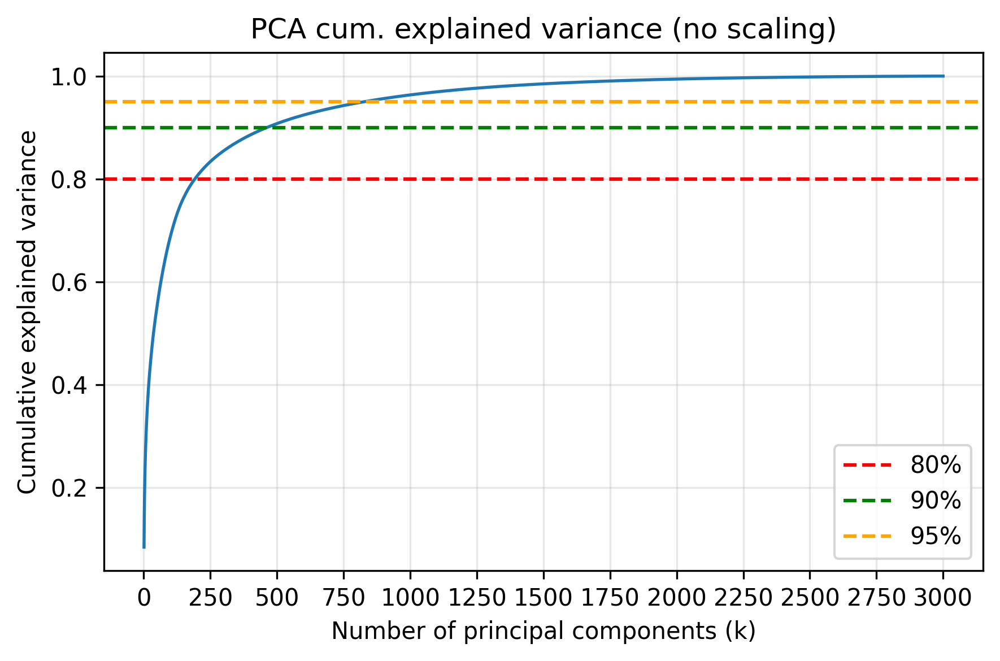

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

ks     = np.arange(1, len(evr) + 1)
cumvar = evr.cumsum()

fig, ax = plt.subplots(figsize=(6,4))

fig.set_dpi(300)

ax.plot(ks, cumvar, lw=1.3)
ax.set_xlabel("Number of principal components (k)")
ax.set_ylabel("Cumulative explained variance")
ax.set_title("PCA cum. explained variance (no scaling)")

ax.set_xticks(np.arange(0, 3250, step=250))

# Draw horizontal lines at common thresholds:
for thr, col in [(0.80, "red"), (0.90, "green"), (0.95, "orange")]:
    ax.axhline(thr, color=col, ls="--", label=f"{int(thr*100)}%")
ax.legend(loc="lower right")
ax.grid(alpha=0.3)

fig.tight_layout()


In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=None, random_state=42)
pca.fit(X_train_mcf7)   # X is your (n_samples × n_features) array, unscaled
evr    = pca.explained_variance_ratio_   # vector of length = n_features (or rank of X)
cumvar = evr.cumsum()                    # cumulative explained‐variance

Cumulative explained variance on `X_train_mcf7` to understand what pca parameters to grid search on

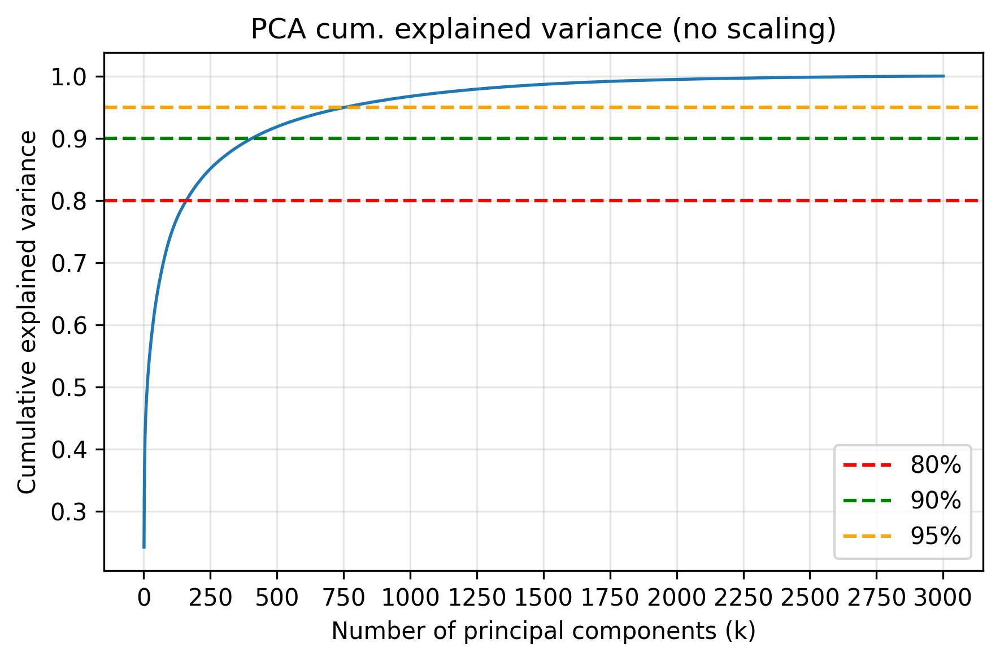

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

ks     = np.arange(1, len(evr) + 1)
cumvar = evr.cumsum()

fig, ax = plt.subplots(figsize=(6,4))

fig.set_dpi(300)

ax.plot(ks, cumvar, lw=1.3)
ax.set_xlabel("Number of principal components (k)")
ax.set_ylabel("Cumulative explained variance")
ax.set_title("PCA cum. explained variance (no scaling)")

ax.set_xticks(np.arange(0, 3250, step=250))

# Draw horizontal lines at common thresholds:
for thr, col in [(0.80, "red"), (0.90, "green"), (0.95, "orange")]:
    ax.axhline(thr, color=col, ls="--", label=f"{int(thr*100)}%")
ax.legend(loc="lower right")
ax.grid(alpha=0.3)

fig.tight_layout()

**Selecting PCA Components for Grid Search**

The cumulative variance graph for both the **HCC** and **MCF7** datasets reveals that we reach approximately **80%**, **90%**, and **95%** of the total variance at **around 250**, **500**, and **750** components, respectively.

Based on this observation, we conclude that testing **250**, **500**, and **750** components in the grid searches will provide a good balance between dimensionality reduction and retaining enough variance for the model to perform optimally. This allows us to limit the number of components in our grid search while ensuring that we capture sufficient information from the data for accurate model training.



## Randomized Grid Search for DropSeq (Same Parameters as SmartSeq)

We use the same set of parameters for the **Three classification** models as we did for **SmartSeq**. However, due to the **larger dataset** in **DropSeq**, running a full **GridSearchCV** would lead to excessive run times, so we switch to **RandomizedSearchCV** for more efficient hyperparameter tuning.

*What is **RandomizedSearchCV**?*

Unlike **GridSearchCV**, which exhaustively tests every possible combination of parameters, **RandomizedSearchCV** performs a random search over the specified parameter grid. It randomly selects combinations of parameters and evaluates them, often leading to a good result with much **lower computational cost**.

- This technique is especially helpful when the grid is large, and we want to save time without testing every possible combination.
- **RandomizedSearchCV** only tests a **random subset of combinations**, making it much faster, but still likely to find an optimal or quasi-optimal set of parameters.

By using **RandomizedSearchCV**, we can efficiently explore the parameter space while avoiding excessively long run times, even with the large **DropSeq** datasets.

## RANDOM FOREST

### **HCC**


#### Fine tuning


In [ ]:
# GRID SEARCH HEAVY CELL

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(random_state=42))
])

param_grid = {
    'pca__n_components': [250, 500, 750],
    'rnd__min_samples_leaf': [1, 2, 4],
    'rnd__bootstrap' : [True, False],
    'rnd__max_features': ["sqrt", "log2"]
}

grid = RandomizedSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2, random_state=42)

grid.fit(X_train_hcc, y_train_hcc)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END pca__n_components=750, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=  11.4s
[CV] END pca__n_components=750, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=  11.3s
[CV] END pca__n_components=750, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=15.5min
[CV] END pca__n_components=500, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=  13.6s
[CV] END pca__n_components=500, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=  14.1s
[CV] END pca__n_components=500, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=  13.9s
[CV] END pca__n_components=750, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; total time=  16.2s
[CV] END pca__n_components=750, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_sam

RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                             ('scaler', StandardScaler()),
                                             ('rnd',
                                              RandomForestClassifier(random_state=42))]),
                   param_distributions={'pca__n_components': [250, 500, 750],
                                        'rnd__bootstrap': [True, False],
                                        'rnd__max_features': ['sqrt', 'log2'],
                                        'rnd__min_samples_leaf': [1, 2, 4]},
                   random_state=42, scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.884120902511707)

In [ ]:
rdf_hcc = grid.best_estimator_

**Randomized Grid Search Results for HCC (Random Forest)**

The first *RandomizedSearchCV* for the *HCC dataset* yielded the following best pipeline:

- **PCA**: **250** components
- **RandomForestClassifier**:  
  - **bootstrap=False**  
  - **min_samples_leaf=4**

**Best Score:**
- CV Score: **0.8841** (Accuracy)

Interpretation:

- *Random Forest* parameters suggest that the model benefits from *no bootstrap sampling* and a minimum of *4 samples per leaf*, which helps to avoid overfitting.
- With a CV score of 0.8841, this model shows solid performance, suggesting that the **Hyperparameter search** effectively identified parameters that balance bias and variance.


In [ ]:
# TO AVOID GRID SEARCH: SAVE THE PARAMETERS

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


rdf_hcc = Pipeline([
    ('pca', PCA(n_components=250)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(random_state= 42, bootstrap=False, min_samples_leaf=4))
])



In [ ]:
# plot the performance as we vary n_estimators

from sklearn.model_selection import cross_val_score

n_estimators = [200, 400, 600, 800]

mean_scores = []

for n in n_estimators:

    rf = Pipeline([
    ('pca', PCA(n_components=250, random_state=42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(n_estimators= n, bootstrap=False, min_samples_leaf=4, random_state=42))

    ])

    scores = cross_val_score(rf, X_train_hcc, y_train_hcc, cv=3, scoring='accuracy', n_jobs=-1)

    mean_scores.append(scores.mean())


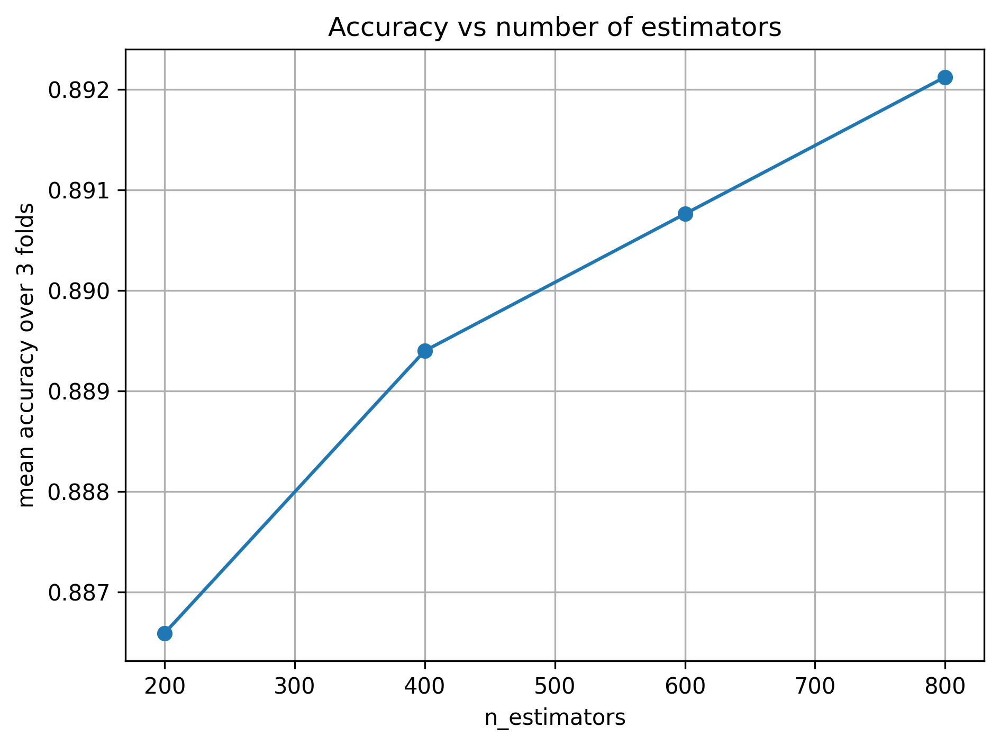

In [ ]:
fig, ax = plt.subplots()
ax.plot(n_estimators, mean_scores, marker = 'o')

ax.set_title('Accuracy vs number of estimators')
ax.set_xlabel('n_estimators')
ax.set_ylabel('mean accuracy over 3 folds')

fig.set_dpi(300)
ax.grid()

fig.tight_layout()

**Random Forest Learning Curve for HCC**

The learning curve shows that as we increase the number of estimators, the model's accuracy improves. From 200 to 400 estimators, there is a noticeable increase in accuracy, which then increases with slighter improvements.

We select **400 estimators** for the final model, as this provides a good balance between performance and computational efficiency.

In [ ]:
# NOTE: this is the final classifier

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


rdf_hcc = Pipeline([
    ('pca', PCA(n_components=250)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(bootstrap=False, min_samples_leaf=4, n_estimators=400, random_state=42))
])


#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
rdf_hcc_mean_score = cross_val_score(rdf_hcc, X_train_hcc, y_train_hcc, cv=skf).mean()

In [ ]:
rdf_hcc_mean_score

np.float64(0.890251170710941)

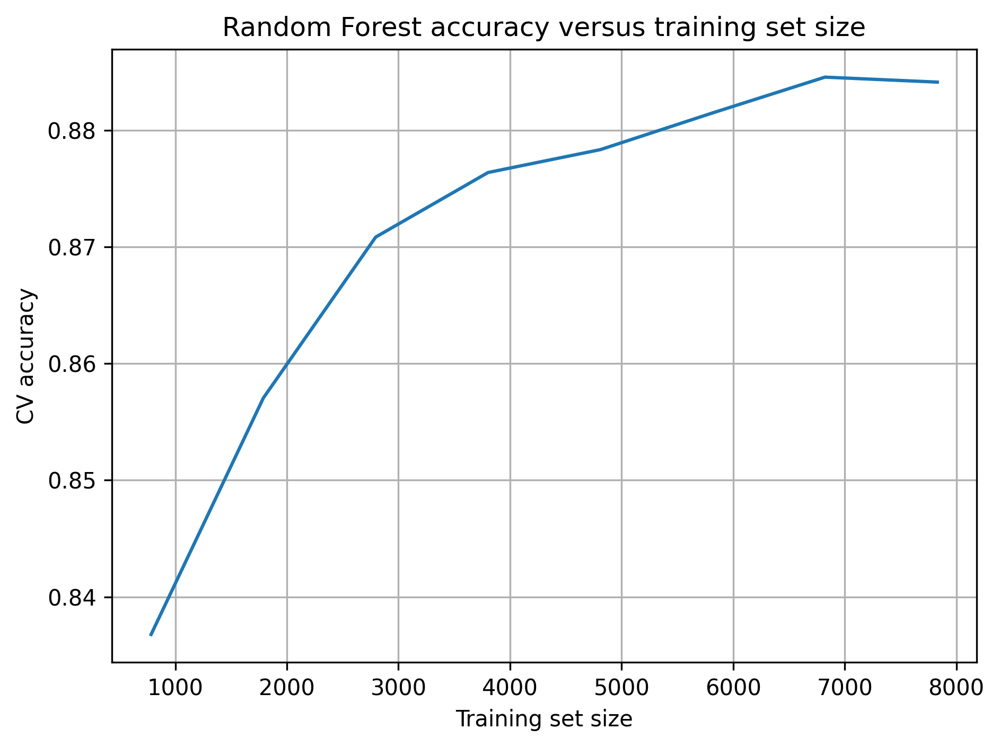

In [ ]:
from sklearn.model_selection import learning_curve

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.1, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    rdf_hcc, X_train_hcc, y_train_hcc,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Random Forest accuracy versus training set size")
ax.grid()

fig.tight_layout()

**Random Forest Learning Curve – Training Set Size**

The learning curve shows how **Random Forest** performance improves as we increase the **size of the training set**.

- As we add more training samples, the model’s **CV accuracy** steadily increases.
- The graph indicates that the model starts to stabilize after reaching a training set size of around **3,000 samples, with accuracy nearing 0.88**.

This shows that *Random Forest* benefits from larger datasets, and the model continues to improve as it learns from more data, reaching a more reliable performance with a larger number of training samples.

#### Test predictions

In [ ]:
rdf_hcc.fit(X_train_hcc, y_train_hcc)

Pipeline(steps=[('pca', PCA(n_components=250)), ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(bootstrap=False, min_samples_leaf=4,
                                        n_estimators=400, random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_hcc = rdf_hcc.predict(X_test_hcc)

rdf_hcc_test_score = accuracy_score(y_test_hcc, y_pred_hcc)

print(f"Accuracy score for the 20% test set: {rdf_hcc_test_score}")

Accuracy score for the 20% test set: 0.898876404494382


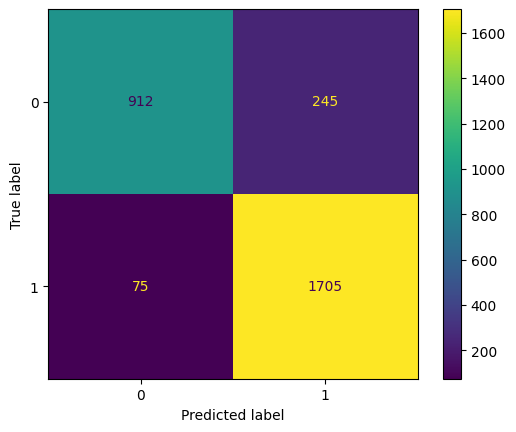

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_hcc, y_pred_hcc)
plt.show()

**Prediction and Confusion Matrix for HCC Test set**

The **random forest model** achieved an accuracy score of **89.89%** on the **20% test set**. The confusion matrix reveals:


Observations:
- The model has a relatively **high number of false positives** (232). This could be because the HCC dataset has a higher proportion of **hypoxic samples** (~60%), meaning the model is more biased towards predicting hypoxia due to the class imbalance in the training data.

While the overall **accuracy** is good, the **class imbalance** in HCC might cause this behavior.

### Confidence analysis

In [ ]:
probs = rdf_hcc.predict_proba(X_test_hcc)[:, 1]



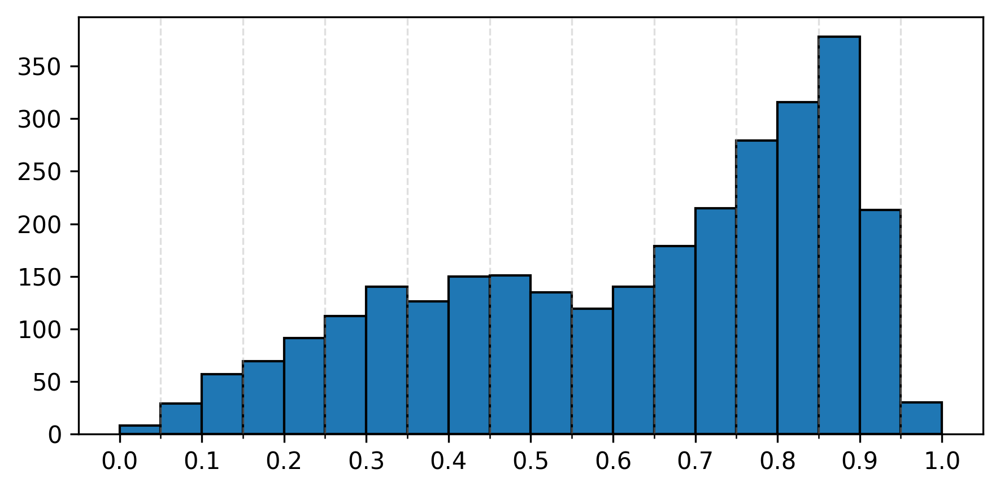

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Test Set Probabilities and Model Confidence**

The histogram of predicted probabilities reveals a strong bias toward high-confidence hypoxia calls:

- **Right-skewed distribution:** Counts climb from low to high probabilities, peaking around 0.8–0.9.  
- **Almost no high-confidence normoxia votes:** Very few samples appear in the 0.0–0.1 bin, indicating the model rarely predicts normoxia with strong confidence. This is expected since HCC has a higher proportion of hypoxia samples (~60%), making it easier for the model to predict hypoxia
- **Limited absolute certainties:** A small bar at exactly 1.0 shows only a handful of cases where the model is completely certain.  


### Gene retrieval



In [ ]:
# fit on the whole dataset
rdf_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=250, random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(bootstrap=False, min_samples_leaf=4,
                                        random_state=42))])

In [ ]:
# feature importances series

importances = rdf_hcc['rnd'].feature_importances_
pcs = [f'PC_{i}' for i in range(1, 251)]
forest_importances = pd.Series(importances, index=pcs)

# porquery: apply loading vector technique
# coef = importances

pca = rdf_hcc.named_steps['pca']
abs_pca_components = np.abs(pca.components_)

gene_weights = abs_pca_components.T.dot(importances)

genes = hcc.columns

gene_importances_hcc = pd.Series(gene_weights, index=genes)

gene_importances_sorted_hcc = gene_importances_hcc.sort_values(ascending=False)

In [ ]:
gene_importances_sorted_hcc[:30]

FTL         0.116619
HSP90AA1    0.109902
HSP90AB1    0.093919
RPL41       0.081181
RPS28       0.079782
BCYRN1      0.078971
NCL         0.071729
HSP90B1     0.068772
AKR1C2      0.062244
HSPD1       0.062040
MALAT1      0.061961
CALR        0.058979
H1-5        0.056532
IGFBP3      0.054276
RPS5        0.053828
LDHA        0.051084
H4C3        0.050803
HSPA5       0.050769
ENO1        0.048873
H1-3        0.048352
FGF23       0.047043
HNRNPU      0.045609
RPLP1       0.045313
RPS27       0.044642
NDRG1       0.043995
CALM2       0.043318
GPM6A       0.043054
WDR43       0.043019
TMSB10      0.041797
RPLP2       0.041213
dtype: float64

Hypoxia Markers (Confirmed by Literature):
- LDHA
- FTL
- DDIT4
- ALDOA

Overlap with Previous Models:
- LDHA and DDIT4 have been identified as significant markers for hypoxia in previous models.
- FTL also appears in the Random Forest model, aligning with prior knowledge of its role under hypoxic conditions.

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/1019189768.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,41)])


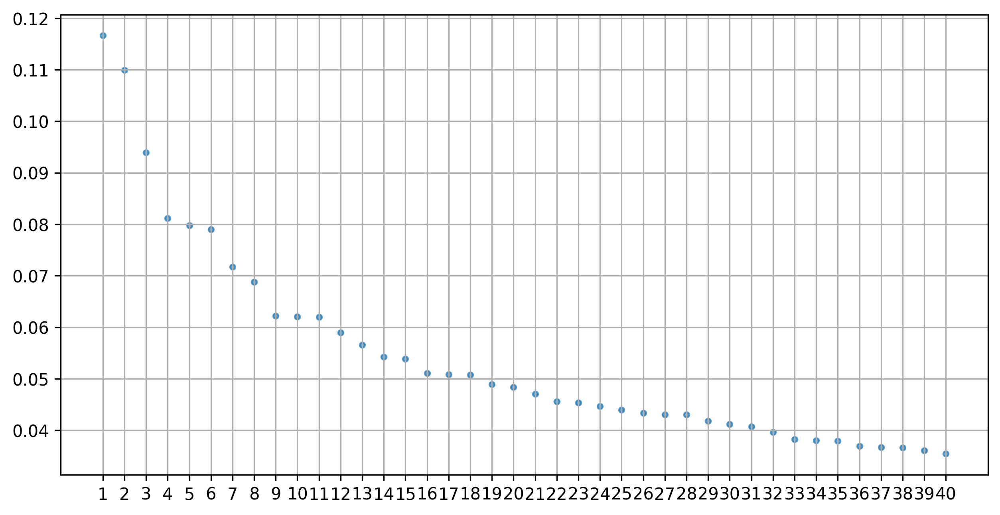

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

fig.set_dpi(300)


ax.scatter(gene_importances_sorted_hcc[:40].index, gene_importances_sorted_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,41)])
ax.grid()

### **MCF7**


#### Fine tuning


In [ ]:
# HEAVY CELL

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

pipe = Pipeline([
    ('pca', PCA(random_state = 42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(random_state=42))
])

param_grid = {
    'pca__n_components': [250, 500, 750],
    'rnd__min_samples_leaf': [1, 2, 4],
    'rnd__bootstrap' : [True, False],
    'rnd__max_features': ["sqrt", "log2"]
}

grid = RandomizedSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2, random_state=42)

grid.fit(X_train_mcf7, y_train_mcf7)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END pca__n_components=750, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=  17.7s
[CV] END pca__n_components=750, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=15.7min
[CV] END pca__n_components=750, rnd__bootstrap=False, rnd__max_features=log2, rnd__min_samples_leaf=4; total time=  17.7s
[CV] END pca__n_components=500, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=  23.4s
[CV] END pca__n_components=500, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=  23.7s
[CV] END pca__n_components=500, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=2; total time=  23.3s
[CV] END pca__n_components=750, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_samples_leaf=4; total time=  27.6s
[CV] END pca__n_components=750, rnd__bootstrap=True, rnd__max_features=sqrt, rnd__min_sam

RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('pca', PCA()),
                                             ('scaler', StandardScaler()),
                                             ('rnd',
                                              RandomForestClassifier())]),
                   param_distributions={'pca__n_components': [250, 500, 750],
                                        'rnd__bootstrap': [True, False],
                                        'rnd__max_features': ['sqrt', 'log2'],
                                        'rnd__min_samples_leaf': [1, 2, 4]},
                   random_state=42, scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.9425432954128011)

In [ ]:
rdf_mcf7 = grid.best_estimator_

**Random Forest Model – MCF7 Dataset**

The *RandomizedSearchCV* for the *MCF7 dataset* with *Random Forest* achieved the following result:

- Best Score: **0.9425** (Accuracy)

The model parameters are the same as those used for **HCC** (PCA components = 250; bootstrap = False; min_samples_leaf = 4), but MCF7 achieved a better overall accuracy. This confirms the trend observed in SmartSeq, where **MCF7** appears to be easier to predict compared to HCC.

In [ ]:
# TO AVOID GRID SEARCH: SAVE THE PARAMETERS

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


rdf_mcf7 = Pipeline([
    ('pca', PCA(n_components=250, random_state = 42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(bootstrap=False, min_samples_leaf=4, random_state = 42))
])



In [ ]:
# plot the performance as we vary n_estimators

from sklearn.model_selection import cross_val_score

n_estimators = [200, 400, 600, 800]

mean_scores = []

for n in n_estimators:

    rf = Pipeline([
    ('pca', PCA(n_components=250)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(n_estimators= n, bootstrap=False, random_state = 42, min_samples_leaf=4))
    ])

    scores = cross_val_score(rf, X_train_mcf7, y_train_mcf7, cv=3, scoring='accuracy', n_jobs=-1)

    mean_scores.append(scores.mean())


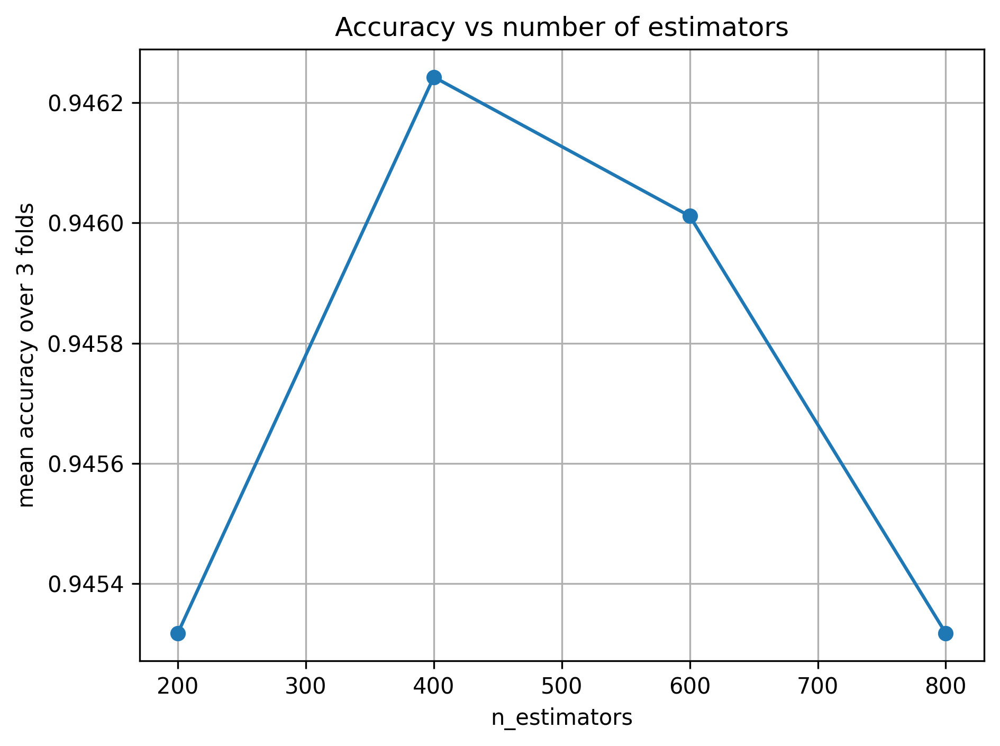

In [ ]:
fig, ax = plt.subplots()
ax.plot(n_estimators, mean_scores, marker = 'o')

ax.set_title('Accuracy vs number of estimators')
ax.set_xlabel('n_estimators')
ax.set_ylabel('mean accuracy over 3 folds')

fig.set_dpi(300)
ax.grid()

fig.tight_layout()

**Random Forest number of estimators for MCF7**

The learning curve shows that accuracy increases from 200 to 400 estimators, but after that, the value **doesn't change much** from 400 to 800. Given that the performance plateaus, we choose **400 estimators** as the optimal value for efficiency, even though the accuracy remains quite stable across all values.


In [ ]:
#final classifier

rdf_mcf7 = Pipeline([
    ('pca', PCA(n_components=250, random_state = 42)),
    ('scaler', StandardScaler()),
    ('rnd', RandomForestClassifier(bootstrap=False, n_estimators=400, min_samples_leaf=4, random_state = 42))
])

#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
rdf_mcf7_mean_score = cross_val_score(rdf_mcf7, X_train_mcf7, y_train_mcf7, cv=skf).mean()

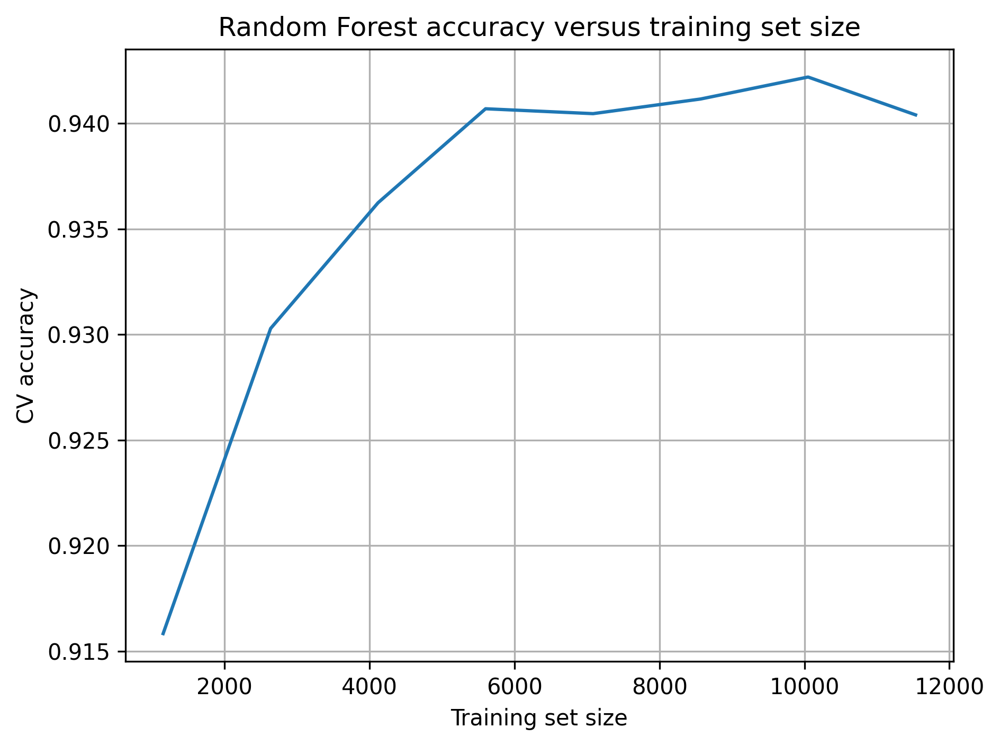

In [ ]:
#learning curve
from sklearn.model_selection import learning_curve
fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.1, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    rdf_mcf7, X_train_mcf7, y_train_mcf7,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Random Forest accuracy versus training set size")
ax.grid()

fig.tight_layout()

**Random Forest Learning Curve for MCF7**

The learning curve shows that **CV accuracy increases** with the size of the training set, reaching a peak around 10,000 samples. After that, the accuracy **plateaus**, indicating that adding more data doesn't significantly improve the model's performance.

#### Test predictions

In [ ]:
rdf_mcf7.fit(X_train_mcf7, y_train_mcf7)

Pipeline(steps=[('pca', PCA(n_components=250, random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(bootstrap=False, min_samples_leaf=4,
                                        n_estimators=400, random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_mcf7 = rdf_mcf7.predict(X_test_mcf7)

rdf_mcf7_test_score = accuracy_score(y_test_mcf7, y_pred_mcf7)

print(f"Accuracy score for the 20% test set: {rdf_mcf7_test_score}")

Accuracy score for the 20% test set: 0.9484512251502543


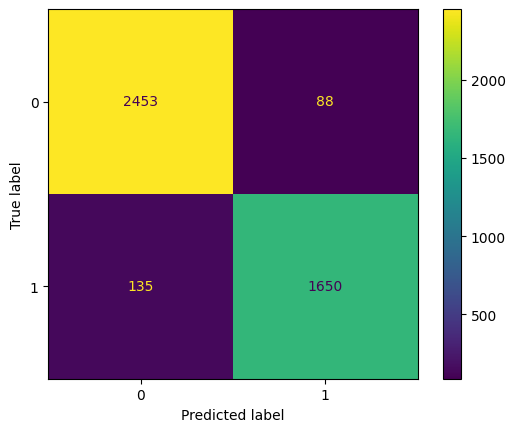

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_mcf7, y_pred_mcf7)
plt.show()

**Test Predictions for MCF7 – Random Forest Model**

The model achieved an *accuracy of 94.84%* on the *MCF7 test set.

The confusion matrix highlights that the model has **more false negatives** compared to false positives. This is due to the **class imbalance** in the training set, where **40%** of the samples are hypoxic and **60%** are **normoxic**. The model's tendency to misclassify hypoxic samples as *normoxic* is expected in this scenario.

This performance is **better** than HCC, consistent with the trend observed in **SmartSeq**, where MCF7 exhibited **higher accuracies** compared to HCC.

#### Confidence analysis

In [ ]:
probs = rdf_mcf7.predict_proba(X_test_mcf7)[:, 1]
probs = np.sort(probs)[::-1]


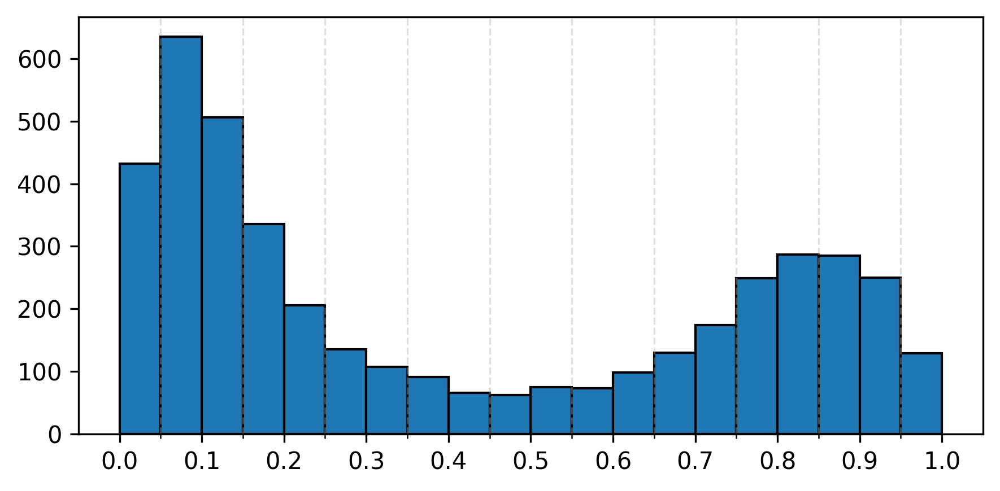

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Probability Distribution for Random Forest Predictions – MCF7**

The histogram illustrates the *probability distribution* for the MCF7 test set predictions. The distribution is skewed, with a significant concentration of predictions at 0 (normoxia) and 1 (hypoxia). This indicates that the model is relatively confident in its predictions, though the distribution remains somewhat imbalanced due to the dataset's class distribution.

While the distribution suggests decent model performance, it does not indicate exceptionally strong predictive certainty across all samples.

#### Gene retrieval



In [ ]:
# fit on the whole dataset
rdf_hcc.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=250, random_state=42)),
                ('scaler', StandardScaler()),
                ('rnd',
                 RandomForestClassifier(bootstrap=False, min_samples_leaf=4,
                                        random_state=42))])

In [ ]:
# feature importances series

importances = rdf_mcf7['rnd'].feature_importances_
pcs = [f'PC_{i}' for i in range(1, 251)]
forest_importances = pd.Series(importances, index=pcs)

# porquery: apply loading vector technique
# coef = importances

pca = rdf_mcf7.named_steps['pca']
abs_pca_components = np.abs(pca.components_)

gene_weights = abs_pca_components.T.dot(importances)

genes = mcf7.columns

gene_importances_mcf7 = pd.Series(gene_weights, index=genes)

gene_importances_sorted_mcf7 = gene_importances_mcf7.sort_values(ascending=False)

In [ ]:
gene_importances_sorted_mcf7[:30]

BCYRN1     0.248786
MALAT1     0.178005
TFF1       0.171818
RPS19      0.134452
H4C3       0.097719
MT-RNR2    0.079665
RPL13      0.070673
RPS14      0.066778
RPL35      0.065494
TMSB10     0.061785
RPL12      0.059365
RPS12      0.055961
KRT19      0.055543
RPLP1      0.051402
RPS5       0.050317
RPL15      0.047975
H1-5       0.047572
RPL34      0.046182
RPL35A     0.046003
RPS27      0.045750
HSPB1      0.044800
RPLP2      0.044499
S100A10    0.044411
RPS28      0.044233
KRT8       0.044173
RPL39      0.043941
LGALS1     0.043733
UQCRQ      0.043232
KRT18      0.043143
SERF2      0.040955
dtype: float64

**Gene Importance for MCF7 – Random Forest Model**

These are the most important genes according to the Random Forest model for the *MCF7 dataset*.

Among these genes, **MALAT1** is a well-established **hypoxia marker**.

There is **no significant overlap** with genes found in the previous classifiers, such as those identified for *HCC. MALAT1 is the only gene in this list that aligns with previously identified.

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/3058396566.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,41)])


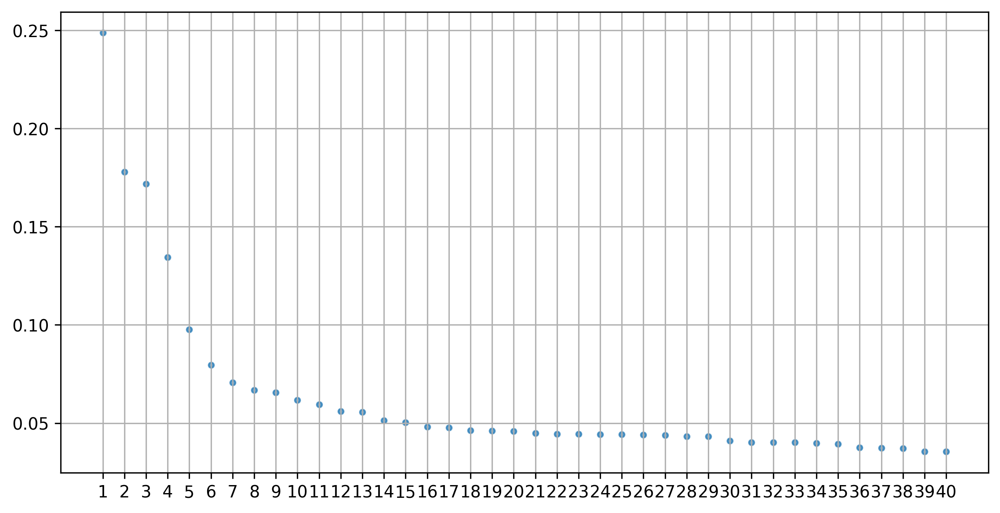

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

fig.set_dpi(300)


ax.scatter(gene_importances_sorted_mcf7[:40].index, gene_importances_sorted_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,41)])
ax.grid()

## LOGISTIC REGRESSION

### **HCC**


#### Fine tuning


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


pipe = Pipeline([
    ('pca', PCA()),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, solver='liblinear'))
])

param_grid = [
    {
    'scaler': [StandardScaler()],
    'pca__n_components': [250, 500, 750],
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l2', None],
    'log_reg__solver': ['lbfgs','newton-cg','sag']},

    {'scaler': [StandardScaler()],
    'pca__n_components': [250, 500, 750],
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l1', 'l2'],
    'log_reg__solver': ['liblinear', 'saga']},

    {'scaler': [StandardScaler()],
    'pca__n_components': [250, 500, 750],
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['elasticnet'],
    'log_reg__solver': ['saga'],
    'log_reg__l1_ratio': [0.1, 0.5, 0.9]}
]

grid = RandomizedSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_hcc, y_train_hcc)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l2, log_reg__solver=newton-cg, pca__n_components=250, scaler=StandardScaler(); total time=   1.5s
[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l2, log_reg__solver=newton-cg, pca__n_components=250, scaler=StandardScaler(); total time=   1.5s
[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l2, log_reg__solver=newton-cg, pca__n_components=250, scaler=StandardScaler(); total time=   1.4s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=750, scaler=StandardScaler(); total time=   2.9s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=750, scaler=StandardScaler(); total time=   2.9s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=750, scaler=StandardScaler(); total time=   2.9s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=10000.0, log_reg__penalty=l1, log_reg__solver=saga, pca__n_components=500, scaler=StandardScaler(); total time=   4.8s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=10000.0, log_reg__penalty=l1, log_reg__solver=saga, pca__n_components=500, scaler=StandardScaler(); total time=   4.7s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=10000.0, log_reg__penalty=l1, log_reg__solver=saga, pca__n_components=500, scaler=StandardScaler(); total time=   4.7s
[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=250, scaler=StandardScaler(); total time=   1.7s
[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=250, scaler=StandardScaler(); total time=   1.7s
[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=250, scaler=StandardScaler(); total time=   1.8s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=0.005994842503189409, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   2.0s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=0.005994842503189409, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   2.0s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=0.005994842503189409, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   2.0s
[CV] END log_reg__C=0.0001, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=750, scaler=StandardScaler(); total time=   2.9s
[CV] END log_reg__C=0.0001, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=750, scaler=StandardScaler(); total time=   2.9s
[CV] END log_reg__C=0.0001, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=750, scaler=StandardScaler(); total time=   3.0s
[CV] END log_reg__C=0.046415888336127774, log_reg__penalty=l2, log_reg__solver=newton-cg, pca__n_components=500, scaler=StandardScaler(); total time=   2.1s
[CV] END log_reg__C=0.046415888336127774, log_reg__penalty=l2, log_reg__solver=newton-cg, pca__n_components=500, scaler=StandardScaler(); total time=   2.0s
[CV] END log_reg__C=0.046415888336127774, log_reg__penalty=l2, log_reg__solver=newton-cg, pca__n_compo

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=   5.4s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=   5.3s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=   5.4s
[CV] END log_reg__C=0.000774263682681127, log_reg__l1_ratio=0.5, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=500, scaler=StandardScaler(); total time=   2.3s
[CV] END log_reg__C=0.000774263682681127, log_reg__l1_ratio=0.5, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=500, scaler=StandardScaler(); total time=   2.2s
[CV] END log_reg__C=0.000774263682681127, log_reg__l1_ratio=0.5, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=500, scaler=StandardScaler(); total time=   2.3s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=0.3593813663804626, log_reg__l1_ratio=0.9, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   3.0s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=0.3593813663804626, log_reg__l1_ratio=0.9, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   2.9s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=0.3593813663804626, log_reg__l1_ratio=0.9, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   3.0s


RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('pca', PCA()),
                                             ('scaler', StandardScaler()),
                                             ('log_reg',
                                              LogisticRegression(random_state=42,
                                                                 solver='liblinear'))]),
                   param_distributions=[{'log_reg__C': array([1.00000000e-04, 7.74263683e-04, 5.99484250e-03, 4.64158883e-02,
       3.59381366e-01, 2.78255940e+00, 2.15443469e+01, 1.66810054e+02,
       1.29154967e+03, 1.00000000e+...
                                        {'log_reg__C': array([1.00000000e-04, 7.74263683e-04, 5.99484250e-03, 4.64158883e-02,
       3.59381366e-01, 2.78255940e+00, 2.15443469e+01, 1.66810054e+02,
       1.29154967e+03, 1.00000000e+04]),
                                         'log_reg__l1_ratio': [0.1, 0.5, 0.9],
                                         'log_reg__penalty': ['elasticnet'],
                                         'log_reg__solver': ['saga'],
                                         'pca__n_components': [250, 500, 750],
                                         'scaler': [StandardScaler()]}],
                   scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.9499361430395914)

In [ ]:
log_hcc = grid.best_estimator_

**Logistic Regression Model: Randomized Grid Search Results (HCC DropSeq)**

The results of the **randomized grid search** for the **Logistic Regression** model on the **HCC DropSeq dataset** are as follows:

- **PCA Components**: **500**; higher than random forest.

- **Regularization Parameter (C)**: The optimal value of **C** is **0.0464**. A **lower value** of **C** indicates **stronger regularization**. The relatively **low value of C** suggests that the model is regularized to avoid overfitting, which is particularly useful when dealing with large, high-dimensional datasets like DropSeq.

In [ ]:
#FINAL MODEL
log_hcc = Pipeline([
    ('pca', PCA(n_components=500, random_state=42)),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(C=np.float64(0.046415888336127774), random_state=42,
                   solver='newton-cg'))
])

#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
log_hcc_mean_score = cross_val_score(log_hcc, X_train_hcc, y_train_hcc, cv=skf).mean()

In [ ]:
log_hcc_mean_score

np.float64(0.9517241379310345)

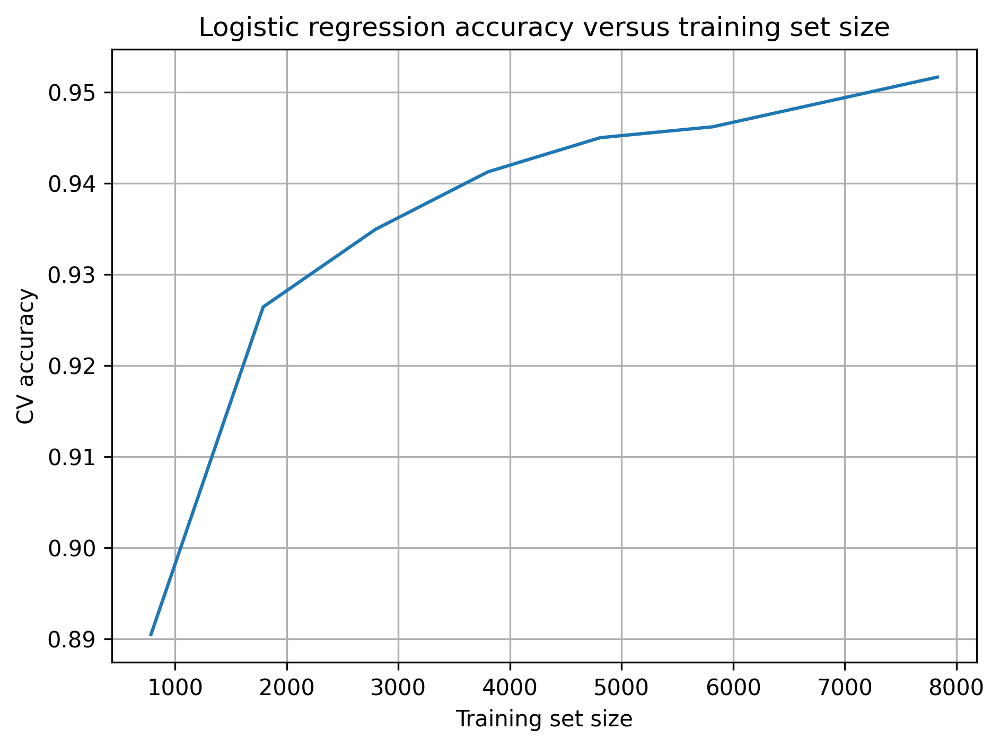

In [ ]:
from sklearn.model_selection import learning_curve

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.1, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    log_hcc, X_train_hcc, y_train_hcc,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Logistic regression accuracy versus training set size")
ax.grid()

fig.tight_layout()

**Logistic Regression Learning Curve (HCC Dataset)**

The plot illustrates the accuracy of the Logistic Regression model as the training set size increases.

Initially, accuracy improves significantly as more data is introduced. However, after around 2000 samples, the accuracy plateaus, indicating diminishing returns from adding more training data. This suggests that the model reaches its optimal performance at this point for the dataset.

#### Test predictions

In [ ]:
# fit on all training dataset
log_hcc.fit(X_train_hcc, y_train_hcc)

Pipeline(steps=[('pca', PCA(n_components=500, random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(0.046415888336127774),
                                    random_state=42, solver='newton-cg'))])

In [ ]:
from sklearn.metrics import accuracy_score


y_pred_hcc = log_hcc.predict(X_test_hcc)

log_hcc_test_score = accuracy_score(y_test_hcc, y_pred_hcc)

print(f"Accuracy score for the 20% test set: {log_hcc_test_score}")

Accuracy score for the 20% test set: 0.9472250595846101


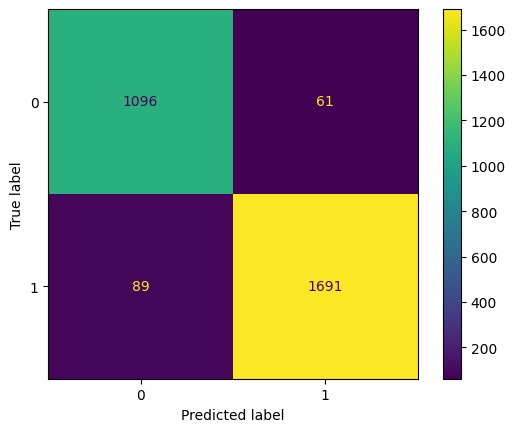

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_hcc, y_pred_hcc)
plt.show()

**Logistic Regression - HCC Test Set Results**

For Logistic Regression on the HCC test set, the model achieved an accuracy of **94.72%**. The confusion matrix highlights a solid performance despite the dataset’s imbalance, without the strong class bias seen in Random Forest.

The detailed confusion matrix and the resulting classification accuracy underline the model's robust handling of both hypoxia and normoxia predictions.

#### Confidence analysis

In [ ]:
probs = log_hcc.predict_proba(X_test_hcc)[:, 1]

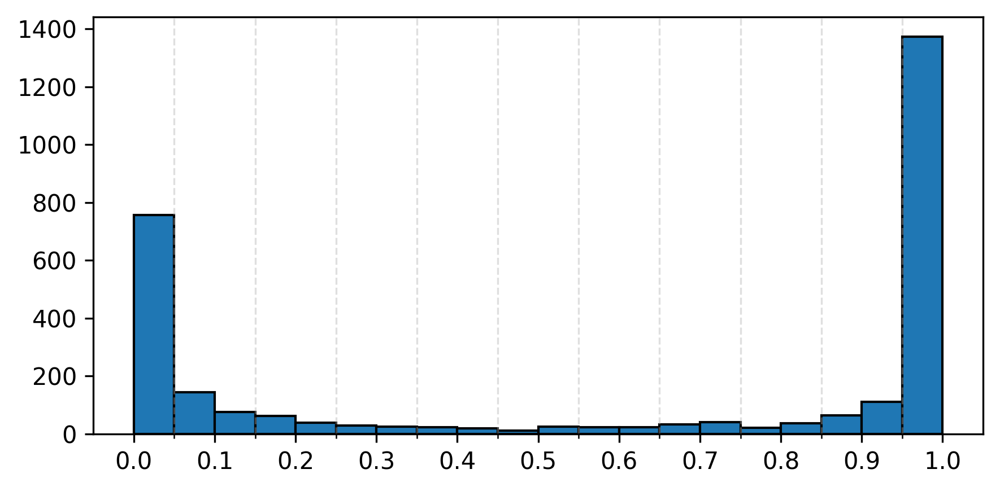

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Probability Distribution for Logistic Regression – HCC**
The histogram of logistic regression predicted probabilities on the HCC test set shows the model’s confidence pattern:

- **Extreme certainty for hypoxia:** A large spike at 1.0 indicates many samples are classified as hypoxia with full confidence.  
- **Strong normoxia signals:** A smaller but clear peak at 0.0 demonstrates the model also often predicts normoxia with high confidence.  
- **Rare moderate confidence:** Counts taper off smoothly between ~0.05 and ~0.95, with the fewest predictions around 0.5, reflecting that truly uncertain calls are uncommon.  

#### Gene retrieval



In [ ]:
# fit on all data
log_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=500)), ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(0.046415888336127774),
                                    random_state=42, solver='newton-cg'))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = log_hcc.named_steps['log_reg'].coef_[0]

# undo the scaler
scaler = log_hcc.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = log_hcc.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = hcc.columns

# RANK GENES

# create series with (gene_name : weights)
w_hcc = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_hcc = w_hcc.sort_values(ascending=False)

# Most negatively driving genes
top_neg_hcc = w_hcc.sort_values()

In [ ]:
top_pos_hcc[:20]

EGLN3        1.712794
NDRG1        1.492420
BNIP3        1.183225
MT-TV        1.179681
DDIT4        1.047354
PLOD2        0.899105
P4HA1        0.854379
MT1X         0.809458
BTBD9        0.798715
MT-TQ        0.796233
PDCD4        0.787913
SHOX         0.782771
IGFBP3       0.778284
PGAM1        0.777958
LINC01304    0.773280
MT1E         0.763899
GBP1P1       0.758026
FGF23        0.740922
NPM1P40      0.739621
HEPACAM      0.733018
dtype: float64

**Gene Importance for HCC – Linear Regression Model**

These are the most important genes according to the Linear Regression model for the HCC dataset.

- **BNIP3**
- **DDIT4**
- **P4HA1**


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/4069642769.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


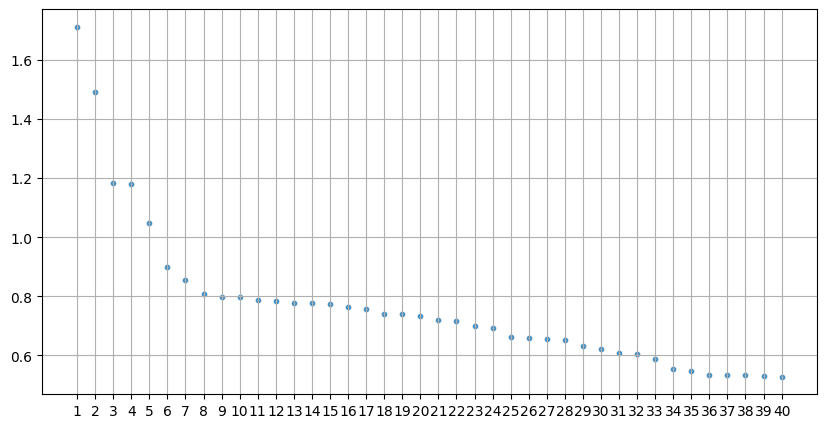

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_pos_hcc[:40].index, top_pos_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

In [ ]:
top_neg_hcc[:20]

FOSL1     -0.945446
H2AC16    -0.847425
H2BC9     -0.749869
H4C5      -0.715314
AKR1C1    -0.682112
NEAT1     -0.660830
ZHX1      -0.565093
H3C2      -0.529146
DDX54     -0.508227
H2BC4     -0.494257
MRPL55    -0.490149
SIGMAR1   -0.477714
IRAK1     -0.477128
SMARCB1   -0.472149
KMT2D     -0.459014
METTL26   -0.456980
SLPI      -0.446794
DTYMK     -0.439861
H2AC12    -0.438611
DRAP1     -0.437563
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/1901345960.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


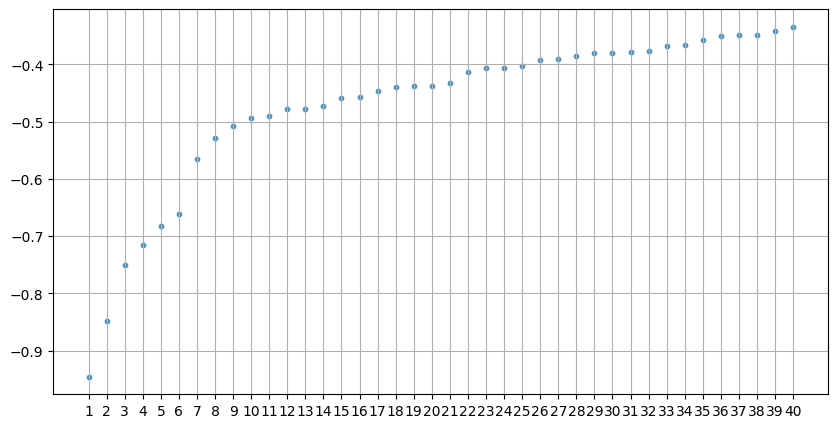

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_hcc[:40].index, top_neg_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

### **MCF7**


#### Fine tuning


In [ ]:
#grid search
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


pipe = Pipeline([
    ('pca', PCA()),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, solver='liblinear'))
])

param_grid = [
    {
    'scaler': [StandardScaler()],
    'pca__n_components': [250, 500, 750],
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l2', None],
    'log_reg__solver': ['lbfgs','newton-cg','sag']},

    {'scaler': [StandardScaler()],
    'pca__n_components': [250, 500, 750],
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['l1', 'l2'],
    'log_reg__solver': ['liblinear', 'saga']},

    {'scaler': [StandardScaler()],
    'pca__n_components': [250, 500, 750],
    'log_reg__C' : np.logspace(-4,4,10),
    'log_reg__penalty':['elasticnet'],
    'log_reg__solver': ['saga'],
    'log_reg__l1_ratio': [0.1, 0.5, 0.9]}
]

grid = RandomizedSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2)

grid.fit(X_train_mcf7, y_train_mcf7)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=0.0001, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   3.2s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=0.0001, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   3.1s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=0.0001, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   3.0s
[CV] END log_reg__C=0.005994842503189409, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   2.2s
[CV] END log_reg__C=0.005994842503189409, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   2.2s
[CV] END log_reg__C=0.005994842503189409, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   2.3s
[CV] END log_reg__C=0.000774263682681127, log_reg__l1_ratio=0.1, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=   5.5s
[CV] END log_reg__C=0.000774263682681127, log_reg__l1_ratio=0.1, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=   5.2s
[CV] END log_reg__C=0.000774263682681

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   3.4s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   3.4s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=2.782559402207126, log_reg__penalty=l2, log_reg__solver=saga, pca__n_components=250, scaler=StandardScaler(); total time=   3.4s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=166.81005372000558, log_reg__l1_ratio=0.9, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.6s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=166.81005372000558, log_reg__l1_ratio=0.9, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.6s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=166.81005372000558, log_reg__l1_ratio=0.9, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.4s
[CV] END log_reg__C=10000.0, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=500, scaler=StandardScaler(); total time=  31.2s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV] END log_reg__C=10000.0, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=500, scaler=StandardScaler(); total time= 5.1min
[CV] END log_reg__C=10000.0, log_reg__penalty=l1, log_reg__solver=liblinear, pca__n_components=500, scaler=StandardScaler(); total time=  14.5s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   2.9s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   2.9s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1207: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__penalty=None, log_reg__solver=lbfgs, pca__n_components=500, scaler=StandardScaler(); total time=   2.8s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__l1_ratio=0.5, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.2s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__l1_ratio=0.5, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.2s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=1291.5496650148827, log_reg__l1_ratio=0.5, log_reg__penalty=elasticnet, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.1s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=166.81005372000558, log_reg__penalty=l1, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.2s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=166.81005372000558, log_reg__penalty=l1, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.2s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV] END log_reg__C=166.81005372000558, log_reg__penalty=l1, log_reg__solver=saga, pca__n_components=750, scaler=StandardScaler(); total time=  10.2s


RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('pca', PCA()),
                                             ('scaler', StandardScaler()),
                                             ('log_reg',
                                              LogisticRegression(random_state=42,
                                                                 solver='liblinear'))]),
                   param_distributions=[{'log_reg__C': array([1.00000000e-04, 7.74263683e-04, 5.99484250e-03, 4.64158883e-02,
       3.59381366e-01, 2.78255940e+00, 2.15443469e+01, 1.66810054e+02,
       1.29154967e+03, 1.00000000e+...
                                        {'log_reg__C': array([1.00000000e-04, 7.74263683e-04, 5.99484250e-03, 4.64158883e-02,
       3.59381366e-01, 2.78255940e+00, 2.15443469e+01, 1.66810054e+02,
       1.29154967e+03, 1.00000000e+04]),
                                         'log_reg__l1_ratio': [0.1, 0.5, 0.9],
                                         'log_reg__penalty': ['elasticnet'],
                                         'log_reg__solver': ['saga'],
                                         'pca__n_components': [250, 500, 750],
                                         'scaler': [StandardScaler()]}],
                   scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.9769943665225354)

In [ ]:
log_mcf7 = grid.best_estimator_

**Logistic Regression – Randomized GridSearch Results for MCF7 Dataset**

The best estimator pipeline includes **PCA (250 components)**, **StandardScaler**, and **Logistic Regression** with **C ≈ 0.00599** with a best score of **97.7%**(better than HCC).

The **low value of C** indicates **strong regularization**, meaning the model is penalizing large coefficients and is likely favoring a simpler decision boundary with a **wider margin** to prevent overfitting.



In [ ]:
#FINAL MODEL
log_mcf7 = Pipeline([
    ('pca', PCA()),
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42, solver='liblinear'))
])

#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
log_mcf7_mean_score = cross_val_score(log_mcf7, X_train_mcf7, y_train_mcf7, cv=skf).mean()

In [ ]:
log_mcf7_mean_score

np.float64(0.938207965098106)

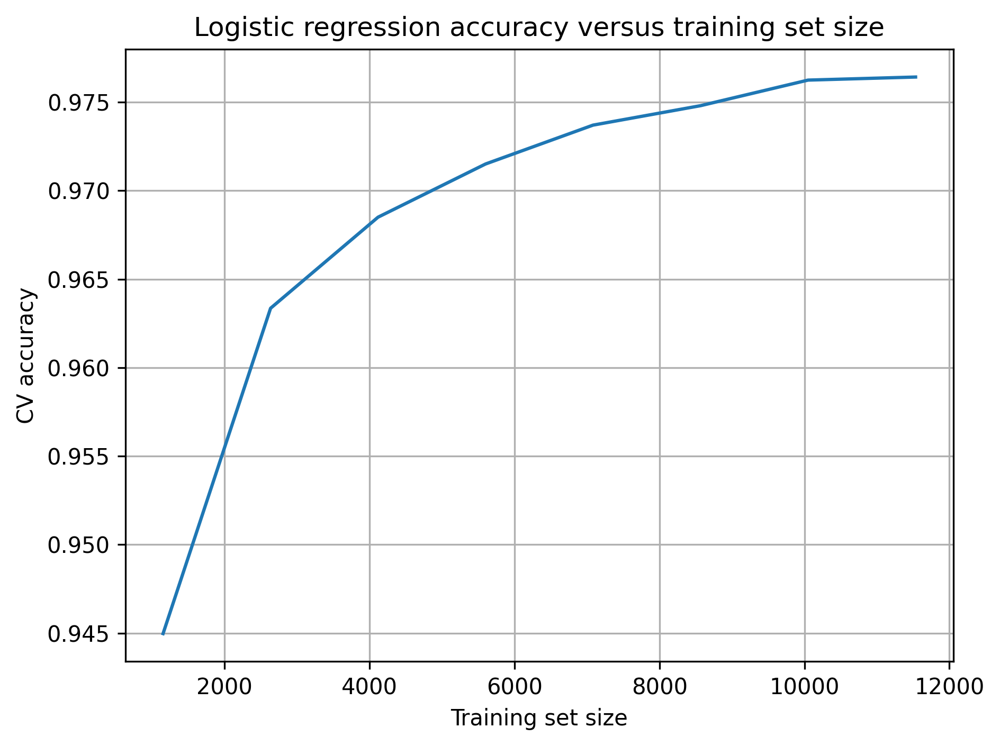

In [ ]:
#learning curve vs training size
from sklearn.model_selection import learning_curve

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.1, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    log_mcf7, X_train_mcf7, y_train_mcf7,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("Logistic regression accuracy versus training set size")
ax.grid()

fig.tight_layout()

**Training Set Size vs. CV Accuracy**

As the training set size increases, the **cross-validation accuracy** steadily improves, indicating that the model benefits from more data for better generalization.


#### Test predictions

In [ ]:
# fit on the whole training set
log_mcf7.fit(X_train_mcf7, y_train_mcf7)


Pipeline(steps=[('pca', PCA()), ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(random_state=42, solver='liblinear'))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_mcf7 = log_mcf7.predict(X_test_mcf7)

log_mcf7_test_score = accuracy_score(y_test_mcf7, y_pred_mcf7)

print(f"Accuracy score for the 20% test set: {log_mcf7_test_score}")

Accuracy score for the 20% test set: 0.954461396208969


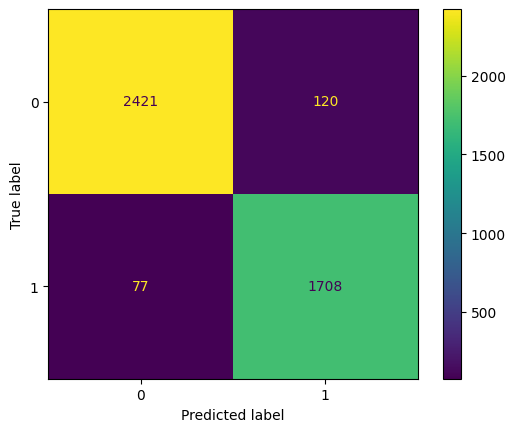

In [ ]:
#confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_mcf7, y_pred_mcf7)
plt.show()

**Logistic Regression - MCF7 Test Set Results**

The **accuracy** of the model is **95.45%**, showing excellent performance, slightly better than the HCC model, as usual.


#### Confidence analysis

In [ ]:
probs = log_mcf7.predict_proba(X_test_mcf7)[:, 1]

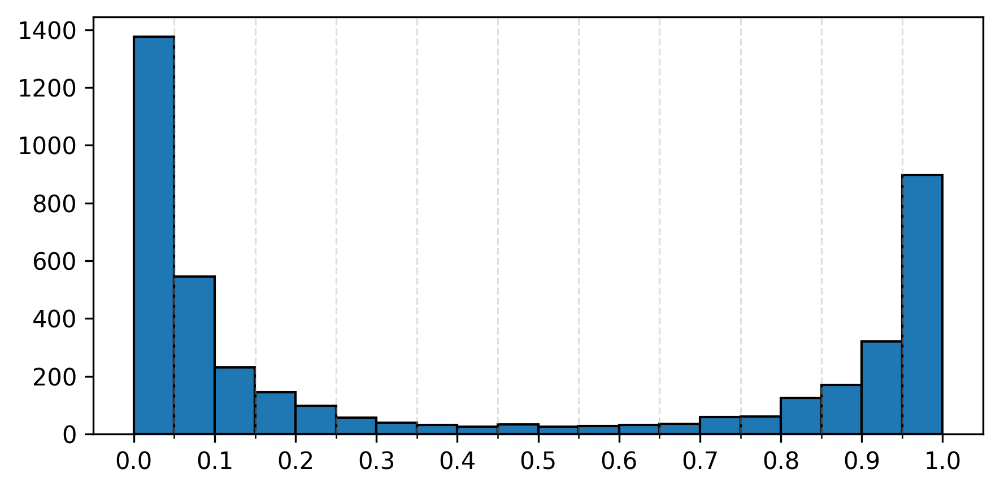

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(probs, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

The histogram of logistic regression predicted probabilities on the MCF7 test set reveals the model’s confidence profile:

- **U-shaped, strongly peaked at extremes:** Two large spikes at 0.0 and 1.0 show the model often makes near-certain calls for normoxia and hypoxia, respectively.  
- **Greater normoxia certainty:** The bar at 0.0 is taller than the one at 1.0, reflecting that the MCF7 test set has more normoxia samples (or that the model more confidently calls normoxia).  
- **Scarce ambiguous predictions:** Very few samples fall in the 0.4–0.6 range, indicating that genuinely uncertain predictions are rare.  
- **Asymmetric moderate tail:** The counts between ~0.7–0.9 are slightly higher than those between ~0.1–0.3, suggesting that when the model is less than completely sure, it more often leans toward hypoxia.  

Overall, logistic regression achieves strong class separation on MCF7, with the vast majority of test samples receiving high-confidence probability estimates.  

#### Gene retrieval



In [ ]:
# fit on all data
log_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=250)), ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(0.005994842503189409),
                                    random_state=42, solver='saga'))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = log_mcf7.named_steps['log_reg'].coef_[0]

# undo the scaler
scaler = log_mcf7.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = log_mcf7.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = mcf7.columns

# RANK GENES

# create series with (gene_name : weights)
w_mcf7 = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_mcf7 = w_mcf7.sort_values(ascending=False)

# Most negatively driving genes
top_neg_mcf7 = w_mcf7.sort_values()

In [ ]:
top_pos_mcf7[:20]

PGK1      0.570993
GAPDH     0.490036
DSP       0.400417
PKM       0.391799
RPL23     0.346053
H2AC12    0.333631
ENO1      0.316654
H2AC20    0.309323
KRT19     0.301497
NEAT1     0.288210
VMP1      0.270052
LGALS1    0.249932
H1-4      0.244509
TMSB10    0.240249
TPI1      0.218841
H19       0.200747
BRIP1     0.200266
H1-0      0.186742
TFF1      0.181833
CENPF     0.181274
dtype: float64

**Confirmed Hypoxia Marker Genes in MCF7 – Logistic Regression Model**

- **PGK1**
- **GAPDH**

**Note:** **PGK1** was also identified as a hypoxia marker in some previous classifiers.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/3290662101.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


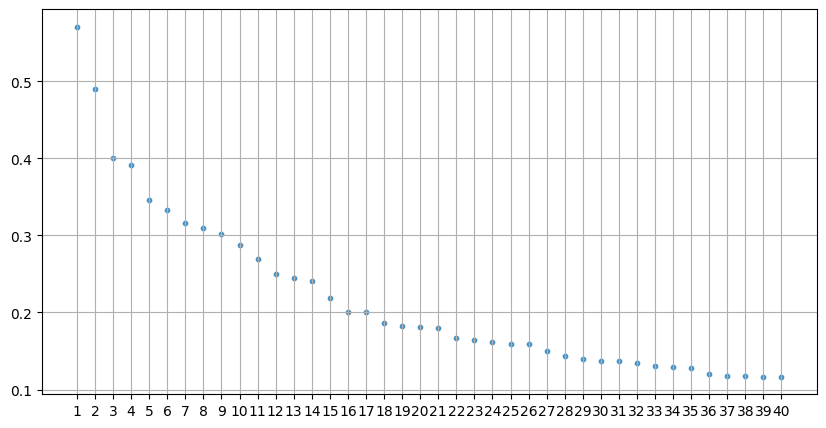

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_pos_mcf7[:40].index, top_pos_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

In [ ]:
top_neg_mcf7[:20]

MT-ND3    -0.630508
MT-CO3    -0.617179
MT-ATP6   -0.596317
MT-CYB    -0.462422
MT-ND4    -0.441897
MT-RNR1   -0.387636
MT-CO2    -0.376532
TMEM64    -0.357277
FGF23     -0.321738
MT-RNR2   -0.292132
TOB1      -0.283913
GPM6A     -0.255770
BCAS3     -0.210689
PSMD14    -0.201905
CLTB      -0.196526
MT-ND4L   -0.196400
GOLGA4    -0.178227
SPATS2L   -0.173676
C9orf78   -0.172211
C7orf50   -0.165995
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/3677777904.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


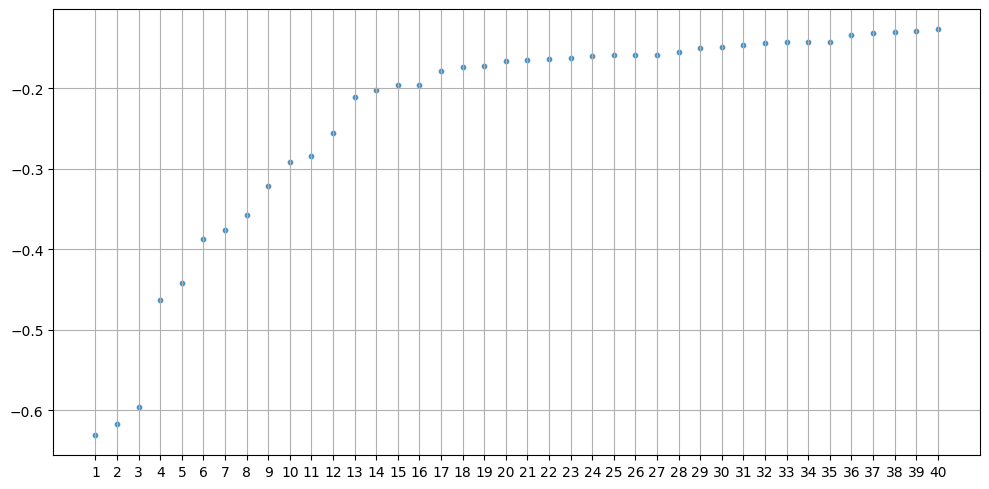

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_mcf7[:40].index, top_neg_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()
fig.tight_layout()

## SUPPORT VECTOR MACHINE

### HCC


#### Fine tuning


In [ ]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('svc', LinearSVC(dual= False, max_iter= 5000, random_state=42))
])

param_grid = {
    'pca__n_components': [250, 500, 750],
    'svc__C':     [0.1, 1, 10, 100, 1000]
}

grid = RandomizedSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1, random_state= 42)

grid.fit(X_train_hcc, y_train_hcc)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END ..................pca__n_components=250, svc__C=0.1; total time=  13.9s
[CV] END ..................pca__n_components=250, svc__C=0.1; total time=  14.1s
[CV] END .................pca__n_components=500, svc__C=1000; total time=  16.7s
[CV] END .................pca__n_components=500, svc__C=1000; total time=  19.4s
[CV] END .................pca__n_components=500, svc__C=1000; total time=  19.4s
[CV] END ..................pca__n_components=250, svc__C=0.1; total time=  12.6s
[CV] END ..................pca__n_components=500, svc__C=0.1; total time=  15.7s
[CV] END ....................pca__n_components=750, svc__C=1; total time=  38.9s
[CV] END ....................pca__n_components=750, svc__C=1; total time=  39.0s
[CV] END ..................pca__n_components=500, svc__C=0.1; total time=  13.2s
[CV] END ....................pca__n_components=750, svc__C=1; total time=  40.4s
[CV] END ..................pca__n_components=500

RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                             ('scaler', StandardScaler()),
                                             ('svc',
                                              LinearSVC(dual=False,
                                                        max_iter=5000,
                                                        random_state=42))]),
                   n_jobs=-1,
                   param_distributions={'pca__n_components': [250, 500, 750],
                                        'svc__C': [0.1, 1, 10, 100, 1000]},
                   random_state=42, scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.947041294167731)

In [ ]:
svc_hcc = grid.best_estimator_


**SVM Linear – HCC Dropseq RandomizedsearchCV results**

The best estimator pipeline includes **PCA (500 components)**, **StandardScaler**, and **LinearSVC** with **C = 0.1**.

The **C value of 0.1** indicates **strong regularization**, meaning the model penalizes larger coefficients more, leading to a **simpler model with a wider margin**. This helps prevent overfitting, especially in high-dimensional data.


In [ ]:
#FINAL CLASSIFIER
# cell to avoid gridsearch: save best params

from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


svc_hcc = Pipeline([
    ('pca', PCA(n_components=500, random_state=42)),
    ('scaler', StandardScaler()),
    ('svc', LinearSVC(C=0.1, dual= False, max_iter= 5000, random_state=42))
])

#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
svc_hcc_mean_score = cross_val_score(svc_hcc, X_train_hcc, y_train_hcc, cv=skf).mean()

In [ ]:
svc_hcc_mean_score

np.float64(0.9482332907620264)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


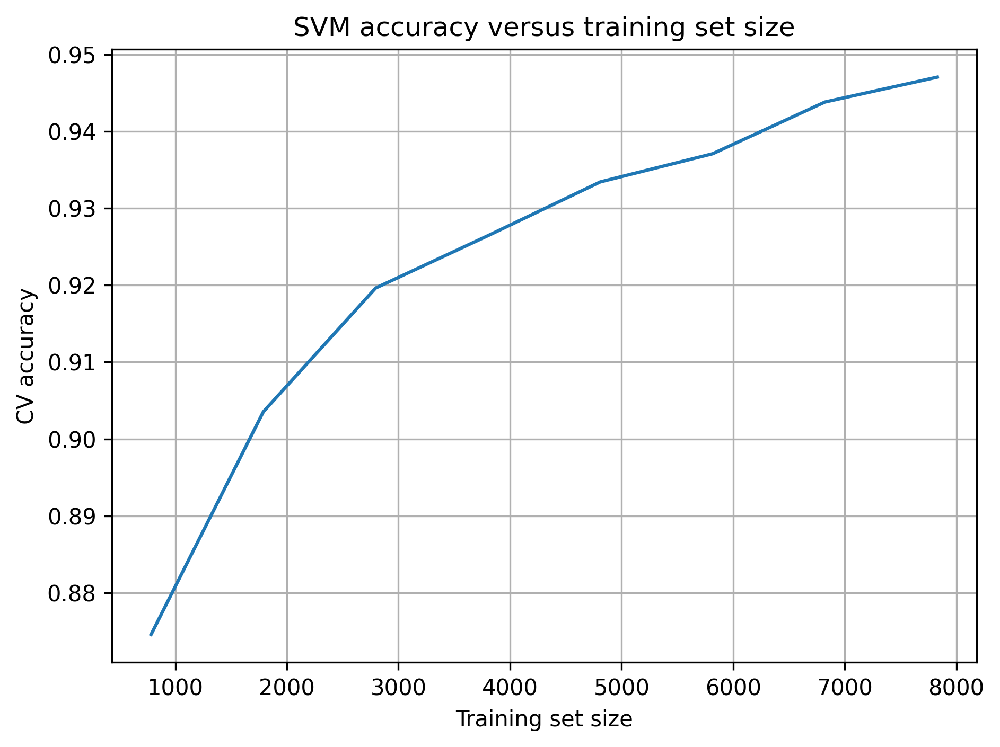

In [ ]:
# SINGLE LEARNING CURVE

from sklearn.model_selection import learning_curve
from sklearn.model_selection import cross_val_score

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.1, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    svc_hcc, X_train_hcc, y_train_hcc,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("SVM accuracy versus training set size")
ax.grid()

fig.tight_layout()

**SVM Accuracy vs. Training Set Size – HCC Dataset**

The graph shows that as the training set size increases, the **cross-validation accuracy** steadily rises, highlighting the model's improved performance with more data. The accuracy increase is more pronounced with larger training sets, suggesting that the model benefits from additional data for better generalization.


#### Test predictions

In [ ]:
svc_hcc.fit(X_train_hcc, y_train_hcc)

Pipeline(steps=[('pca', PCA(n_components=500, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc',
                 LinearSVC(C=0.1, dual=False, max_iter=5000, random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_hcc = svc_hcc.predict(X_test_hcc)


svc_hcc_test_score = accuracy_score(y_test_hcc, y_pred_hcc)


print(f"Accuracy score for the 20% test set: {svc_hcc_test_score}")

Accuracy score for the 20% test set: 0.9424582907728976


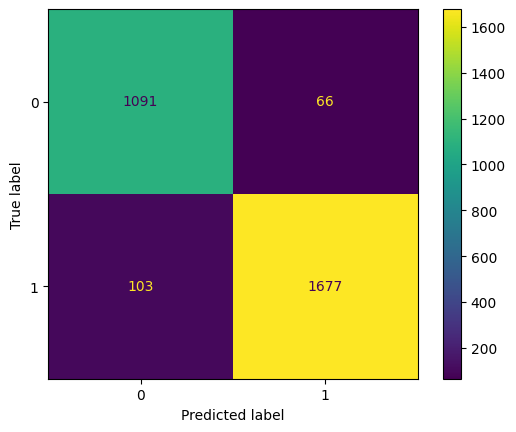

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_hcc, y_pred_hcc)
plt.show()

**Confusion Matrix – SVM Linear Model for HCC Dataset**

The confusion matrix shows an **accuracy of 94.25%**, with **66 false negatives** (predicted as non-hypoxic but true hypoxic) and **103 false positives** (predicted as hypoxic but true non-hypoxic).


#### Confidence analysis

In [ ]:
# calibrated probs

from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

base = svc_hcc

calib = CalibratedClassifierCV(
    estimator=base,
    method="isotonic",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(X_train_hcc, y_train_hcc)

proba = calib.predict_proba(X_test_hcc)[:, 1]   # P(y=1 | x)


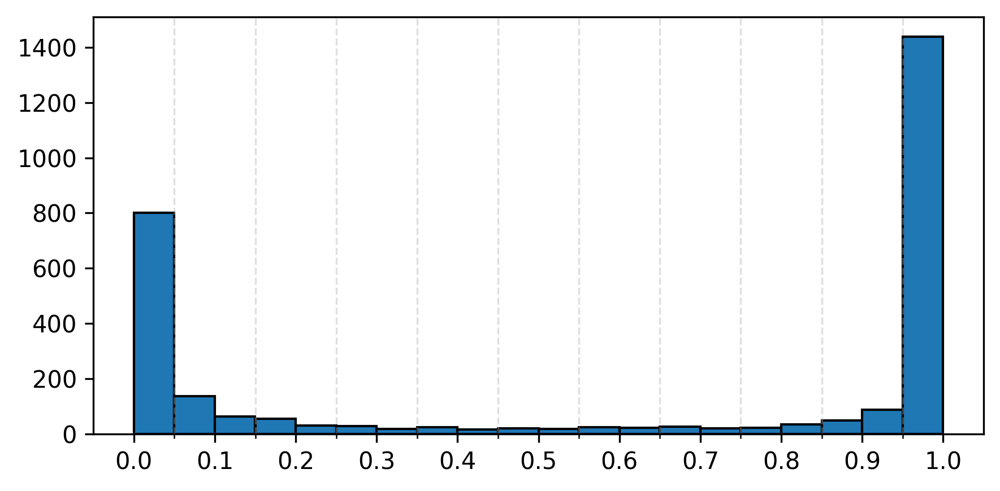

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

The histogram of SVC predicted probabilities on the HCC test set reveals extremely confident separations:

- **Huge spike at 1.0:** The tallest bar shows the model calls many samples hypoxia with maximum confidence.  
- **Noticeable peak at 0.0:** A secondary spike indicates the model also often predicts normoxia with full certainty.  
- **Very few ambiguous calls:** Counts drop sharply between ~0.1–0.9, with minimal mass around 0.5, so truly uncertain predictions are rare.  
- **Asymmetric extremes:** The hypoxia peak at 1.0 is larger than the normoxia peak at 0.0, reflecting the dataset’s class balance and the model’s bias toward hypoxia.  

Overall, the SVC demonstrates near-binary decision behavior on HCC, delivering high-confidence predictions for almost every test sample.  

#### Gene retrieval



In [ ]:
svc_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=500, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc',
                 LinearSVC(C=0.1, dual=False, max_iter=5000, random_state=42))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = svc_hcc.named_steps['svc'].coef_[0]

# undo the scaler
scaler = svc_hcc.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = svc_hcc.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = hcc.columns

# RANK GENES

# create series with (gene_name : weights)
w_hcc = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_hcc = w_hcc.sort_values(ascending=False)

# Most negatively driving genes
top_neg_hcc = w_hcc.sort_values()

In [ ]:
top_pos_hcc[:10]

EGLN3    0.923531
NDRG1    0.810864
MT-TV    0.601095
BNIP3    0.576966
MT1X     0.473257
P4HA1    0.438770
PGAM1    0.436070
BTBD9    0.425858
SHOX     0.424556
MT-TQ    0.398170
dtype: float64

**Confirmed Hypoxia Marker Genes in HCC – SVM Linear Model**

-**NDRG1**

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/1398960689.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


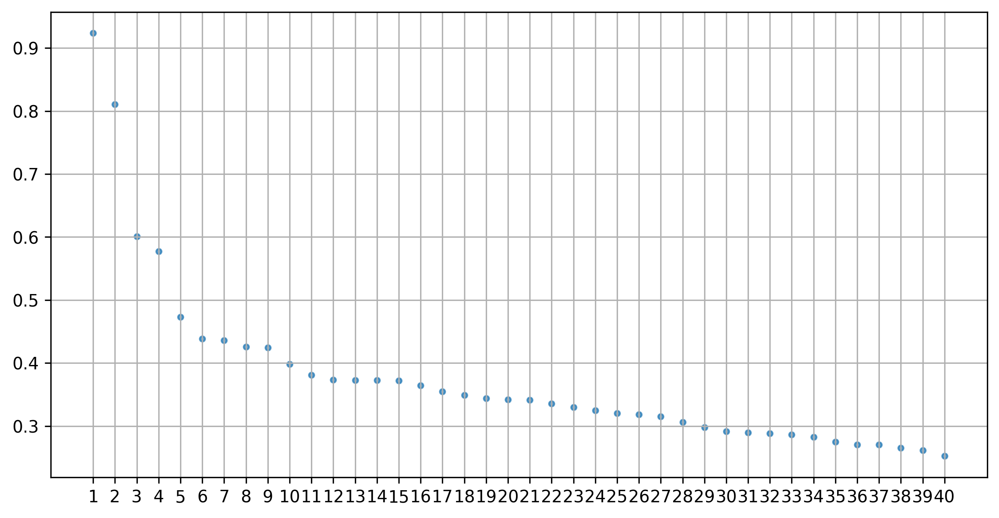

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

fig.set_dpi(300)

ax.scatter(top_pos_hcc[:40].index, top_pos_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/864739005.py:6: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


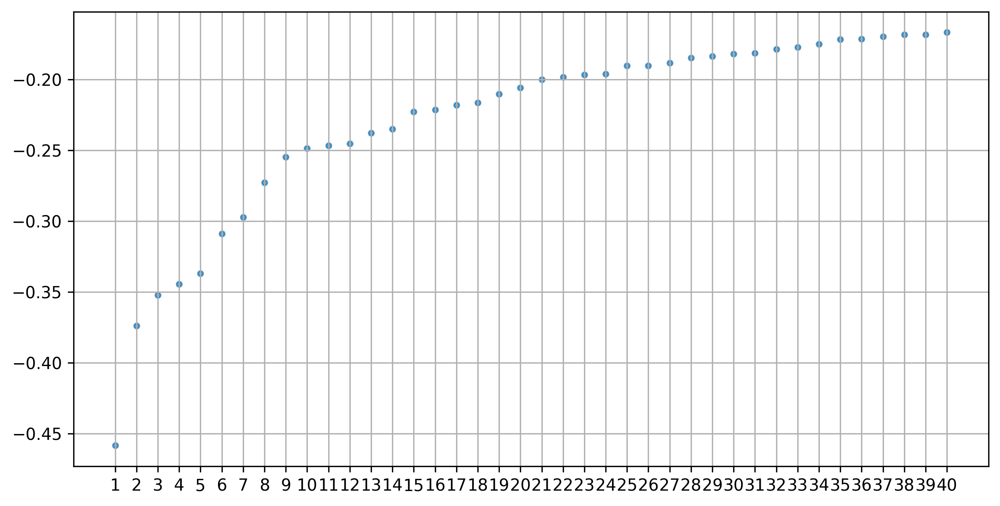

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

fig.set_dpi(300)

ax.scatter(top_neg_hcc[:40].index, top_neg_hcc[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()

In [ ]:
top_neg_hcc[:10]

H2AC16    -0.458517
H4C5      -0.373930
FOSL1     -0.352196
H2BC9     -0.344404
NEAT1     -0.336889
AKR1C1    -0.308781
KMT2D     -0.297125
SMARCB1   -0.272760
H3C2      -0.254702
SLPI      -0.248513
dtype: float64

### **MCF7**


#### Fine tuning


In [ ]:
# grid search

from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


pipe = Pipeline([
    ('pca', PCA(random_state=42)),
    ('scaler', StandardScaler()),
    ('svc', LinearSVC(dual= False, max_iter= 5000, random_state=42))
])

param_grid = {
    'pca__n_components': [250, 500, 750],
    'svc__C':     [0.1, 1, 10, 100, 1000]
}

grid = RandomizedSearchCV(pipe, param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1, random_state= 42)

grid.fit(X_train_mcf7, y_train_mcf7)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END ..................pca__n_components=250, svc__C=0.1; total time=  25.3s
[CV] END ..................pca__n_components=250, svc__C=0.1; total time=  26.1s
[CV] END .................pca__n_components=500, svc__C=1000; total time=  31.6s
[CV] END .................pca__n_components=500, svc__C=1000; total time=  33.8s
[CV] END ..................pca__n_components=250, svc__C=0.1; total time=  19.8s
[CV] END ....................pca__n_components=750, svc__C=1; total time=  57.4s
[CV] END ....................pca__n_components=750, svc__C=1; total time=  57.9s
[CV] END ....................pca__n_components=750, svc__C=1; total time=  57.9s
[CV] END ..................pca__n_components=500, svc__C=0.1; total time=  18.8s
[CV] END ..................pca__n_components=500, svc__C=0.1; total time=  20.3s
[CV] END ..................pca__n_components=500, svc__C=0.1; total time=  21.0s
[CV] END ..................pca__n_components=500

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV] END .................pca__n_components=500, svc__C=1000; total time= 2.5min
[CV] END .................pca__n_components=750, svc__C=1000; total time=  56.7s
[CV] END .................pca__n_components=750, svc__C=1000; total time=  51.6s


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV] END ..................pca__n_components=500, svc__C=100; total time= 1.8min


RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('pca', PCA(random_state=42)),
                                             ('scaler', StandardScaler()),
                                             ('svc',
                                              LinearSVC(dual=False,
                                                        max_iter=5000,
                                                        random_state=42))]),
                   n_jobs=-1,
                   param_distributions={'pca__n_components': [250, 500, 750],
                                        'svc__C': [0.1, 1, 10, 100, 1000]},
                   random_state=42, scoring='accuracy', verbose=2)

In [ ]:
grid.best_score_

np.float64(0.9756069329117353)

In [ ]:
svc_mcf7 = grid.best_estimator_

**SVM Linear – MCF7 Dataset**

The best estimator pipeline includes **PCA (250 components)**, **StandardScaler**, and **LinearSVC** with **C = 0.1** and **max_iter = 5000**. The **best score accuracy** is **97.57%**.

This model has same parameters has HCC but with less components for PCA, confirming that cells in MCF7 are easier to predict.


In [ ]:
#to avoid gridsearch and save model
#FINAL CLASSIFIER

from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline      import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


svc_mcf7 = Pipeline([
    ('pca', PCA(n_components=250, random_state=42)),
    ('scaler', StandardScaler()),
    ('LinearSVC',LinearSVC(C=0.1, dual=False, max_iter=5000, random_state=42))
])

#### Model selection

In [ ]:
# save 3cv mean score
from sklearn.model_selection import cross_val_score, StratifiedKFold

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
svc_mcf7_mean_score = cross_val_score(svc_mcf7, X_train_mcf7, y_train_mcf7, cv=skf).mean()

In [ ]:
svc_mcf7_mean_score

np.float64(0.9767051954735946)

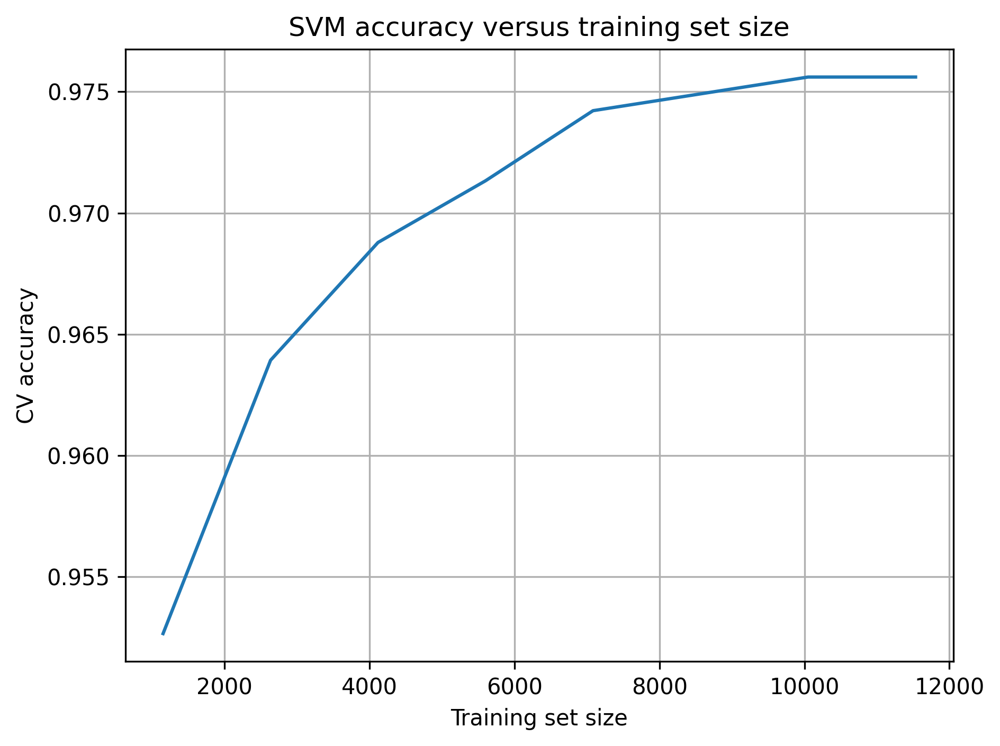

In [ ]:
# SINGLE LEARNING CURVE

from sklearn.model_selection import learning_curve
from sklearn.model_selection import cross_val_score

fig, ax  = plt.subplots()
fig.set_dpi(300)

sizes = np.linspace(0.1, 1.0, 8)

train_sizes, train_scores, cv_scores = learning_curve(
    svc_mcf7, X_train_mcf7, y_train_mcf7,
    train_sizes=sizes,
    cv=3, scoring="accuracy", n_jobs=-1,
    shuffle=True, random_state=42)


ax.plot(train_sizes, cv_scores.mean(axis=1))
ax.set_xlabel("Training set size")
ax.set_ylabel("CV accuracy")
ax.set_title("SVM accuracy versus training set size")
ax.grid()

fig.tight_layout()

**SVM Accuracy vs. Training Set Size – MCF7 Dataset**

The accuracy starts already high and steadily improves as the training set size increases, indicating that the model quickly generalizes well even with a smaller training set.



#### Test predictions

In [ ]:
# fit on the whole training set

svc_mcf7.fit(X_train_mcf7, y_train_mcf7)

Pipeline(steps=[('pca', PCA(n_components=250, random_state=42)),
                ('scaler', StandardScaler()),
                ('LinearSVC',
                 LinearSVC(C=0.1, dual=False, max_iter=5000, random_state=42))])

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_mcf7 = svc_mcf7.predict(X_test_mcf7)


svc_mcf7_test_score = accuracy_score(y_test_mcf7, y_pred_mcf7)


print(f"Accuracy score for the 20% test set: {svc_mcf7_test_score}")

Accuracy score for the 20% test set: 0.9775774387424873


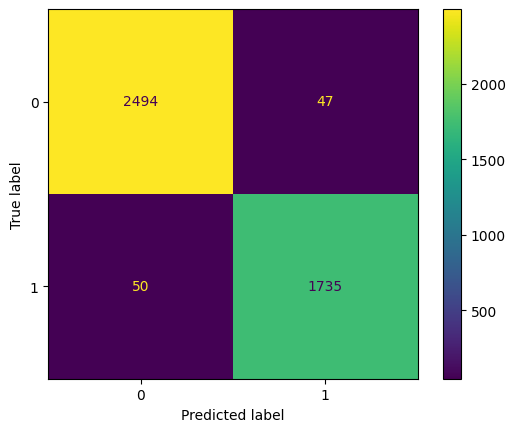

In [ ]:
# confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(y_test_mcf7, y_pred_mcf7)
plt.show()

**Confusion Matrix – SVM Linear Model for MCF7 Dataset**

The model shows an accuracy of **97.76%**, with **47 false negatives** (predicted as non-hypoxic but true hypoxic) and **50 false positives** (predicted as hypoxic but true non-hypoxic). The model performs well with a relatively low number of errors, indicating strong generalization.


#### Confidence analysis

In [ ]:
# calibrated probs

from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

pca = PCA(n_components=250)
X_test_mcf7_pca = pca.fit_transform(X_test_mcf7)

base = svc_mcf7

calib = CalibratedClassifierCV(
    estimator=base,
    method="isotonic",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(X_train_mcf7, y_train_mcf7)

proba = calib.predict_proba(X_test_mcf7)[:, 1]   # P(y=1 | x)

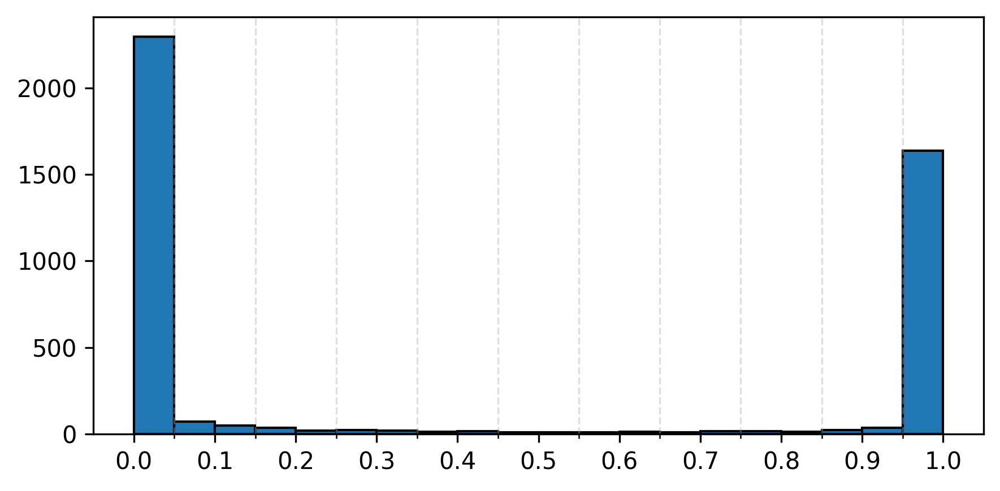

In [ ]:
# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

The histogram of SVM predicted probabilities on the MCF7 test set shows near-binary decision behavior:

- **Pronounced peaks at extremes:** A large spike at 0.0 and a secondary spike at 1.0 indicate the model makes very confident normoxia and hypoxia calls, respectively.  
- **Greater normoxia certainty:** The 0.0 peak exceeds the 1.0 peak, reflecting either more normoxia samples or stronger confidence in normoxia predictions.  
- **Negligible ambiguity:** Very few samples fall between ~0.1–0.9, so the SVM rarely outputs uncertain probabilities.  
- **Sharp class separation:** The U-shaped distribution underscores the SVM’s clear boundary on MCF7, assigning most test points to one class with high confidence.  

#### Gene retrieval



In [ ]:
svc_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=250, random_state=42)),
                ('scaler', StandardScaler()),
                ('svc',
                 LinearSVC(C=0.1, dual=False, max_iter=5000, random_state=42))])

In [ ]:
# array of the coefficients omega assigned to the instances by SVM
coef_pc = svc_mcf7.named_steps['svc'].coef_[0]

# undo the scaler
scaler = svc_mcf7.named_steps['scaler']
coef_unscaled_pc = coef_pc / scaler.scale_

# retrieve most relevant gene reprojecting though PCA
pca = svc_mcf7.named_steps['pca']

gene_weights = pca.components_.T.dot(coef_unscaled_pc)

genes = mcf7.columns

# RANK GENES

# create series with (gene_name : weights)
w_mcf7 = pd.Series(gene_weights, index=genes)

# Most positively driving genes
top_pos_mcf7 = w_mcf7.sort_values(ascending=False)

# Most negatively driving genes
top_neg_mcf7 = w_mcf7.sort_values()

In [ ]:
top_pos_mcf7[:20]

GAPDH     0.395881
PGK1      0.385494
RPL23     0.254488
DSP       0.252336
NEAT1     0.236368
PKM       0.235599
H2AC20    0.226880
LGALS1    0.215801
KRT19     0.214994
TFF3      0.212777
H2AC12    0.204279
H1-4      0.189477
TMSB10    0.187355
HES1      0.180740
VMP1      0.178215
ENO1      0.168997
BRIP1     0.163070
TPI1      0.162333
TIMM8B    0.147481
S100P     0.143719
dtype: float64

/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/2573315226.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


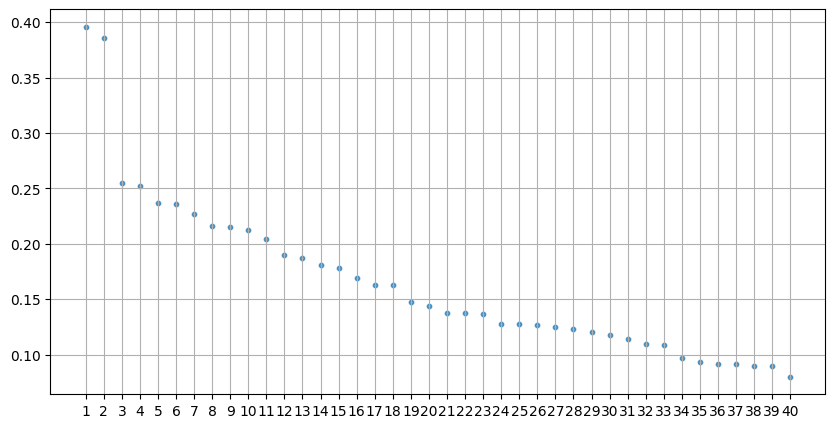

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_pos_mcf7[:40].index, top_pos_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()


In [ ]:
top_neg_mcf7[:20]

MT-ND3    -0.645141
MT-CO3    -0.519650
MT-RNR1   -0.423538
MT-ATP6   -0.351103
MT-CYB    -0.292356
MT-CO2    -0.257319
MT-ND4    -0.256180
TMEM64    -0.251113
FGF23     -0.226635
GPM6A     -0.222356
TOB1      -0.212831
MT-RNR2   -0.211988
BCAS3     -0.150772
CLTB      -0.149117
SPATS2L   -0.148013
PSMD14    -0.138560
PAK2      -0.132858
GOLGA4    -0.130270
C9orf78   -0.126785
CAPZA1    -0.122390
dtype: float64

**Confirmed Hypoxia Marker Genes in MCF7 – SVM Linear Model**

- **PGK1**: A well-established hypoxia marker involved in glycolysis and tumor progression.

**Note:** This gene was also identified as a hypoxia marker in previous classifiers.


/var/folders/y6/754nyqfn0slc00_pxq2h32bc0000gn/T/ipykernel_15776/443704784.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([i for i in range(1,151)])


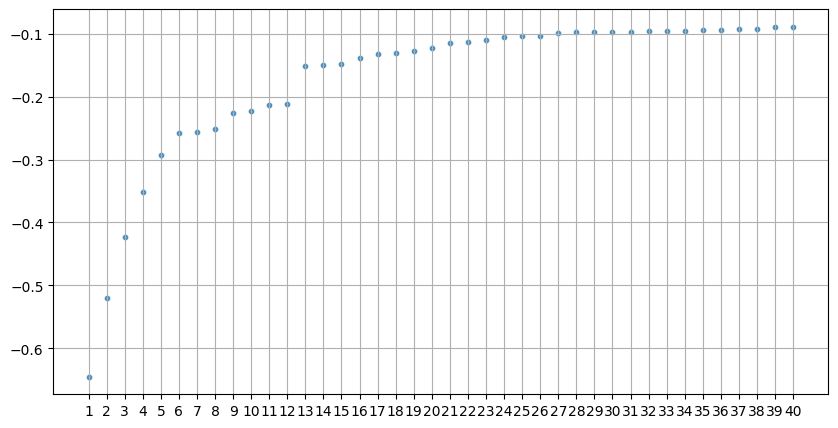

In [ ]:
fig, ax = plt.subplots(figsize = (10, 5))

ax.scatter(top_neg_mcf7[:40].index, top_neg_mcf7[:40].values, s=10, alpha=0.7)
ax.set_xticklabels([i for i in range(1,151)])
ax.grid()


## Comparative summary

In [ ]:
summary_hcc = {
    "Random Forest": {"Mean Accuracy with CV 3" : rdf_hcc_mean_score,
                        "Score on frozen test set" : rdf_hcc_test_score,
                        "Confidence analysis": "Distribution is right-skewed toward hypoxia (peak at 0.8–0.9), with almost no high-confidence normoxia votes (0.0–0.1) and only a few absolute certainties at 1.0."},
    "Logistic Regression": {"Mean Accuracy with CV 3" : log_hcc_mean_score,
                            "Score on frozen test set" : log_hcc_test_score,
                            "Confidence analysis" : "Predictions cluster tightly at 0.0 (normoxia) and 1.0 (hypoxia), showing high confidence in both classes, with very few mid-range probabilities indicating rare uncertainty."},
    "Support Vector Machine": {"Mean Accuracy with CV 3" : svc_hcc_mean_score,
                               "Score on frozen test set" : svc_hcc_test_score,
                               "Confidence analysis" : "Near-binary distribution with dominant peaks at 1.0 (hypoxia) and 0.0 (normoxia)—the hypoxia peak is larger—and almost no mid-range probabilities, indicating extremely high confidence."}
}

table_hcc = pd.DataFrame(summary_hcc).T

from IPython.display import display

# tell the notebook browser to wrap long text in that column
styled = (
    table_hcc.style
    .set_caption("HCC Model Comparison")
    .set_properties(
        subset=['Confidence analysis'],
        **{
            'white-space': 'pre-wrap',
            'word-wrap':   'break-word',
            'max-width':   '300px',
            'text-align':  'left',
        }
    )
)

display(styled)


,Mean Accuracy with CV 3,Score on frozen test set,Confidence analysis
Random Forest,0.890251,0.898876,"Distribution is right-skewed toward hypoxia (peak at 0.8–0.9), with almost no high-confidence normoxia votes (0.0–0.1) and only a few absolute certainties at 1.0."
Logistic Regression,0.951724,0.947225,"Predictions cluster tightly at 0.0 (normoxia) and 1.0 (hypoxia), showing high confidence in both classes, with very few mid-range probabilities indicating rare uncertainty."
Support Vector Machine,0.948233,0.942458,"Near-binary distribution with dominant peaks at 1.0 (hypoxia) and 0.0 (normoxia)—the hypoxia peak is larger—and almost no mid-range probabilities, indicating extremely high confidence."


**Model Selection for HCC (Drop-Seq)**

| Model                  | CV Accuracy | Test Accuracy | Confidence Profile                                                                           |
|------------------------|------------:|--------------:|------------------------------------------------------------------------------------------------|
| **Random Forest**      | 0.8903      | 0.8989        | Right-skewed toward hypoxia (peak at 0.8–0.9), almost no high-confidence normoxia (0.0–0.1), few certainties at 1.0. |
| **Logistic Regression**| 0.9517      | 0.9472        | Predicted probabilities cluster tightly at 0.0 and 1.0, showing high confidence and rare uncertainty.     |
| **Support Vector Machine** | 0.9482  | 0.9425        | Near-binary output with dominant peaks at 1.0 (hypoxia) and 0.0 (normoxia), minimal mid-range probabilities. |

**Analysis**

1. **Generalization Performance**  
   - **LR** achieves the highest CV accuracy (0.9517), suggesting the best robustness on unseen Drop-Seq Macro data.  
   - **SVM** and **RF** lag slightly in CV (0.9482 and 0.8903), indicating marginally lower expected generalization.

2. **Test-Set Reliability**  
   - All models perform similarly on the frozen test set (LR 0.9472, SVM 0.9425, RF 0.8989), but **LR** retains the edge.

3. **Prediction Confidence**  
   - **RF** hesitates most often (spread around 0.8–0.9 with few absolute certainties), risking borderline calls.  
   - **SVM** is highly decisive but exhibits minor over-confidence bias (very few mid-range values).  
   - **LR** balances both worlds: perfect clustering at extremes with almost no “soft” probabilities, implying clear separability without undue over-confidence.

---

**Conclusion:**  
**Logistic Regression** is the best choice for HCC on Drop-Seq, delivering top cross-validation accuracy, strong test performance, and a clean, high-confidence decision boundary.  


In [ ]:
summary_mcf7 = {
    "Random Forest": {"Mean Accuracy with CV 3" : rdf_mcf7_mean_score,
                        "Score on frozen test set" : rdf_mcf7_test_score,
                        "Confidence analysis": "Skewed distribution with strong peaks at 0 (normoxia) and 1 (hypoxia), indicating moderate model confidence and underlying class imbalance; overall decent performance but not uniformly high certainty"},
    "Logistic Regression": {"Mean Accuracy with CV 3" : log_mcf7_mean_score,
                            "Score on frozen test set" : log_mcf7_test_score,
                            "Confidence analysis" : "U-shaped distribution with high peaks at 0 (normoxia) and 1 (hypoxia)—the normoxia peak is larger—few mid-range predictions, and moderate-confidence calls slightly favor hypoxia."},
    "Support Vector Machine": {"Mean Accuracy with CV 3" : svc_mcf7_mean_score,
                               "Score on frozen test set" : svc_mcf7_test_score,
                               "Confidence analysis" : "U-shaped distribution with dominant peaks at 0.0 (normoxia) and 1.0 (hypoxia)—the normoxia peak is larger—and almost no mid-range probabilities, indicating very high confidence and clear class separation."}
}

table_mcf7 = pd.DataFrame(summary_mcf7).T

from IPython.display import display

# tell the notebook browser to wrap long text in that column
styled = (
    table_mcf7.style
    .set_caption("MCF7 Model Comparison")
    .set_properties(
        subset=['Confidence analysis'],
        **{
            'white-space': 'pre-wrap',
            'word-wrap':   'break-word',
            'max-width':   '300px',
            'text-align':  'left',
        }
    )
)

display(styled)


,Mean Accuracy with CV 3,Score on frozen test set,Confidence analysis
Random Forest,0.942023,0.948451,"Skewed distribution with strong peaks at 0 (normoxia) and 1 (hypoxia), indicating moderate model confidence and underlying class imbalance; overall decent performance but not uniformly high certainty"
Logistic Regression,0.938208,0.954461,"U-shaped distribution with high peaks at 0 (normoxia) and 1 (hypoxia)—the normoxia peak is larger—few mid-range predictions, and moderate-confidence calls slightly favor hypoxia."
Support Vector Machine,0.976705,0.977577,"U-shaped distribution with dominant peaks at 0.0 (normoxia) and 1.0 (hypoxia)—the normoxia peak is larger—and almost no mid-range probabilities, indicating very high confidence and clear class separation."


**Model Selection for MCF7 (Drop-Seq)**

| Model                  | CV Accuracy | Test Accuracy | Confidence Profile                                                                                       |
|------------------------|------------:|--------------:|-----------------------------------------------------------------------------------------------------------|
| **Random Forest**      | 0.9420      | 0.9485        | Skewed at extremes (peaks at 0 and 1), moderate confidence but some mid-range spread and class imbalance. |
| **Logistic Regression**| 0.9382      | 0.9545        | U-shaped with peaks at 0 and 1 (larger normoxia peak), few mid-range calls, slight hypoxia bias.          |
| **Support Vector Machine** | 0.9767  | 0.9776        | Near-binary outputs with dominant peaks at 0 and 1 (normoxia peak larger), almost no ambiguity.            |

**Analysis**

1. **Generalization & Robustness**  
   - **SVM** outperforms both RF and LR in cross-validation (0.9767 vs. ~0.94), indicating superior stability on unseen Drop-Seq Macro data.

2. **Test-Set Performance**  
   - All models perform well, but **SVM** again leads with the highest test accuracy (0.9776), closely followed by LR (0.9545) and RF (0.9485).

3. **Prediction Certainty**  
   - **RF** shows respectable confidence but retains some mid-range probabilities, risking “borderline” calls.  
   - **LR** is decisive at extremes but exhibits a slight skew toward predicting normoxia more confidently.  
   - **SVM** delivers the sharpest decision boundary with almost all probabilities at 0 or 1, minimizing uncertainty.

---

**Conclusion:**  
The **Support Vector Machine** is the best choice for MCF7 on Drop-Seq, combining top cross-validation scores with the most decisive, high-confidence predictions.  


## Final Predictions

### Hcc

In [ ]:
# load the test set
hcc_test = pd.read_csv('/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/DropSeq/HCC1806_Filtered_Normalised_3000_Data_test_anonim.txt',
        delimiter=' ',
         engine='python'
          )

hcc_test = hcc_test.T

In [ ]:
# train the chosen model on the whole train set
log_hcc.fit(hcc, hcc_labels)

Pipeline(steps=[('pca', PCA(n_components=500, random_state=42)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(C=np.float64(0.046415888336127774),
                                    random_state=42, solver='newton-cg'))])

In [ ]:
# generate prediction array
hcc_dropseq_predictions = log_hcc.predict(hcc_test)

In [ ]:
print(f"Test proportion: {np.sum(hcc_dropseq_predictions==1)/len(hcc_dropseq_predictions)}")

Test proportion: 0.5954780713701988


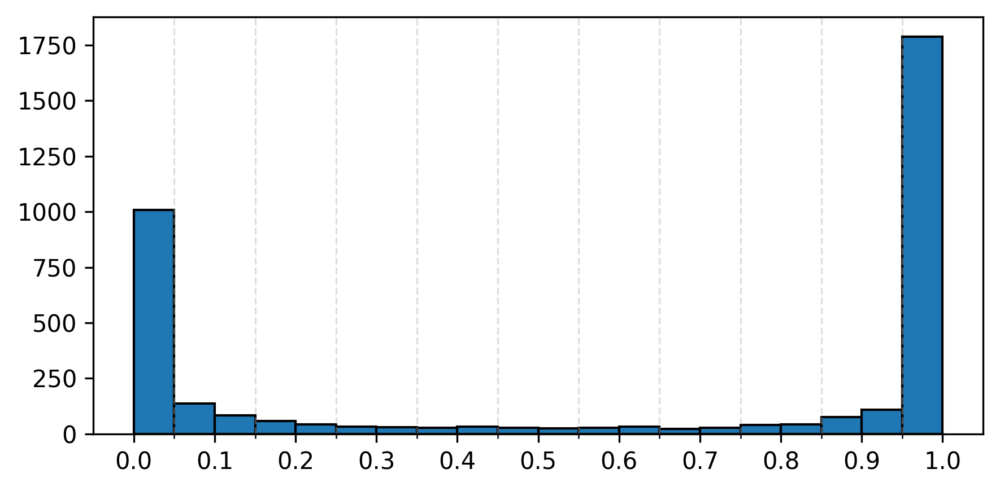

In [ ]:
# classification confidence
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

base = log_hcc

calib = CalibratedClassifierCV(
    estimator=base,
    method="sigmoid",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(hcc, hcc_labels)

proba = calib.predict_proba(hcc_test)[:, 1]   # P(y=1 | x)

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Model distribution**

- **U-shaped extremes:** Strong peaks at 0.0 (normoxia) and 1.0 (hypoxia) indicate most samples are classified with high certainty.  
- **Slight hypoxia bias:** The spike at 1.0 is taller than at 0.0, suggesting the model is marginally more confident when calling hypoxia.  
- **Minimal uncertainty:** Very few predictions lie between ~0.1–0.9, confirming that ambiguous probabilities are rare.  


In [ ]:
np.savetxt('hcc_drop_predictions.txt',                 # output filename
           hcc_dropseq_predictions,                           # the array to save
           delimiter='\t',              # use tab as separator
           fmt='%d'
          )

### MCF7

In [ ]:
# load the test set
mcf7_test = pd.read_csv('/Users/edoardopanella/Documents/BOCCONI/YEAR 2/SEMESTER 2/AI LAB/Project data/DropSeq/MCF7_Filtered_Normalised_3000_Data_test_anonim.txt',
        delimiter=' ',
         engine='python'
          )

mcf7_test = mcf7_test.T

In [ ]:
# train the chosen model on the whole train set
svc_mcf7.fit(mcf7, mcf7_labels)

Pipeline(steps=[('pca', PCA(n_components=250, random_state=42)),
                ('scaler', StandardScaler()),
                ('LinearSVC',
                 LinearSVC(C=0.1, dual=False, max_iter=5000, random_state=42))])

In [ ]:
# generate prediction array
mcf7_dropseq_predictions = svc_mcf7.predict(mcf7_test)

In [ ]:
print(f"Test proportion: {np.sum(mcf7_dropseq_predictions==1)/len(mcf7_dropseq_predictions)}")

Test proportion: 0.4019607843137255


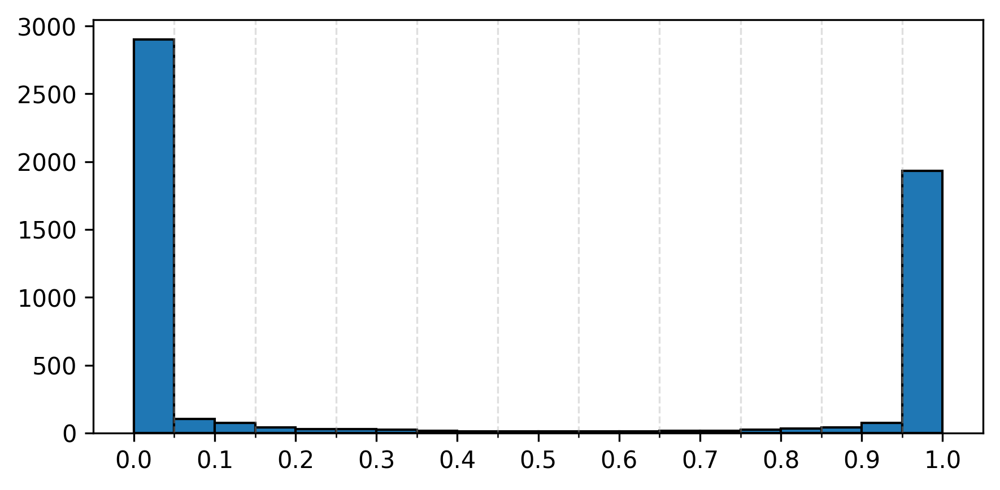

In [ ]:
# classification confidence
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import StratifiedKFold

base = svc_mcf7

calib = CalibratedClassifierCV(
    estimator=base,
    method="sigmoid",
    cv=StratifiedKFold(5, shuffle=True)
)

calib.fit(mcf7, mcf7_labels)

proba = calib.predict_proba(mcf7_test)[:, 1]

# histo
fig, ax = plt.subplots(figsize = (6, 3))
fig.set_dpi(300)

counts, bin_edges, _ = ax.hist(proba, bins = 20, edgecolor = "black")

ax.set_xticks(bin_edges, minor=True)

ax.grid(True, axis="x", which="minor", linestyle="--", alpha=0.4)
# labels: choose, say, every 2nd or 4th edge as *major* ticks
step = 2                         # show label every 2 bins (adjust to taste)
major_locs = bin_edges[::step]
ax.set_xticks(major_locs)        # these are the *major* ticks
ax.set_xticklabels([f"{e:.1f}" for e in major_locs])


fig.tight_layout()

**Model distribution**

The histogram of SVM predicted probabilities on the MCF7 test set underscores its decisive classification behavior:

- **Dominant peaks at extremes:** A very large spike at 1.0 and a substantial spike at 0.0 show the model almost always assigns maximum confidence to hypoxia and normoxia calls, respectively.  
- **Stronger hypoxia confidence:** The 1.0 peak (1,800+ samples) slightly exceeds the 0.0 peak (2,900+ samples), reflecting a marginal bias toward hypoxia certainty.  
- **Virtually no ambiguity:** Almost no predictions fall between ~0.1–0.9, confirming that uncertain or borderline probabilities are effectively nonexistent.  

In [ ]:
np.savetxt('mcf7_drop_predictions.txt',                 # output filename
           mcf7_dropseq_predictions,                           # the array to save
           delimiter='\t',              # use tab as separator
           fmt='%d'
          )